# Preparation

### trajectory lineplot

In [184]:
library(ggrastr)
library(tidydr)
library(viridis)

Loading required package: viridisLite


Attaching package: ‘viridisLite’


The following objects are masked from ‘package:pals’:

    cividis, inferno, magma, plasma, turbo, viridis



Attaching package: ‘viridis’


The following objects are masked from ‘package:pals’:

    cividis, inferno, magma, plasma, turbo, viridis


The following object is masked from ‘package:scales’:

    viridis_pal




In [175]:
colnames(pData(cds))

[1] "orig.ident"           "nCount_RNA"           "nFeature_RNA"        
 [4] "percent.mt"           "nGene"                "nUMI"                
 [7] "nCount_SCT"           "nFeature_SCT"         "seurat_clusters"     
[10] "integrated_snn_res.2" "sampleID"             "major_cluster"       
[13] "primary_cluster"      "states"               "subtype"             
[16] "sample"               "study"                "id"                  
[19] "tissue"               "sex"                  "cid"                 
[22] "n"                    "minor"                "group"               
[25] "patient"              "CytoTRACE"            "Size_Factor"         
[28] "num_genes_expressed"  "Total_mRNAs"          "Pseudotime"          
[31] "State"

In [194]:
df.gg <- t(reducedDimS(cds)) %>% 
    as.data.frame %>%
    select_('Component 1'=1, "Component 2"=2) %>%
    rownames_to_column("Cells") %>% ## 可以把行名改列名
    mutate(pData(cds)$State, pData(cds)$Pseudotime, pData(cds)$orig.ident, pData(cds)$subtype, pData(cds)$group)
colnames(df.gg) <- c("cells","Component_1","Component_2","State","Pseudotime","orig.ident","subtype","group")
mid <- match(df.gg$cells, table = rownames(meta))
df.gg$sampleID <- meta$sampleID[mid]
mid <- match(df.gg$sampleID, cluster.df$sampleID)
df.gg$cluster <- cluster.df$cluster[mid]
df.gg$cluster[is.na(df.gg$cluster)==TRUE] <- "others"
df.gg

Warning message:
“`select_()` was deprecated in dplyr 0.7.0.
ℹ Please use `select()` instead.”


cells,Component_1,Component_2,State,Pseudotime,orig.ident,subtype,group,sampleID,cluster
<chr>,<dbl>,<dbl>,<fct>,<dbl>,<chr>,<fct>,<chr>,<chr>,<chr>
GSM5387660@@_GACGTGCAGGAGTAGA_COL07_CRC,3.436704,5.1807489,5,34.42415,GSM5387660,Epi_IFI27,PT,CRC01-PT,others
GSM5387660@@_GAGTCCGGTAGCTGCC_COL07_CRC,6.854733,6.5500009,3,38.89594,GSM5387660,Epi_IFI27,PT,CRC01-PT,others
GSM5387660@@_CTCATTAAGTGTGGCA_COL07_CRC,6.902614,6.8307203,3,39.13892,GSM5387660,Epi_IFI27,PT,CRC01-PT,others
GSM4147094@@_GTCACGGTCAGGTTCA-1,9.696775,-12.4390572,1,56.15624,GSM4147094,Epi_IFI27,PT,UVM05-PT,others
GSM5387668@@_GTTCGGGTCCGCAGTG_COL16_LM,8.689300,3.8537617,1,39.49205,GSM5387668,Epi_IFI27,HM,CRC03-HM,CP6
GSM5387660@@_GTGGGTCGTGGTCCGT_COL07_CRC,6.625964,6.8816558,3,38.99537,GSM5387660,Epi_IFI27,PT,CRC01-PT,others
GSM5387660@@_CCACTACCACACAGAG_COL07_CRC,-7.418686,4.0408460,5,23.58434,GSM5387660,Epi_IFI27,PT,CRC01-PT,others
GSM5387660@@_ACAGCCGGTCTTTCAT_COL07_CRC,-7.328544,4.0387745,5,23.67378,GSM5387660,Epi_IFI27,PT,CRC01-PT,others
GSM5387660@@_TGCGGGTCAATCAGAA_COL07_CRC,2.402867,4.7903732,5,33.40799,GSM5387660,Epi_IFI27,PT,CRC01-PT,others


In [197]:
unique(df.gg$cluster)

[1] "others" "CP6"    "CP1"    "CP2"    "CP5"

In [181]:
reduced_dim_coords <- reducedDimK(cds)

In [182]:
ica_space_df <- Matrix::t(reduced_dim_coords) %>% 
    as.data.frame() %>% 
    select_(prin_graph_dim_1 = 1, prin_graph_dim_2 = 2) %>% 
    mutate(sample_name = rownames(.), sample_state = rownames(.))
dp_mst <- minSpanningTree(cds)

Warning message:
“`select_()` was deprecated in dplyr 0.7.0.
ℹ Please use `select()` instead.”


In [183]:
edge_df <- dp_mst %>%
        igraph::as_data_frame() %>%
        select_(source = "from", target = "to") %>%
        left_join(ica_space_df %>% select_(source="sample_name", source_prin_graph_dim_1="prin_graph_dim_1", source_prin_graph_dim_2="prin_graph_dim_2"), by = "source") %>%
        left_join(ica_space_df %>% select_(target="sample_name", target_prin_graph_dim_1="prin_graph_dim_1", target_prin_graph_dim_2="prin_graph_dim_2"), by = "target")
edge_df

Warning message:
“`select_()` was deprecated in dplyr 0.7.0.
ℹ Please use `select()` instead.”
Warning message:
“`select_()` was deprecated in dplyr 0.7.0.
ℹ Please use `select()` instead.”
Warning message:
“`select_()` was deprecated in dplyr 0.7.0.
ℹ Please use `select()` instead.”


source,target,source_prin_graph_dim_1,source_prin_graph_dim_2,target_prin_graph_dim_1,target_prin_graph_dim_2
<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>
Y_1,Y_5,1.212815,4.451878,1.7462033,4.489598
Y_1,Y_116,1.212815,4.451878,0.6716453,4.409814
Y_2,Y_7,-2.614598,4.147201,-3.1777649,4.086534
Y_2,Y_114,-2.614598,4.147201,-2.0605544,4.197126
Y_3,Y_97,-4.319674,3.959301,-3.7416960,4.024298
Y_3,Y_121,-4.319674,3.959301,-4.9057175,3.892121
Y_4,Y_11,5.389183,5.318997,5.4516013,5.494392
Y_4,Y_30,5.389183,5.318997,5.3260714,5.143571
Y_5,Y_80,1.746203,4.489598,2.2582434,4.515653


In [191]:
# Cellratio <- prop.table(table(df.gg$State, df.gg$subtype), margin = 2) %>% as.data.frame()
# colnames(Cellratio) <- c("State","Subtype","Freq")
# Cellratio

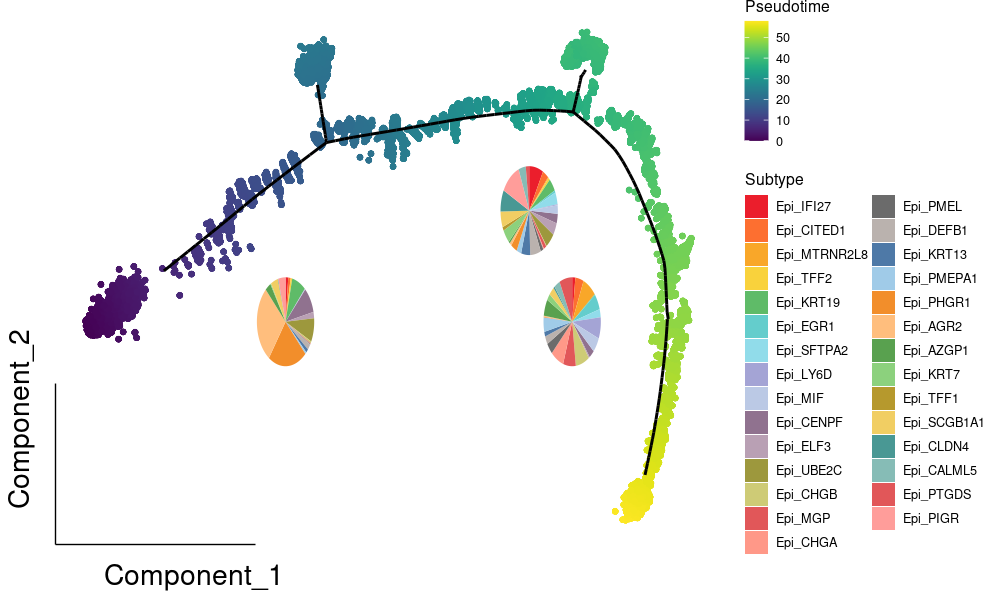

In [208]:
options(repr.plot.width = 10, repr.plot.height =6, repr.plot.res = 100)
ggplot() + 
    theme_bw()+
    geom_point_rast(data = df.gg, aes(x = Component_1, y = Component_2, color =Pseudotime)) + 
    scale_color_viridis() +
    scale_fill_manual(values = mycols)+
    theme_dr(arrow = grid::arrow(length = unit(0, "inches")))+
    theme(
      panel.background = element_blank(),
      panel.border = element_blank(),
      panel.grid = element_blank(),
      axis.ticks.length = unit(0.8, "lines"),
      axis.ticks = element_blank(),
      axis.line = element_blank(),
      axis.title = element_text(size=20),
) +
geom_segment(aes_string(x="source_prin_graph_dim_1",y="source_prin_graph_dim_2",
                        xend="target_prin_graph_dim_1",yend="target_prin_graph_dim_2"), 
             size=0.75, linetype="solid", na.rm=TRUE, data=edge_df) + 
geom_arc_bar(data=subset(Cellratio,State=='1'),stat = "pie", color = "transparent",aes(x0=5,y0=-5,r0=0,r=2, amount=Freq, fill=Subtype)) + 
geom_arc_bar(data=subset(Cellratio,State=='5'),stat = "pie",color = "transparent",aes(x0=2,y0=0,r0=0,r=2, amount=Freq, fill=Subtype)) +
geom_arc_bar(data=subset(Cellratio,State=='7'),stat = "pie",color = "transparent",aes(x0=-15,y0=-5,r0=0,r=2, amount=Freq, fill=Subtype))  

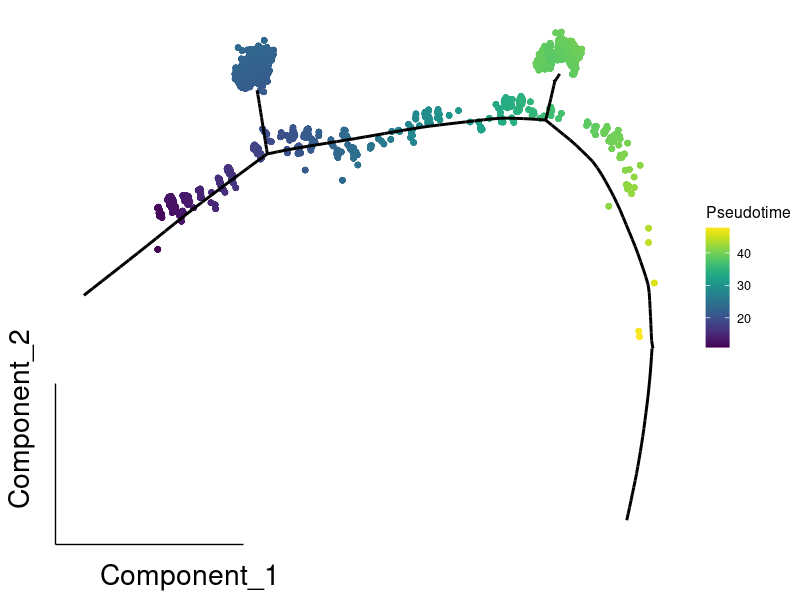

In [196]:
options(repr.plot.width = 8, repr.plot.height =6, repr.plot.res = 100)
df.target <- filter(df.gg, cluster == "CP1")
p1 <- ggplot(df.target) + 
    theme_bw()+
    geom_point_rast(data = df.target, aes(x = Component_1, y = Component_2, color =Pseudotime)) + 
    scale_color_viridis() +
    scale_fill_manual(values = mycols)+
    theme_dr(arrow = grid::arrow(length = unit(0, "inches")))+
    theme(
      panel.background = element_blank(),
      panel.border = element_blank(),
      panel.grid = element_blank(),
      axis.ticks.length = unit(0.8, "lines"),
      axis.ticks = element_blank(),
      axis.line = element_blank(),
      axis.title = element_text(size=20),
) +
geom_segment(aes_string(x="source_prin_graph_dim_1",y="source_prin_graph_dim_2",
                        xend="target_prin_graph_dim_1",yend="target_prin_graph_dim_2"), 
             size=0.75, linetype="solid", na.rm=TRUE, data=edge_df) 
p1

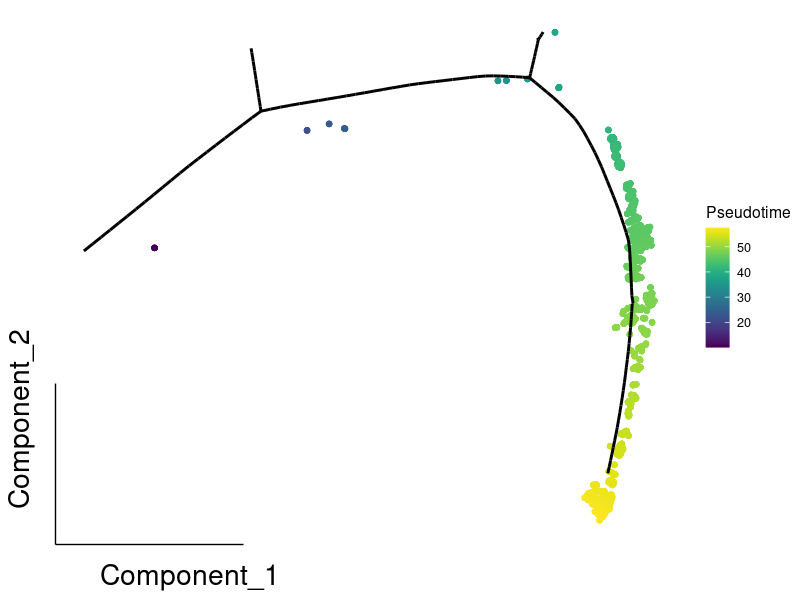

In [198]:
options(repr.plot.width = 8, repr.plot.height =6, repr.plot.res = 100)
df.target <- filter(df.gg, cluster == "CP2")
p1 <- ggplot(df.target) + 
    theme_bw()+
    geom_point_rast(data = df.target, aes(x = Component_1, y = Component_2, color =Pseudotime)) + 
    scale_color_viridis() +
    scale_fill_manual(values = mycols)+
    theme_dr(arrow = grid::arrow(length = unit(0, "inches")))+
    theme(
      panel.background = element_blank(),
      panel.border = element_blank(),
      panel.grid = element_blank(),
      axis.ticks.length = unit(0.8, "lines"),
      axis.ticks = element_blank(),
      axis.line = element_blank(),
      axis.title = element_text(size=20),
) +
geom_segment(aes_string(x="source_prin_graph_dim_1",y="source_prin_graph_dim_2",
                        xend="target_prin_graph_dim_1",yend="target_prin_graph_dim_2"), 
             size=0.75, linetype="solid", na.rm=TRUE, data=edge_df) 
p1

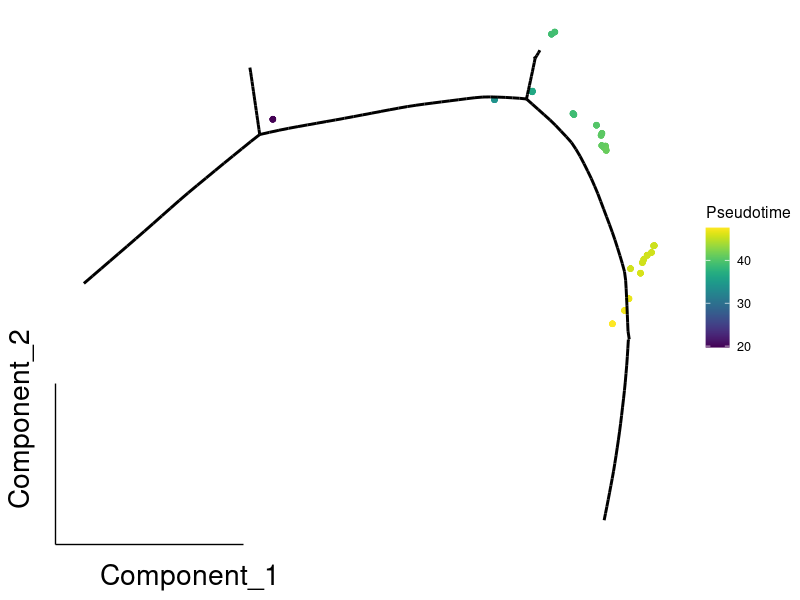

In [200]:
options(repr.plot.width = 8, repr.plot.height =6, repr.plot.res = 100)
df.target <- filter(df.gg, cluster == "CP5")
p1 <- ggplot(df.target) + 
    theme_bw()+
    geom_point_rast(data = df.target, aes(x = Component_1, y = Component_2, color =Pseudotime)) + 
    scale_color_viridis() +
    scale_fill_manual(values = mycols)+
    theme_dr(arrow = grid::arrow(length = unit(0, "inches")))+
    theme(
      panel.background = element_blank(),
      panel.border = element_blank(),
      panel.grid = element_blank(),
      axis.ticks.length = unit(0.8, "lines"),
      axis.ticks = element_blank(),
      axis.line = element_blank(),
      axis.title = element_text(size=20),
) +
geom_segment(aes_string(x="source_prin_graph_dim_1",y="source_prin_graph_dim_2",
                        xend="target_prin_graph_dim_1",yend="target_prin_graph_dim_2"), 
             size=0.75, linetype="solid", na.rm=TRUE, data=edge_df) 
p1

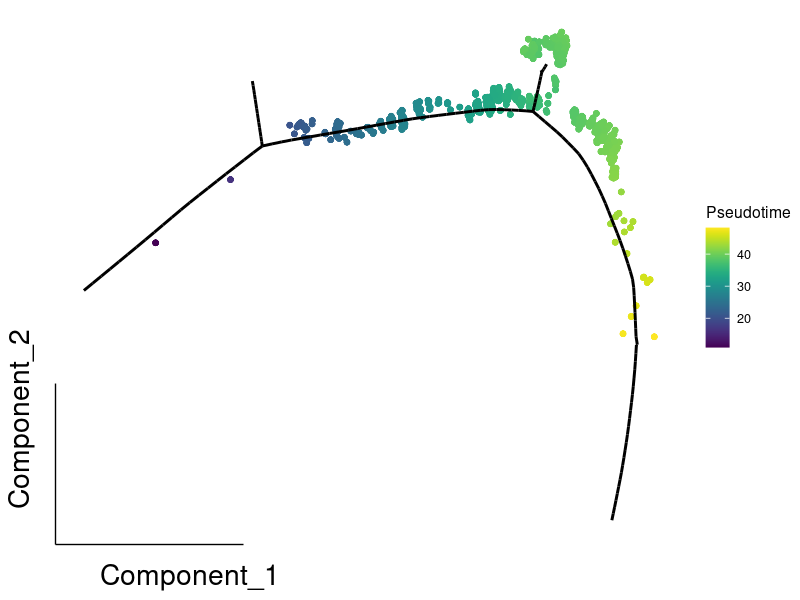

In [201]:
options(repr.plot.width = 8, repr.plot.height =6, repr.plot.res = 100)
df.target <- filter(df.gg, cluster == "CP6")
p1 <- ggplot(df.target) + 
    theme_bw()+
    geom_point_rast(data = df.target, aes(x = Component_1, y = Component_2, color =Pseudotime)) + 
    scale_color_viridis() +
    scale_fill_manual(values = mycols)+
    theme_dr(arrow = grid::arrow(length = unit(0, "inches")))+
    theme(
      panel.background = element_blank(),
      panel.border = element_blank(),
      panel.grid = element_blank(),
      axis.ticks.length = unit(0.8, "lines"),
      axis.ticks = element_blank(),
      axis.line = element_blank(),
      axis.title = element_text(size=20),
) +
geom_segment(aes_string(x="source_prin_graph_dim_1",y="source_prin_graph_dim_2",
                        xend="target_prin_graph_dim_1",yend="target_prin_graph_dim_2"), 
             size=0.75, linetype="solid", na.rm=TRUE, data=edge_df) 
p1

Warning message:
“`select_()` was deprecated in dplyr 0.7.0.
ℹ Please use `select()` instead.
ℹ The deprecated feature was likely used in the monocle package.
  Please report the issue to the authors.”


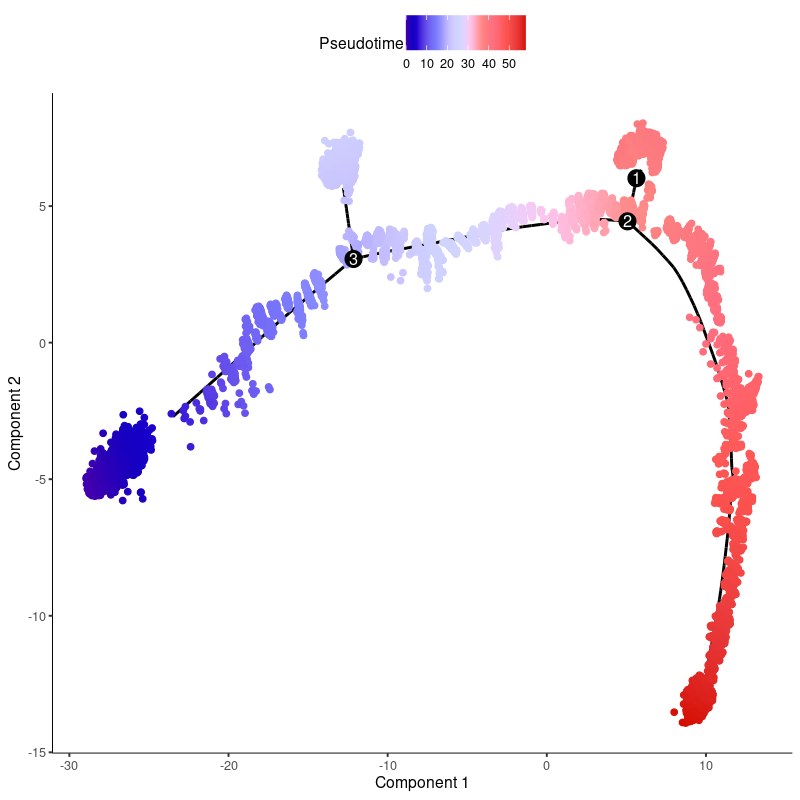

In [168]:
options(repr.plot.width = 8, repr.plot.height =8, repr.plot.res = 100)
plot_cell_trajectory(cds, color_by = "Pseudotime", size = 1, show_backbone = TRUE) + scale_color_gsea()

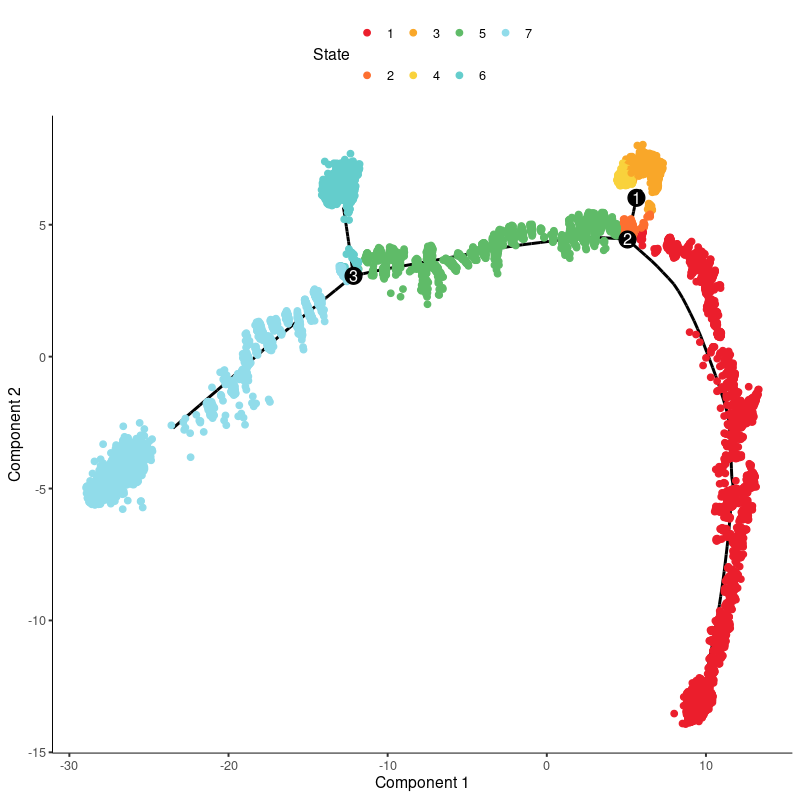

In [203]:
options(repr.plot.width = 8, repr.plot.height =8, repr.plot.res = 100)
plot_cell_trajectory(cds, color_by = "State", size = 1, show_backbone = TRUE) + scale_color_manual(values = mycols) 

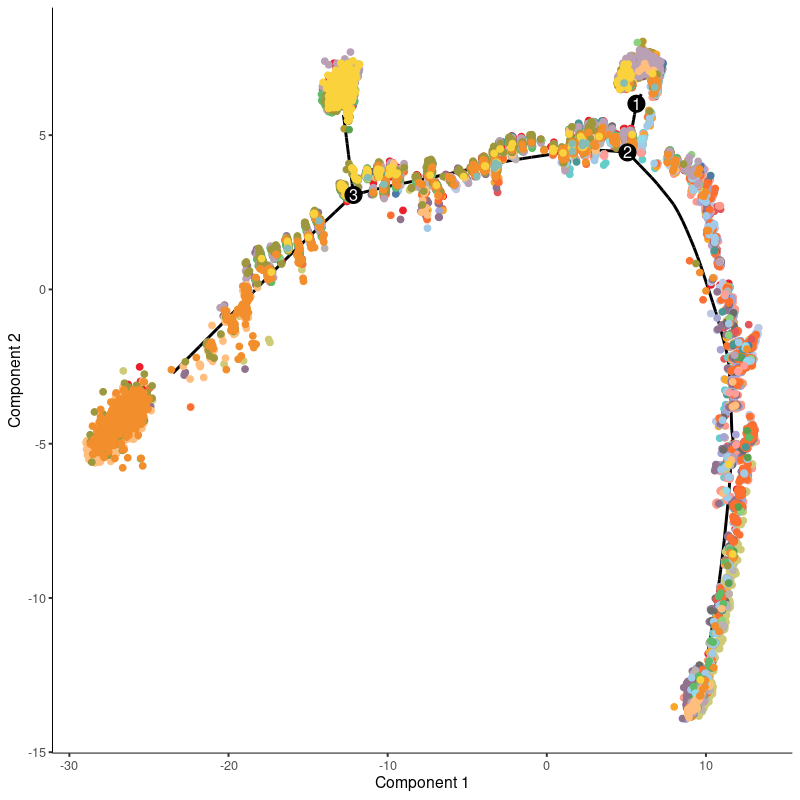

In [173]:
options(repr.plot.width = 8, repr.plot.height =8, repr.plot.res = 100)
plot_cell_trajectory(cds, color_by = "subtype", size = 1, show_backbone = TRUE) + 
    scale_color_manual(values = mycols) + 
    theme(legend.position = "none")

### trajectory UMAP

In [288]:
umap <- obj@reductions$umap@cell.embeddings %>% as.data.frame()
mid <- match(rownames(umap), table = df.gg$cells)
umap$Pseudotime <- df.gg$Pseudotime[mid]
umap

,UMAP_1,UMAP_2,UMAP_3,Pseudotime
,<dbl>,<dbl>,<dbl>,<dbl>
GSM5387660@@_GACGTGCAGGAGTAGA_COL07_CRC,-1.9827624,2.1647065,-0.159854898,34.42415
GSM5387660@@_GAGTCCGGTAGCTGCC_COL07_CRC,-2.8534806,1.7214802,0.270710132,38.89594
GSM5387660@@_CTCATTAAGTGTGGCA_COL07_CRC,-2.4250777,1.9313238,-0.005224654,39.13892
GSM4147094@@_GTCACGGTCAGGTTCA-1,-2.0820687,0.9267582,-0.481309203,56.15624
GSM5387668@@_GTTCGGGTCCGCAGTG_COL16_LM,-2.9317897,1.4896092,0.213138065,39.49205
GSM5387660@@_GTGGGTCGTGGTCCGT_COL07_CRC,-1.3498911,2.6108099,-0.066737720,38.99537
GSM5387660@@_CCACTACCACACAGAG_COL07_CRC,-1.5987692,1.7565859,0.525283417,23.58434
GSM5387660@@_ACAGCCGGTCTTTCAT_COL07_CRC,-2.0301199,2.3209875,0.230817637,23.67378
GSM5387660@@_TGCGGGTCAATCAGAA_COL07_CRC,-2.8187554,1.0040254,-0.119644919,33.40799


In [290]:
options(repr.plot.width = 8, repr.plot.height =8, repr.plot.res = 100)
pre4 <- ggplot(data = umap, aes(x = UMAP_1, y = UMAP_2, color = Pseudotime)) +
  geom_point(size = 0.7, alpha = 1) +
  scale_colour_gradientn(colours = rev(brewer.brbg(10)))+
  theme(panel.grid.major = element_blank(), # remove background color……
        panel.grid.minor = element_blank(),
        panel.border = element_blank(),
        axis.title = element_blank(),
        axis.text = element_blank(),
        axis.ticks = element_blank(),
        panel.background = element_rect(fill = "white"),
        plot.background = element_rect(fill = "white")) +
  theme(legend.title = element_blank(),
        legend.key = element_rect(fill = "white"), # remove legend background color
        legend.text = element_text(size = 15),
        legend.key.size = unit(1,"cm")) 
p4 <- pre4+theme(legend.position = "none")

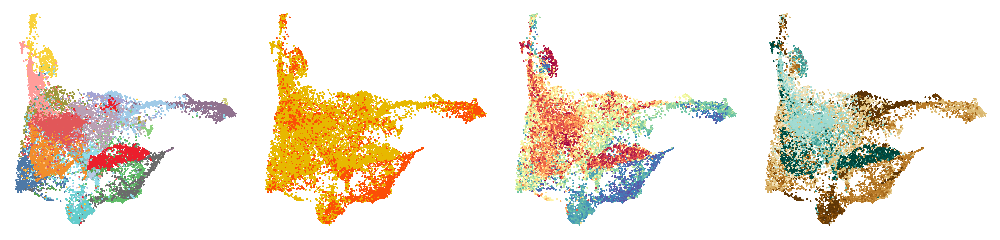

In [291]:
options(repr.plot.width = 25, repr.plot.height =6, repr.plot.res = 200)
cowplot::plot_grid(p1,p2,p3,p4,ncol=4)

Warning message in get_plot_component(plot, "guide-box"):
“Multiple components found; returning the first one. To return all, use `return_all = TRUE`.”


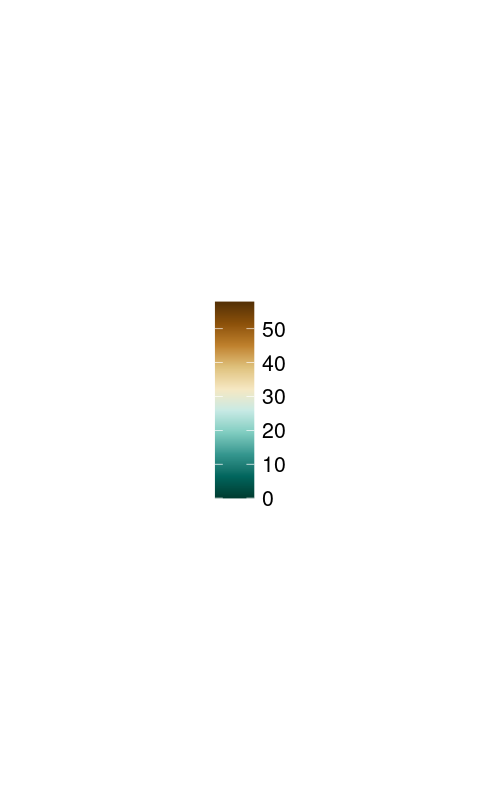

In [292]:
options(repr.plot.width = 5, repr.plot.height =8, repr.plot.res = 100)
lgd_4 <- cowplot::get_legend(pre4)
grid.newpage()
grid.draw(lgd_4)

### pseudotime heatmap - simple

In [22]:
library(ClusterGVis)

Loading required package: monocle

Loading required package: Matrix


Attaching package: ‘Matrix’


The following objects are masked from ‘package:tidyr’:

    expand, pack, unpack


Loading required package: Biobase

Loading required package: BiocGenerics

Loading required package: parallel


Attaching package: ‘BiocGenerics’


The following objects are masked from ‘package:parallel’:

    clusterApply, clusterApplyLB, clusterCall, clusterEvalQ,
    clusterExport, clusterMap, parApply, parCapply, parLapply,
    parLapplyLB, parRapply, parSapply, parSapplyLB


The following objects are masked from ‘package:dplyr’:

    combine, intersect, setdiff, union


The following objects are masked from ‘package:stats’:

    IQR, mad, sd, var, xtabs


The following objects are masked from ‘package:base’:

    anyDuplicated, append, as.data.frame, basename, cbind, colnames,
    dirname, do.call, duplicated, eval, evalq, Filter, Find, get, grep,
    grepl, intersect, is.unsorted, lapply, Map, mappl

In [26]:
cds.fil <- cds[fData(cds)$use_for_ordering == TRUE,] ## 只用排序基因来做回归分析，找它们是否跟拟时间有显著关系。不提取的话会用所有基因
cds.fil

CellDataSet (storageMode: environment)
assayData: 11891 features, 16576 samples 
  element names: exprs 
protocolData: none
phenoData
  sampleNames: GSM5387660@@_GACGTGCAGGAGTAGA_COL07_CRC
    GSM5387660@@_GAGTCCGGTAGCTGCC_COL07_CRC ...
    GSM5387667@@_CTCGGGAGTAGAAAGG_COL16_CRC (16576 total)
  varLabels: orig.ident nCount_RNA ... State (31 total)
  varMetadata: labelDescription
featureData
  featureNames: ENSG00000000003 ENSG00000000419 ... ENSG00000285128
    (11891 total)
  fvarLabels: gene_short_name gene_id num_cells_expressed
    use_for_ordering
  fvarMetadata: labelDescription
experimentData: use 'experimentData(object)'
Annotation:  

In [295]:
# saveRDS(cds.fil, "/public/workspace202011/pancancer/Zhangcl/liver_metastasis/epithelial_analysis/epi.monocle.cds_fil.rds")

In [ ]:
## 在terminal上跑
# library(monocle)
# cds.fil <- readRDS("/public/workspace202011/pancancer/Zhangcl/liver_metastasis/epithelial_analysis/epi.monocle.cds_fil.rds")
# Time_diff <- differentialGeneTest(cds.fil, cores = 1, fullModelFormulaStr = "~sm.ns(Pseudotime)")
# saveRDS(Time_diff, file = "/public/workspace202011/pancancer/Zhangcl/liver_metastasis/epithelial_analysis/epi.monocle.cds_timediff.rds")

In [27]:
Time_diff <- readRDS(file = "/public/workspace202011/pancancer/Zhangcl/liver_metastasis/epithelial_analysis/simple/epi.monocle.cds_timediff.rds")
Time_diff

,status,family,pval,qval,gene_short_name,gene_id,num_cells_expressed,use_for_ordering
,<chr>,<chr>,<dbl>,<dbl>,<chr>,<chr>,<int>,<lgl>
ENSG00000000003,OK,negbinomial.size,3.832874e-212,5.711367e-211,TSPAN6,ENSG00000000003,3171,TRUE
ENSG00000000419,OK,negbinomial.size,3.161341e-80,1.521923e-79,DPM1,ENSG00000000419,4936,TRUE
ENSG00000000938,OK,negbinomial.size,1.263019e-01,1.428842e-01,FGR,ENSG00000000938,222,TRUE
ENSG00000000971,OK,negbinomial.size,5.296849e-12,8.626878e-12,CFH,ENSG00000000971,759,TRUE
ENSG00000001036,OK,negbinomial.size,1.553397e-141,1.391970e-140,FUCA2,ENSG00000001036,4879,TRUE
ENSG00000001084,OK,negbinomial.size,3.255875e-39,8.863464e-39,GCLC,ENSG00000001084,3591,TRUE
ENSG00000001460,OK,negbinomial.size,4.670559e-02,5.466301e-02,STPG1,ENSG00000001460,849,TRUE
ENSG00000001497,OK,negbinomial.size,2.565173e-40,7.108475e-40,LAS1L,ENSG00000001497,2727,TRUE
ENSG00000001561,OK,negbinomial.size,4.815386e-12,7.850254e-12,ENPP4,ENSG00000001561,2182,TRUE


In [28]:
length(unique(Time_diff$gene_id))
length(unique(Time_diff$gene_short_name))

[1] 11891

[1] 11891

In [272]:
table(Time_diff$pval<0.001 & Time_diff$qval<0.001)
table(Time_diff$num_cells_expressed<200)


FALSE  TRUE 
 2652  9239 


FALSE  TRUE 
10749  1142 

In [30]:
Time_genes <- Time_diff %>% filter(Time_diff$pval<0.001 & Time_diff$qval<0.001) %>% pull(gene_short_name) %>% as.character()
length(unique(Time_genes))
length(Time_genes)

[1] 9239

[1] 9239

In [ ]:
# options(repr.plot.width=10, repr.plot.height=10)
# p <- plot_pseudotime_heatmap(cds[fData(cds)$gene_short_name %in% Time_genes,], 
#                              num_clusters=4, show_rownames=TRUE, return_heatmap = TRUE)
# saveRDS(p, file = "/public/workspace202011/pancancer/Zhangcl/liver_metastasis/epithelial_analysis/epi.monocle_timediff_heatmap.rds")

In [333]:
## 获得数据
# plot_data <- plot_pseudotime_heatmap2(cds[fData(cds)$gene_short_name %in% Time_genes,], 
#                              num_clusters=4, show_rownames=TRUE, return_heatmap = FALSE)

In [47]:
# saveRDS(plot_data, "/public/workspace202011/pancancer/Zhangcl/liver_metastasis/epithelial_analysis/simple/epi.monocle_timediff_heatmap_plot_data.rds")
plot_data <- readRDS("/public/workspace202011/pancancer/Zhangcl/liver_metastasis/epithelial_analysis/simple/epi.monocle_timediff_heatmap_plot_data.rds")

In [48]:
str(plot_data)

List of 6
 $ wide.res  :'data.frame':	8890 obs. of  102 variables:
  ..$ gene   : chr [1:8890] "TSPAN6" "DPM1" "CFH" "FUCA2" ...
  ..$ 1      : num [1:8890] 3 3 -0.919 3 1.483 ...
  ..$ 2      : num [1:8890] 3 2.927 -0.917 3 1.455 ...
  ..$ 3      : num [1:8890] 3 2.754 -0.915 3 1.427 ...
  ..$ 4      : num [1:8890] 2.851 2.586 -0.913 2.835 1.399 ...
  ..$ 5      : num [1:8890] 2.629 2.423 -0.911 2.626 1.371 ...
  ..$ 6      : num [1:8890] 2.418 2.266 -0.909 2.426 1.343 ...
  ..$ 7      : num [1:8890] 2.217 2.113 -0.907 2.234 1.316 ...
  ..$ 8      : num [1:8890] 2.026 1.966 -0.905 2.051 1.288 ...
  ..$ 9      : num [1:8890] 1.846 1.824 -0.902 1.876 1.261 ...
  ..$ 10     : num [1:8890] 1.68 1.69 -0.9 1.71 1.23 ...
  ..$ 11     : num [1:8890] 1.516 1.555 -0.897 1.551 1.206 ...
  ..$ 12     : num [1:8890] 1.365 1.428 -0.893 1.401 1.179 ...
  ..$ 13     : num [1:8890] 1.22 1.31 -0.89 1.26 1.15 ...
  ..$ 14     : num [1:8890] 1.09 1.19 -0.886 1.124 1.126 ...
  ..$ 15     : num [1:8890] 0.

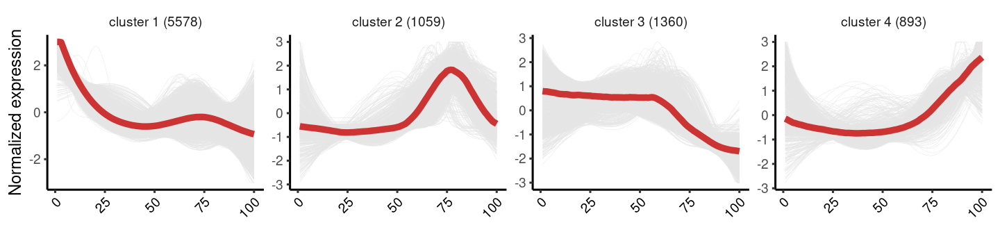

In [49]:
options(repr.plot.width=12, repr.plot.height=3)
visCluster(plot_data, plot.type = "line")

In [103]:
## 拿到plot_pseudotime_heatmap_2的聚类顺序
clusters <- plot_data$long.res %>% dplyr::select(c(gene,cluster)) %>% distinct(gene, .keep_all = TRUE)
length(unique(clusters$gene))
clusters

[1] 8890

gene,cluster
<chr>,<fct>
TSPAN6,1
DPM1,1
FUCA2,1
LAS1L,1
ENPP4,1
CFTR,1
ANKIB1,1
CYP51A1,1
KRIT1,1


In [104]:
# tmp <- fData(cds)[fData(cds)$gene_short_name %in% Time_genes,]
# row.anno <- tmp[match(x = clusters$gene, table = tmp$gene_short_name),] %>% dplyr::select(c(gene_short_name))
row.anno <- clusters
rownames(row.anno) <- row.anno$gene
row.anno$gene <- NULL
row.anno

,cluster
,<fct>
TSPAN6,1
DPM1,1
FUCA2,1
LAS1L,1
ENPP4,1
CFTR,1
ANKIB1,1
CYP51A1,1
KRIT1,1


In [105]:
mat <- plot_data$wide.res
mat$gene <- factor(mat$gene, levels = rownames(row.anno))
mat <- arrange(mat, gene)
mat$gene <- NULL
mat$cluster <- NULL
mat

,1,2,3,4,5,6,7,8,9,10,⋯,91,92,93,94,95,96,97,98,99,100
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
TSPAN6,3.000000,3.000000,3.000000,2.851023,2.628998,2.417636,2.216842,2.026468,1.8463243,1.6761755,⋯,-0.63087968,-0.64042542,-0.64987443,-0.65919200,-0.66834722,-0.67731283,-0.686065083,-0.69458357,-0.70285103,-0.71085313
DPM1,3.000000,2.927422,2.754358,2.586339,2.423436,2.265702,2.113169,1.965852,1.8237500,1.6868450,⋯,-1.07644180,-1.13050701,-1.18292656,-1.23354757,-1.28224922,-1.32894050,-1.373557705,-1.41606179,-1.45643577,-1.49468200
FUCA2,3.000000,3.000000,3.000000,2.834583,2.625922,2.425757,2.234097,2.050913,1.8761368,1.7096662,⋯,-0.38297525,-0.37459241,-0.36622784,-0.35787148,-0.34951285,-0.34114104,-0.332744712,-0.32431212,-0.31583109,-0.30728901
LAS1L,3.000000,3.000000,3.000000,2.968576,2.686732,2.422011,2.173864,1.941685,1.7248286,1.5226166,⋯,-0.50595161,-0.54682333,-0.58684387,-0.62580148,-0.66352038,-0.69985873,-0.734706260,-0.76798157,-0.79962926,-0.82961699
ENPP4,3.000000,3.000000,2.921281,2.710122,2.507199,2.312421,2.125677,1.946836,1.7757513,1.6122613,⋯,-0.89379259,-0.96890376,-1.04240105,-1.11399746,-1.18345266,-1.25057033,-1.315195088,-1.37720921,-1.43652915,-1.49310201
CFTR,3.000000,3.000000,3.000000,2.926072,2.666310,2.420823,2.189640,1.972669,1.7697088,1.5804534,⋯,-0.67653591,-0.67653910,-0.67654073,-0.67654155,-0.67654197,-0.67654217,-0.676542276,-0.67654233,-0.67654235,-0.67654236
ANKIB1,3.000000,2.899795,2.727244,2.560006,2.398118,2.241595,2.090439,1.944633,1.8041463,1.6689344,⋯,-1.12282354,-1.17957963,-1.23451336,-1.28747668,-1.33835504,-1.38706475,-1.433550163,-1.47778076,-1.51974829,-1.55946390
CYP51A1,3.000000,3.000000,3.000000,3.000000,2.719705,2.454856,2.206278,1.973628,1.7564706,1.5542909,⋯,-0.33236987,-0.33244716,-0.33285234,-0.33354379,-0.33447966,-0.33561797,-0.336916860,-0.33833465,-0.33982997,-0.34136183
KRIT1,3.000000,3.000000,3.000000,2.816310,2.611686,2.414871,2.225873,2.044663,1.8711863,1.7053575,⋯,-0.66555240,-0.70544477,-0.74506805,-0.78423470,-0.82277700,-0.86054676,-0.897414738,-0.93326985,-0.96801828,-1.00158235


In [106]:
## 标记基因（结合后面的富集结果）
mark <- c(
"ID1", "EGR1", "JUND", "FOSB", "RORA", "CREM", "CCL5", "ZNF683", "CCL2", "AIF1", "HLA-DRB5", "CCL4", "CCL3", "CCL3L1", "PLEK", "CCL18", 
"HLA-DRA", "CD74", "MITF", "TFAP2A", "IRF4", "HLA-DQA1", "CTHRC1", "HLA-DPA1", "HLA-DQB1", "HLA-DRB1", "FOS", "HES1", "ZFP36L2", "ELF3", 
"BATF", "YBX3", "EPAS1", "HMGB2", "TUBB"
         )
gene_pos <- which(rownames(row.anno) %in% mark)
row_mark <- rowAnnotation(mark = anno_mark(at = gene_pos, labels = rownames(row.anno)[gene_pos],
                                    labels_gp = gpar(fontsize = 12), padding = 0.1))

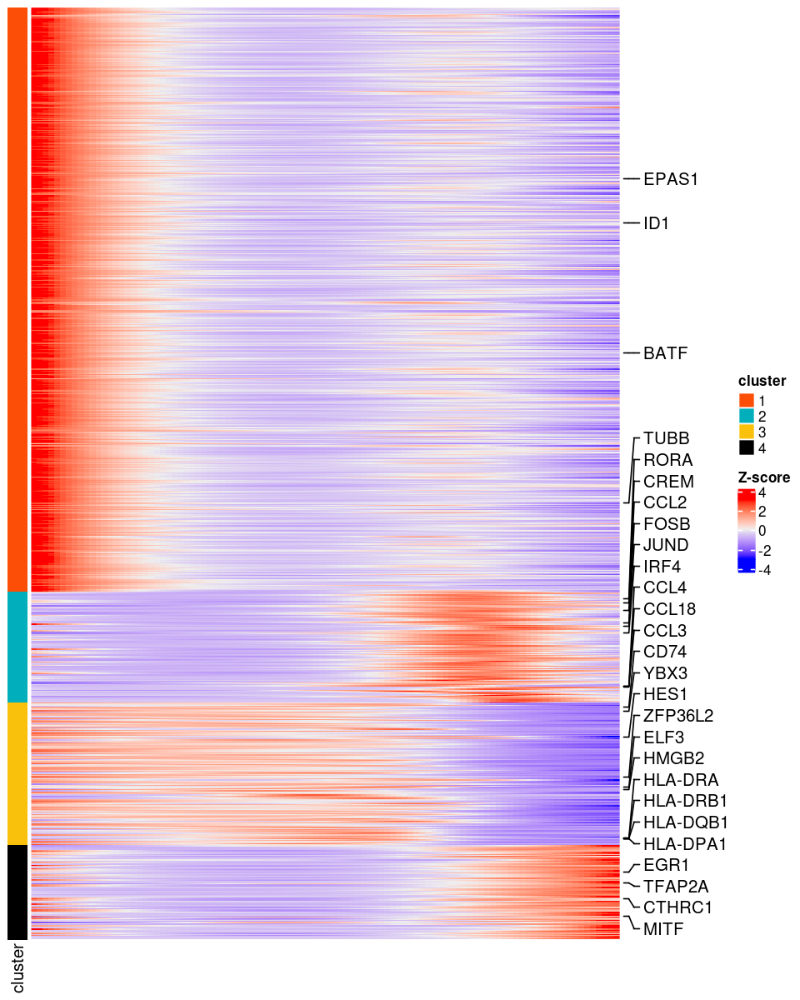

In [108]:
options(repr.plot.width=8, repr.plot.height=10)
ComplexHeatmap::Heatmap(as.matrix(mat),
                        name = "Z-score",
                        left_annotation = HeatmapAnnotation(df = row.anno, simple_anno_size = unit(0.5, "cm"),
                                                             col = list(cluster = c("1"="#fc4e07","4"="black",
                                                                                        "2"="#00afbb","3"="#f9c00c")),
                                                             which = "row"),
                        right_annotation = row_mark,show_row_names = FALSE, 
                        show_column_names = FALSE,
                        cluster_columns = FALSE,cluster_rows = FALSE)

### pseudotime heatmap - complex

In [21]:
library(mgcv)
library(scales)

Loading required package: nlme


Attaching package: ‘nlme’


The following object is masked from ‘package:dplyr’:

    collapse


This is mgcv 1.8-42. For overview type 'help("mgcv-package")'.



In [ ]:
# generalized additive model for logistic regression

In [273]:
# cds <- readRDS("/public/workspace202011/pancancer/Zhangcl/liver_metastasis/epithelial_analysis/data/epi.monocle2.rds")
cds <- readRDS("/public/workspace202011/pancancer/Zhangcl/liver_metastasis/epithelial_analysis/epi.monocle.cds_reorder.rds")

In [274]:
pst <- pData(cds) %>% dplyr::select(CytoTRACE) %>% arrange(CytoTRACE)
pst

,CytoTRACE
,<dbl>
GSM5004182@@_CCGATGGAGTAGCTCT-1,0.0000000000
P2_MT@@_TAGGTACCATCCTAAG-1,0.0000000000
P2_MT@@_TTCAGGATCGCAGTTA-1,0.0000000000
GSM4159165@@_CCTCTGACACATCCGG-1,0.0000000000
GSM4159165@@_AACTGGTGTCACTTCC-1,0.0000000000
GSM4159165@@_ACCCACTGTACGACCC-1,0.0000000000
P2_MT@@_CGACAGCCACACCAGC-1,0.0002393490
GSM4810690@@_CAGTTAGTCATTCATC-1,0.0002393490
GSM4159165@@_AGACGTTAGCATGGCA-1,0.0004786979


In [275]:
mid <- match(Time_genes, refgenes$V5)
sig_genes <- rownames(refgenes)[mid] 
length(Time_genes)
length(sig_genes)
head(Time_genes)
head(sig_genes)

[1] 9239

[1] 9239

[1] "TSPAN6" "DPM1"   "CFH"    "FUCA2"  "GCLC"   "LAS1L"

[1] "ENSG00000000003" "ENSG00000000419" "ENSG00000000971" "ENSG00000001036"
[5] "ENSG00000001084" "ENSG00000001497"

In [277]:
mat <- GetAssayData(obj) %>% as.matrix()

Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 4.2 GiB”


In [41]:
setdiff(sig_genes, rownames(mat))  # 不在 mat 中的基因
setdiff(rownames(pst), colnames(mat))  # 不在 mat 中的细胞名

[1] NA

character(0)

In [278]:
valid_genes <- sig_genes[sig_genes %in% rownames(mat)]
valid_cells <- rownames(pst)[rownames(pst) %in% colnames(mat)]
dat <- mat[valid_genes, valid_cells] %>% data.frame()
dat

,GSM5004182.._CCGATGGAGTAGCTCT.1,P2_MT.._TAGGTACCATCCTAAG.1,P2_MT.._TTCAGGATCGCAGTTA.1,GSM4159165.._CCTCTGACACATCCGG.1,GSM4159165.._AACTGGTGTCACTTCC.1,GSM4159165.._ACCCACTGTACGACCC.1,P2_MT.._CGACAGCCACACCAGC.1,GSM4810690.._CAGTTAGTCATTCATC.1,GSM4159165.._AGACGTTAGCATGGCA.1,P2_MT.._TCTGGCTTCTCATGCC.1,⋯,P3_T.._CATCAAGGTCTACGTA.1,P3_T.._TTCCGGTTCCATGAGT.1,P3_T.._TGTACAGTCCACACCT.1,GC08T_S1.._GC08T.S1.CGTAGCGCACCCATGG,GC08T_S1.._GC08T.S1.CCTAGCTAGGAGTTTA,P3_T.._TCATTTGAGCATCAAA.1,P3_T.._GGGCCATTCAAACCCA.1,P3_T.._ACCTACCTCCTAGCGG.1,GSM4147094.._GATCGTAAGACAGAGA.1,P3_T.._CTCAATTGTGTAGGAC.1
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
ENSG00000000003,0,0,0.000000,0.000000,0,0.000000,0,0.000000,0.000000,0.000000,⋯,0.000000,0.0000000,0.0000000,0.0000000,2.89598,0.0000000,0.0000000,0.6266781,0.2251923,0.0000000
ENSG00000000419,0,0,0.000000,0.000000,0,0.000000,0,0.000000,0.000000,0.000000,⋯,0.000000,0.8473741,0.8111386,1.1853787,0.00000,0.2355497,0.2378462,0.3616469,0.2251923,0.0000000
ENSG00000000971,0,0,0.000000,0.000000,0,0.000000,0,1.631891,0.000000,0.000000,⋯,0.000000,0.0000000,0.0000000,0.0000000,0.00000,0.0000000,0.4298507,0.0000000,0.0000000,0.0000000
ENSG00000001036,0,0,0.000000,0.000000,0,0.000000,0,0.000000,0.000000,0.000000,⋯,0.000000,0.0000000,0.6063063,1.1853787,0.00000,0.8450187,0.9597656,0.0000000,0.4088773,0.7624449
ENSG00000001084,0,0,0.000000,0.000000,0,0.000000,0,0.000000,0.000000,0.000000,⋯,0.000000,0.0000000,0.0000000,0.0000000,0.00000,0.2355497,0.2378462,0.3616469,0.2251923,0.4521930
ENSG00000001497,0,0,0.000000,0.000000,0,0.000000,0,0.000000,0.000000,0.000000,⋯,0.000000,0.0000000,0.0000000,0.0000000,0.00000,0.0000000,0.2378462,0.0000000,0.0000000,0.7624449
ENSG00000001561,0,0,0.000000,0.000000,0,2.911878,0,0.000000,0.000000,3.035048,⋯,0.000000,1.2993800,0.0000000,0.0000000,0.00000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000
ENSG00000001617,0,0,0.000000,0.000000,0,0.000000,0,0.000000,0.000000,0.000000,⋯,0.000000,0.0000000,0.0000000,0.0000000,0.00000,0.0000000,0.0000000,0.0000000,0.0000000,0.0000000
ENSG00000001626,0,0,0.000000,0.000000,0,0.000000,0,0.000000,0.000000,0.000000,⋯,0.000000,0.0000000,0.0000000,0.0000000,0.00000,0.2355497,0.0000000,0.0000000,0.0000000,0.0000000


In [279]:
newdat <- data.frame(p.time=seq(from=min(pst$CytoTRACE, na.rm=TRUE), to=max(pst$CytoTRACE, na.rm=TRUE), length.out=500))
newdat

p.time
<dbl>
0.000000000
0.002004008
0.004008016
0.006012024
0.008016032
0.010020040
0.012024048
0.014028056
0.016032064


In [151]:
fit <- lapply(seq(1:nrow(dat)),function(x){
  df <- data.frame(value=as.numeric(dat[x,]), p.time=pst$CytoTRACE)
  mod <- gam(value~s(p.time, bs="cr"), data=df)
  pred <- predict(mod, newdat, type="response")
  zscore <- (pred - mean(pred, na.rm=T))/sd(pred, na.rm=T)
  return(zscore)
})
names(fit) <- rownames(dat)
fit <- do.call(rbind, fit)
fit <- t(apply(fit, 1, function(x){rescale(x, c(-1,1))}))

In [117]:
fit

,1,2,3,4,5,6,7,8,9,10,⋯,491,492,493,494,495,496,497,498,499,500
ENSG00000002822,1,0.9760341,0.9520706,0.9281123,0.9041616,0.8802210,0.8562931,0.8323805,0.8084856,0.7846110,⋯,-0.49076538,-0.4976342,-0.5045228,-0.5114285,-0.5183491,-0.52528197,-0.53222469,-0.53917480,-0.54612983,-0.55308733
ENSG00000010318,1,0.9788081,0.9576182,0.9364321,0.9152518,0.8940791,0.8729161,0.8517646,0.8306265,0.8095037,⋯,0.67708751,0.6814190,0.6857507,0.6900826,0.6944147,0.69874697,0.70307933,0.70741178,0.71174428,0.71607682
ENSG00000010322,1,0.9870647,0.9741241,0.9611727,0.9482053,0.9352163,0.9222006,0.9091526,0.8960671,0.8829386,⋯,-0.48540250,-0.4851145,-0.4848357,-0.4845650,-0.4843012,-0.48404320,-0.48378979,-0.48353985,-0.48329221,-0.48304573
ENSG00000027075,1,0.9619366,0.9238933,0.8858902,0.8479475,0.8100851,0.7723233,0.7346821,0.6971817,0.6598421,⋯,-0.85380212,-0.8560615,-0.8583299,-0.8606064,-0.8628897,-0.86517868,-0.86747226,-0.86976926,-0.87206854,-0.87436896
ENSG00000044446,1,0.9815803,0.9631604,0.9447398,0.9263184,0.9078957,0.8894716,0.8710457,0.8526178,0.8341874,⋯,0.13694326,0.1291853,0.1214006,0.1135927,0.1057648,0.09792022,0.09006235,0.08219450,0.07431999,0.06644215
ENSG00000047648,1,0.9772776,0.9545566,0.9318386,0.9091251,0.8864176,0.8637175,0.8410264,0.8183458,0.7956770,⋯,-0.19209618,-0.1765689,-0.1609915,-0.1453704,-0.1297118,-0.11402189,-0.09830697,-0.08257328,-0.06682709,-0.05107465
ENSG00000048740,1,0.9759208,0.9518530,0.9278080,0.9037971,0.8798319,0.8559235,0.8320836,0.8083234,0.7846543,⋯,-0.95136914,-0.9556042,-0.9598623,-0.9641406,-0.9684361,-0.97274606,-0.97706750,-0.98139757,-0.98573339,-0.99007210
ENSG00000054219,1,0.9921398,0.9842699,0.9763807,0.9684624,0.9605055,0.9525001,0.9444368,0.9363057,0.9280972,⋯,0.26056149,0.2684667,0.2764069,0.2843778,0.2923750,0.30039407,0.30843069,0.31648046,0.32453898,0.33260189
ENSG00000055732,1,0.9987510,0.9974924,0.9962147,0.9949082,0.9935633,0.9921705,0.9907202,0.9892028,0.9876088,⋯,-0.99793196,-0.9981601,-0.9983888,-0.9986180,-0.9988477,-0.99907771,-0.99930802,-0.99953856,-0.99976924,-1.00000000
ENSG00000058404,1,0.9976978,0.9953831,0.9930435,0.9906665,0.9882398,0.9857507,0.9831870,0.9805360,0.9777855,⋯,-0.91634474,-0.9164164,-0.9164875,-0.9165582,-0.9166284,-0.91669829,-0.91676791,-0.91683733,-0.91690660,-0.91697581


In [153]:
saveRDS(fit, '/public/workspace202011/pancancer/Zhangcl/liver_metastasis/epithelial_analysis/complex/epi.CytoTRACE_heatmap_complex_pre.rds')

In [44]:
fit <- readRDS("/public/workspace202011/pancancer/Zhangcl/liver_metastasis/epithelial_analysis/complex/epi.CytoTRACE_heatmap_complex_pre.rds")

In [316]:
IntOGen <- read.delim('/public/workspace202011/pancancer/Zhangcl/liver_metastasis/epithelial_analysis/data/IntOGen-DriverGenes.txt', row.names = 1) # 原文件
head(IntOGen, n=1)
COSMIC <- read.delim('/public/workspace202011/pancancer/Zhangcl/liver_metastasis/epithelial_analysis/data/Census_allTue Jan 23 04 12 40 2024.txt', row.names = 1) # 原文件
head(COSMIC, n=1)
driverGs <- union(rownames(IntOGen), rownames(COSMIC))
length(driverGs)
driverGs <- na.omit(rownames(refgenes)[match(driverGs, refgenes$V5)])
length(driverGs)
# 自己的版本
# IntOGen <- read.delim("/public/workspace202011/pancancer/Zhangcl/liver_metastasis/epithelial_analysis/Compendium_Cancer_Genes.tsv")
# mid <- match(IntOGen$SYMBOL, refgenes$V5)
# IntOGen$genename <- rownames(refgenes)[mid]
# IntOGen <- unique(IntOGen$genename)
# length(IntOGen)
# head(IntOGen)
# driverGs <- IntOGen
driverGs

,Mutations,Samples,Samples....,Cohorts
,<chr>,<chr>,<dbl>,<int>
TP53,"11,166","9,039",27.38,203


,Name,Entrez.GeneId,Genome.Location,Tier,Hallmark,Chr.Band,Somatic,Germline,Tumour.Types.Somatic.,Tumour.Types.Germline.,Cancer.Syndrome,Tissue.Type,Molecular.Genetics,Role.in.Cancer,Mutation.Types,Translocation.Partner,Other.Germline.Mut,Other.Syndrome,Synonyms
,<chr>,<int>,<chr>,<int>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
A1CF,APOBEC1 complementation factor,29974,10:50799421-50885675,2,,10q11.23,yes,,melanoma,,,E,,oncogene,Mis,,,,"ACF,ACF64,ACF65,APOBEC1CF,ASP,CCDS73133.1,ENSG00000148584.14,NM_001198819.1,NP_001185748"


[1] 897

[1] 887

[1] "ENSG00000141510" "ENSG00000133703" "ENSG00000121879" "ENSG00000157764"
  [5] "ENSG00000167548" "ENSG00000134982" "ENSG00000117713" "ENSG00000168702"
  [9] "ENSG00000164796" "ENSG00000055609" "ENSG00000171862" "ENSG00000168036"
 [13] "ENSG00000147889" "ENSG00000213281" "ENSG00000138413" "ENSG00000146648"
 [17] "ENSG00000196712" "ENSG00000139687" "ENSG00000083857" "ENSG00000148400"
 [21] "ENSG00000149311" "ENSG00000141646" "ENSG00000196159" "ENSG00000109670"
 [25] "ENSG00000005339" "ENSG00000189079" "ENSG00000147050" "ENSG00000127616"
 [29] "ENSG00000165323" "ENSG00000141736" "ENSG00000163939" "ENSG00000181555"
 [33] "ENSG00000085224" "ENSG00000079999" "ENSG00000145675" "ENSG00000039068"
 [37] "ENSG00000134086" "ENSG00000116044" "ENSG00000129514" "ENSG00000115524"
 [41] "ENSG00000100393" "ENSG00000121067" "ENSG00000065361" "ENSG00000169083"
 [45] "ENSG00000140836" "ENSG00000040731" "ENSG00000095015" "ENSG00000172915"
 [49] "ENSG00000107485" "ENSG00000215301" "ENSG00000174775" "ENSG00000196367"
 [53] "ENSG00000068078" "ENSG00000163930" "ENSG00000103197" "ENSG00000118046"
 [57] "ENSG00000064012" "ENSG00000183454" "ENSG00000183337" "ENSG00000134250"
 [61] "ENSG00000139618" "ENSG00000182872" "ENSG00000142208" "ENSG00000171791"
 [65] "ENSG00000091831" "ENSG00000101972" "ENSG00000137193" "ENSG00000108375"
 [69] "ENSG00000160007" "ENSG00000127329" "ENSG00000178568" "ENSG00000115760"
 [73] "ENSG00000206503" "ENSG00000167258" "ENSG00000185920" "ENSG00000102974"
 [77] "ENSG00000103126" "ENSG00000148737" "ENSG00000046889" "ENSG00000083799"
 [81] "ENSG00000165671" "ENSG00000049618" "ENSG00000065526" "ENSG00000157404"
 [85] "ENSG00000119772" "ENSG00000141027" "ENSG00000198793" "ENSG00000147724"
 [89] "ENSG00000065559" "ENSG00000184956" "ENSG00000182901" "ENSG00000118058"
 [93] "ENSG00000172936" "ENSG00000105568" "ENSG00000066032" "ENSG00000179295"
 [97] "ENSG00000079432" "ENSG00000153707" "ENSG00000169862" "ENSG00000066468"
[101] "ENSG00000135111" "ENSG00000111642" "ENSG00000136997" "ENSG00000087460"
[105] "ENSG00000070756" "ENSG00000067560" "ENSG00000133639" "ENSG00000184675"
[109] "ENSG00000153165" "ENSG00000100345" "ENSG00000169032" "ENSG00000106462"
[113] "ENSG00000125398" "ENSG00000183508" "ENSG00000184634" "ENSG00000129204"
[117] "ENSG00000198286" "ENSG00000121989" "ENSG00000159216" "ENSG00000012048"
[121] "ENSG00000163435" "ENSG00000174197" "ENSG00000187323" "ENSG00000163513"
[125] "ENSG00000133392" "ENSG00000165699" "ENSG00000127914" "ENSG00000182054"
[129] "ENSG00000171094" "ENSG00000124762" "ENSG00000128052" "ENSG00000160201"
[133] "ENSG00000147130" "ENSG00000104884" "ENSG00000119414" "ENSG00000148516"
[137] "ENSG00000171456" "ENSG00000140937" "ENSG00000051341" "ENSG00000077782"
[141] "ENSG00000156052" "ENSG00000157873" "ENSG00000085276" "ENSG00000166501"
[145] "ENSG00000153201" "ENSG00000100697" "ENSG00000136238" "ENSG00000257923"
[149] "ENSG00000186575" "ENSG00000165731" "ENSG00000118515" "ENSG00000196498"
[153] "ENSG00000126012" "ENSG00000185008" "ENSG00000111276" "ENSG00000133895"
[157] "ENSG00000110092" "ENSG00000169564" "ENSG00000105976" "ENSG00000125952"
[161] "ENSG00000263001" "ENSG00000185338" "ENSG00000088256" "ENSG00000117318"
[165] "ENSG00000067955" "ENSG00000057657" "ENSG00000182162" "ENSG00000166710"
[169] "ENSG00000177565" "ENSG00000159388" "ENSG00000137265" "ENSG00000029363"
[173] "ENSG00000168769" "ENSG00000122025" "ENSG00000134323" "ENSG00000234745"
[177] "ENSG00000198822" "ENSG00000150907" "ENSG00000128602" "ENSG00000213999"
[181] "ENSG00000168610" "ENSG00000173575" "ENSG00000173674" "ENSG00000007312"
[185] "ENSG00000146232" "ENSG00000134853" "ENSG00000145715" "ENSG00000128513"
[189] "ENSG00000205542" "ENSG00000115414" "ENSG00000164330" "ENSG00000124486"
[193] "ENSG00000081237" "ENSG00000163520" "ENSG00000186350" "ENSG00000173821"
[197] "ENSG00000099949" "ENSG00000164190" "ENSG00000162613" "ENSG00000175161"
[201] "ENSG00000186174" "ENSG00000198795" "ENSG00000102554" "ENSG00000115170"
[205] "ENSG00000116128" 

In [292]:
TFs <- read.delim("/public/workspace202011/pancancer/Zhangcl/liver_metastasis/epithelial_analysis/data/hg.TF.txt", row.names = 1) # 原文件
# TF.df <- read.csv("/public/workspace202011/pancancer/Zhangcl/liver_metastasis/epithelial_analysis/TF_tumor_filtered.csv")
# colnames(TF.df) <- c("disease","gene")
# TFs <- unlist(strsplit(TF.df$gene, ","))
TFs

,Family,Symbol
,<chr>,<chr>
ENSG00000273274,ZBTB,ZBTB8B
ENSG00000180613,Homeobox,GSX2
ENSG00000121068,T-box,TBX2
ENSG00000125618,PAX,PAX8
ENSG00000157613,TF_bZIP,CREB3L1
ENSG00000163623,Homeobox,NKX6-1
ENSG00000172888,zf-C2H2,ZNF621
ENSG00000197008,zf-C2H2,ZNF138
ENSG00000175105,zf-C2H2,ZNF654


In [164]:
# reformat output
row.o <- apply(fit, 1, which.max)
fit <- fit[order(row.o, decreasing=F),]
saveRDS(fit, '/public/workspace202011/pancancer/Zhangcl/liver_metastasis/epithelial_analysis/complex/epi.CytoTRACE_heatmap.rds')

In [47]:
fit <- readRDS("/public/workspace202011/pancancer/Zhangcl/liver_metastasis/epithelial_analysis/complex/epi.CytoTRACE_heatmap.rds")

In [306]:
fit

,1,2,3,4,5,6,7,8,9,10,⋯,491,492,493,494,495,496,497,498,499,500
ENSG00000002822,1,0.9760341,0.9520706,0.9281123,0.9041616,0.8802210,0.8562931,0.8323805,0.8084856,0.7846110,⋯,-0.49076538,-0.4976342,-0.5045228,-0.5114285,-0.5183491,-0.52528197,-0.53222469,-0.53917480,-0.54612983,-0.55308733
ENSG00000010318,1,0.9788081,0.9576182,0.9364321,0.9152518,0.8940791,0.8729161,0.8517646,0.8306265,0.8095037,⋯,0.67708751,0.6814190,0.6857507,0.6900826,0.6944147,0.69874697,0.70307933,0.70741178,0.71174428,0.71607682
ENSG00000010322,1,0.9870647,0.9741241,0.9611727,0.9482053,0.9352163,0.9222006,0.9091526,0.8960671,0.8829386,⋯,-0.48540250,-0.4851145,-0.4848357,-0.4845650,-0.4843012,-0.48404320,-0.48378979,-0.48353985,-0.48329221,-0.48304573
ENSG00000027075,1,0.9619366,0.9238933,0.8858902,0.8479475,0.8100851,0.7723233,0.7346821,0.6971817,0.6598421,⋯,-0.85380212,-0.8560615,-0.8583299,-0.8606064,-0.8628897,-0.86517868,-0.86747226,-0.86976926,-0.87206854,-0.87436896
ENSG00000044446,1,0.9815803,0.9631604,0.9447398,0.9263184,0.9078957,0.8894716,0.8710457,0.8526178,0.8341874,⋯,0.13694326,0.1291853,0.1214006,0.1135927,0.1057648,0.09792022,0.09006235,0.08219450,0.07431999,0.06644215
ENSG00000047648,1,0.9772776,0.9545566,0.9318386,0.9091251,0.8864176,0.8637175,0.8410264,0.8183458,0.7956770,⋯,-0.19209618,-0.1765689,-0.1609915,-0.1453704,-0.1297118,-0.11402189,-0.09830697,-0.08257328,-0.06682709,-0.05107465
ENSG00000048740,1,0.9759208,0.9518530,0.9278080,0.9037971,0.8798319,0.8559235,0.8320836,0.8083234,0.7846543,⋯,-0.95136914,-0.9556042,-0.9598623,-0.9641406,-0.9684361,-0.97274606,-0.97706750,-0.98139757,-0.98573339,-0.99007210
ENSG00000054219,1,0.9921398,0.9842699,0.9763807,0.9684624,0.9605055,0.9525001,0.9444368,0.9363057,0.9280972,⋯,0.26056149,0.2684667,0.2764069,0.2843778,0.2923750,0.30039407,0.30843069,0.31648046,0.32453898,0.33260189
ENSG00000055732,1,0.9987510,0.9974924,0.9962147,0.9949082,0.9935633,0.9921705,0.9907202,0.9892028,0.9876088,⋯,-0.99793196,-0.9981601,-0.9983888,-0.9986180,-0.9988477,-0.99907771,-0.99930802,-0.99953856,-0.99976924,-1.00000000
ENSG00000058404,1,0.9976978,0.9953831,0.9930435,0.9906665,0.9882398,0.9857507,0.9831870,0.9805360,0.9777855,⋯,-0.91634474,-0.9164164,-0.9164875,-0.9165582,-0.9166284,-0.91669829,-0.91676791,-0.91683733,-0.91690660,-0.91697581


In [312]:
fit <- readRDS("/public/workspace202011/pancancer/Zhangcl/liver_metastasis/epithelial_analysis/data/epi.CytoTRACE_heatmap.rds")
rownames(fit) <- rownames(refgenes)[match(rownames(fit), refgenes$V5)]
fit

,1,2,3,4,5,6,7,8,9,10,⋯,491,492,493,494,495,496,497,498,499,500
ENSG00000010319,1,0.9936638,0.9873276,0.9809913,0.9746550,0.9683185,0.9619818,0.9556450,0.9493080,0.9429707,⋯,-0.990256990,-0.99134127,-0.99242495,-0.99350809,-0.99459077,-0.99567308,-0.99675507,-0.99783684,-0.99891846,-1.00000000
ENSG00000025423,1,0.9951196,0.9902393,0.9853588,0.9804783,0.9755978,0.9707171,0.9658362,0.9609552,0.9560740,⋯,-0.972617320,-0.97566053,-0.97870349,-0.98174624,-0.98478881,-0.98783123,-0.99087353,-0.99391574,-0.99695788,-1.00000000
ENSG00000027075,1,0.9565479,0.9131218,0.8697477,0.8264517,0.7832596,0.7401977,0.6972918,0.6545679,0.6120522,⋯,-0.976203189,-0.97885413,-0.98150266,-0.98414907,-0.98679366,-0.98943674,-0.99207862,-0.99471958,-0.99735994,-1.00000000
ENSG00000036672,1,0.9908928,0.9817780,0.9726479,0.9634951,0.9543119,0.9450907,0.9358239,0.9265039,0.9171231,⋯,-0.835769457,-0.84357226,-0.85141210,-0.85928436,-0.86718440,-0.87510759,-0.88304930,-0.89100491,-0.89896977,-0.90693926
ENSG00000044446,1,0.9845834,0.9691641,0.9537394,0.9383066,0.9228629,0.9074057,0.8919323,0.8764399,0.8609259,⋯,0.199206653,0.19540483,0.19158897,0.18776082,0.18392214,0.18007468,0.17622020,0.17236045,0.16849719,0.16463218
ENSG00000048740,1,0.9724203,0.9448543,0.9173156,0.8898182,0.8623755,0.8350014,0.8077095,0.7805135,0.7534272,⋯,-0.919988871,-0.92878596,-0.93761588,-0.94647454,-0.95535782,-0.96426163,-0.97318186,-0.98211440,-0.99105515,-1.00000000
ENSG00000053254,1,0.9877052,0.9754055,0.9630958,0.9507712,0.9384267,0.9260573,0.9136581,0.9012241,0.8887503,⋯,-0.533314410,-0.54183049,-0.55038899,-0.55898459,-0.56761201,-0.57626594,-0.58494107,-0.59363211,-0.60233375,-0.61104070
ENSG00000058404,1,0.9940191,0.9880284,0.9820182,0.9759788,0.9699005,0.9637735,0.9575881,0.9513345,0.9450031,⋯,-0.928094382,-0.92798756,-0.92787920,-0.92776951,-0.92765866,-0.92754686,-0.92743429,-0.92732114,-0.92720762,-0.92709390
ENSG00000068078,1,0.9931563,0.9863023,0.9794276,0.9725219,0.9655747,0.9585759,0.9515150,0.9443816,0.9371655,⋯,-0.565548071,-0.56417308,-0.56278418,-0.56138308,-0.55997155,-0.55855132,-0.55712412,-0.55569171,-0.55425581,-0.55281818
ENSG00000069696,1,0.9758688,0.9517405,0.9276183,0.9035050,0.8794037,0.8553175,0.8312492,0.8072020,0.7831787,⋯,-0.262555412,-0.26935112,-0.27616026,-0.28298117,-0.28981216,-0.29665155,-0.30349767,-0.31034882,-0.31720334,-0.32405953


In [48]:
seuobj

An object of class Seurat 
64751 features across 460337 samples within 3 assays 
Active assay: RNA (33538 features, 0 variable features)
 2 other assays present: SCT, integrated
 2 dimensional reductions calculated: pca, umap

In [49]:
# 找出在epithelial cell中表达值最高的基因
Idents(seuobj) <- "primary_cluster"
avgExp1 <- AverageExpression(object = seuobj, assays = "RNA")

In [50]:
avgExp1 <- avgExp1$RNA
str(avgExp1)

 num [1:33538, 1:19] 0.20435 0.15181 0.04571 0.00239 0.00245 ...
 - attr(*, "dimnames")=List of 2
  ..$ : chr [1:33538] "ENSG00000000003" "ENSG00000000419" "ENSG00000000457" "ENSG00000000938" ...
  ..$ : Named chr [1:19] "Acinar" "B" "CD4T" "CD8T" ...
  .. ..- attr(*, "names")= chr [1:19] "data[, 1]Acinar" "data[, 1]B" "data[, 1]CD4T" "data[, 1]CD8T" ...


In [318]:
saveRDS(avgExp1, file = "/public/workspace202011/pancancer/Zhangcl/liver_metastasis/epithelial_analysis/complex/epi.high.avgexp.rds")

In [51]:
epiGs <- apply(avgExp1, 1, function(x){colnames(avgExp1)[which.max(x)]}) 
epiGs <- epiGs[epiGs == 'Epithelial'] %>% names()
epiGs

[1] "ENSG00000001631" "ENSG00000002016" "ENSG00000002726" "ENSG00000004455"
   [5] "ENSG00000004939" "ENSG00000005075" "ENSG00000005884" "ENSG00000005981"
   [9] "ENSG00000006007" "ENSG00000006047" "ENSG00000006453" "ENSG00000006555"
  [13] "ENSG00000006625" "ENSG00000007402" "ENSG00000007952" "ENSG00000008283"
  [17] "ENSG00000008853" "ENSG00000011009" "ENSG00000011426" "ENSG00000011638"
  [21] "ENSG00000012211" "ENSG00000012223" "ENSG00000013293" "ENSG00000013588"
  [25] "ENSG00000019102" "ENSG00000024526" "ENSG00000034239" "ENSG00000035141"
  [29] "ENSG00000035499" "ENSG00000040608" "ENSG00000042286" "ENSG00000042445"
  [33] "ENSG00000044090" "ENSG00000047936" "ENSG00000048162" "ENSG00000050327"
  [37] "ENSG00000051620" "ENSG00000053747" "ENSG00000054116" "ENSG00000054179"
  [41] "ENSG00000057294" "ENSG00000057663" "ENSG00000057935" "ENSG00000058335"
  [45] "ENSG00000060140" "ENSG00000061794" "ENSG00000062038" "ENSG00000063245"
  [49] "ENSG00000064195" "ENSG00000064199" "ENSG00000064270" "ENSG00000064655"
  [53] "ENSG00000064787" "ENSG00000064961" "ENSG00000065361" "ENSG00000065618"
  [57] "ENSG00000066405" "ENSG00000067606" "ENSG00000068654" "ENSG00000069011"
  [61] "ENSG00000069764" "ENSG00000070159" "ENSG00000070526" "ENSG00000070985"
  [65] "ENSG00000071889" "ENSG00000072310" "ENSG00000073111" "ENSG00000073282"
  [69] "ENSG00000073350" "ENSG00000073605" "ENSG00000074071" "ENSG00000075142"
  [73] "ENSG00000075275" "ENSG00000075461" "ENSG00000075914" "ENSG00000076604"
  [77] "ENSG00000077152" "ENSG00000077327" "ENSG00000077348" "ENSG00000077463"
  [81] "ENSG00000078114" "ENSG00000078328" "ENSG00000079462" "ENSG00000079691"
  [85] "ENSG00000080572" "ENSG00000080603" "ENSG00000082497" "ENSG00000082556"
  [89] "ENSG00000083307" "ENSG00000084774" "ENSG00000085760" "ENSG00000085831"
  [93] "ENSG00000085982" "ENSG00000086232" "ENSG00000086548" "ENSG00000087128"
  [97] "ENSG00000087495" "ENSG00000087510" "ENSG00000088002" "ENSG00000088325"
 [101] "ENSG00000088682" "ENSG00000089177" "ENSG00000089199" "ENSG00000089356"
 [105] "ENSG00000089693" "ENSG00000089847" "ENSG00000090530" "ENSG00000090889"
 [109] "ENSG00000091073" "ENSG00000091127" "ENSG00000091138" "ENSG00000092295"
 [113] "ENSG00000092850" "ENSG00000094755" "ENSG00000094804" "ENSG00000095066"
 [117] "ENSG00000096080" "ENSG00000096088" "ENSG00000096433" "ENSG00000096696"
 [121] "ENSG00000099284" "ENSG00000099338" "ENSG00000099800" "ENSG00000099810"
 [125] "ENSG00000099812" "ENSG00000099817" "ENSG00000099849" "ENSG00000099901"
 [129] "ENSG00000100028" "ENSG00000100029" "ENSG00000100033" "ENSG00000100075"
 [133] "ENSG00000100151" "ENSG00000100304" "ENSG00000100399" "ENSG00000100413"
 [137] "ENSG00000100462" "ENSG00000100558" "ENSG00000100625" "ENSG00000100804"
 [141] "ENSG00000100865" "ENSG00000100983" "ENSG00000100994" "ENSG00000101003"
 [145] "ENSG00000101040" "ENSG00000101098" "ENSG00000101104" "ENSG00000101166"
 [149] "ENSG00000101181" "ENSG00000101193" "ENSG00000101199" "ENSG00000101213"
 [153] "ENSG00000101276" "ENSG00000101311" "ENSG00000101337" "ENSG00000101346"
 [157] "ENSG00000101412" "ENSG00000101417" "ENSG00000101443" "ENSG00000101470"
 [161] "ENSG00000101782" "ENSG00000101842" "ENSG00000102178" "ENSG00000102225"
 [165] "ENSG00000102243" "ENSG00000102384" "ENSG00000102554" "ENSG00000102854"
 [169] "ENSG00000102886" "ENSG00000102890" "ENSG00000102898" "ENSG00000103044"
 [173] "ENSG00000103067" "ENSG00000103089" "ENSG00000103326" "ENSG00000103356"
 [177] "ENSG00000103460" "ENSG00000103528" "ENSG00000103534" "ENSG00000103932"
 [181] "ENSG00000104361" "ENSG00000104369" "ENSG00000104413" "ENSG00000104522"
 [185] "ENSG00000104783" "ENSG00000104872" "ENSG00000104883" "ENSG00000104884"
 [189] "ENSG00000104889" "ENSG00000104899" "ENSG00000104953" "ENSG00000105048"
 [193] "ENSG00000105173" "ENSG00000105185" "ENSG00000105197" "ENSG00000105219"
 [197] "ENSG00000105289" "ENSG00000105364" "ENSG00000105388" "ENSG00000105479"
 [201] "ENSG00000105519" "ENSG00000105523" "ENSG00000

In [297]:
rownames(refgenes)[rownames(refgenes) %in% rownames(TFs)]

[1] "ENSG00000187634" "ENSG00000188290" "ENSG00000197921" "ENSG00000142611"
   [5] "ENSG00000078900" "ENSG00000173673" "ENSG00000069812" "ENSG00000204859"
   [9] "ENSG00000041988" "ENSG00000171735" "ENSG00000142599" "ENSG00000175279"
  [13] "ENSG00000130940" "ENSG00000116731" "ENSG00000116809" "ENSG00000009709"
  [17] "ENSG00000184677" "ENSG00000125945" "ENSG00000007968" "ENSG00000117318"
  [21] "ENSG00000158055" "ENSG00000020633" "ENSG00000176083" "ENSG00000131914"
  [25] "ENSG00000117713" "ENSG00000131910" "ENSG00000162419" "ENSG00000254553"
  [29] "ENSG00000273274" "ENSG00000160062" "ENSG00000160094" "ENSG00000121903"
  [33] "ENSG00000176256" "ENSG00000116560" "ENSG00000116819" "ENSG00000188786"
  [37] "ENSG00000185668" "ENSG00000163909" "ENSG00000116990" "ENSG00000117000"
  [41] "ENSG00000187801" "ENSG00000187815" "ENSG00000117010" "ENSG00000066136"
  [45] "ENSG00000204060" "ENSG00000127124" "ENSG00000198815" "ENSG00000065978"
  [49] "ENSG00000164011" "ENSG00000171872" "ENSG00000283039" "ENSG00000159592"
  [53] "ENSG00000197587" "ENSG00000162367" "ENSG00000186790" "ENSG00000186564"
  [57] "ENSG00000142700" "ENSG00000143006" "ENSG00000174332" "ENSG00000162601"
  [61] "ENSG00000177606" "ENSG00000162599" "ENSG00000187140" "ENSG00000198160"
  [65] "ENSG00000162624" "ENSG00000036549" "ENSG00000162664" "ENSG00000143032"
  [69] "ENSG00000122482" "ENSG00000162676" "ENSG00000156150" "ENSG00000116793"
  [73] "ENSG00000009307" "ENSG00000177551" "ENSG00000092607" "ENSG00000143067"
  [77] "ENSG00000131788" "ENSG00000143437" "ENSG00000143379" "ENSG00000143458"
  [81] "ENSG00000143373" "ENSG00000143390" "ENSG00000143365" "ENSG00000143614"
  [85] "ENSG00000143578" "ENSG00000160685" "ENSG00000116580" "ENSG00000198715"
  [89] "ENSG00000116604" "ENSG00000253831" "ENSG00000117036" "ENSG00000171786"
  [93] "ENSG00000158773" "ENSG00000143257" "ENSG00000118217" "ENSG00000185630"
  [97] "ENSG00000162761" "ENSG00000143171" "ENSG00000143194" "ENSG00000143190"
 [101] "ENSG00000143178" "ENSG00000117475" "ENSG00000116132" "ENSG00000185278"
 [105] "ENSG00000121454" "ENSG00000179930" "ENSG00000177888" "ENSG00000143355"
 [109] "ENSG00000116833" "ENSG00000162702" "ENSG00000232237" "ENSG00000163435"
 [113] "ENSG00000122180" "ENSG00000257315" "ENSG00000143842" "ENSG00000158711"
 [117] "ENSG00000117595" "ENSG00000117625" "ENSG00000162772" "ENSG00000123685"
 [121] "ENSG00000117707" "ENSG00000196482" "ENSG00000136630" "ENSG00000185155"
 [125] "ENSG00000181450" "ENSG00000054267" "ENSG00000179456" "ENSG00000153207"
 [129] "ENSG00000197472" "ENSG00000277462" "ENSG00000188295" "ENSG00000196418"
 [133] "ENSG00000162714" "ENSG00000171161" "ENSG00000171163" "ENSG00000186487"
 [137] "ENSG00000176887" "ENSG00000115738" "ENSG00000134317" "ENSG00000172059"
 [141] "ENSG00000169016" "ENSG00000134323" "ENSG00000151379" "ENSG00000143867"
 [145] "ENSG00000084676" "ENSG00000115163" "ENSG00000138073" "ENSG00000163792"
 [149] "ENSG00000163795" "ENSG00000243943" "ENSG00000075426" "ENSG00000115816"
 [153] "ENSG00000057935" "ENSG00000152518" "ENSG00000138083" "ENSG00000170577"
 [157] "ENSG00000116016" "ENSG00000170802" "ENSG00000115355" "ENSG00000119866"
 [161] "ENSG00000162924" "ENSG00000115507" "ENSG00000143995" "ENSG00000115956"
 [165] "ENSG00000059728" "ENSG00000183733" "ENSG00000116035" "ENSG00000135638"
 [169] "ENSG00000214513" "ENSG00000135625" "ENSG00000179528" "ENSG00000115297"
 [173] "ENSG00000005436" "ENSG00000152284" "ENSG00000168874" "ENSG00000214336"
 [177] "ENSG00000144026" "ENSG00000275111" "ENSG00000233757" "ENSG00000196843"
 [181] "ENSG00000144218" "ENSG00000170485" "ENSG00000196460" "ENSG00000198914"
 [185] "ENSG00000125618" "ENSG00000184492" "ENSG00000163064" "ENSG00000074047"
 [189] "ENSG00000115112" "ENSG00000169554" "ENSG00000153234" "ENSG00000123636"
 [193] "ENSG00000136535" "ENSG00000178662" "ENSG00000204335" "ENSG00000144355"
 [197] "ENSG00000115844" "ENSG00000172845" "ENSG00000217236" "ENSG00000115966"
 [201] "ENSG00000174279" "ENSG00000128714" "ENSG00000

In [319]:
tfg <- intersect(epiGs, rownames(fit)[rownames(fit) %in% c(driverGs, rownames(refgenes)[rownames(refgenes) %in% rownames(TFs)])])
# tfg <- intersect(epiGs, rownames(fit)[rownames(fit) %in% c(driverGs, rownames(refgenes)[match(TFs, refgenes$V5)])]) #自己版本
mid <- match(tfg, rownames(refgenes))
tfg <- refgenes$V5[mid]
length(tfg)
tfg

[1] 38

[1] "ERBB3"   "PITX1"   "SREBF1"  "DSP"     "PTK6"    "KLF5"    "TOX3"   
 [8] "RNF43"   "FOXM1"   "TFCP2L1" "IRF6"    "SPDEF"   "RHPN2"   "GRHL1"  
[15] "EHF"     "MUC4"    "CDKN2A"  "CREB3L1" "FOXQ1"   "IRX2"    "OVOL1"  
[22] "MYEOV"   "MUC20"   "IRX3"    "MTA1"    "HSF1"    "FAM174B" "MUC1"   
[29] "HOXB7"   "ARX"     "PAX6"    "CDX1"    "CBLC"    "FOXA3"   "MUC16"  
[36] "CDX2"    "PEG3"    "ONECUT3"

In [300]:
## 这里要获取一下cnvpltd和mksx 

# cnvmeta <- cnvUmap@cell.embeddings %>% as.data.frame() %>% 
#   mutate(cluster=cnvClusters[rownames(.),1]) %>%
#   mutate(metadata[rownames(.),]) %>% droplevels()
# saveRDS(cnvmeta, 'infercnv.cellmeta.rds')
cnvmeta <- readRDS("/public/workspace202011/pancancer/Zhangcl/liver_metastasis/inferCNV_analysis/infercnv.cellmeta.rds")
out <- readRDS('/public/workspace202011/pancancer/Zhangcl/liver_metastasis/inferCNV_analysis/infercnv.observations.rds')
cnvmeta

,UMAP_1,UMAP_2,cluster,orig.ident,nCount_RNA,nFeature_RNA,percent.mt,nGene,nUMI,nCount_SCT,⋯,sample,study,id,tissue,sex,cid,n,minor,group,patient
,<dbl>,<dbl>,<fct>,<chr>,<dbl>,<int>,<dbl>,<int>,<dbl>,<dbl>,⋯,<chr>,<chr>,<chr>,<chr>,<chr>,<fct>,<int>,<fct>,<chr>,<chr>
GSM5387661@@_TTCCCAGAGCAATCTC_COL07_LM,4.3160782,-3.038313,23,GSM5387661,3652,1534,8.105148,1534,3652,2885,⋯,CRC01-HM,GSE178318,CRC01-HM,Intestine,M,c099,11148,c099,HM,CRC01
GSM5387661@@_TGACTAGAGTCGTTTG_COL07_LM,4.2583361,-2.661484,23,GSM5387661,3722,1364,11.821601,1364,3722,2861,⋯,CRC01-HM,GSE178318,CRC01-HM,Intestine,M,c099,11148,c099,HM,CRC01
GSM5387661@@_ATTGGACTCATGTCTT_COL07_LM,3.8356529,-2.224929,23,GSM5387661,3453,1235,5.560382,1235,3453,2786,⋯,CRC01-HM,GSE178318,CRC01-HM,Intestine,M,c099,11148,c099,HM,CRC01
GSM5387661@@_CTCTGGTCATTTCACT_COL07_LM,4.2954903,-2.543758,23,GSM5387661,4785,1519,2.361546,1519,4785,3053,⋯,CRC01-HM,GSE178318,CRC01-HM,Intestine,M,c099,11148,c099,HM,CRC01
GSM5387661@@_ACGCAGCCAGTCACTA_COL07_LM,4.6655779,-2.588947,23,GSM5387661,7397,2199,4.123293,2199,7397,3170,⋯,CRC01-HM,GSE178318,CRC01-HM,Intestine,M,c100,6441,c100,HM,CRC01
GSM5387661@@_CCGGTAGTCTTGTACT_COL07_LM,3.7623416,-2.657346,23,GSM5387661,13026,2686,7.807462,2686,13026,2918,⋯,CRC01-HM,GSE178318,CRC01-HM,Intestine,M,c099,11148,c099,HM,CRC01
GSM5387661@@_GACTAACGTACCGTTA_COL07_LM,4.9068723,-2.277683,23,GSM5387661,6167,1460,3.745743,1460,6167,3139,⋯,CRC01-HM,GSE178318,CRC01-HM,Intestine,M,c099,11148,c099,HM,CRC01
GSM5387661@@_TGTGGTAAGTACATGA_COL07_LM,2.8893381,-2.884025,23,GSM5387661,6633,1738,4.462536,1738,6633,3077,⋯,CRC01-HM,GSE178318,CRC01-HM,Intestine,M,c080,6450,c080,HM,CRC01
GSM5387661@@_CCACTACCAGCTGCAC_COL07_LM,4.7125602,-2.028437,23,GSM5387661,10701,2569,5.962060,2569,10701,2731,⋯,CRC01-HM,GSE178318,CRC01-HM,Intestine,M,c099,11148,c099,HM,CRC01


In [62]:
sams <- cnvmeta %>% select(sample, tissue, group) %>% unique()
rownames(sams) <- sams$sample
cnvSample <- do.call('cbind', lapply(rownames(sams), function(i){
  cid <- cnvmeta %>% filter(sample == i) %>% rownames()
  out[, cid] %>% rowMeans()
}))
colnames(cnvSample) <- rownames(sams)
cnvhGenes <- rownames(cnvSample)[apply(cnvSample, 1, sd) > 0.025]

cid <- cnvmeta %>% filter(group %in% c('PT','HM') & tissue != 'Liver') %>% rownames()
cnvtest <- cbind(t(out[cnvhGenes, cid]-1), 
                 cnvmeta[cid, ] %>% select(group, tissue))

cnvm <- cnvtest %>% group_by(group, tissue) %>%
  summarise_at(cnvhGenes, mean, na.rm = TRUE)
cnvfc <- cnvm %>% group_by(tissue) %>% 
  summarise(across(!group, ~.x[group == 'HM']-.x[group == 'PT'])) %>%
  as.data.frame()
rownames(cnvfc) <- cnvfc$tissue
cnvfc <- cnvfc %>% select(-tissue)

cnvpltd <- cnvfc[, apply(abs(cnvfc) > 0.09, 2, any)] %>% t()

In [320]:
pltd <- fit[rownames(fit) %in% c(
#   rownames(refgenes)[rownames(cnvpltd) %in% rownames(refgenes)], rownames(refgenes)[match(TFs, refgenes$V5)] #自己版本
  rownames(refgenes)[rownames(cnvpltd) %in% rownames(refgenes)], rownames(refgenes)[match(rownames(TFs), refgenes$V5)]
), ]
mid <- match(rownames(pltd), rownames(refgenes))
rownames(pltd) <- refgenes$V5[mid]
head(pltd)
dim(pltd)

,1,2,3,4,5,6,7,8,9,10,⋯,491,492,493,494,495,496,497,498,499,500
SEMA3G,1,0.9936638,0.9873276,0.9809913,0.9746550,0.9683185,0.9619818,0.9556450,0.9493080,0.9429707,⋯,-0.9902570,-0.9913413,-0.9924249,-0.9935081,-0.9945908,-0.9956731,-0.9967551,-0.9978368,-0.9989185,-1.0000000
HSD17B6,1,0.9951196,0.9902393,0.9853588,0.9804783,0.9755978,0.9707171,0.9658362,0.9609552,0.9560740,⋯,-0.9726173,-0.9756605,-0.9787035,-0.9817462,-0.9847888,-0.9878312,-0.9908735,-0.9939157,-0.9969579,-1.0000000
PRKCH,1,0.9565479,0.9131218,0.8697477,0.8264517,0.7832596,0.7401977,0.6972918,0.6545679,0.6120522,⋯,-0.9762032,-0.9788541,-0.9815027,-0.9841491,-0.9867937,-0.9894367,-0.9920786,-0.9947196,-0.9973599,-1.0000000
USP2,1,0.9908928,0.9817780,0.9726479,0.9634951,0.9543119,0.9450907,0.9358239,0.9265039,0.9171231,⋯,-0.8357695,-0.8435723,-0.8514121,-0.8592844,-0.8671844,-0.8751076,-0.8830493,-0.8910049,-0.8989698,-0.9069393
PHKA2,1,0.9845834,0.9691641,0.9537394,0.9383066,0.9228629,0.9074057,0.8919323,0.8764399,0.8609259,⋯,0.1992067,0.1954048,0.1915890,0.1877608,0.1839221,0.1800747,0.1762202,0.1723605,0.1684972,0.1646322
CELF2,1,0.9724203,0.9448543,0.9173156,0.8898182,0.8623755,0.8350014,0.8077095,0.7805135,0.7534272,⋯,-0.9199889,-0.9287860,-0.9376159,-0.9464745,-0.9553578,-0.9642616,-0.9731819,-0.9821144,-0.9910551,-1.0000000


[1] 5446  500

In [321]:
gene.need <- data.frame(gene = c("ID1", "EGR1", "JUND", "FOSB", "RORA", "CREM", "CCL5", "ZNF683", "CCL2", "AIF1", "HLA-DRB5", "CCL4", "CCL3", "CCL3L1", "PLEK", "CCL18", 
"HLA-DRA", "CD74", "MITF", "TFAP2A", "IRF4", "HLA-DQA1", "CTHRC1", "HLA-DPA1", "HLA-DQB1", "HLA-DRB1", "FOS", "HES1", "ZFP36L2", "ELF3", 
"BATF", "YBX3", "EPAS1", "HMGB2", "TUBB"))

tfg.final <- intersect(rownames(pltd),unlist(union(tfg, gene.need)))
tfg.final

[1] "PEG3"     "ID1"      "EGR1"     "JUND"     "PAX6"     "MTA1"    
 [7] "ARX"      "IRX2"     "FOSB"     "IRX3"     "RORA"     "CREM"    
[13] "CCL5"     "ZNF683"   "CCL2"     "AIF1"     "HLA-DRB5" "CCL4"    
[19] "CCL3"     "CCL3L1"   "PLEK"     "CCL18"    "HLA-DRA"  "CD74"    
[25] "MITF"     "TFAP2A"   "IRF4"     "HLA-DQA1" "FAM174B"  "CTHRC1"  
[31] "CDKN2A"   "HLA-DPA1" "PITX1"    "MYEOV"    "HLA-DQB1" "HLA-DRB1"
[37] "SPDEF"    "MUC1"     "MUC4"     "TOX3"     "FOS"      "RHPN2"   
[43] "CDX1"     "HES1"     "HOXB7"    "ZFP36L2"  "KLF5"     "MUC20"   
[49] "SREBF1"   "RNF43"    "ELF3"     "ERBB3"    "CDX2"     "OVOL1"   
[55] "CREB3L1"  "BATF"     "IRF6"     "CBLC"     "DSP"      "YBX3"    
[61] "PTK6"     "FOXM1"    "TFCP2L1"  "EPAS1"    "GRHL1"    "EHF"     
[67] "HMGB2"    "FOXQ1"    "HSF1"     "TUBB"     "FOXA3"    "MUC16"   
[73] "ONECUT3"

In [322]:
length(rownames(refgenes))
length(rownames(refgenes)[rownames(cnvpltd) %in% rownames(refgenes)])

[1] 33538

[1] 33538

In [ ]:
# pdf(paste0(fig_dir, 'Fig3.CytoTRACE_heatmap.pdf'), height=8.27, width=8.27)
# print(phtm+ha)
# dev.off()

In [326]:
## 把HM的富集热图画出来
tmp <- pData(cds)
colnames(tmp)
tmp

[1] "orig.ident"           "nCount_RNA"           "nFeature_RNA"        
 [4] "percent.mt"           "nGene"                "nUMI"                
 [7] "nCount_SCT"           "nFeature_SCT"         "seurat_clusters"     
[10] "integrated_snn_res.2" "sampleID"             "major_cluster"       
[13] "primary_cluster"      "states"               "subtype"             
[16] "sample"               "study"                "id"                  
[19] "tissue"               "sex"                  "cid"                 
[22] "n"                    "minor"                "group"               
[25] "patient"              "CytoTRACE"            "Size_Factor"         
[28] "num_genes_expressed"  "Total_mRNAs"          "Pseudotime"          
[31] "State"

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt,nGene,nUMI,nCount_SCT,nFeature_SCT,seurat_clusters,integrated_snn_res.2,⋯,n,minor,group,patient,CytoTRACE,Size_Factor,num_genes_expressed,Total_mRNAs,Pseudotime,State
,<chr>,<dbl>,<int>,<dbl>,<int>,<dbl>,<dbl>,<int>,<fct>,<fct>,⋯,<int>,<fct>,<chr>,<chr>,<dbl>,<dbl>,<int>,<dbl>,<dbl>,<fct>
GSM5387660@@_GACGTGCAGGAGTAGA_COL07_CRC,GSM5387660,6790.00,1619,5.8173785,1619,6790.00,3032,1227,11,11,⋯,11148,c099,PT,CRC01,0.4629009,1.5904356,1619,6790.00,34.42415,5
GSM5387660@@_GAGTCCGGTAGCTGCC_COL07_CRC,GSM5387660,1191.00,559,3.6943745,559,1191.00,1991,572,39,39,⋯,11148,c099,PT,CRC01,0.6136908,0.2789704,559,1191.00,38.89594,3
GSM5387660@@_CTCATTAAGTGTGGCA_COL07_CRC,GSM5387660,1847.00,657,0.3248511,657,1847.00,2140,657,11,11,⋯,11148,c099,PT,CRC01,0.4044998,0.4326266,657,1847.00,39.13892,3
GSM4147094@@_GTCACGGTCAGGTTCA-1,GSM4147094,12565.00,3129,1.2972543,3129,12565.00,2839,1123,39,39,⋯,11148,c099,PT,UVM05,0.8994734,2.9431257,3129,12565.00,56.15624,1
GSM5387668@@_GTTCGGGTCCGCAGTG_COL16_LM,GSM5387668,4733.00,759,4.1200085,759,4733.00,2802,709,39,39,⋯,11148,c099,HM,CRC03,0.5461944,1.1086203,759,4733.00,39.49205,1
GSM5387660@@_GTGGGTCGTGGTCCGT_COL07_CRC,GSM5387660,2272.00,831,8.1426056,831,2272.00,2295,831,11,11,⋯,11148,c099,PT,CRC01,0.4054572,0.5321752,831,2272.00,38.99537,3
GSM5387660@@_CCACTACCACACAGAG_COL07_CRC,GSM5387660,15925.00,3611,3.5102041,3611,15925.00,3046,1295,11,11,⋯,11148,c099,PT,CRC01,0.8410723,3.7301454,3611,15925.00,23.58434,5
GSM5387660@@_ACAGCCGGTCTTTCAT_COL07_CRC,GSM5387660,13239.00,3188,2.2509253,3188,13239.00,2857,1148,11,11,⋯,11148,c099,PT,CRC01,0.8434658,3.1009981,3188,13239.00,23.67378,5
GSM5387660@@_TGCGGGTCAATCAGAA_COL07_CRC,GSM5387660,9678.00,1963,2.2421988,1963,9678.00,2612,714,11,11,⋯,11148,c099,PT,CRC01,0.5548109,2.2668978,1963,9678.00,33.40799,5


In [327]:
# length(unique(tmp$CytoTRACE))
length(unique(tmp$Pseudotime))

[1] 16576

In [328]:
max(tmp$CytoTRACE)
max(tmp$Pseudotime)

[1] 1

[1] 57.91803

In [329]:
time.df <- newdat
time.df$time <- 1:500
time.df

p.time,time
<dbl>,<int>
0.000000000,1
0.002004008,2
0.004008016,3
0.006012024,4
0.008016032,5
0.010020040,6
0.012024048,7
0.014028056,8
0.016032064,9


In [340]:
mat <- pData(cds) %>% dplyr::select(c(CytoTRACE,tissue)) %>% arrange(CytoTRACE)
mid <- match(rownames(mat), rownames(meta))
mat$group <- meta$group[mid]
mat <- mat %>%
          mutate(
            time = cut(
              CytoTRACE,
              breaks = c(0, time.df$p.time[-1], Inf),  # 确保 0 是第一个区间的左边界
#               labels = time.df$time,                  # 设置分区的标签（对应 time）
              labels = {1+(500-time.df$time)},                  # 设置分区的标签（对应 time）
              right = FALSE,                           # 区间为右开
              include.lowest = FALSE                   # 不包含最左边界值
            )
          )
# mat$time[mat$CytoTRACE == 1] <- 500
mat

,CytoTRACE,tissue,group,time
,<dbl>,<chr>,<chr>,<fct>
GSM5004182@@_CCGATGGAGTAGCTCT-1,0.0000000000,Stomach,PT,500
P2_MT@@_TAGGTACCATCCTAAG-1,0.0000000000,Pancreas,HM,500
P2_MT@@_TTCAGGATCGCAGTTA-1,0.0000000000,Pancreas,HM,500
GSM4159165@@_CCTCTGACACATCCGG-1,0.0000000000,Intestine,HM,500
GSM4159165@@_AACTGGTGTCACTTCC-1,0.0000000000,Intestine,HM,500
GSM4159165@@_ACCCACTGTACGACCC-1,0.0000000000,Intestine,HM,500
P2_MT@@_CGACAGCCACACCAGC-1,0.0002393490,Pancreas,HM,500
GSM4810690@@_CAGTTAGTCATTCATC-1,0.0002393490,Eye,HM,500
GSM4159165@@_AGACGTTAGCATGGCA-1,0.0004786979,Intestine,HM,500


In [341]:
tail(mat[mat$time == 1,])
head((mat[mat$time == 2,]))

,CytoTRACE,tissue,group,time
,<dbl>,<chr>,<chr>,<fct>
GC08T_S1@@_GC08T-S1:CCTAGCTAGGAGTTTA,1,Stomach,PT,1
P3_T@@_TCATTTGAGCATCAAA-1,1,Pancreas,PT,1
P3_T@@_GGGCCATTCAAACCCA-1,1,Pancreas,PT,1
P3_T@@_ACCTACCTCCTAGCGG-1,1,Pancreas,PT,1
GSM4147094@@_GATCGTAAGACAGAGA-1,1,Eye,PT,1
P3_T@@_CTCAATTGTGTAGGAC-1,1,Pancreas,PT,1


,CytoTRACE,tissue,group,time
,<dbl>,<chr>,<chr>,<fct>
P3_T@@_AAGCGAGCACCCTATC-1,0.9980852,Pancreas,PT,2
GC08T_S1@@_GC08T-S1:TTTACTGGTGCAGACA,0.9980852,Stomach,PT,2
P3_T@@_TACCTGCGTGCCGTTG-1,0.9980852,Pancreas,PT,2
P3_MT@@_AGATGAAAGGTCACAG-1,0.9980852,Pancreas,HM,2
P3_T@@_AGCCAGCAGCACTCGC-1,0.9980852,Pancreas,PT,2
GSM4147094@@_TAAGAGAAGAGTAATC-1,0.9980852,Eye,PT,2


In [342]:
hm_cells <- mat %>%
  filter(group == "HM") %>%
  group_by(time, tissue) %>%
  summarise(hm_count = n(), .groups = "drop")
dim(hm_cells)

total_cells <- mat %>%
  group_by(time, tissue) %>%
  summarise(total_count = n(), .groups = "drop")
dim(total_cells)

head(hm_cells,n=3)

[1] 924   3

[1] 1733    3

time,tissue,hm_count
<fct>,<chr>,<int>
500,Eye,1
500,Intestine,32
500,Pancreas,6


In [343]:
abundance <- total_cells %>%
  left_join(hm_cells, by = c("time", "tissue")) %>%
  mutate(hm_abundance = hm_count / total_count)
abundance

time,tissue,total_count,hm_count,hm_abundance
<fct>,<chr>,<int>,<int>,<dbl>
500,Eye,1,1,1.0000000
500,Intestine,32,32,1.0000000
500,Pancreas,6,6,1.0000000
500,Stomach,1,NA,NA
499,Intestine,32,29,0.9062500
498,Intestine,32,31,0.9687500
497,Intestine,32,31,0.9687500
496,Intestine,32,30,0.9375000
495,Intestine,40,40,1.0000000


In [344]:
convert_to_range <- function(x) {
  case_when(
    x == 0 ~ "=0",
    x > 0 & x <= 0.1 ~ "0-0.1",
    x > 0.1 & x <= 0.2 ~ "0.1-0.2",
    x > 0.2 & x <= 0.3 ~ "0.2-0.3",
    x > 0.3 & x <= 0.4 ~ "0.3-0.4",
    x > 0.4 & x <= 0.5 ~ "0.4-0.5",
    x > 0.5 & x <= 0.6 ~ "0.5-0.6",
    x > 0.6 & x <= 0.7 ~ "0.6-0.7",
    x > 0.7 & x <= 0.8 ~ "0.7-0.8",
    x > 0.8 & x <= 0.9 ~ "0.8-0.9",
    x > 0.9 & x <= 1 ~ "0.9-1",
    TRUE ~ as.character(NA) # 其他值变成 NA 或自定义内容
  )
}

In [381]:
col = c(rev(brewer.pal(11,"Spectral")))
names(col) <- c(
"=0","0-0.1","0.1-0.2","0.2-0.3","0.3-0.4","0.4-0.5","0.5-0.6","0.6-0.7","0.7-0.8","0.8-0.9","0.9-1"
)
col
colors <- list(Pancreas=col,Intestine=col,Stomach=col,Eye=col)

=0     0-0.1   0.1-0.2   0.2-0.3   0.3-0.4   0.4-0.5   0.5-0.6   0.6-0.7 
"#5E4FA2" "#3288BD" "#66C2A5" "#ABDDA4" "#E6F598" "#FFFFBF" "#FEE08B" "#FDAE61" 
  0.7-0.8   0.8-0.9     0.9-1 
"#F46D43" "#D53E4F" "#9E0142"

In [379]:
col.anno <- dplyr::select(abundance, c(time,tissue,hm_abundance)) %>%
            pivot_wider(names_from = "tissue", values_from = "hm_abundance") %>%
            as.data.frame()
rownames(col.anno) <- col.anno$time
col.anno$time <- as.numeric(as.character(col.anno$time))
tail(col.anno,n =3)
col.anno <- col.anno[order(col.anno$time), ]
col.anno$time <- NULL
col.anno[is.na(col.anno)==TRUE] <- 0
col.anno <- col.anno %>%
  mutate(across(everything(), ~ convert_to_range(.))) 
col.anno 
#把顺序改一下，对的上就开始定义cluster，然后做富集，然后接着往下做CP中的验证，就可以结束这张figure了

,time,Eye,Intestine,Pancreas,Stomach
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
3,3,NA,NA,0.2272727,NA
2,2,NA,NA,0.1363636,NA
1,1,NA,NA,NA,NA


,Eye,Intestine,Pancreas,Stomach
,<chr>,<chr>,<chr>,<chr>
1,=0,=0,=0,=0
2,=0,=0,0.1-0.2,=0
3,=0,=0,0.2-0.3,=0
4,=0,=0,0.1-0.2,=0
5,=0,=0,0.3-0.4,=0
6,=0,=0,0.1-0.2,=0
7,=0,=0,0.1-0.2,=0
8,=0,=0,0.1-0.2,=0
9,=0,=0,0.5-0.6,=0


'magick' package is suggested to install to give better rasterization.

Set `ht_opt$message = FALSE` to turn off this message.



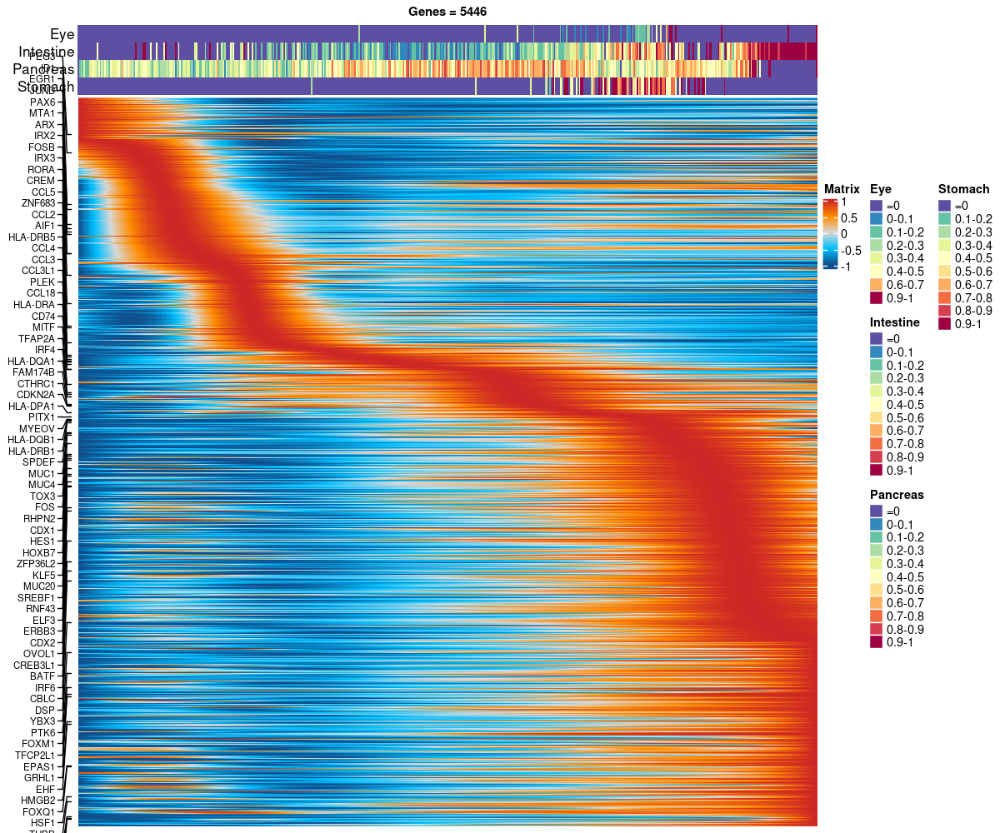

In [418]:
phtm <- ComplexHeatmap::pheatmap(pltd, color = mapal2, cluster_cols = F, border_color = NA, 
                                 fontsize_row = 1, fontsize = 8, show_rownames = FALSE,
                                 cluster_rows = FALSE, show_colnames = FALSE, use_raster=TRUE,
                                 top_annotation = HeatmapAnnotation(df = col.anno, which = "column", col = colors, annotation_name_side = "left"),
                                 main = sprintf("Genes = %s", nrow(pltd)))
ha <- ComplexHeatmap::rowAnnotation(foo=ComplexHeatmap::anno_mark(at=match(tfg.final, rownames(pltd)), side = "left",which="row",
                                                                  padding = 0.005,labels_gp=gpar(fontsize=8),
                                                                  labels=tfg.final))
options(repr.plot.width=12, repr.plot.height=10)
ha+phtm
# 因为root_state调整过，所以横坐标的前轴应该是PT细胞富集的时间

### GO enrichment - complex

In [394]:
library(clusterProfiler)
library(topGO)
library(Rgraphviz)
library(pathview)
library(org.Hs.eg.db)
library(enrichplot)
library(paletteer)

In [492]:
dim(pltd)
gx <- rownames(pltd)
# gx <- data.frame(num=1:dim(pltd)[1],gene=rownames(pltd))
length(gx)
table(is.na(gx))

[1] 5446  500

[1] 5446


FALSE  TRUE 
 5443     3 

In [490]:
which(gx=="APOE") # C2起点
which(gx=="TFF3") # C3起点
which(gx=="ABHD2") # C4起点

[1] 1893

[1] 2398

[1] 2500

'magick' package is suggested to install to give better rasterization.

Set `ht_opt$message = FALSE` to turn off this message.



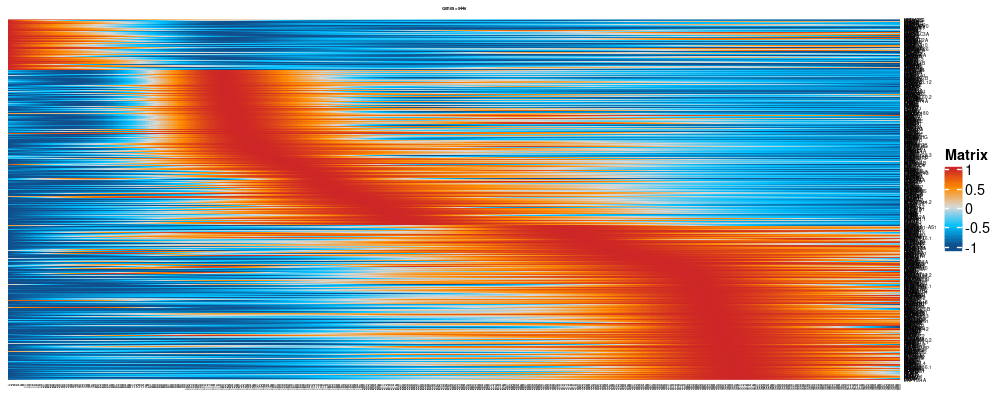

In [491]:
# plot
mapal2 <- colorRampPalette(c("dodgerblue4", "deepskyblue","grey85", "darkorange", "firebrick3"))(100)
options(repr.plot.width = 10, repr.plot.height =4, repr.plot.res = 100)
p <- ComplexHeatmap::pheatmap(pltd[c(1:100,1700:2000,2300:2600),], color = mapal2, cluster_cols = FALSE,  use_raster=TRUE,
                         fontsize_row = 3, fontsize = 2,
                         border_color = NA,
                         cluster_rows = FALSE,  
                         main = sprintf("Genes = %s", nrow(pltd)))
p

In [466]:
pdf(file = "/public/workspace202011/pancancer/Zhangcl/liver_metastasis/Figure/Epi_pseudotime_heatmap_pre.pdf", height=25, width=8)
print(p)
dev.off()

png 
  2

In [493]:
## 确认cluster划分
# cytoglist <- list(
#   C1=gx[1:145],
#   C2=gx[146:185],
#   C3=gx[186:293],
#   C4=gx[294:length(gx)]
# )
cytoglist <- list(
  C1=gx[1:1892],
  C2=gx[1893:2397],
  C3=gx[2398:2499],
  C4=gx[2500:length(gx)]
)
cytoglist

$C1
   [1] "SEMA3G"      "HSD17B6"     "PRKCH"       "USP2"        "PHKA2"      
   [6] "CELF2"       "FOXN3"       "CAMK2B"      "FGFR3"       "DRD4"       
  [11] "PLA2G10"     "SCT"         "MGAT4A"      "ARHGAP10"    "ST6GAL1"    
  [16] "FRY"         "RUNX1T1"     "SMAP2"       "CD82"        "PCBP4"      
  [21] "DPYSL2"      "BAMBI"       "FKBP5"       "TTC28"       "RPL3"       
  [26] "SUSD6"       "PRPF6"       "MAP1LC3A"    "MAPK3"       "TSC2"       
  [31] "USP31"       "GDAP1"       "NOVA2"       "AKT2"        "HPN"        
  [36] "RASA4"       "PTN"         "COBL"        "PDLIM1"      "SH3PXD2A"   
  [41] "RPL34"       "WFS1"        "TRIM2"       "ZBTB16"      "MADD"       
  [46] "PPFIBP1"     "CHD4"        "GNB3"        "GCNT2"       "SLC16A10"   
  [51] "PTK7"        "CUL9"        "MAN2A1"      "GHR"         "CDH6"       
  [56] "DPYSL3"      "FRMD4B"      "ABCC5"       "ARHGEF26"    "CCDC88A"    
  [61] "ARID3A"      "RAP1A"       "OLFML3"      "APOA1"       "PPL"        
  [66] "NR4A3"       "SORBS3"      "ECHDC2"      "CRY2"        "FAM126A"    
  [71] "CALD1"       "RASSF8"      "HIF3A"       "LRRFIP1"     "RAB17"      
  [76] "MT2A"        "TMEM53"      "F10"         "CDHR3"       "AIPL1"      
  [81] "ADCY4"       "KLF16"       "MPP1"        "CASZ1"       "PNISR"      
  [86] "HSPA12B"     "SYT11"       "DMGDH"       "PDE6A"       "ATP8A2"     
  [91] "TMCC2"       "PDE6B"       "TMTC1"       "SWAP70"      "ARGLU1"     
  [96] "KLB"         "ADAM19"      "AHI1"        "CYP27A1"     "ANKRD36"    
 [101] "PLXNC1"      "BPHL"        "DUOX1"       "PPFIA2"      "N4BP2L1"    
 [106] "FGF7"        "FURIN"       "TCF25"       "ASGR1"       "TTYH2"      
 [111] "RPL13A"      "RGS5"        "ECM1"        "PARP1"       "IQSEC1"     
 [116] "PLAC8"       "CAMK2D"      "IL2RG"       "ATP6V1B2"    "ST18"       
 [121] "ADAM12"      "LRRC4C"      "ENDOD1"      "FADS1"       "GPM6A"      
 [126] "ANK3"        "KCNE4"       "SPOCK1"      "CWF19L2"     "CARHSP1"    
 [131] "RBMS1"       "NRGN"        "ELMSAN1"     "NRG1"        "CACNA1D"    
 [136] "ACE"         "RGS12"       "ABCG1"       "PCNT"        "DIP2A"      
 [141] "CACFD1"      "PCSK7"       "CYP3A4"      "ASGR2"       "TBC1D24"    
 [146] "JAK1"        "NLRP3"       "FLVCR1"      "MAPKAPK2"    "INHBB"      
 [151] "CDC42EP3"    "CLASP2"      "PPM1L"       "CADPS"       "DNASE1L3"   
 [156] "HHIP"        "GALNT10"     "ZCCHC24"     "NDRG2"       "ARHGEF40"   
 [161] "JAM3"        "NAV2"        "MEI1"        "SERPINF2"    "LDLRAD4"    
 [166] "RAB3B"       "MT1E"        "FAM161A"     "FAXDC2"      "HSD17B13"   
 [171] "USP32"       "MTSS1"       "RPS9"        "HOPX"        "CXXC5"      
 [176] "SYNPO"       "NEGR1"       "RASGRP1"     "ZHX3"        "CA5A"       
 [181] "MCTP1"       "BAIAP2"      "RIMS2"       "NCKAP5"      "BASP1"      
 [186] "NFATC2IP"    "CHD9"        "ERICH5"      "FAM20C"      "RPS27"      
 [191] "LCORL"       "DNAJC22"     "KCTD12"      "RPH3AL"      "SPATA13"    
 [196] "CAMK1D"      "PCBP3"       "FAM162B"     "SMTN"        "NPW"        
 [201] "JAG2"        "USP18"       "F8"          "SV2B"        "PBX1"       
 [206] "RNPC3"       "FFAR4"       "RPS23"       "PDE2A"       "TEAD1"      
 [211] "SHTN1"       "PTMA"        "SAMD11"      "DPYD"        "FSIP2"      
 [216] "SRGAP3"      "ELAVL3"      "EVL"         "WNK3"        "KPNA5"      
 [221] "PDGFA"       "RPS26"       "KIF13B"      "S100A6"      "MT1F"       
 [226] "MDM4"        "HMGN2"       "CES1"        "ZDHHC18"     "AGER"       
 [231] "APOM"        "RPS29"       "TINCR"       "XIST"        "RPS28"      
 [236] "SMIM1"       "AMY2B"       "PALM2"       "NAIP"        "MALAT1"     
 [241] "SNHG25"      "MYO15B"      "TAC1"        "SLC18A1"     "ITIH1"      
 [246] "GUCY2C"      "CDHR5"       "SFRP1"       "PROC"        "TPH1"       
 [251] "DDC"         "ANGPTL3"     "STRA6"       "CCDC33"      "CRB2"       
 [256] "RAB3C"       "FTCD"        "HCN1"        "MS4A8"       "SLC38

In [494]:
gotable2 <- NULL
for(k in names(cytoglist)){
  ego <- enrichGO(gene = cytoglist[[k]],
                  OrgDb = org.Hs.eg.db,
                  keyType = 'SYMBOL',
                  ont = "BP",
                  pAdjustMethod = "BH",
                  pvalueCutoff  = 0.01,
                  qvalueCutoff  = 0.05)
  gotable2 <- rbind(gotable2, ego@result %>% mutate(cluster=k))
  saveRDS(ego, file = paste0("/public/workspace202011/pancancer/Zhangcl/liver_metastasis/epithelial_analysis/complex/epi_pseudotime_GO_cluster",k,".rds"))
}

In [495]:
write.csv(gotable2, 
          file = "/public/workspace202011/pancancer/Zhangcl/liver_metastasis/epithelial_analysis/complex/epi_pseudotime_GO_all_res.csv")

In [507]:
gotable2

,ID,Description,GeneRatio,BgRatio,pvalue,p.adjust,qvalue,geneID,Count,cluster
,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<chr>,<int>,<chr>
GO:0030198,GO:0030198,extracellular matrix organization,110/1679,395/18866,2.110626e-28,7.905552e-25,5.441610e-25,HPN/SH3PXD2A/ADAM19/FURIN/ADAM12/CLASP2/JAM3/SERPINF2/PDGFA/GFOD2/PHLDB2/HTRA1/NTNG2/ITGA7/TTR/SMOC1/KLKB1/VTN/ADAMTSL2/FGB/ERO1B/AGT/ADAMTS2/CTSL/FGA/RAMP2/NID1/LOXL2/VWF/ITGA1/EGFL6/SPOCK2/KDR/COL15A1/LAMA4/MYH11/RGCC/JAM2/HAPLN1/COL4A1/ITGAL/SERPINE1/COL10A1/PECAM1/MMP11/TGFB1/COL4A2/CCDC80/CRISPLD2/FOXF1/ITGA11/DPT/FBN1/ITGA4/ETS1/TNF/COL5A1/ADAMTS4/ITGA5/VCAM1/COL3A1/OLFML2A/FAP/PXDN/SULF1/THBS1/CYP1B1/COL14A1/COL5A2/ECM2/POSTN/COL6A2/ADAMTS1/COL1A2/FLRT2/DCN/FBLN1/COL1A1/PDGFRA/COL6A3/SFRP2/ENG/COL12A1/COL6A1/ANTXR1/SPARC/MATN3/LUM/ABI3BP/TNXB/COL11A1/COL8A1/ADAMTS5/LAMA2/FBLN5/LCP1/MFAP4/BGN/EMILIN1/DDR2/MMP19/IL6/MFAP5/MMP2/COL18A1/A2M/LOX/PDPN/FN1/COMP,110,C1
GO:0043062,GO:0043062,extracellular structure organization,110/1679,396/18866,2.677126e-28,7.905552e-25,5.441610e-25,HPN/SH3PXD2A/ADAM19/FURIN/ADAM12/CLASP2/JAM3/SERPINF2/PDGFA/GFOD2/PHLDB2/HTRA1/NTNG2/ITGA7/TTR/SMOC1/KLKB1/VTN/ADAMTSL2/FGB/ERO1B/AGT/ADAMTS2/CTSL/FGA/RAMP2/NID1/LOXL2/VWF/ITGA1/EGFL6/SPOCK2/KDR/COL15A1/LAMA4/MYH11/RGCC/JAM2/HAPLN1/COL4A1/ITGAL/SERPINE1/COL10A1/PECAM1/MMP11/TGFB1/COL4A2/CCDC80/CRISPLD2/FOXF1/ITGA11/DPT/FBN1/ITGA4/ETS1/TNF/COL5A1/ADAMTS4/ITGA5/VCAM1/COL3A1/OLFML2A/FAP/PXDN/SULF1/THBS1/CYP1B1/COL14A1/COL5A2/ECM2/POSTN/COL6A2/ADAMTS1/COL1A2/FLRT2/DCN/FBLN1/COL1A1/PDGFRA/COL6A3/SFRP2/ENG/COL12A1/COL6A1/ANTXR1/SPARC/MATN3/LUM/ABI3BP/TNXB/COL11A1/COL8A1/ADAMTS5/LAMA2/FBLN5/LCP1/MFAP4/BGN/EMILIN1/DDR2/MMP19/IL6/MFAP5/MMP2/COL18A1/A2M/LOX/PDPN/FN1/COMP,110,C1
GO:0045785,GO:0045785,positive regulation of cell adhesion,108/1679,428/18866,4.549076e-24,8.955614e-21,6.164397e-21,PTN/ZBTB16/GCNT2/APOA1/NR4A3/ADAM19/ANK3/JAK1/NLRP3/SERPINF2/RASGRP1/AGER/SFRP1/ZFHX3/DUSP26/EDIL3/STAT5B/FLCN/NRP1/NEDD9/KIFAP3/SELENOK/CSPG5/FOXA2/WNT4/EGR3/PAK3/VTN/IGFBP2/FGB/CX3CL1/FGA/CD81/CYLD/CD36/MYADM/NID1/WNT5A/ANGPT1/IL6ST/EGFL6/TEK/SPOCK2/KDR/SELE/UTRN/NFKBID/ATM/THY1/SELP/FYN/GRAP2/PREX1/ZAP70/NCKAP1L/SKAP1/CDH13/RUNX3/CASS4/RASAL3/TESPA1/CD28/CCDC80/FOXF1/DOCK8/CD6/IGF1/PTPRC/CD160/SIRPG/IFNG/ITGA4/PTPN22/ETS1/CD27/TNF/SASH3/ITGA5/VCAM1/IL7R/SOCS1/APBB1IP/CHRD/CORO1A/RHOH/LCK/CD40LG/ECM2/GATA3/TNFSF14/CD3E/CCR7/CCL5/SFRP2/ABI3BP/COL8A1/CXCL12/CD83/EMILIN1/ICOS/IL6/PDCD1/CCL2/IL10/XCL1/PDPN/FN1/DYSF,108,C1
GO:0042110,GO:0042110,T cell activation,111/1679,483/18866,3.320729e-21,4.903056e-18,3.374909e-18,ZBTB16/NLRP3/RASGRP1/JAG2/KIF13B/AGER/RAB27A/STAT3/TOX/PSAP/STAT5B/SELENOK/SFTPD/WNT4/PRDX2/EGR1/EGR3/PAK3/PRKAR1A/ARG1/MAFB/IGFBP2/LMO1/FGL1/CTSL/ZEB1/CD81/INS/CYLD/NFATC2/IL6ST/RORA/LAX1/IRF1/LRRC32/NFKBID/LAG3/THY1/ITGAL/FYN/GRAP2/PREX1/EOMES/TBX21/ZAP70/NCKAP1L/THEMIS/RUNX3/RASAL3/TESPA1/JAML/CD28/DOCK8/ITK/LY9/CAMK4/SPN/CD6/IGF1/PTPRC/CD160/BCL2/TCF7/SIRPG/IFNG/PTPN22/CD27/PTGER4/SEMA4A/RIPOR2/CD2/SASH3/VCAM1/SLAMF6/IL7R/SOCS1/LAT/WAS/APBB1IP/SLA2/CORO1A/RHOH/LCK/CD40LG/GATA3/RUNX2/TNFSF14/CD3E/CCR7/DOCK2/CD3G/TIGIT/CCL5/CD8A/ZNF683/CRTAM/LCP1/SIT1/MSN/CD83/ICOS/FGL2/CD7/CD3D/IL6/PDCD1/CCL2/GPR183/IL10/XCL1/TNFRSF4,111,C1
GO:0022407,GO:0022407,regulation of cell-cell adhesion,98/1679,439/18866,6.269967e-18,7.406085e-15,5.097813e-15,ZBTB16/GCNT2/APOA1/NR4A3/SWAP70/ADAM19/ANK3/JAK1/NLRP3/SERPINF2/RASGRP1/AGER/STAT5B/ABAT/KIFAP3/SELENOK/FOXA2/SFTPD/WNT4/PRDX2/EGR3/PAK3/PRKAR1A/ARG1/RDX/IGFBP2/FGB/SERPINE2/FGL1/CX3CL1/FGA/CD81/CYLD/MYADM/WNT5A/IL6ST/SH2B3/SELE/RGCC/LAX1/IRF1/LRRC32/NFKBID/NOTCH4/LAG3/THY1/SELP/FYN/GRAP2/TBX21/TGFB1/AKNA/ZAP70/NCKAP1L/SKAP1/RUNX3/RASAL3/TESPA1/CD28/DOCK8/SPN/CD6/IGF1/PTPRC/CD160/SIRPG/IFNG/ITGA4/PTPN22/ETS1/CD27/TNF/RIPOR2/SASH3/VCAM1/IL7R/SOCS1/CORO1A/RHOH/LCK/CD40LG/GATA3/TNFSF14/CD3E/CCR7/TIGIT/CCL5/CRTAM/CXCL12/CD83/ICOS/FGL2/IL6/PDCD1/CCL2/IL10/XCL1/PDPN,98,C1
GO:0022409,GO:0022409,positive regulation of cell-cell adhesion,70/1679,279/18866,7.004771e-16,6.895029e-13,4.746

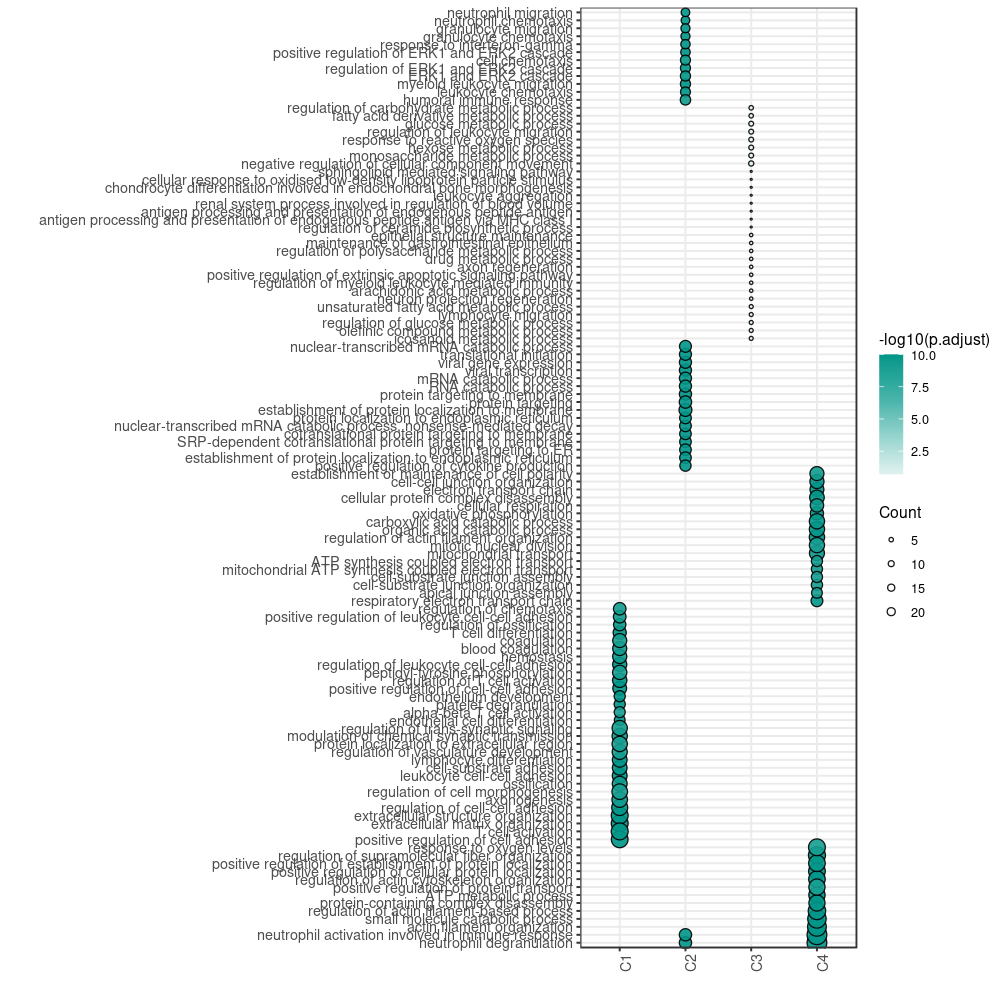

In [517]:
## Visualize 自己的版本

res <- gotable2
res$score <- -log10(res$p.adjust)
res$score[res$score > 10] <- 10
res <- res %>% dplyr::group_by(cluster) %>% dplyr::slice_max(order_by = score, n = 30, with_ties=FALSE)

mat <- res %>% 
dplyr::select(-ID, -GeneRatio, -BgRatio,  -pvalue, -p.adjust, -qvalue, -geneID, -score) %>%  
tidyr::pivot_wider(names_from = cluster, values_from = Count) %>% data.frame() 
row.names(mat) <- mat$Description  # put gene in `row`
mat <- mat[,-1] #drop gene column as now in rows
mat[is.na(mat)] <- 0
clust <- hclust(dist(mat %>% as.matrix())) # hclust with distance matrix
res$Description <- factor(res$Description, levels = clust$labels[clust$order])

p <- ggplot2::ggplot(res, aes(x=cluster, y=Description)) + 
        ggplot2::geom_point(aes(size= Count, fill = score),shape=21,alpha=0.9) +
        ggplot2::scale_fill_gradientn(colours =paletteer_d("ggsci::teal_material")[1:6]
        #                                   values = c(0,0.2,0.3,0.5,1)
                                     ) +
        ggplot2::theme_bw() + 
        ggplot2::theme(axis.text.x = element_text(angle = 90, vjust = 1, hjust=1,size=10),
                       axis.text.y =element_text(size=10)) +
        ggplot2::scale_size_continuous(range = c(0,6), breaks = c(5,10,15,20)) + 
        ggplot2::ylab('') + ggplot2::xlab("") +
        ggplot2::labs(fill = "-log10(p.adjust)", size="Count") 
options(repr.plot.width=10, repr.plot.height=10)
p

In [519]:
pdf(file = "/public/workspace202011/pancancer/Zhangcl/liver_metastasis/Figure/Epi_pseudotime_cluster_GO_enrich_pre.pdf", height=15, width=8)
print(p)
dev.off()

png 
  2

In [497]:
plotGO <- function(res, top_n=10, scale_size=c(1,6), color=paletteer_d("ggsci::teal_material")[1:6]){
  res$score <- -log10(res$p.adjust)
  res$score[res$score > 10] <- 10
  res$Description <- stringr::str_trunc(res$Description, 100, "right")
  res <- res %>% dplyr::group_by(cluster) %>% dplyr::slice_max(order_by = score, n = top_n, with_ties=FALSE)
  
  mat <- res %>% 
    dplyr::select(-ID, -GeneRatio, -BgRatio,  -pvalue, -p.adjust, -qvalue, -geneID, -score) %>%  
    tidyr::pivot_wider(names_from = cluster, values_from = Count) %>% data.frame() 
  row.names(mat) <- mat$Description  # put gene in `row`
  mat <- mat[,-1] #drop gene column as now in rows
  mat[is.na(mat)] <- 0
  clust <- hclust(dist(mat %>% as.matrix())) # hclust with distance matrix
  res$Description <- factor(res$Description, levels = clust$labels[clust$order])
  p <- ggplot2::ggplot(res, aes(x=cluster, y=Description)) + 
    ggplot2::geom_point(aes(size= Count, fill = score),shape=21,alpha=0.9) +
    ggplot2::scale_fill_gradientn(colours =color, 
#                                   values = c(0,0.2,0.3,0.5,1)
                                 ) +
    ggplot2::theme_bw() + ggplot2::theme(axis.text.x = element_text(angle = 90, vjust = 1, hjust=1)) +
    ggplot2::scale_size_continuous(range = scale_size, breaks = c(5,10,15,20)) + 
    ggplot2::ylab('') + ggplot2::xlab("") +
    ggplot2::labs(fill = "-log10(p.adjust)", size="Count") 
  p
}

In [407]:
-log10(0.001)

[1] 3

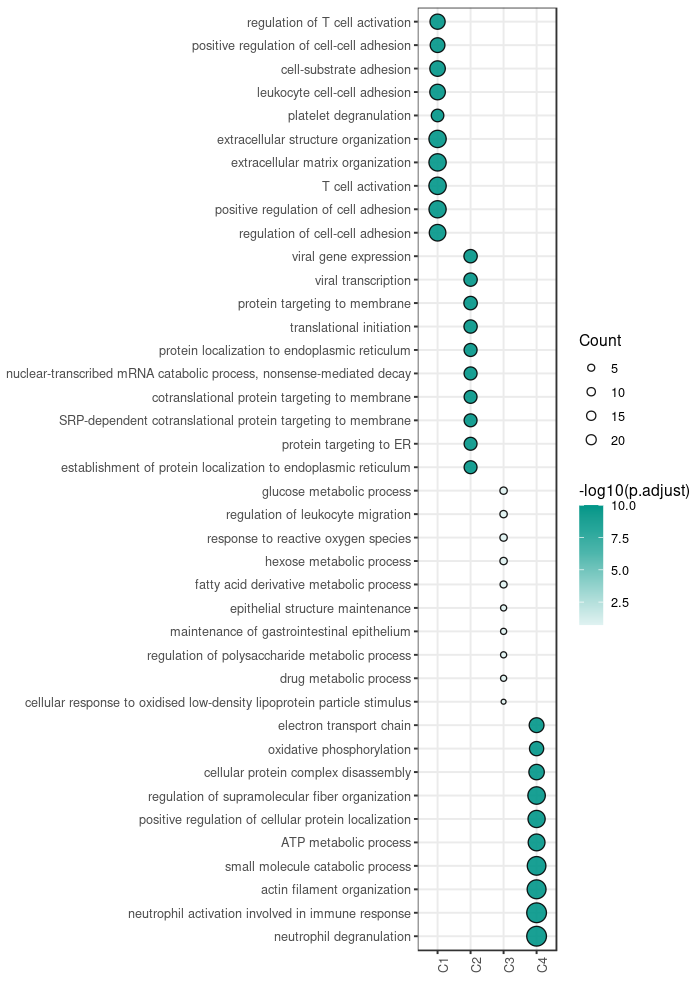

In [498]:
options(repr.plot.width=7, repr.plot.height=10, res=200)
print(plotGO(gotable2))

### GO enrichment

In [354]:
library(clusterProfiler)
library(topGO)
library(Rgraphviz)
library(pathview)
library(org.Hs.eg.db)
library(enrichplot)



clusterProfiler v4.3.2.991  For help: https://yulab-smu.top/biomedical-knowledge-mining-book/

If you use clusterProfiler in published research, please cite:
T Wu, E Hu, S Xu, M Chen, P Guo, Z Dai, T Feng, L Zhou, W Tang, L Zhan, X Fu, S Liu, X Bo, and G Yu. clusterProfiler 4.0: A universal enrichment tool for interpreting omics data. The Innovation. 2021, 2(3):100141


Attaching package: ‘clusterProfiler’


The following object is masked from ‘package:purrr’:

    simplify


The following object is masked from ‘package:stats’:

    filter


Loading required package: graph


Attaching package: ‘graph’


The following object is masked from ‘package:stringr’:

    boundary


The following object is masked from ‘package:circlize’:

    degree


Loading required package: GO.db

Loading required package: AnnotationDbi

Loading required package: IRanges

Loading required package: S4Vectors


Attaching package: ‘S4Vectors’


The following object is masked from ‘package:clusterProfiler’:

  

In [352]:
head(clusters)

,cluster
,<chr>
TSPAN6,1
DPM1,1
CFH,2
FUCA2,1
GCLC,3
LAS1L,1


In [355]:
## 做GO富集分析
for(i in unique(clusters$cluster)){
    enrich.df <- filter(clusters, cluster==i)
    genes <- rownames(enrich.df)
#     genes <- mapIds(x = org.Hs.eg.db, keys = rownames(enrich.df), keytype = "ENSEMBL", column = "SYMBOL") # 如果需要转换ID
    enrich.results <- enrichGO(gene = genes, OrgDb = org.Hs.eg.db, keyType = "SYMBOL", ont = "BP", pvalueCutoff = 0.05, qvalueCutoff = 0.05)
    saveRDS(enrich.results, file = paste0("/public/workspace202011/pancancer/Zhangcl/liver_metastasis/epithelial_analysis/epi_pseudotime_GO_cluster",i,".rds"))
}

In [356]:
## 构建可视化数据框
all_enrich.df <- data.frame()
for(i in unique(clusters$cluster)){

    enrich.results <- readRDS(file = paste0(dir2,"epi_pseudotime_GO_cluster",i,".rds"))
    enrich.df <- enrich.results@result %>% filter(p.adjust <0.01 & Count>10)
    enrich.df$cluster <- paste0("Cluster ",i)
    all_enrich.df <- rbind(all_enrich.df, enrich.df)  
}
all_enrich.df$cluster <- factor(all_enrich.df$cluster, levels = c("Cluster 2","Cluster 3","Cluster 1","Cluster 4"))
all_enrich.df

,ID,Description,GeneRatio,BgRatio,pvalue,p.adjust,qvalue,geneID,Count,cluster
,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<chr>,<int>,<fct>
GO:0008380,GO:0008380,RNA splicing,273/5011,487/18866,4.196183e-44,2.673388e-40,2.121060e-40,RBM5/KDM1A/RBM6/POLR2J/GCFC2/AKAP8L/PTBP1/AQR/ZCCHC8/POLR2B/THOC3/THRAP3/CCAR1/SNRNP40/SFSWAP/U2AF2/SPEN/CDK13/YBX1/DHX8/GPKOW/JMJD6/DAZAP1/CPSF1/CLNS1A/ZNF638/RBM7/MBNL3/XAB2/SNRPA/DDX1/YTHDC1/PPIE/REST/SRRT/SF3B2/KHSRP/RBM41/PAPOLA/PDCD7/HNRNPC/SRPK1/CDC5L/HNRNPH3/HNRNPM/POLR2E/SF3A1/SNRPD3/SNU13/POLR2F/DDX17/RTCB/ZMAT5/RBFOX2/PHF5A/PRMT5/SNW1/ACIN1/PNN/PRPF6/CRNKL1/FMR1/PQBP1/POLR2C/ESRP2/ESRP1/HNRNPL/SNRNP70/CLASRP/SF3A2/HNRNPUL1/PPP2R1A/PRPF31/BUD31/RBM28/SETX/CASC3/PPP1R9B/EFTUD2/SUPT6H/DHX15/PPARGC1A/ZPR1/DCPS/PRPF19/NUP98/MAGOHB/SRSF3/PRPF4B/IK/CLK4/PPP2CA/PPWD1/TCERG1/USP4/FXR1/NCBP2/NCL/SF3B6/SF3B1/TIA1/SRSF4/WDR77/SFPQ/IVNS1ABP/SRSF11/TTF2/RRAGC/PRDX6/SYF2/PPP1R8/CPSF3/RBM25/SMNDC1/WBP4/TARDBP/COIL/PSPC1/KHDRBS1/HNRNPA2B1/SMU1/ECD/DDX39A/ZC3H13/SRSF6/MPHOSPH10/SNRPC/UPF3B/RNF113A/GTF2F1/THOC2/SNRPD2/SYMPK/SNRPB/SNRPB2/HNRNPR/RALY/RBM42/SCAF1/NSRP1/DNAJC8/LSM8/LSM7/LSM4/RBM39/THOC6/SNRPA1/GRSF1/ZRANB2/PRMT7/CTNNBL1/SRRM1/PRPF38B/RBM17/RBMX2/PRPF38A/SRPK2/SYNCRIP/DHX9/SRSF1/WDR33/PRPF4/PPIL1/TGS1/PPIG/CIR1/HNRNPD/SCAF11/SNRPF/TMBIM6/MBNL2/MFAP1/EIF4A3/GEMIN7/PRCC/SF3B4/HNRNPLL/SNRPG/SNRNP200/POLR2D/FIP1L1/PIK3R1/DDX46/WTAP/LUC7L2/NONO/CELF1/CPSF7/TRPT1/CWC15/SAP18/GEMIN6/MBNL1/HNRNPU/U2AF1/RRP1B/CPSF4/SRSF2/SNRNP25/MAGOH/RAVER2/ZNF326/SCNM1/IWS1/CWC22/PPP4R2/THOC7/U2SURP/SNIP1/POLR2H/LSM6/TRA2A/RP9/FASTK/HNRNPK/PRPF18/CPSF2/NUDT21/SNRPD1/CDK12/POLR2G/SF1/CDC40/USP39/CD2BP2/SNUPN/HNRNPF/SF3B5/HNRNPA3/LSM3/TSEN34/FAM98B/PLRG1/PPIH/RBM4/PRPF8/DDX23/RSRC1/LSM1/SART1/ZBTB8OS/CLK3/PUF60/SNRPE/TSEN54/RBM10/SF3A3/RBM12B/SNRNP35/GTF2F2/SRSF10/SF3B3/PRPF40A/AKAP17A/DDX42/DDX39B/TSEN15/LSM2/DHX16/RNPS1/RBMXL1/PPIL3/ISY1/RBM12/RBM8A/TAF15/CWC25/SLC39A5/KHDC4/C2orf49/VIRMA/C9orf78/RTRAF,273,Cluster 1
GO:0022613,GO:0022613,ribonucleoprotein complex biogenesis,264/5011,482/18866,3.203428e-40,1.020452e-36,8.096242e-37,LAS1L/RBM5/GCFC2/RPUSD1/UTP18/TFB1M/LSG1/NOP16/MRTO4/NOP58/USP36/SFSWAP/WDR18/THUMPD1/RRP15/NLE1/CLNS1A/EXOSC7/XAB2/EXOSC5/XRCC5/DDX1/MRPL22/XPO1/DIS3/NUFIP1/YTHDC1/EIF3I/DIMT1/NOP14/DDX18/XRN2/ESF1/SRPK1/SF3A1/SNRPD3/PES1/EIF3L/SNU13/DDX17/EIF3D/PRMT5/EIF5/PRPF6/MTG2/CRNKL1/NOP56/RBFA/PIN4/ERI1/PIH1D1/SF3A2/FBL/PRPF31/DDX49/GTPBP10/EIF3B/EIF4H/SETX/EXOSC3/EIF3A/NPM3/GTPBP4/NUP88/FTSJ3/UTP6/GAR1/PRPF19/PTGES3/CPSF6/KRR1/NOP2/PAK1IP1/MDN1/BYSL/BRIX1/USP4/RRP9/SF3B1/NOL10/CEBPZ/WDR77/RPF1/ZNHIT6/EBNA1BP2/FASTKD2/RCL1/WDR55/EXOSC8/UTP20/COIL/GTF3A/MTERF4/MRPS2/MRM2/DDX54/SRSF6/DDX27/MPHOSPH10/RRP36/SNRPC/RIOK1/RPP40/MRPS7/SNRPD2/SNRPB/EIF2S2/SBDS/EMG1/KRI1/NGDN/GNL3L/NSUN5/LSM4/EIF2S3/DKC1/NOL11/TRAF7/DHX30/RAN/ERAL1/PRMT7/NIP7/WDR74/CDC73/GNL2/SRPK2/LTV1/MPHOSPH6/GLUL/RNASEL/DHX9/PWP1/DDX56/SRSF1/IMP4/TGS1/RSL24D1/METTL5/WDR12/SCAF11/SNRPF/TARBP2/DENR/CUL4A/UTP4/NOB1/PELP1/EIF4A3/URB1/GEMIN7/RRNAD1/ISG20L2/EIF2D/SNRPG/SNRNP200/POLR2D/EIF2A/LYAR/NHP2/ABT1/RPL7L1/NOM1/LUC7L2/UTP23/SURF6/REXO4/RPP30/PDCD11/EIF3M/CELF1/CPSF7/SRFBP1/GEMIN6/RPP38/NIFK/MTERF3/UTP14A/MALSU1/RPUSD3/CUL4B/TSR2/MRPL10/RRP1B/RRP1/FAM207A/ADAR/TFB2M/WDR43/ABCE1/LSM6/DCAF13/RPUSD4/PRPF18/TSC1/DDX21/BMS1/METTL17/NOLC1/NUDT21/SNRPD1/POP5/TSR1/SF1/USP39/CD2BP2/NMD3/SNUPN/METTL15/PA2G4/EXOSC1/CHD7/MRPL36/RSL1D1/EXOSC10/RPS21/POP7/PRPF8/DDX23/MRPL11/EIF3F/SART1/RUVBL1/IMP3/DDX10/RPP25/RRS1/PUF60/MRPS11/SNRPE/YBEY/RUVBL2/SF3A3/UTP11/TBL3/NOC4L/SRSF10/NOC2L/RRP7A/C1D/RPF2/NOL8/SDAD1/DDX39B/NUDT16/LSM2/WDR46/MCTS1/ISY1/EIF6/MRPL20/PRKDC/UTP14C/BOP1/GTF2H5/ZNHIT3/TAF9/AATF/DDX52/KHDC4/UTP25/RIOX2/BUD23/NOP53,264,Cluster 1
GO:0000375,GO:0000375,"RNA splicing, via transesterification reactions",217/5011,393/18866,6.742212e-34,1.262615e-30,1.001756e-30,RBM5/KDM1A/RBM6/POLR2J/GCFC2/PTBP1/AQR/ZCCHC8/POLR2B/THRAP3/CCAR1/SNRNP40/SFSWAP/U2AF2/SPEN/CDK13/YBX1/DHX8/GPKOW/JMJD6/DAZAP1/CPSF1/CLNS1A/RBM7/MBNL3/XAB2/SNRPA/DDX1/YTHDC1/PPIE/REST/SRR

In [357]:
write.csv(all_enrich.df, file = "/public/workspace202011/pancancer/Zhangcl/liver_metastasis/epithelial_analysis/epi_pseudotime_cluster_GO_res.csv")

### key pseudotime gene in CP2

In [ ]:
## 从抗原递呈相关的通路中筛选出关键基因
c(  # 通路中看到的
    "LILRB2", #抑制性受体，与抗原呈递细胞上的 MHC I 类分子结合，并转导抑制免疫反应刺激的负信号。
    "CCL21",# 趋化因子，吸引T细胞，特别是初始T细胞。
    "ICAM1",# 可能被肿瘤利用转移
    "HAVCR2" # 与 LGALS9 结合被认为会导致 T 细胞反应的抑制
    # 以下是原热图上有的
    "CCL3", #招募单核巨噬T细胞，结合CCR1和CCR5
    "CCL3L1", # 与CCL3同源
    "CCL2", #招募单核巨噬细胞
    "CCL4", # 招募NK，巨噬，T，结合CCR5
    "HLA-DRB1", # 负责将外源性抗原呈递给T细胞激活免疫反应
    "HLA-DQB1",
    "HLA-DQA1",
    "CTHRC1",# 参与细胞外基质重塑，促进细胞迁移肿瘤侵袭
    "IRF4", # 负向调节 Toll 样受体 （TLR） 信号转导, 多发性骨髓瘤相关
    "MITF", # 再黑色素瘤中高度表达，调控肿瘤细胞增殖
    "CD74",# MHC II的伴侣蛋白，在某些癌症中高表达
    "CCL18", # 趋化因子，与肿瘤相关巨噬细胞的免疫抑制微环境形成相关。
    "PLEK", # 调控细胞信号传导和骨架重组，可能再免疫细胞功能和肿瘤侵袭中起作用。
    
 
 )

In [31]:
obj

An object of class Seurat 
64751 features across 16719 samples within 3 assays 
Active assay: RNA (33538 features, 0 variable features)
 2 other assays present: SCT, integrated
 2 dimensional reductions calculated: pca, umap

In [32]:
refGenes <- obj@misc$geneName
if(!any(is.na(refGenes[rownames(obj@assays$RNA@data)]))){
rownames(obj@assays$RNA@data) <- refGenes[rownames(obj@assays$RNA@data)]
}
head(rownames(obj@assays$RNA@data), n=1)

ENSG00000000003 
       "TSPAN6"

In [33]:
label.x <- 1
label.size <- 5
# comparisons <- list(c("CP5","CP1"),c("CP5","CP2"),c("CP5","CP3"),c("CP5","CP4"),c("CP5","CP6"))

In [552]:
gene.need <- "LILRB2"
df <- dplyr::select(obj@meta.data, c(sampleID,cluster,tissue)) %>% 
  cbind(score = GetAssayData(object=obj, assay ="RNA", slot = "data")[gene.need,]) %>% filter(tissue %in% c("Pancreas","Intestine"))
df$cluster[is.na(df$cluster)==TRUE] <- "others" 
# df <- filter(df, cluster !=) 
max(df$score)
min(df$score)
df

[1] 2.987317

[1] 0

,sampleID,cluster,tissue,score
,<chr>,<chr>,<chr>,<dbl>
GSM5387660@@_GACGTGCAGGAGTAGA_COL07_CRC,CRC01-PT,others,Intestine,0
GSM5387660@@_GAGTCCGGTAGCTGCC_COL07_CRC,CRC01-PT,others,Intestine,0
GSM5387660@@_CTCATTAAGTGTGGCA_COL07_CRC,CRC01-PT,others,Intestine,0
GSM5387668@@_GTTCGGGTCCGCAGTG_COL16_LM,CRC03-HM,CP6,Intestine,0
GSM5387660@@_GTGGGTCGTGGTCCGT_COL07_CRC,CRC01-PT,others,Intestine,0
GSM5387660@@_CCACTACCACACAGAG_COL07_CRC,CRC01-PT,others,Intestine,0
GSM5387660@@_ACAGCCGGTCTTTCAT_COL07_CRC,CRC01-PT,others,Intestine,0
GSM5387660@@_TGCGGGTCAATCAGAA_COL07_CRC,CRC01-PT,others,Intestine,0
P2_MT@@_TCCACCACAAGTATAG-1,PDAC02-HM,CP6,Pancreas,0


In [555]:
table(df$cluster)
table(df$score>0)


   CP1    CP2    CP6 others 
  2338   2371    868   6443 


FALSE  TRUE 
11937    83 

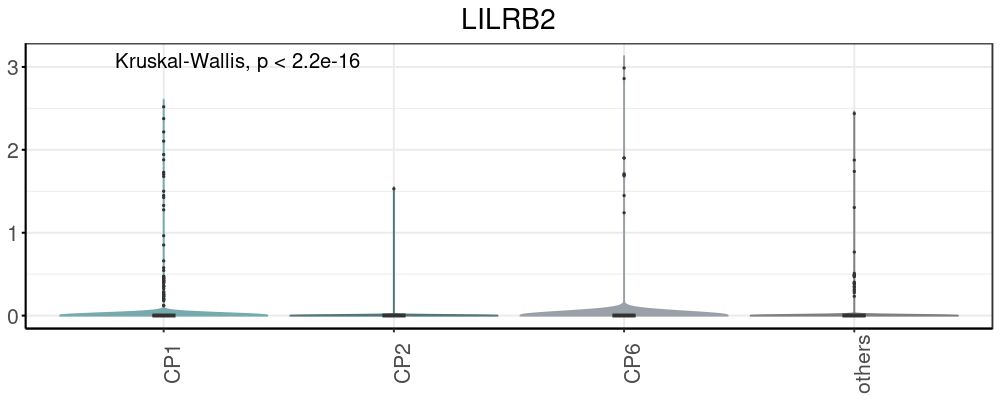

In [556]:
options(repr.plot.width = 10, repr.plot.height =4, repr.plot.res = 100)
p1 <- ggplot(df, aes(x = cluster, y = score)) +
# p1 <- ggplot(filter(df, score >0), aes(x = cluster, y = score)) +
        labs(x=NULL, y =NULL) + ggtitle(gene.need)+
        geom_violin(aes(color=cluster, fill=cluster), scale = "width", bounds = c(0,Inf),trim = FALSE)+
        geom_boxplot(width = 0.1, outlier.size = 0)+
        stat_compare_means(label.x = label.x, size = label.size)+
#         stat_compare_means(comparisons = comparisons, label="p.signif",hide.ns = TRUE)+
        theme_bw() +
        scale_color_manual(values=color_cluster)+scale_fill_manual(values=color_cluster)+
         theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = 20),      ##设置坐标轴文本字体            
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
           axis.text.x = element_text(size=15, angle = 90),
            axis.ticks.y=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = 20),
            scale_y_continuous(limits = c(0,5), breaks = seq(0,5,1)),
            legend.position="none")
p1


## relevance between cytotrace & monocle

In [298]:
pData(cds)

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt,nGene,nUMI,nCount_SCT,nFeature_SCT,seurat_clusters,integrated_snn_res.2,⋯,n,minor,group,patient,CytoTRACE,Size_Factor,num_genes_expressed,Total_mRNAs,Pseudotime,State
,<chr>,<dbl>,<int>,<dbl>,<int>,<dbl>,<dbl>,<int>,<fct>,<fct>,⋯,<int>,<fct>,<chr>,<chr>,<dbl>,<dbl>,<int>,<dbl>,<dbl>,<fct>
GSM5387660@@_GACGTGCAGGAGTAGA_COL07_CRC,GSM5387660,6790.00,1619,5.8173785,1619,6790.00,3032,1227,11,11,⋯,11148,c099,PT,CRC01,0.4629009,1.5904356,1619,6790.00,34.42415,5
GSM5387660@@_GAGTCCGGTAGCTGCC_COL07_CRC,GSM5387660,1191.00,559,3.6943745,559,1191.00,1991,572,39,39,⋯,11148,c099,PT,CRC01,0.6136908,0.2789704,559,1191.00,38.89594,3
GSM5387660@@_CTCATTAAGTGTGGCA_COL07_CRC,GSM5387660,1847.00,657,0.3248511,657,1847.00,2140,657,11,11,⋯,11148,c099,PT,CRC01,0.4044998,0.4326266,657,1847.00,39.13892,3
GSM4147094@@_GTCACGGTCAGGTTCA-1,GSM4147094,12565.00,3129,1.2972543,3129,12565.00,2839,1123,39,39,⋯,11148,c099,PT,UVM05,0.8994734,2.9431257,3129,12565.00,56.15624,1
GSM5387668@@_GTTCGGGTCCGCAGTG_COL16_LM,GSM5387668,4733.00,759,4.1200085,759,4733.00,2802,709,39,39,⋯,11148,c099,HM,CRC03,0.5461944,1.1086203,759,4733.00,39.49205,1
GSM5387660@@_GTGGGTCGTGGTCCGT_COL07_CRC,GSM5387660,2272.00,831,8.1426056,831,2272.00,2295,831,11,11,⋯,11148,c099,PT,CRC01,0.4054572,0.5321752,831,2272.00,38.99537,3
GSM5387660@@_CCACTACCACACAGAG_COL07_CRC,GSM5387660,15925.00,3611,3.5102041,3611,15925.00,3046,1295,11,11,⋯,11148,c099,PT,CRC01,0.8410723,3.7301454,3611,15925.00,23.58434,5
GSM5387660@@_ACAGCCGGTCTTTCAT_COL07_CRC,GSM5387660,13239.00,3188,2.2509253,3188,13239.00,2857,1148,11,11,⋯,11148,c099,PT,CRC01,0.8434658,3.1009981,3188,13239.00,23.67378,5
GSM5387660@@_TGCGGGTCAATCAGAA_COL07_CRC,GSM5387660,9678.00,1963,2.2421988,1963,9678.00,2612,714,11,11,⋯,11148,c099,PT,CRC01,0.5548109,2.2668978,1963,9678.00,33.40799,5


In [306]:
obj$Pseudotime <- pData(cds)[Cells(obj), 'Pseudotime'] 

`geom_smooth()` using formula = 'y ~ x'


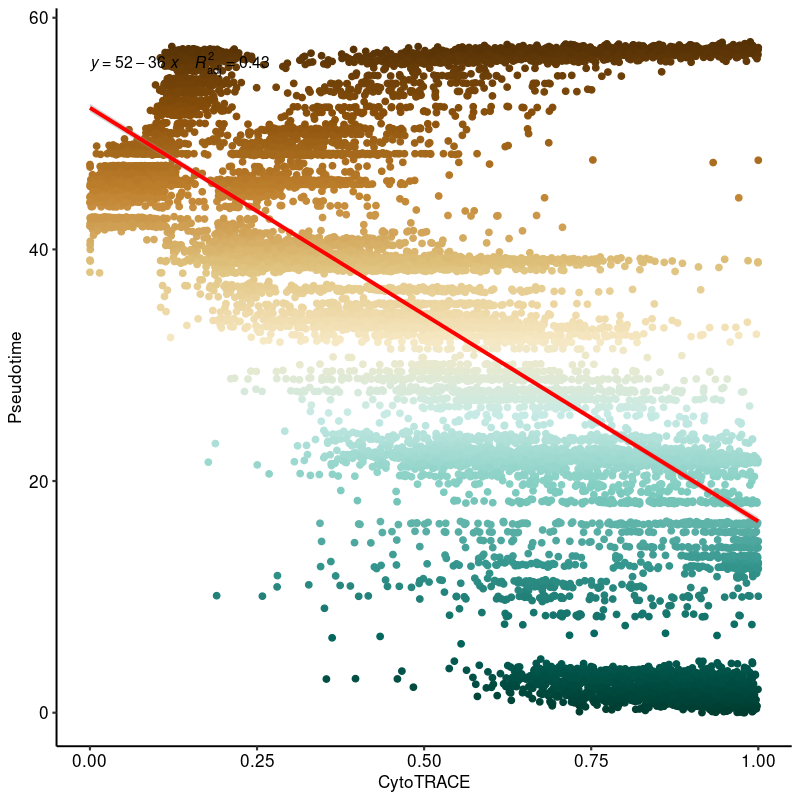

In [312]:
options(repr.plot.width=8, repr.plot.height=8)
# 所有细胞
p5 <- pData(cds) %>% ggplot(aes(x=CytoTRACE, y=Pseudotime)) + 
  geom_point(aes(color=Pseudotime)) + 
  geom_smooth(color='red', method = lm) + 
  scale_colour_gradientn(colours = rev(brewer.brbg(10))) +
  stat_regline_equation(aes(label=paste(..eq.label.., ..adj.rr.label.., sep = "~~~~"))) + 
  theme_pubr() + NoLegend()
p5

In [ ]:
p1 <- ggplot(df.target, aes(x=primary, y=subtype)) +
     geom_point(aes(color=cluster),size = 4) +
    geom_smooth(method = "lm")+
    stat_cor(method = "pearson",label.x = 0, label.y = 1.5, size=label.size) +
    scale_color_manual(values = color_cluster) +

    theme_bw() +
    theme(axis.title = element_text(size=title.size), legend.position = "none")

`geom_smooth()` using formula = 'y ~ x'


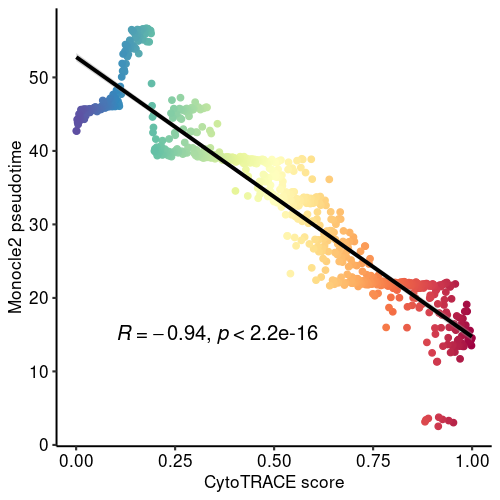

In [318]:
options(repr.plot.width=5, repr.plot.height=5)
# 取中值
p6 <- obj@meta.data %>% mutate(rank=rank(-CytoTRACE)) %>%
  mutate(index=cut(rank, breaks = seq(0, nrow(.), by=20))) %>%
  group_by(index) %>% summarise(x=median(CytoTRACE), y=median(Pseudotime, na.rm = TRUE)) %>%
  ggplot(aes(x=x, y=y)) + 
  geom_point(aes(color=x)) + 
  geom_smooth(color='black', method = "lm") + 
  scale_colour_gradientn(colours = rev(brewer.pal(11,"Spectral"))) +
#   stat_regline_equation(aes(label=paste(..eq.label.., ..adj.rr.label.., sep = "~~~~"))) + 
    stat_cor(method = "pearson",label.x = 0.1, label.y = 15, size=5) +
  labs(x="CytoTRACE score", y="Monocle2 pseudotime")+
  theme_pubr() +
    NoLegend()
p6

# Macro/Mono analysis (fig5)

In [1058]:
# ## 提取macro/mono子集
# obj <- readRDS("/mnt/public2/pancancer/metastasis/analysis/metastasis.final.rds")
# obj.mm <- subset(obj, primary_cluster %in% c("Macrophage","Monocyte"))
# obj.mm <- RunUMAP(obj.mm, dims = 1:20)
# saveRDS(obj.mm, file = "/public/workspace202011/pancancer/Zhangcl/liver_metastasis/metastasis.macro_mono_all.rds")

In [15]:
obj.mm <- readRDS("/public/workspace202011/pancancer/Zhangcl/liver_metastasis/metastasis.macro_mono_all.rds")
obj.mm

An object of class Seurat 
64751 features across 54788 samples within 3 assays 
Active assay: RNA (33538 features, 0 variable features)
 2 other assays present: SCT, integrated
 2 dimensional reductions calculated: pca, umap

In [16]:
mid <- match(obj.mm@meta.data$sampleID, cluster.df$sampleID)
obj.mm@meta.data$cluster <- cluster.df$cluster[mid]
unique(obj.mm$cluster)

obj.mm@meta.data$tissue_group <- paste0(obj.mm@meta.data$tissue, "_",obj.mm@meta.data$group)
unique(obj.mm@meta.data$tissue_group)

[1] NA    "CP5" "CP2" "CP1" "CP6" "CP3" "CP4"

[1] "Lung_PT"      "Liver_PN"     "Liver_PT"     "Eye_HM"       "Eye_PT"      
 [6] "Intestine_HM" "Intestine_PT" "Pancreas_HM"  "Pancreas_PT"  "Stomach_PT"  
[11] "Stomach_HM"   "Mammary_HM"   "Mammary_PT"   "Lung_HM"      "Pancreas_PN" 
[16] "Eye_NN"       "Intestine_NN" "Lung_NN"      "Mammary_NN"   "Pancreas_NN" 
[21] "Liver_NN"

In [17]:
# prepare data
g_eye.PT <- c("UVM04-PT", "UVM05-PT", "UVM06-PT","UVM07-PT", "UVM08-PT", "UVM09-PT")
g_eye.HM <- c("UVM01-HM", "UVM02-HM", "UVM03-HM", "UVM04-HM","UVM05-HM")

g_lung.PT <- c("LUAD04-PT", "LUAD05-PT", "LUAD06-PT", "LUAD07-PT", "LUAD08-PT", "LUAD09-PT")
g_lung.HM <- c("LUAD01-HM", "LUAD02-HM", "LUAD03-HM")

g_intestine.PT <- c("SINET01-PT", "CRC01-PT","CRC02-PT", "CRC03-PT")
g_intestine.HM <- c("SINET01-HM", "CRC01-HM", "CRC02-HM", "CRC03-HM")

g_mammary.PT <- c("TNBC03-PT", "TNBC04-PT", "TNBC05-PT", "TNBC06-PT", "TNBC07-PT","TNBC08-PT", "TNBC09-PT")
g_mammary.HM <- c("TNBC01-HM", "TNBC02-HM")
                
g_pancreas.PT <- c("PNET01-PT_1", "PNET01-PT_2", "PDAC01-PT", "PDAC02-PT", "PDAC03-PT")
g_pancreas.HM <- c("PDAC01-HM", "PDAC02-HM", "PDAC03-HM","PDAC04-HM", "PDAC05-HM", "PDAC06-HM", "PDAC07-HM", "PDAC08-HM", "PNET01-HM")
                  
g_stomach.PT <- c("GC01-PT", "GC02-PT", "GC03-PT", "GC04-PT", "GC05-PT", "GC06-PT","GC07-PT_1", "GC07-PT_2")
g_stomach.HM <- c("GC01-HM", "GC02-HM")

g_liver.NN <- c("Liver01-NN", "Liver02-NN")
g_liver.PN <- c("ICC01-PN", "ICC02-PN", "HCC03-PN", "HCC05-PN","HCC06-PN", "HCC07-PN", "HCC08-PN", "HCC09-PN", "HCC10-PN")
g_liver.PT <- c("ICC01-PT", "ICC02-PT","ICC03-PT_1", "ICC03-PT_2", 
                "HCC01-PT", "HCC02-PT", "HCC03-PT", "HCC04-PT", "HCC05-PT","HCC06-PT", "HCC07-PT", "HCC08-PT", "HCC09-PT", "HCC10-PT")

sample.list <- c(
                 g_liver.NN,g_liver.PN,
                 g_liver.PT,
#                  g_eye.PT,g_lung.PT,g_intestine.PT,g_mammary.PT,g_pancreas.PT,g_stomach.PT,
                 g_eye.HM,g_lung.HM,g_intestine.HM,g_mammary.HM,g_pancreas.HM,g_stomach.HM)
head(sample.list)

[1] "Liver01-NN" "Liver02-NN" "ICC01-PN"   "ICC02-PN"   "HCC03-PN"  
[6] "HCC05-PN"

In [1062]:
## 只包含liver-NN，Liver-PT，Tissue-HM
# obj.mm <- subset(obj.mm, sampleID %in% sample.list)
# obj.mm

An object of class Seurat 
64751 features across 25425 samples within 3 assays 
Active assay: RNA (33538 features, 0 variable features)
 2 other assays present: SCT, integrated
 2 dimensional reductions calculated: pca, umap

In [342]:
# obj.mm <- NormalizeData(obj.mm, normalization.method = "LogNormalize")
# obj.mm <- FindVariableFeatures(obj.mm, selection.method = 'vst', nfeatures = 2000)
# obj.mm <- ScaleData(obj.mm, vars.to.regress = "percent.mt")
# obj.mm <- RunPCA(obj.mm, features = VariableFeatures(object = obj.mm)) 
# obj.mm <- FindNeighbors(obj.mm, dims = 1:10)
# obj.mm <- FindClusters(obj.mm, resolution = 0.5)

不做重新整合了，出来的效果不好

In [504]:
# options(repr.plot.width = 6, repr.plot.height =6, repr.plot.res = 100)
# DimPlot(obj.mm)
# ERROR while rich displaying an object: Error in Ops.data.frame(guide_loc, panel_loc): ‘==’ only defined for equally-sized data frames

## 尝试的解决方案
# devtools::install_github("thomasp85/patchwork")
# devtools::install_version("ggplot2", version = "3.5.0")
# devtools::install_version("Matrix", version = "1.5.4")
# error:
# Warning message in i.p(...):
# “installation of package ‘rlang’ had non-zero exit status”
# Warning message in i.p(...):
# “installation of package ‘glue’ had non-zero exit status”
# Warning message in i.p(...):
# “installation of package ‘cli’ had non-zero exit status”
# Warning message in i.p(...):
# “installation of package ‘colorspace’ had non-zero exit status”

In [506]:
packageVersion("patchwork")

[1] ‘1.1.1’

In [1014]:
unique(colnames(obj.mm@meta.data))
unique(obj.mm@meta.data$tissue_group)
unique(obj.mm@meta.data$subtype)

[1] "orig.ident"           "nCount_RNA"           "nFeature_RNA"        
 [4] "percent.mt"           "nGene"                "nUMI"                
 [7] "nCount_SCT"           "nFeature_SCT"         "seurat_clusters"     
[10] "integrated_snn_res.2" "sampleID"             "major_cluster"       
[13] "primary_cluster"      "states"               "subtype"             
[16] "sample"               "study"                "id"                  
[19] "tissue"               "sex"                  "cid"                 
[22] "n"                    "minor"                "group"               
[25] "patient"              "tissue_group"

[1] "Lung_PT"      "Liver_PN"     "Liver_PT"     "Eye_HM"       "Eye_PT"      
 [6] "Intestine_HM" "Intestine_PT" "Pancreas_HM"  "Pancreas_PT"  "Stomach_PT"  
[11] "Stomach_HM"   "Mammary_HM"   "Mammary_PT"   "Lung_HM"      "Pancreas_PN" 
[16] "Eye_NN"       "Intestine_NN" "Lung_NN"      "Mammary_NN"   "Pancreas_NN" 
[21] "Liver_NN"

[1] Mac_CCL3   Mac_VSIG4  Mac_C1QB   Mac_SPP1   Mac_APOE   Mac_AIF1  
 [7] Mac_MT1G   Mono_IL1B  Mac_BAG3   Mac_GPR183 Mono_FCN1  Mono_HSPA6
[13] Mac_C1QA   Mac_CCL18  Mac_C1QC   Mac_STMN1  Mac_MLANA 
121 Levels: Acinar_PNLIP Acinar_CLPS Acinar_PRSS1 B_CD79A B_CD74 ... Plasma_MZB1

In [306]:
## 改变gene名
refGenes <- obj.mm@misc$geneName
DefaultAssay(obj.mm) <- "RNA"
if(!any(is.na(refGenes[rownames(obj.mm@assays$RNA@data)]))){
  rownames(obj.mm@assays$RNA@data) <- refGenes[rownames(obj.mm@assays$RNA@data)]
}
head(rownames(obj.mm@assays$RNA@data), n=1)

ENSG00000000003 
       "TSPAN6"

## subtype UMAP

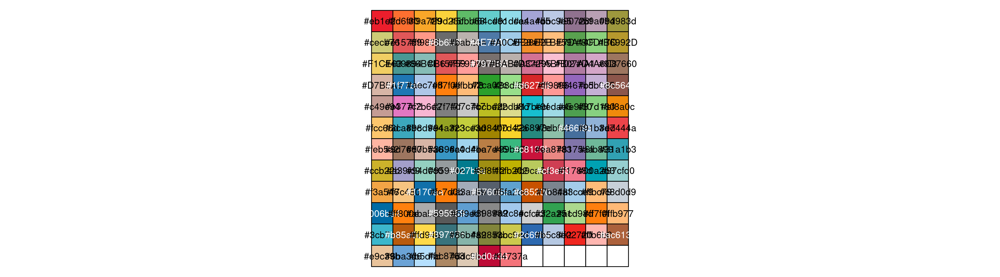

In [307]:
mycols <- unique(c(tableau_color_pal("Jewel Bright")(9),
                   tableau_color_pal("Winter")(8),
                   tableau_color_pal('Tableau 20')(20), 
                   tableau_color_pal('Classic 20')(20),
                   tableau_color_pal("Green-Orange-Teal")(12),
                   tableau_color_pal("Red-Blue-Brown")(12),
                   tableau_color_pal("Nuriel Stone")(9),
                   tableau_color_pal("Summer")(8),
                   tableau_color_pal("Color Blind")(10),
                   tableau_color_pal("Classic Color Blind")(10),
                   tableau_color_pal("Classic Green-Orange 12")(12),
                   tableau_color_pal("Classic Blue-Red 12")(12)
))
show_col(mycols)

subtype,index
<chr>,<int>
Mac_AIF1,1
Mac_APOE,2
Mac_BAG3,3
Mac_C1QA,4
Mac_C1QB,5
Mac_C1QC,6
Mac_CCL18,7
Mac_CCL3,8
Mac_GPR183,9


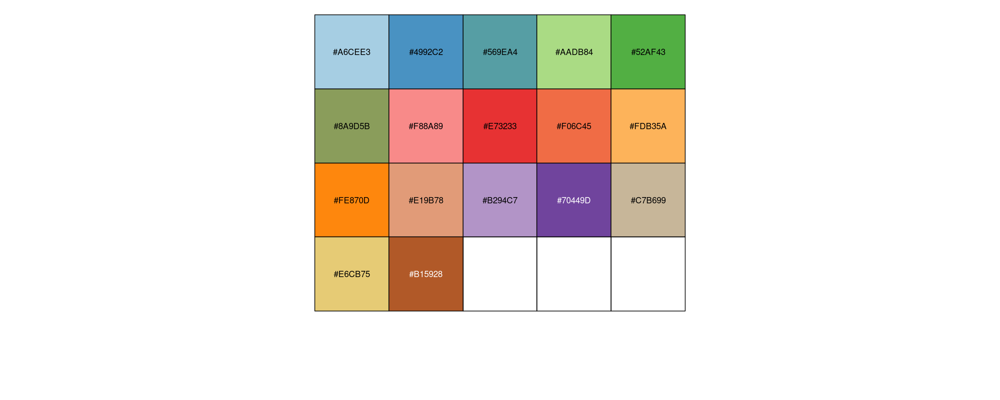

In [18]:
# color_mm_celltype <- colorRampPalette(brewer.pal(12,"Set3"))(17)
# color_mm_celltype <- colorRampPalette(brewer.pal(12,"Paired"))(17)
color_mm_celltype <- c("Mac_AIF1"="#A6CEE3", "Mac_APOE"="#4992C2", "Mac_BAG3"="#569EA4", "Mac_C1QA"="#AADB84", 
                        "Mac_C1QB"="#52AF43", "Mac_C1QC"="#8A9D5B", "Mac_CCL18"="#F88A89", "Mac_CCL3"="#E73233", 
                        "Mac_GPR183"="#F06C45", "Mac_MLANA"="#FDB35A", "Mac_MT1G"="#FE870D", "Mac_SPP1"="#E19B78", 
                        "Mac_STMN1"="#B294C7", "Mac_VSIG4"="#70449D", "Mono_FCN1"="#C7B699", "Mono_HSPA6"="#E6CB75", 
                        "Mono_IL1B"="#B15928")
show_col(color_mm_celltype)
mm_cluster_index <- data.frame(subtype = c("Mac_AIF1", "Mac_APOE", "Mac_BAG3", "Mac_C1QA", 
                        "Mac_C1QB", "Mac_C1QC", "Mac_CCL18", "Mac_CCL3", 
                        "Mac_GPR183", "Mac_MLANA", "Mac_MT1G", "Mac_SPP1", 
                        "Mac_STMN1", "Mac_VSIG4", "Mono_FCN1", "Mono_HSPA6", "Mono_IL1B"))
mm_cluster_index$index <- 1:dim(mm_cluster_index)[1]
mm_cluster_index

In [343]:
umap <- obj.mm@reductions$umap@cell.embeddings %>%
  as.data.frame() %>%
  cbind(cell_type = obj.mm@meta.data$subtype)
umap$cell_type <- as.character(umap$cell_type)
unique(umap$cell_type)
head(umap,1)

[1] "Mac_CCL3"   "Mac_VSIG4"  "Mac_C1QB"   "Mac_SPP1"   "Mac_APOE"  
 [6] "Mac_AIF1"   "Mac_MT1G"   "Mono_IL1B"  "Mac_BAG3"   "Mac_GPR183"
[11] "Mono_FCN1"  "Mono_HSPA6" "Mac_C1QA"   "Mac_CCL18"  "Mac_C1QC"  
[16] "Mac_STMN1"  "Mac_MLANA"

,UMAP_1,UMAP_2,cell_type
,<dbl>,<dbl>,<chr>
GSM3516662@@_121742672193460,-0.04111265,2.184165,Mac_CCL3


In [346]:
# identity_label_pos <- umap %>%
#     group_by(cell_type) %>%
#     summarise(
#         x = median(UMAP_1),
#         y = median(UMAP_2)
#     )
# identity_label_pos$cell_type <- mm_cluster_index$index[match(identity_label_pos$cell_type, mm_cluster_index$subtype)]
# identity_label_pos

Warning message:
“Use of `umap$UMAP_1` is discouraged. Use `UMAP_1` instead.”
Warning message:
“Use of `umap$UMAP_2` is discouraged. Use `UMAP_2` instead.”
Warning message:
“Use of `umap$UMAP_1` is discouraged. Use `UMAP_1` instead.”
Warning message:
“Use of `umap$UMAP_2` is discouraged. Use `UMAP_2` instead.”
Warning message:
“Use of `umap$UMAP_1` is discouraged. Use `UMAP_1` instead.”
Warning message:
“Use of `umap$UMAP_2` is discouraged. Use `UMAP_2` instead.”
Warning message:
“Use of `umap$UMAP_1` is discouraged. Use `UMAP_1` instead.”
Warning message:
“Use of `umap$UMAP_2` is discouraged. Use `UMAP_2` instead.”


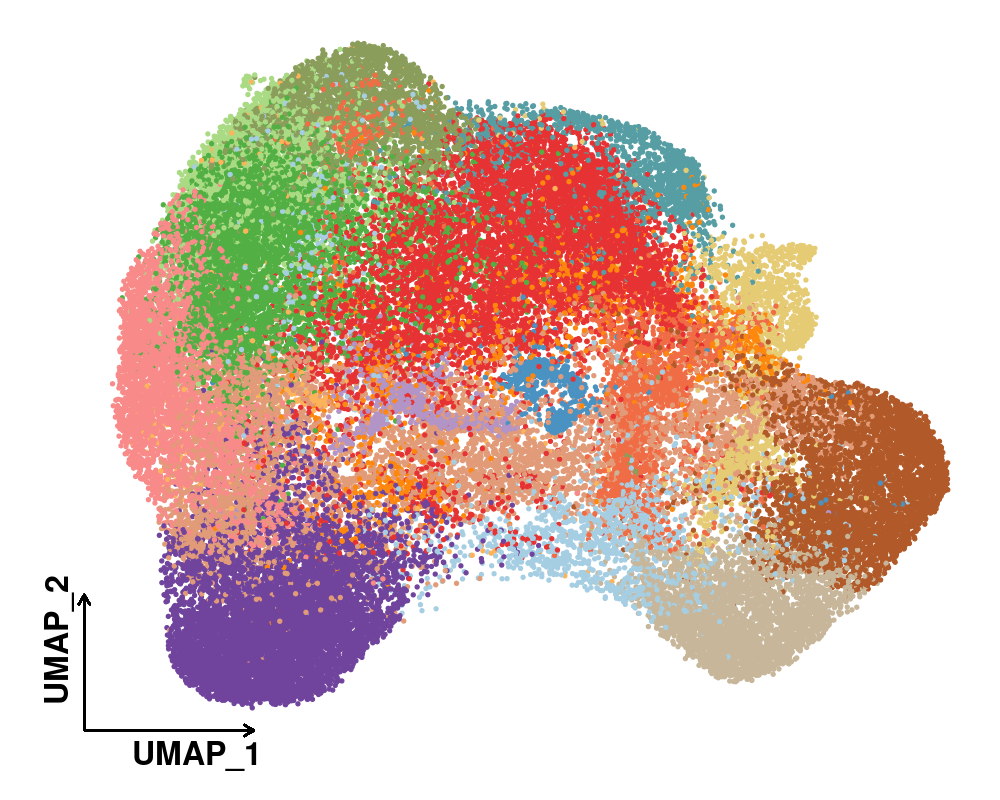

In [360]:
options(repr.plot.width = 10, repr.plot.height =8, repr.plot.res = 100)
p <- ggplot(data = umap, aes(x = UMAP_1, y = UMAP_2, color = cell_type)) +
  geom_point(size = 0.7, alpha = 1) +
  scale_color_manual(values = color_mm_celltype) +
  theme(panel.grid.major = element_blank(), # remove background color……
        panel.grid.minor = element_blank(),
        panel.border = element_blank(),
        axis.title = element_blank(),
        axis.text = element_blank(),
        axis.ticks = element_blank(),
        panel.background = element_rect(fill = "white"),
        plot.background = element_rect(fill = "white")) +
  theme(legend.position = "none")+
  guides(color = guide_legend(override.aes = list(size = 5))) + # adjust size of plot in legend box
  geom_segment(aes(x = min(umap$UMAP_1)-0.5, y = min(umap$UMAP_2)-0.5, # 起点位置
                   xend = min(umap$UMAP_1) + 2.5, yend = min(umap$UMAP_2)-0.5),
               colour = "black", size = 0.5, arrow = arrow(length = unit(0.3,"cm"))) +
  geom_segment(aes(x = min(umap$UMAP_1)-0.5, y = min(umap$UMAP_2)-0.5,
                   xend = min(umap$UMAP_1)-0.5, yend = min(umap$UMAP_2) + 2.5),
               colour = "black", size = 0.5, arrow = arrow(length = unit(0.3,"cm"))) +  
  annotate("text", x = min(umap$UMAP_1) + 1.5, y = min(umap$UMAP_2) - 1, label = "UMAP_1",
           color = "black", size = 8, fontface = "bold") +
  annotate("text", x = min(umap$UMAP_1) - 1, y = min(umap$UMAP_2) + 1.5, label = "UMAP_2",
           color = "black", size = 8, fontface = "bold", angle = 90)
#  geom_label_repel(data = identity_label_pos,
#                    label.size = NA,
# #                   alpha = 0,
#                      aes(label = cell_type, x = x, y = y),
#                      point.padding = unit(0.2, "lines"),
# #                      label.padding = unit(0,"cm"),
#                      inherit.aes = F)
p

In [361]:
pdf(file = paste0(dir2,"Figure/Macro_umap.pdf"), height=6, width=6)
p
dev.off()

Warning message:
“Use of `umap$UMAP_1` is discouraged. Use `UMAP_1` instead.”
Warning message:
“Use of `umap$UMAP_2` is discouraged. Use `UMAP_2` instead.”
Warning message:
“Use of `umap$UMAP_1` is discouraged. Use `UMAP_1` instead.”
Warning message:
“Use of `umap$UMAP_2` is discouraged. Use `UMAP_2` instead.”
Warning message:
“Use of `umap$UMAP_1` is discouraged. Use `UMAP_1` instead.”
Warning message:
“Use of `umap$UMAP_2` is discouraged. Use `UMAP_2` instead.”
Warning message:
“Use of `umap$UMAP_1` is discouraged. Use `UMAP_1` instead.”
Warning message:
“Use of `umap$UMAP_2` is discouraged. Use `UMAP_2` instead.”


png 
  2

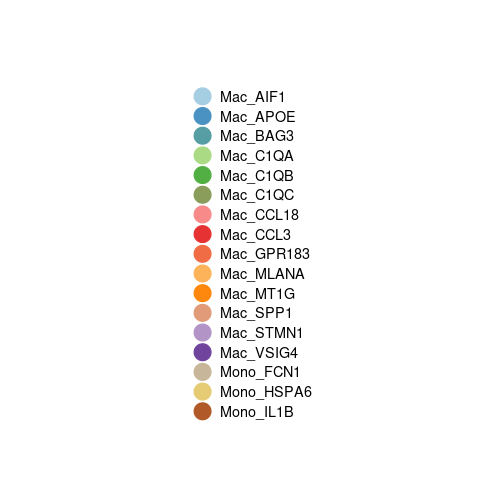

In [362]:
p <- ggplot(data = umap, aes(x = UMAP_1, y = UMAP_2, color = cell_type)) +
  geom_point(size = 5, alpha = 1) +
  scale_color_manual(values = color_mm_celltype) +
  theme(panel.grid.major = element_blank(), # remove background color……
        panel.grid.minor = element_blank(),
        panel.border = element_blank(),
        axis.title = element_blank(),
        axis.text = element_blank(),
        axis.ticks = element_blank(),
        panel.background = element_rect(fill = "white"),
        plot.background = element_rect(fill = "white")) +
  theme(legend.title = element_blank(),
        legend.key = element_rect(fill = "white"), # remove legend background color
        legend.text = element_text(size = 10),
        legend.key.size = unit(0.5,"cm")) 

options(repr.plot.width = 5, repr.plot.height =5, repr.plot.res = 100)
lgd <- cowplot::get_legend(p)
grid.newpage()
grid.draw(lgd)

In [364]:
pdf(file = paste0(dir2,"Figure/Macro_umap_lgd.pdf"), height=6, width=6)
grid.draw(lgd)
dev.off()

png 
  2

### subtype in CP ★

In [433]:
df <- obj.mm@meta.data[is.na(obj.mm@meta.data$cluster) == FALSE,]
df$subtype <- as.character(df$subtype)
df <- as.data.frame(prop.table(table(df$subtype, df$cluster), margin = 2))
df

Var1,Var2,Freq
<fct>,<fct>,<dbl>
Mac_AIF1,CP1,0.0493706294
Mac_APOE,CP1,0.0002797203
Mac_BAG3,CP1,0.0093706294
Mac_C1QA,CP1,0.0261538462
Mac_C1QB,CP1,0.0896503497
Mac_C1QC,CP1,0.0255944056
Mac_CCL18,CP1,0.0309090909
Mac_CCL3,CP1,0.1876923077
Mac_GPR183,CP1,0.0296503497


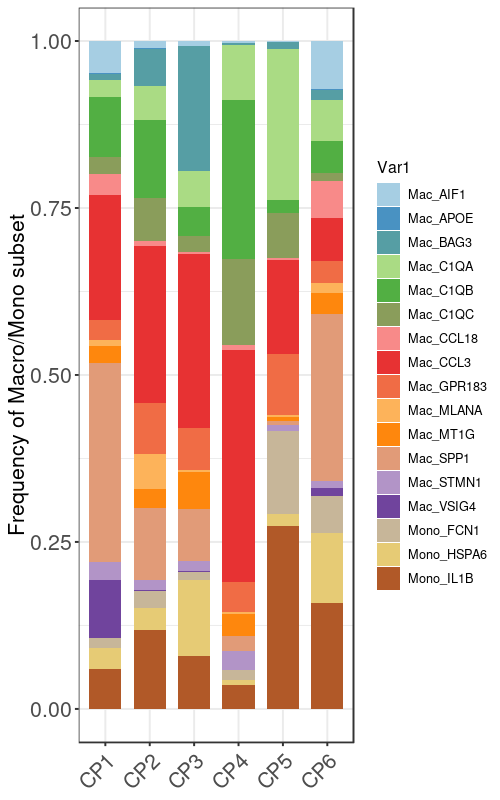

In [226]:
## 先看一下细胞在各CP的分布
options(repr.plot.width = 5, repr.plot.height =8, repr.plot.res = 100)
ggplot(df) +
    geom_bar(aes(x = Var2, y = Freq, fill = Var1), stat = "identity", width = 0.7, size = 0.5) +
    scale_fill_manual(values = color_mm_celltype) +
#     theme_classic()+
    theme_bw()+ labs(x=NULL,y="Frequency of Macro/Mono subset")+
    theme(axis.text.x = element_text(angle=45, size = 15, hjust = 0.95,vjust = 0.9), 
          axis.text.y = element_text(size = 15),
          axis.title.y = element_text(size =15)
         )

In [121]:
# # 画成饼图感觉效果没有太好
# i <- "CP1"
# df <- obj.mm@meta.data[is.na(obj.mm@meta.data$cluster)==FALSE,] %>% filter(cluster == i)
# subtype_counts <- df %>%
#   group_by(subtype) %>%
#   summarise(count = n(), .groups = "drop") %>%
#   mutate(total = sum(count), proportion = count / total * 100) %>%
#   ungroup() %>% as.data.frame()
# subtype_counts <- subtype_counts[order(subtype_counts$proportion),]
# subtype_counts$proportion <- factor(subtype_counts$proportion)
# p1 <- ggplot(subtype_counts, aes(x="",y=proportion, fill = subtype))+
#         geom_bar(width = 1, stat = "identity", color = "white") +
#         coord_polar("y", start = 0, direction = -1)+
# #         geom_text(aes(label = proportion), color = "white")+
#         scale_fill_manual(values = color_mm_celltype)+
#         theme_void()+ ggtitle(paste0(i))+
#         theme(legend.position = "none",plot.title = element_text(size = 10))
# options(repr.plot.width = 5, repr.plot.height =8, repr.plot.res = 100)
# p1

In [434]:
## 算巨噬单核亚群在巨噬单核中占比
df <- meta %>% filter(primary_cluster %in% c("Macrophage","Monocyte")) %>% dplyr::select(c(sampleID,subtype))
colnames(df) <- c("sampleID","celltype")
subtype_counts <- df %>%
  group_by(sampleID, celltype) %>%
  summarise(count = n(), .groups = "drop")
subtype_proportion <- subtype_counts %>%
  group_by(sampleID) %>%
  mutate(total = sum(count), proportion = count / total * 100) %>%
  ungroup() %>% as.data.frame() 
mid <- match(x = subtype_proportion$sampleID, table = cluster.df$sampleID)
subtype_proportion$cluster <- cluster.df$cluster[mid]
subtype_proportion <- subtype_proportion[is.na(subtype_proportion$cluster) == FALSE,]
subtype_proportion$cluster <- factor(subtype_proportion$cluster, levels = c("CP1","CP2","CP3","CP4","CP5","CP6"))
subtype_proportion

,sampleID,celltype,count,total,proportion,cluster
,<chr>,<fct>,<int>,<int>,<dbl>,<fct>
1,CRC01-HM,Mac_CCL3,82,1006,8.15109344,CP6
2,CRC01-HM,Mac_VSIG4,22,1006,2.18687873,CP6
3,CRC01-HM,Mac_SPP1,333,1006,33.10139165,CP6
4,CRC01-HM,Mac_C1QB,56,1006,5.56660040,CP6
5,CRC01-HM,Mac_CCL18,68,1006,6.75944334,CP6
6,CRC01-HM,Mac_C1QA,2,1006,0.19880716,CP6
7,CRC01-HM,Mac_C1QC,6,1006,0.59642147,CP6
8,CRC01-HM,Mac_GPR183,38,1006,3.77733598,CP6
9,CRC01-HM,Mac_AIF1,123,1006,12.22664016,CP6


In [435]:
## 算巨噬单核亚群在所有细胞中占比
df <- meta %>% dplyr::select(c(sampleID,subtype))
colnames(df) <- c("sampleID","celltype")
subtype_counts <- df %>%
  group_by(sampleID, celltype) %>%
  summarise(count = n(), .groups = "drop")
subtype_proportion <- subtype_counts %>%
  group_by(sampleID) %>%
  mutate(total = sum(count), proportion = count / total * 100) %>%
  ungroup() %>% as.data.frame() 
mid <- match(subtype_proportion$celltype, celltype_ref$subtype)
subtype_proportion$primary_cluster <- celltype_ref$primary_cluster[mid]
subtype_proportion <- filter(subtype_proportion, primary_cluster %in% c("Macrophage","Monocyte"))
mid <- match(x = subtype_proportion$sampleID, table = cluster.df$sampleID)
subtype_proportion$cluster <- cluster.df$cluster[mid]
subtype_proportion <- subtype_proportion[is.na(subtype_proportion$cluster) == FALSE,]
subtype_proportion$cluster <- factor(subtype_proportion$cluster, levels = c("CP1","CP2","CP3","CP4","CP5","CP6"))
subtype_proportion

,sampleID,celltype,count,total,proportion,primary_cluster,cluster
,<chr>,<fct>,<int>,<int>,<dbl>,<fct>,<fct>
1,CRC01-HM,Mac_CCL3,82,12189,0.672737714,Macrophage,CP6
2,CRC01-HM,Mac_VSIG4,22,12189,0.180490606,Macrophage,CP6
3,CRC01-HM,Mac_SPP1,333,12189,2.731971450,Macrophage,CP6
4,CRC01-HM,Mac_C1QB,56,12189,0.459430634,Macrophage,CP6
5,CRC01-HM,Mac_CCL18,68,12189,0.557880056,Macrophage,CP6
6,CRC01-HM,Mac_C1QA,2,12189,0.016408237,Macrophage,CP6
7,CRC01-HM,Mac_C1QC,6,12189,0.049224711,Macrophage,CP6
8,CRC01-HM,Mac_GPR183,38,12189,0.311756502,Macrophage,CP6
9,CRC01-HM,Mac_AIF1,123,12189,1.009106571,Macrophage,CP6


In [442]:
label.x <- 3
label.size <- 5
title.size <- 25

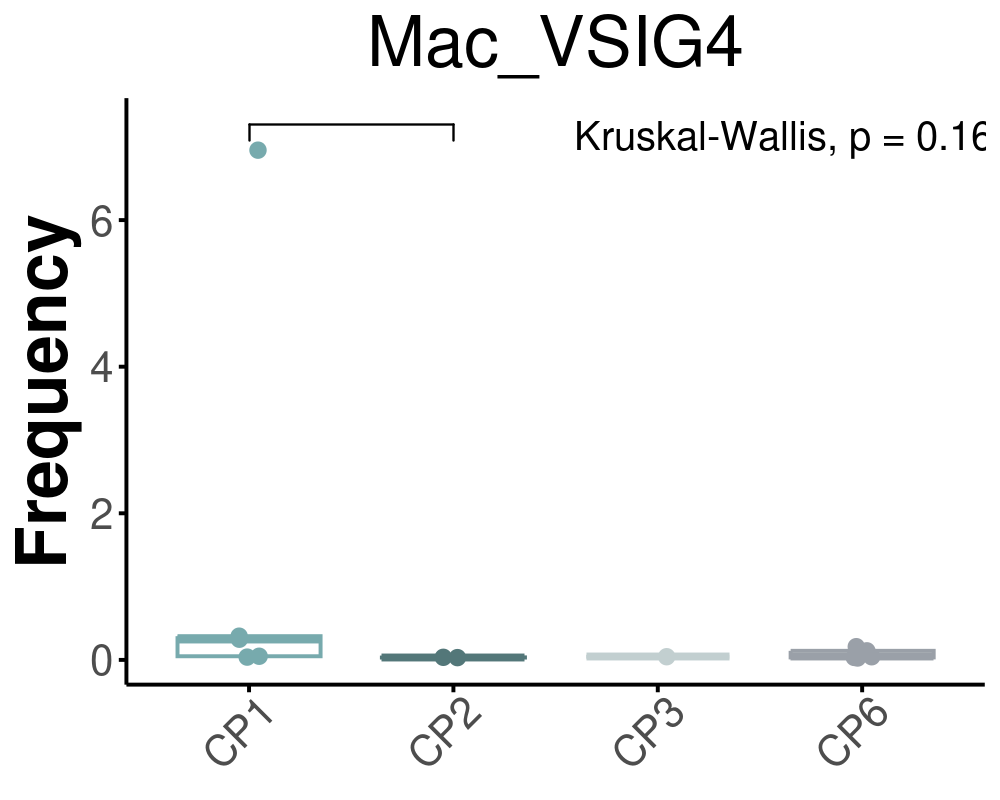

In [446]:
subset_name <- "Mac_VSIG4"
df.target <- subtype_proportion[subtype_proportion$celltype == subset_name,]
# p1 <- ggplot(df.target, aes(x = reorder(cluster, -proportion, FUN = median), y = proportion)) +
p1 <- ggplot(df.target, aes(x = cluster, y = proportion)) +
        geom_boxplot(aes(x = cluster, color= cluster, fill=cluster), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        stat_compare_means(label.x = label.x, size = label.size)+
        stat_compare_means(comparisons = comparisons, label="p.signif",hide.ns = TRUE)+
        geom_jitter(aes(color=cluster,fill=cluster),
                    position=position_jitterdodge(dodge.width=0.65),shape = 21,size=2)+
        scale_color_manual(values=color_cluster)+  
        scale_fill_manual(values=color_cluster)+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset_name)+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = title.size),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 15),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
            scale_y_continuous(limits = c(0,5), breaks = seq(0,5,1)),
            legend.position="none") 
options(repr.plot.width = 5, repr.plot.height =4, repr.plot.res = 200)
p1


In [447]:
subset_name <- "Mac_SPP1"
df.target <- subtype_proportion[subtype_proportion$celltype == subset_name,]
p2 <- ggplot(df.target, aes(x = cluster, y = proportion)) +
        geom_boxplot(aes(x = cluster, color= cluster, fill=cluster), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        geom_jitter(aes(color=cluster,fill=cluster),
                    position=position_jitterdodge(dodge.width=0.65),shape = 21,size=2)+
        stat_compare_means(label.x = label.x, size = label.size)+
        stat_compare_means(comparisons = comparisons, label="p.signif",hide.ns = TRUE)+
        scale_color_manual(values=color_cluster)+  
        scale_fill_manual(values=color_cluster)+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset_name)+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = title.size),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 15),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
            scale_y_continuous(limits = c(0,5), breaks = seq(0,5,1)),
            legend.position="none") 

subset_name <- "Mac_AIF1"
df.target <- subtype_proportion[subtype_proportion$celltype == subset_name,]
p3 <- ggplot(df.target, aes(x = cluster, y = proportion)) +
        geom_boxplot(aes(x = cluster, color= cluster, fill=cluster), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        geom_jitter(aes(color=cluster,fill=cluster),
                    position=position_jitterdodge(dodge.width=0.65),shape = 21,size=2)+
        stat_compare_means(label.x = label.x, size = label.size)+
        stat_compare_means(comparisons = comparisons, label="p.signif",hide.ns = TRUE)+
        scale_color_manual(values=color_cluster)+  
        scale_fill_manual(values=color_cluster)+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset_name)+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = title.size),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 15),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
            scale_y_continuous(limits = c(0,5), breaks = seq(0,5,1)),
            legend.position="none") 

subset_name <- "Mac_CCL18"
df.target <- subtype_proportion[subtype_proportion$celltype == subset_name,]
p4 <- ggplot(df.target, aes(x = cluster, y = proportion)) +
        geom_boxplot(aes(x = cluster, color= cluster, fill=cluster), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        geom_jitter(aes(color=cluster,fill=cluster),
                    position=position_jitterdodge(dodge.width=0.65),shape = 21,size=2)+
        stat_compare_means(label.x = label.x, size = label.size)+
        stat_compare_means(comparisons = comparisons, label="p.signif",hide.ns = TRUE)+
        scale_color_manual(values=color_cluster)+  
        scale_fill_manual(values=color_cluster)+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset_name)+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = title.size),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 15),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
            scale_y_continuous(limits = c(0,5), breaks = seq(0,5,1)),
            legend.position="none") 

subset_name <- "Mac_STMN1"
df.target <- subtype_proportion[subtype_proportion$celltype == subset_name,]
p5 <- ggplot(df.target, aes(x = cluster, y = proportion)) +
        geom_boxplot(aes(x = cluster, color= cluster, fill=cluster), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        geom_jitter(aes(color=cluster,fill=cluster),
                    position=position_jitterdodge(dodge.width=0.65),shape = 21,size=2)+
        stat_compare_means(label.x = label.x, size = label.size)+
        stat_compare_means(comparisons = comparisons, label="p.signif",hide.ns = TRUE)+
        scale_color_manual(values=color_cluster)+  
        scale_fill_manual(values=color_cluster)+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset_name)+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = title.size),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 15),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
            scale_y_continuous(limits = c(0,5), breaks = seq(0,5,1)),
            legend.position="none") 

subset_name <- "Mac_CCL3"
df.target <- subtype_proportion[subtype_proportion$celltype == subset_name,]
p6 <- ggplot(df.target, aes(x = cluster, y = proportion)) +
        geom_boxplot(aes(x = cluster, color= cluster, fill=cluster), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        geom_jitter(aes(color=cluster,fill=cluster),
                    position=position_jitterdodge(dodge.width=0.65),shape = 21,size=2)+
        stat_compare_means(label.x = label.x, size = label.size)+
        stat_compare_means(comparisons = comparisons, label="p.signif",hide.ns = TRUE)+
        scale_color_manual(values=color_cluster)+  
        scale_fill_manual(values=color_cluster)+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset_name)+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = title.size),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 15),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
            scale_y_continuous(limits = c(0,5), breaks = seq(0,5,1)),
            legend.position="none") 

subset_name <- "Mac_MT1G"
df.target <- subtype_proportion[subtype_proportion$celltype == subset_name,]
p7 <- ggplot(df.target, aes(x = cluster, y = proportion)) +
        geom_boxplot(aes(x = cluster, color= cluster, fill=cluster), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        geom_jitter(aes(color=cluster,fill=cluster),
                    position=position_jitterdodge(dodge.width=0.65),shape = 21,size=2)+
        stat_compare_means(label.x = label.x, size = label.size)+
        stat_compare_means(comparisons = comparisons, label="p.signif",hide.ns = TRUE)+
        scale_color_manual(values=color_cluster)+  
        scale_fill_manual(values=color_cluster)+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset_name)+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = title.size),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 15),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
            scale_y_continuous(limits = c(0,5), breaks = seq(0,5,1)),
            legend.position="none") 

subset_name <- "Mac_GPR183"
df.target <- subtype_proportion[subtype_proportion$celltype == subset_name,]
p8 <- ggplot(df.target, aes(x = cluster, y = proportion)) +
        geom_boxplot(aes(x = cluster, color= cluster, fill=cluster), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        geom_jitter(aes(color=cluster,fill=cluster),
                    position=position_jitterdodge(dodge.width=0.65),shape = 21,size=2)+
        stat_compare_means(label.x = label.x, size = label.size)+
        stat_compare_means(comparisons = comparisons, label="p.signif",hide.ns = TRUE)+
        scale_color_manual(values=color_cluster)+  
        scale_fill_manual(values=color_cluster)+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset_name)+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = title.size),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 15),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
            scale_y_continuous(limits = c(0,5), breaks = seq(0,5,1)),
            legend.position="none") 

subset_name <- "Mac_C1QB"
df.target <- subtype_proportion[subtype_proportion$celltype == subset_name,]
p9 <- ggplot(df.target, aes(x = cluster, y = proportion)) +
        geom_boxplot(aes(x = cluster, color= cluster, fill=cluster), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        geom_jitter(aes(color=cluster,fill=cluster),
                    position=position_jitterdodge(dodge.width=0.65),shape = 21,size=2)+
        stat_compare_means(label.x = label.x, size = label.size)+
        stat_compare_means(comparisons = comparisons, label="p.signif",hide.ns = TRUE)+
        scale_color_manual(values=color_cluster)+  
        scale_fill_manual(values=color_cluster)+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset_name)+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = title.size),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 15),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
            scale_y_continuous(limits = c(0,5), breaks = seq(0,5,1)),
            legend.position="none") 

subset_name <- "Mac_C1QC"
df.target <- subtype_proportion[subtype_proportion$celltype == subset_name,]
p10 <- ggplot(df.target, aes(x = cluster, y = proportion)) +
        geom_boxplot(aes(x = cluster, color= cluster, fill=cluster), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        geom_jitter(aes(color=cluster,fill=cluster),
                    position=position_jitterdodge(dodge.width=0.65),shape = 21,size=2)+
        stat_compare_means(label.x = label.x, size = label.size)+
        stat_compare_means(comparisons = comparisons, label="p.signif",hide.ns = TRUE)+
        scale_color_manual(values=color_cluster)+  
        scale_fill_manual(values=color_cluster)+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset_name)+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = title.size),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 15),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
            scale_y_continuous(limits = c(0,5), breaks = seq(0,5,1)),
            legend.position="none") 

subset_name <- "Mac_C1QA"
df.target <- subtype_proportion[subtype_proportion$celltype == subset_name,]
p11 <- ggplot(df.target, aes(x = cluster, y = proportion)) +
        geom_boxplot(aes(x = cluster, color= cluster, fill=cluster), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        geom_jitter(aes(color=cluster,fill=cluster),
                    position=position_jitterdodge(dodge.width=0.65),shape = 21,size=2)+
        stat_compare_means(label.x = label.x, size = label.size)+
        stat_compare_means(comparisons = comparisons, label="p.signif",hide.ns = TRUE)+
        scale_color_manual(values=color_cluster)+  
        scale_fill_manual(values=color_cluster)+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset_name)+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = title.size),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 15),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
            scale_y_continuous(limits = c(0,5), breaks = seq(0,5,1)),
            legend.position="none") 

subset_name <- "Mono_IL1B"
df.target <- subtype_proportion[subtype_proportion$celltype == subset_name,]
p12 <- ggplot(df.target, aes(x = cluster, y = proportion)) +
        geom_boxplot(aes(x = cluster, color= cluster, fill=cluster), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        geom_jitter(aes(color=cluster,fill=cluster),
                    position=position_jitterdodge(dodge.width=0.65),shape = 21,size=2)+
        stat_compare_means(label.x = label.x, size = label.size)+
        stat_compare_means(comparisons = comparisons, label="p.signif",hide.ns = TRUE)+
        scale_color_manual(values=color_cluster)+  
        scale_fill_manual(values=color_cluster)+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset_name)+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = title.size),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 15),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
            scale_y_continuous(limits = c(0,5), breaks = seq(0,5,1)),
            legend.position="none") 

subset_name <- "Mono_FCN1"
df.target <- subtype_proportion[subtype_proportion$celltype == subset_name,]
p13 <- ggplot(df.target, aes(x = cluster, y = proportion)) +
        geom_boxplot(aes(x = cluster, color= cluster, fill=cluster), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        geom_jitter(aes(color=cluster,fill=cluster),
                    position=position_jitterdodge(dodge.width=0.65),shape = 21,size=2)+
        stat_compare_means(label.x = label.x, size = label.size)+
        stat_compare_means(comparisons = comparisons, label="p.signif",hide.ns = TRUE)+
        scale_color_manual(values=color_cluster)+  
        scale_fill_manual(values=color_cluster)+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset_name)+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = title.size),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 15),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
            scale_y_continuous(limits = c(0,5), breaks = seq(0,5,1)),
            legend.position="none") 

subset_name <- "Mac_BAG3"
df.target <- subtype_proportion[subtype_proportion$celltype == subset_name,]
p14 <- ggplot(df.target, aes(x = cluster, y = proportion)) +
        geom_boxplot(aes(x = cluster, color= cluster, fill=cluster), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        geom_jitter(aes(color=cluster,fill=cluster),
                    position=position_jitterdodge(dodge.width=0.65),shape = 21,size=2)+
        stat_compare_means(label.x = label.x, size = label.size)+
        stat_compare_means(comparisons = comparisons, label="p.signif",hide.ns = TRUE)+
        scale_color_manual(values=color_cluster)+  
        scale_fill_manual(values=color_cluster)+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset_name)+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = title.size),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 15),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
            scale_y_continuous(limits = c(0,5), breaks = seq(0,5,1)),
            legend.position="none") 

subset_name <- "Mono_HSPA6"
df.target <- subtype_proportion[subtype_proportion$celltype == subset_name,]
p15 <- ggplot(df.target, aes(x = cluster, y = proportion)) +
        geom_boxplot(aes(x = cluster, color= cluster, fill=cluster), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        geom_jitter(aes(color=cluster,fill=cluster),
                    position=position_jitterdodge(dodge.width=0.65),shape = 21,size=2)+
        stat_compare_means(label.x = label.x, size = label.size)+
        stat_compare_means(comparisons = comparisons, label="p.signif",hide.ns = TRUE)+
        scale_color_manual(values=color_cluster)+  
        scale_fill_manual(values=color_cluster)+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset_name)+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = title.size),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 15),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
            scale_y_continuous(limits = c(0,5), breaks = seq(0,5,1)),
            legend.position="none") 

subset_name <- "Mac_APOE"
df.target <- subtype_proportion[subtype_proportion$celltype == subset_name,]
p16 <- ggplot(df.target, aes(x = cluster, y = proportion)) +
        geom_boxplot(aes(x = cluster, color= cluster, fill=cluster), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        geom_jitter(aes(color=cluster,fill=cluster),
                    position=position_jitterdodge(dodge.width=0.65),shape = 21,size=2)+
        stat_compare_means(label.x = label.x, size = label.size)+
        stat_compare_means(comparisons = comparisons, label="p.signif",hide.ns = TRUE)+
        scale_color_manual(values=color_cluster)+  
        scale_fill_manual(values=color_cluster)+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset_name)+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = title.size),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 15),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
            scale_y_continuous(limits = c(0,5), breaks = seq(0,5,1)),
            legend.position="none") 

subset_name <- "Mac_MLANA"
df.target <- subtype_proportion[subtype_proportion$celltype == subset_name,]
p17 <- ggplot(df.target, aes(x = cluster, y = proportion)) +
        geom_boxplot(aes(x = cluster, color= cluster, fill=cluster), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        geom_jitter(aes(color=cluster,fill=cluster),
                    position=position_jitterdodge(dodge.width=0.65),shape = 21,size=2)+
        stat_compare_means(label.x = label.x, size = label.size)+
        stat_compare_means(comparisons = comparisons, label="p.signif",hide.ns = TRUE)+
        scale_color_manual(values=color_cluster)+  
        scale_fill_manual(values=color_cluster)+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset_name)+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = title.size),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 15),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
            scale_y_continuous(limits = c(0,5), breaks = seq(0,5,1)),
            legend.position="none")


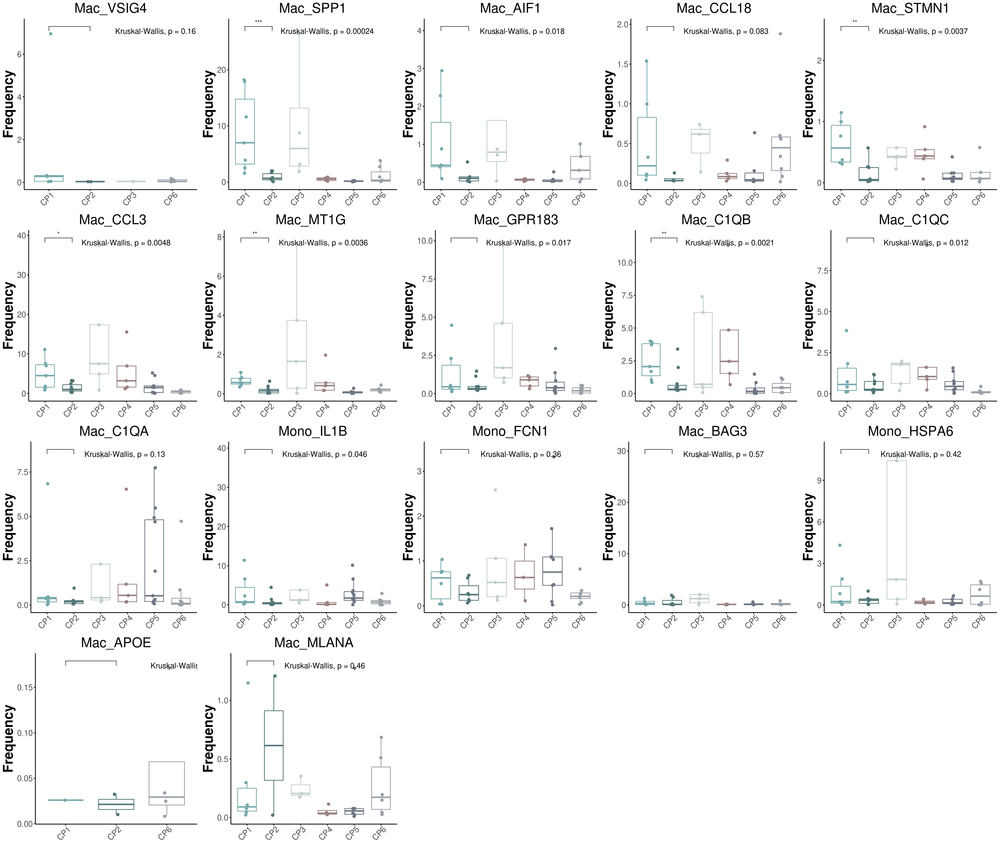

In [448]:
## 用RO/E不太准，把所有箱线图做一遍来看看
options(repr.plot.width = 26, repr.plot.height =22, repr.plot.res = 200)
cowplot::plot_grid(p1,p2,p3,p4,p5,
                   p6,p7,p8,p9,p10,
                   p11,p12,p13,p14,p15,
                   p16,p17,ncol=5)

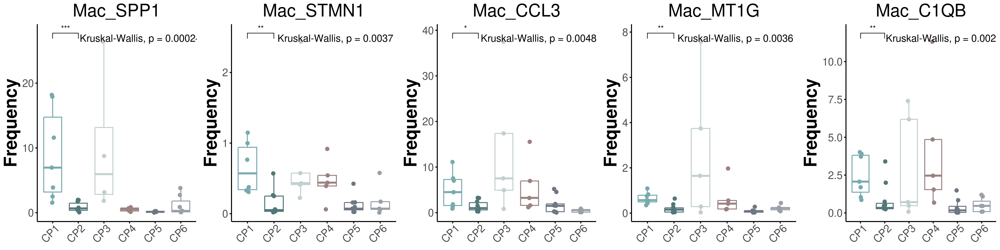

In [449]:
## 挑选要展示的(占所有细胞)
options(repr.plot.width = 20, repr.plot.height =5, repr.plot.res = 200)
cowplot::plot_grid(p2,p5,p6,p7,p9,ncol=5)
# Mac_SPP1，Mac_STMN1， Mac_CCL3, Mac_MT1G, Mac_C1QB的CP1和CP2之间有显著差异

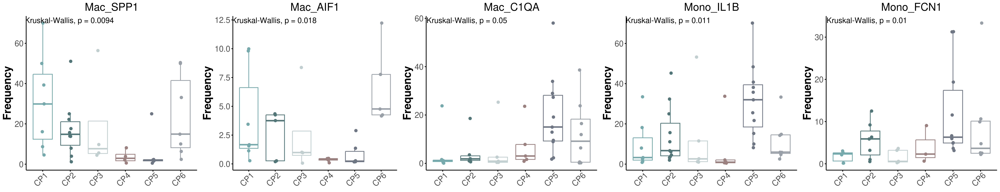

In [159]:
## 挑选要展示的(占巨噬/单核亚群)
options(repr.plot.width = 26, repr.plot.height =5, repr.plot.res = 200)
cowplot::plot_grid(p2,p3,p11,p12,p13,ncol=5)

### Most contributed subset ★

In [45]:
## 先算巨噬单核细胞占比
df <- meta %>% dplyr::select(c(sampleID,primary_cluster))
colnames(df) <- c("sampleID","celltype")
subtype_counts <- df %>%
  group_by(sampleID, celltype) %>%
  summarise(count = n(), .groups = "drop")
subtype_proportion_1 <- subtype_counts %>%
  group_by(sampleID) %>%
  mutate(total = sum(count), proportion = count / total * 100) %>%
  ungroup() %>% as.data.frame() %>% filter(celltype %in% c("Macrophage","Monocyte"))
subtype_proportion_1$index <- paste0(subtype_proportion_1$sampleID, "_",subtype_proportion_1$celltype)
subtype_proportion_1

sampleID,celltype,count,total,proportion,index
<chr>,<fct>,<int>,<int>,<dbl>,<chr>
CRC01-HM,Macrophage,757,12189,6.21051768,CRC01-HM_Macrophage
CRC01-HM,Monocyte,249,12189,2.04282550,CRC01-HM_Monocyte
CRC01-PT,Macrophage,888,14983,5.92671695,CRC01-PT_Macrophage
CRC01-PT,Monocyte,298,14983,1.98892078,CRC01-PT_Monocyte
CRC02-HM,Macrophage,38,2327,1.63300387,CRC02-HM_Macrophage
CRC02-HM,Monocyte,9,2327,0.38676407,CRC02-HM_Monocyte
CRC02-PT,Macrophage,604,9156,6.59676715,CRC02-PT_Macrophage
CRC02-PT,Monocyte,73,9156,0.79729139,CRC02-PT_Monocyte
CRC03-HM,Macrophage,397,7649,5.19022094,CRC03-HM_Macrophage


In [46]:
## 算巨噬单核亚群在巨噬单核中占比
# df <- meta %>% filter(primary_cluster == "Macrophage") %>% dplyr::select(c(sampleID,subtype))
# df <- meta %>% filter(primary_cluster == "Monocyte") %>% dplyr::select(c(sampleID,subtype))
# colnames(df) <- c("sampleID","celltype")
# subtype_counts <- df %>%
#   group_by(sampleID, celltype) %>%
#   summarise(count = n(), .groups = "drop")
# subtype_proportion_2 <- subtype_counts %>%
#   group_by(sampleID) %>%
#   mutate(total = sum(count), proportion = count / total * 100) %>%
#   ungroup() %>% as.data.frame() 

## 算巨噬单核亚群在所有细胞中占比
df <- meta %>% dplyr::select(c(sampleID,subtype))
colnames(df) <- c("sampleID","celltype")
subtype_counts <- df %>%
  group_by(sampleID, celltype) %>%
  summarise(count = n(), .groups = "drop")
subtype_proportion_2 <- subtype_counts %>%
  group_by(sampleID) %>%
  mutate(total = sum(count), proportion = count / total * 100) %>%
  ungroup() %>% as.data.frame() 
mid <- match(subtype_proportion_2$celltype, celltype_ref$subtype)
subtype_proportion_2$primary_cluster <- celltype_ref$primary_cluster[mid]
subtype_proportion_2$index <- paste0(subtype_proportion_2$sampleID, "_",subtype_proportion_2$primary_cluster)
subtype_proportion_2 <- filter(subtype_proportion_2, primary_cluster %in% c("Macrophage"))
mid <- match(subtype_proportion_2$index, subtype_proportion_1$index)
subtype_proportion_2$proportion_primary <- subtype_proportion_1$proportion[mid]
mid <- match(x = subtype_proportion_2$sampleID, table = cluster.df$sampleID)
subtype_proportion_2$cluster <- cluster.df$cluster[mid]
subtype_proportion_2 <- subtype_proportion_2[is.na(subtype_proportion_2$cluster)==FALSE,]
subtype_proportion_2

,sampleID,celltype,count,total,proportion,primary_cluster,index,proportion_primary,cluster
,<chr>,<fct>,<int>,<int>,<dbl>,<fct>,<chr>,<dbl>,<chr>
1,CRC01-HM,Mac_CCL3,82,12189,0.672737714,Macrophage,CRC01-HM_Macrophage,6.210518,CP6
2,CRC01-HM,Mac_VSIG4,22,12189,0.180490606,Macrophage,CRC01-HM_Macrophage,6.210518,CP6
3,CRC01-HM,Mac_SPP1,333,12189,2.731971450,Macrophage,CRC01-HM_Macrophage,6.210518,CP6
4,CRC01-HM,Mac_C1QB,56,12189,0.459430634,Macrophage,CRC01-HM_Macrophage,6.210518,CP6
5,CRC01-HM,Mac_CCL18,68,12189,0.557880056,Macrophage,CRC01-HM_Macrophage,6.210518,CP6
6,CRC01-HM,Mac_C1QA,2,12189,0.016408237,Macrophage,CRC01-HM_Macrophage,6.210518,CP6
7,CRC01-HM,Mac_C1QC,6,12189,0.049224711,Macrophage,CRC01-HM_Macrophage,6.210518,CP6
8,CRC01-HM,Mac_GPR183,38,12189,0.311756502,Macrophage,CRC01-HM_Macrophage,6.210518,CP6
9,CRC01-HM,Mac_AIF1,123,12189,1.009106571,Macrophage,CRC01-HM_Macrophage,6.210518,CP6


In [47]:
label.size <- 8
title.size <- 20

`geom_smooth()` using formula = 'y ~ x'


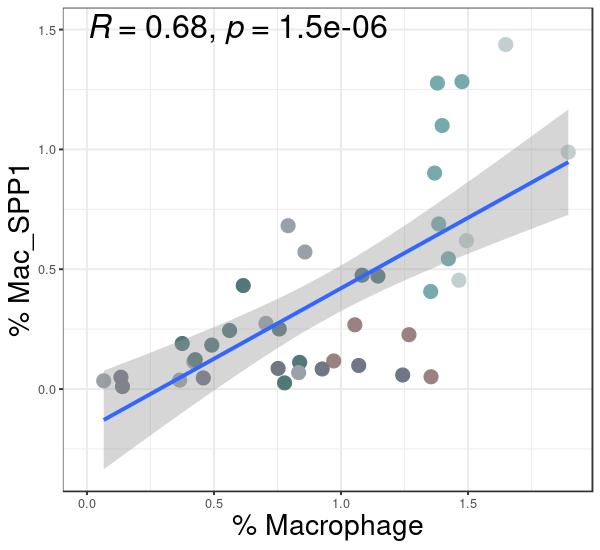

In [71]:
subset_name <- "Mac_SPP1"
df.target <- subtype_proportion_2[subtype_proportion_2$celltype == subset_name,] %>% 
                dplyr::select(c(proportion_primary,proportion,cluster))
colnames(df.target) <- c("primary","subtype","cluster")
df.target$primary <- log10(df.target$primary+1)
df.target$subtype <- log10(df.target$subtype+1)

options(repr.plot.width = 6, repr.plot.height =5.5, repr.plot.res = 100)
p1 <- ggplot(df.target, aes(x=primary, y=subtype)) +
     geom_point(aes(color=cluster),size = 4) +
    geom_smooth(method = "lm")+
    stat_cor(method = "pearson",label.x = 0, label.y = 1.5, size=label.size) +
    scale_color_manual(values = color_cluster) +
    labs(x="% Macrophage", y=paste0("% ",subset_name))+
    theme_bw() +
    theme(axis.title = element_text(size=title.size), legend.position = "none")
p1

`geom_smooth()` using formula = 'y ~ x'


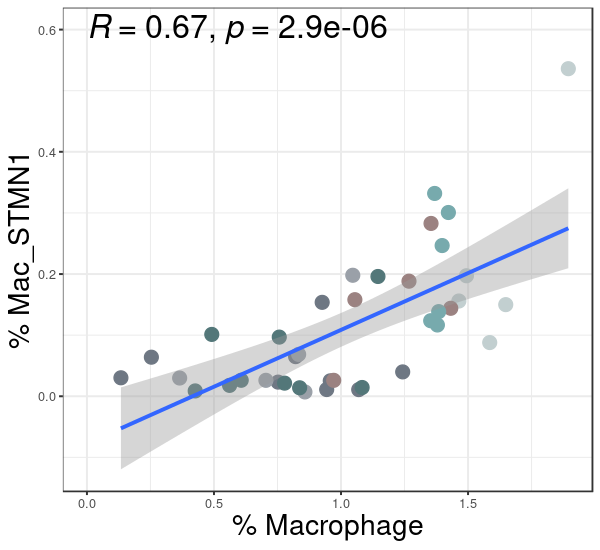

In [72]:
subset_name <- "Mac_STMN1"
df.target <- subtype_proportion_2[subtype_proportion_2$celltype == subset_name,] %>% 
                dplyr::select(c(proportion_primary,proportion,cluster))
colnames(df.target) <- c("primary","subtype","cluster")
df.target$primary <- log10(df.target$primary+1)
df.target$subtype <- log10(df.target$subtype+1)

options(repr.plot.width = 6, repr.plot.height =5.5, repr.plot.res = 100)
p2 <- ggplot(df.target, aes(x=primary, y=subtype)) +
     geom_point(aes(color=cluster),size = 4) +
    geom_smooth(method = "lm")+
    stat_cor(method = "pearson",label.x = 0, label.y = 0.6, size=label.size) +
    scale_color_manual(values = color_cluster) +
    labs(x="% Macrophage", y=paste0("% ",subset_name))+
    theme_bw() +
    theme(axis.title = element_text(size=title.size), legend.position = "none")
p2

`geom_smooth()` using formula = 'y ~ x'


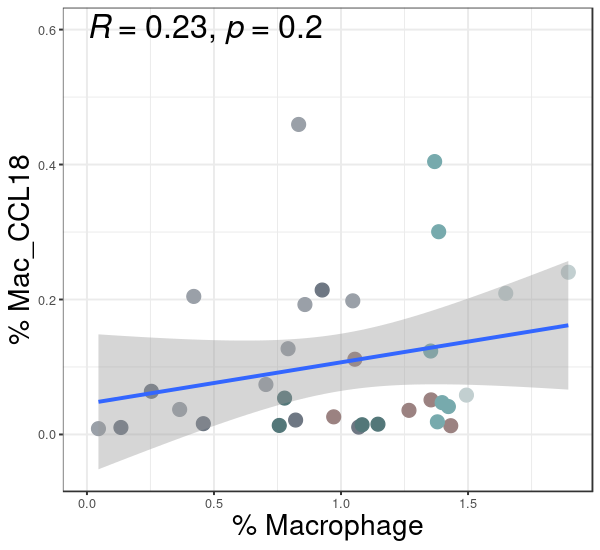

In [73]:
subset_name <- "Mac_CCL18"
df.target <- subtype_proportion_2[subtype_proportion_2$celltype == subset_name,] %>% 
                dplyr::select(c(proportion_primary,proportion,cluster))
colnames(df.target) <- c("primary","subtype","cluster")
df.target$primary <- log10(df.target$primary+1)
df.target$subtype <- log10(df.target$subtype+1)

options(repr.plot.width = 6, repr.plot.height =5.5, repr.plot.res = 100)
p3 <- ggplot(df.target, aes(x=primary, y=subtype)) +
     geom_point(aes(color=cluster),size = 4) +
    geom_smooth(method = "lm")+
    stat_cor(method = "pearson",label.x = 0, label.y = 0.6, size=label.size) +
    scale_color_manual(values = color_cluster) +
    labs(x="% Macrophage", y=paste0("% ",subset_name))+
    theme_bw() +
    theme(axis.title = element_text(size=title.size), legend.position = "none")
p3

`geom_smooth()` using formula = 'y ~ x'


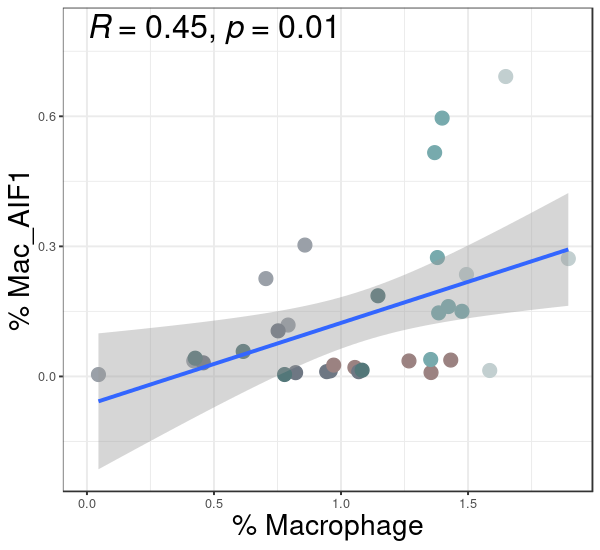

In [74]:
subset_name <- "Mac_AIF1"
df.target <- subtype_proportion_2[subtype_proportion_2$celltype == subset_name,] %>% 
                dplyr::select(c(proportion_primary,proportion,cluster))
colnames(df.target) <- c("primary","subtype","cluster")
df.target$primary <- log10(df.target$primary+1)
df.target$subtype <- log10(df.target$subtype+1)

options(repr.plot.width = 6, repr.plot.height =5.5, repr.plot.res = 100)
p4 <- ggplot(df.target, aes(x=primary, y=subtype)) +
     geom_point(aes(color=cluster),size = 4) +
    geom_smooth(method = "lm")+
    stat_cor(method = "pearson",label.x = 0, label.y = 0.8, size=label.size) +
    scale_color_manual(values = color_cluster) +
    labs(x="% Macrophage", y=paste0("% ",subset_name))+
    theme_bw() +
    theme(axis.title = element_text(size=title.size), legend.position = "none")
p4

`geom_smooth()` using formula = 'y ~ x'


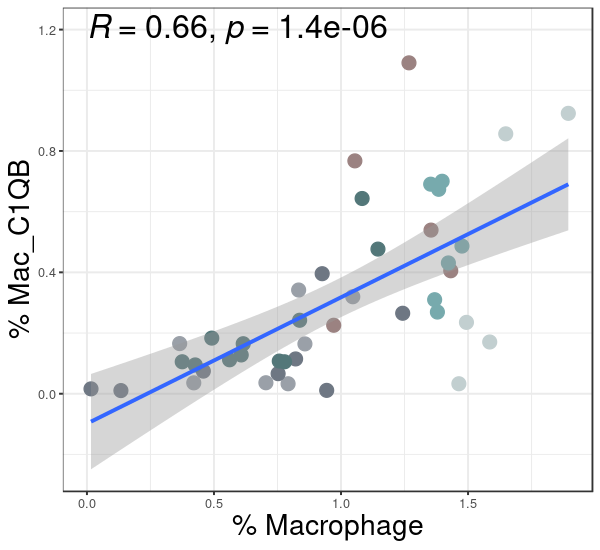

In [75]:
subset_name <- "Mac_C1QB"
df.target <- subtype_proportion_2[subtype_proportion_2$celltype == subset_name,] %>% 
                dplyr::select(c(proportion_primary,proportion,cluster))
colnames(df.target) <- c("primary","subtype","cluster")
df.target$primary <- log10(df.target$primary+1)
df.target$subtype <- log10(df.target$subtype+1)

options(repr.plot.width = 6, repr.plot.height =5.5, repr.plot.res = 100)
p5 <- ggplot(df.target, aes(x=primary, y=subtype)) +
     geom_point(aes(color=cluster),size = 4) +
    geom_smooth(method = "lm")+
    stat_cor(method = "pearson",label.x = 0, label.y = 1.2, size=label.size) +
    scale_color_manual(values = color_cluster) +
    labs(x="% Macrophage", y=paste0("% ",subset_name))+
    theme_bw() +
    theme(axis.title = element_text(size=title.size), legend.position = "none")
p5

`geom_smooth()` using formula = 'y ~ x'


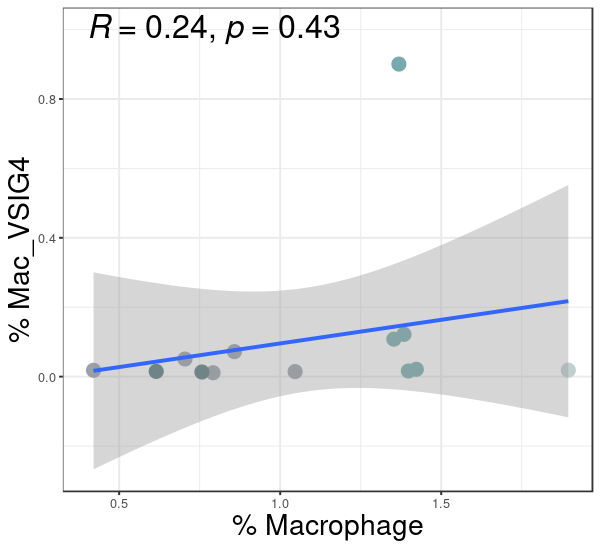

In [76]:
subset_name <- "Mac_VSIG4"
df.target <- subtype_proportion_2[subtype_proportion_2$celltype == subset_name,] %>% 
                dplyr::select(c(proportion_primary,proportion,cluster))
colnames(df.target) <- c("primary","subtype","cluster")
df.target$primary <- log10(df.target$primary+1)
df.target$subtype <- log10(df.target$subtype+1)

options(repr.plot.width = 6, repr.plot.height =5.5, repr.plot.res = 100)
p6 <- ggplot(df.target, aes(x=primary, y=subtype)) +
     geom_point(aes(color=cluster),size = 4) +
    geom_smooth(method = "lm")+
    stat_cor(method = "pearson",label.x = 0.4, label.y = 1, size=label.size) +
    scale_color_manual(values = color_cluster) +
    labs(x="% Macrophage", y=paste0("% ",subset_name))+
    theme_bw() +
    theme(axis.title = element_text(size=title.size), legend.position = "none")
p6

`geom_smooth()` using formula = 'y ~ x'
`geom_smooth()` using formula = 'y ~ x'
`geom_smooth()` using formula = 'y ~ x'
`geom_smooth()` using formula = 'y ~ x'
`geom_smooth()` using formula = 'y ~ x'
`geom_smooth()` using formula = 'y ~ x'


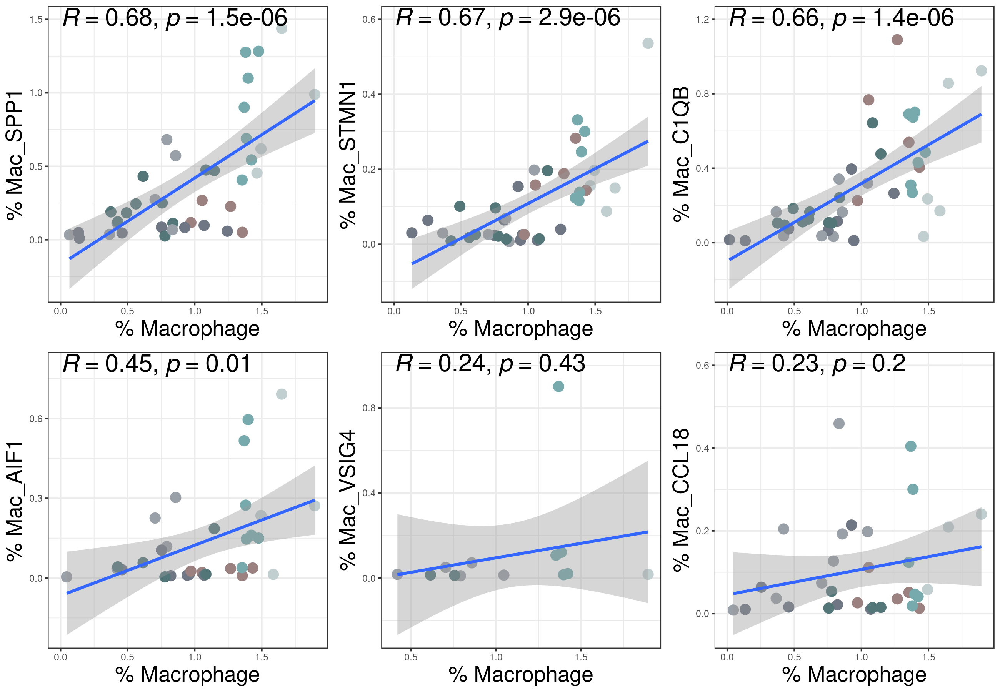

In [77]:
options(repr.plot.width = 13, repr.plot.height =9, repr.plot.res = 200)
cowplot::plot_grid(p1,p2,p5,p4,p6,p3,ncol=3)

In [82]:
pdf(file = paste0(dir2,"Figure/Macro_relevance.pdf"), width = 12, height = 8)
cowplot::plot_grid(p1,p2,p5,p4,p6,p3,ncol=3)
dev.off()

`geom_smooth()` using formula = 'y ~ x'
`geom_smooth()` using formula = 'y ~ x'
`geom_smooth()` using formula = 'y ~ x'
`geom_smooth()` using formula = 'y ~ x'
`geom_smooth()` using formula = 'y ~ x'
`geom_smooth()` using formula = 'y ~ x'


png 
  2

### survival prediction of 5 subsets ★

In [308]:
library(survival)
library(survminer)
library(TCGAbiolinks)
library(GSVA)


Attaching package: ‘survminer’


The following object is masked from ‘package:survival’:

    myeloma




In [310]:
tpm_data_frame <- readRDS("/public/workspace202011/pancancer/Zhangcl/liver_metastasis/LIHC_survival_fpkm_count.rds")
tpm_data_frame

,TCGA-G3-A25X-01A-11R-A16W-07,TCGA-DD-AADS-01A-11R-A41C-07,TCGA-G3-AAV3-01A-11R-A37K-07,TCGA-T1-A6J8-01A-11R-A32O-07,TCGA-2Y-A9GU-01A-11R-A38B-07,TCGA-2Y-A9HB-01A-11R-A39D-07,TCGA-DD-A73E-01A-12R-A32O-07,TCGA-EP-A3RK-11A-11R-A22L-07,TCGA-UB-A7MB-01A-11R-A33R-07,TCGA-DD-A73A-01A-12R-A32O-07,⋯,TCGA-DD-A4NP-01A-11R-A28V-07,TCGA-MI-A75I-01A-11R-A32O-07,TCGA-DD-A3A5-01A-11R-A22L-07,TCGA-DD-AACY-01A-11R-A41C-07,TCGA-CC-A5UC-01A-11R-A28V-07,TCGA-CC-A8HV-01A-11R-A36F-07,TCGA-BC-A5W4-01A-11R-A28V-07,TCGA-RC-A7SF-01A-11R-A352-07,TCGA-RC-A6M4-01A-11R-A32O-07,TCGA-ED-A7XO-01A-11R-A352-07
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
TSPAN6,20.3326,17.4542,37.5869,28.5365,29.0013,9.9953,15.8734,17.0619,16.4611,19.2304,⋯,20.6640,24.9578,14.6592,11.9523,31.7556,19.3751,13.1428,12.2367,25.6838,26.9060
TNMD,0.0000,0.0377,0.1167,0.0000,0.0000,0.0129,0.1141,0.0131,0.1770,0.0000,⋯,0.0000,0.0000,0.0488,0.0000,0.0000,0.0000,0.0178,0.0164,0.0000,0.0904
DPM1,15.6717,12.3811,21.1677,13.3974,27.1101,20.0167,22.0762,13.4896,31.4224,14.2143,⋯,17.3455,20.9712,30.7583,15.5421,37.9560,21.3902,23.8809,10.1254,17.7741,26.0970
SCYL3,0.8621,0.1981,1.9138,1.6178,2.0563,2.1966,1.8588,1.0235,2.9055,1.1378,⋯,0.8424,1.3054,0.8129,1.9994,2.0248,2.3560,1.6538,1.0957,1.1761,1.2759
C1orf112,0.5236,0.0186,3.9912,0.4520,0.6122,0.6339,2.2437,0.1658,2.4307,0.2381,⋯,3.8328,0.4808,0.5913,0.2724,1.3126,1.3184,0.3339,0.3128,0.6036,0.8272
FGR,1.4836,0.3950,2.4566,1.1799,0.5367,1.4242,0.3200,1.1075,0.7132,1.6316,⋯,0.5024,0.8179,0.6248,0.3401,1.4067,1.4441,0.2327,0.8317,0.1487,1.3813
CFH,450.6903,45.6800,145.6964,180.1405,373.9467,291.6670,32.5260,147.8365,69.9258,145.1859,⋯,127.9090,169.6624,128.5037,391.2152,48.9051,95.7497,190.2758,106.3969,113.4795,126.4591
FUCA2,34.2555,13.0563,14.6292,24.8400,17.2712,14.0206,15.5609,8.8711,15.7473,9.8111,⋯,18.0093,16.7158,13.9641,12.9859,32.7857,30.2692,14.2756,19.2134,9.4493,17.2821
GCLC,4.6740,3.9266,16.3418,9.5517,5.0151,6.3965,40.0579,7.0325,13.6784,16.8211,⋯,7.1721,13.9038,7.1556,7.1515,6.1570,4.9050,2.2399,8.2077,18.7461,7.2140


In [311]:
count_matrix <- tpm_data_frame
length(colnames(count_matrix))
# TCGA样本的编号以'-'分割，前三列是患者编号，第四列是类型，一般11表示正常样本，01表示肿瘤样本，见https://gdc.cancer.gov/resources-tcga-users/tcga-code-tables/sample-type-codes
samplesTP <- TCGAquery_SampleTypes(barcode = colnames(count_matrix),typesample = c("TP"))
length(samplesTP)
head(samplesTP)

[1] 424

[1] 371

[1] "TCGA-G3-A25X-01A-11R-A16W-07" "TCGA-DD-AADS-01A-11R-A41C-07"
[3] "TCGA-G3-AAV3-01A-11R-A37K-07" "TCGA-T1-A6J8-01A-11R-A32O-07"
[5] "TCGA-2Y-A9GU-01A-11R-A38B-07" "TCGA-2Y-A9HB-01A-11R-A39D-07"

In [312]:
gexp <- count_matrix[,samplesTP]
names(gexp) <- sapply(strsplit(names(gexp),'-'),function(x) paste0(x[1:3],collapse="-"))
as.matrix(gexp)

,TCGA-G3-A25X,TCGA-DD-AADS,TCGA-G3-AAV3,TCGA-T1-A6J8,TCGA-2Y-A9GU,TCGA-2Y-A9HB,TCGA-DD-A73E,TCGA-UB-A7MB,TCGA-DD-A73A,TCGA-DD-AAEG,⋯,TCGA-DD-A4NP,TCGA-MI-A75I,TCGA-DD-A3A5,TCGA-DD-AACY,TCGA-CC-A5UC,TCGA-CC-A8HV,TCGA-BC-A5W4,TCGA-RC-A7SF,TCGA-RC-A6M4,TCGA-ED-A7XO
TSPAN6,20.3326,17.4542,37.5869,28.5365,29.0013,9.9953,15.8734,16.4611,19.2304,11.1186,⋯,20.6640,24.9578,14.6592,11.9523,31.7556,19.3751,13.1428,12.2367,25.6838,26.9060
TNMD,0.0000,0.0377,0.1167,0.0000,0.0000,0.0129,0.1141,0.1770,0.0000,0.0468,⋯,0.0000,0.0000,0.0488,0.0000,0.0000,0.0000,0.0178,0.0164,0.0000,0.0904
DPM1,15.6717,12.3811,21.1677,13.3974,27.1101,20.0167,22.0762,31.4224,14.2143,35.0492,⋯,17.3455,20.9712,30.7583,15.5421,37.9560,21.3902,23.8809,10.1254,17.7741,26.0970
SCYL3,0.8621,0.1981,1.9138,1.6178,2.0563,2.1966,1.8588,2.9055,1.1378,3.2273,⋯,0.8424,1.3054,0.8129,1.9994,2.0248,2.3560,1.6538,1.0957,1.1761,1.2759
C1orf112,0.5236,0.0186,3.9912,0.4520,0.6122,0.6339,2.2437,2.4307,0.2381,0.5869,⋯,3.8328,0.4808,0.5913,0.2724,1.3126,1.3184,0.3339,0.3128,0.6036,0.8272
FGR,1.4836,0.3950,2.4566,1.1799,0.5367,1.4242,0.3200,0.7132,1.6316,0.5001,⋯,0.5024,0.8179,0.6248,0.3401,1.4067,1.4441,0.2327,0.8317,0.1487,1.3813
CFH,450.6903,45.6800,145.6964,180.1405,373.9467,291.6670,32.5260,69.9258,145.1859,426.0589,⋯,127.9090,169.6624,128.5037,391.2152,48.9051,95.7497,190.2758,106.3969,113.4795,126.4591
FUCA2,34.2555,13.0563,14.6292,24.8400,17.2712,14.0206,15.5609,15.7473,9.8111,11.2661,⋯,18.0093,16.7158,13.9641,12.9859,32.7857,30.2692,14.2756,19.2134,9.4493,17.2821
GCLC,4.6740,3.9266,16.3418,9.5517,5.0151,6.3965,40.0579,13.6784,16.8211,8.1013,⋯,7.1721,13.9038,7.1556,7.1515,6.1570,4.9050,2.2399,8.2077,18.7461,7.2140
NFYA,4.4671,1.4604,5.0493,2.9817,3.9777,3.0294,7.3137,5.7275,5.0014,3.1839,⋯,1.8244,8.0281,1.9723,2.9503,6.1905,10.1525,1.4108,2.8442,5.9812,4.5039


In [313]:
clinical <- GDCquery_clinic(project = "TCGA-LIHC", type = "clinical")
clinical <- subset(clinical,select =c(submitter_id,vital_status,days_to_last_follow_up,days_to_death))
clinical$time <- clinical$days_to_death
clinical$time[which(is.na(clinical$days_to_death))] <- clinical$days_to_last_follow_up[which(is.na(clinical$days_to_death))]
clinical

,submitter_id,vital_status,days_to_last_follow_up,days_to_death,time
,<chr>,<chr>,<int>,<int>,<int>
1,TCGA-DD-A73C,Alive,701,NA,701
2,TCGA-5C-AAPD,Alive,20,NA,20
3,TCGA-ZS-A9CE,Alive,1241,NA,1241
4,TCGA-HP-A5N0,Dead,NA,752,752
5,TCGA-DD-AAVQ,Alive,2728,NA,2728
6,TCGA-DD-A1E9,Dead,NA,2759,2759
7,TCGA-DD-AAVR,Alive,2513,NA,2513
8,TCGA-G3-A6UC,Alive,671,NA,671
9,TCGA-BC-A10T,Dead,NA,837,837


In [314]:
## 获得相应亚群的DEG
all_dmarker <- readRDS("/public/workspace202011/pancancer/Zhangcl/liver_metastasis/DEG/macro_mono_DEG.rds")
logFC = 0.5
padj = 0.05
k1 <- (all_dmarker$p_val_adj < padj) & (all_dmarker$avg_log2FC < -logFC)
k2 <- (all_dmarker$p_val_adj < padj) & (all_dmarker$avg_log2FC > logFC)
all_dmarker$change <- ifelse(test = k1, yes = "down", no = ifelse(k2, yes = "up", no = "stable"))

In [460]:
# subset_name <- "Mac_SPP1"
# subset_name <- "Mac_AIF1"
# subset_name <- "Mac_STMN1"
subset_name <- "Mac_CCL18"
# subset_name <- "Mac_C1QB"
# subset_name <- "Mac_VSIG4"

df.target <- filter(all_dmarker, cluster == subset_name)
up_data <- filter(df.target, change=="up") %>% distinct(gene, .keep_all = TRUE) %>% slice_max(avg_log2FC, n=30)
gene.need <- up_data$gene

## 用GSVA来评估5个subset的topDEG高低
genesets <- list(gene.need)
names(genesets) <- "topDEG"
ES <- gsva(as.matrix(gexp), genesets)
ES <- data.frame(t(ES))

Warning message in .filterFeatures(expr, method):
“4133 genes with constant expression values throuhgout the samples.”
Warning message in .filterFeatures(expr, method):
“Since argument method!="ssgsea", genes with constant expression values are discarded.”


Estimating GSVA scores for 1 gene sets.
Estimating ECDFs with Gaussian kernels
  |======================================================================| 100%



In [461]:
mid <- match(clinical$submitter_id, colnames(gexp))
clinical$score <- ES$topDEG[mid]
df <- subset(clinical,select =c(submitter_id,vital_status,days_to_death,time,score))
df <- df[!is.na(df$score),]
df$exp <- ""
df[df$score >= mean(df$score),]$exp <- "High"
df[df$score <  mean(df$score),]$exp <- "Low"
df[df$vital_status=='Dead',]$vital_status <- 2
df[df$vital_status=='Alive',]$vital_status <- 1
df$vital_status <- as.numeric(df$vital_status)
df

Warning message in eval(expr, envir, enclos):
“NAs introduced by coercion”


,submitter_id,vital_status,days_to_death,time,score,exp
,<chr>,<dbl>,<int>,<int>,<dbl>,<chr>
1,TCGA-DD-A73C,1,NA,701,0.164769328,High
2,TCGA-5C-AAPD,1,NA,20,0.426604029,High
3,TCGA-ZS-A9CE,1,NA,1241,-0.010250127,Low
4,TCGA-HP-A5N0,2,752,752,0.204922541,High
5,TCGA-DD-AAVQ,1,NA,2728,0.181399152,High
7,TCGA-DD-AAVR,1,NA,2513,0.696660396,High
8,TCGA-G3-A6UC,1,NA,671,-0.277886198,Low
9,TCGA-BC-A10T,2,837,837,-0.112692473,Low
10,TCGA-4R-AA8I,2,262,262,-0.238587878,Low


In [611]:
title.size <- 20
pval.size <- 7
legend.size <- 15
axis.size <- 20
ticks.size <- 15
custom_theme <- function() {
  theme_survminer() %+replace%
    theme(
      plot.title=element_text(hjust=0.5)
    )
} # 如果你想要把标题放中间,就在画图函数里加上这个ggtheme=custom_theme()

[1] "p = 0.003"

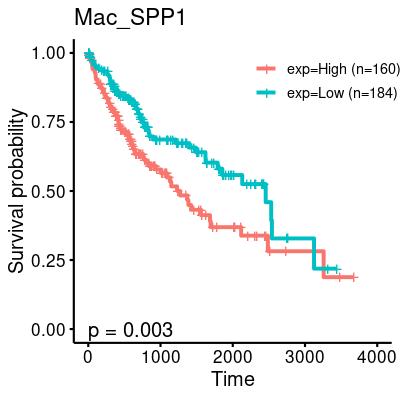

In [433]:
## Mac_SPP1(TOP25)
## 加上days_to_follow
# df_1 <- df
fit <- survfit(Surv(time, vital_status)~exp, data=df_1) # 根据表达建模
surv_pvalue(fit)$pval.txt
options(repr.plot.width=4, repr.plot.height=4, res=200)
pre1 <- ggsurvplot(fit,pval=TRUE,
                 title = subset_name, title.size=title.size,
                legend.labs = c(paste0("exp=High (n=",fit$strata[1],")"),paste0("exp=Low (n=",fit$strata[2],")")),
                 legend.title = "", legend = c(0.8,0.9),
                 pval.coord=c(0,0), pval.size = pval.size)
pre1

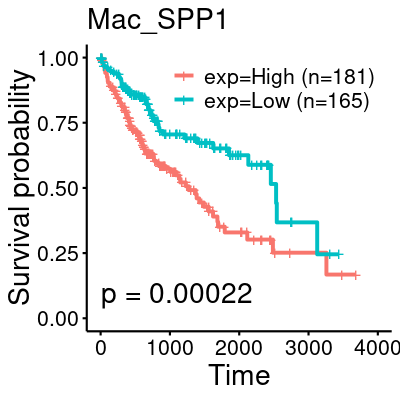

In [633]:
sur.cut <- surv_cutpoint(df_1, time = "time", event = "vital_status", variables = "score")
sur.cat <- surv_categorize(sur.cut)
fit <- survfit(Surv(time, vital_status)~score, data=sur.cat)
options(repr.plot.width=4, repr.plot.height=4, res=200)
subset_name <- "Mac_SPP1"
p1 <- ggsurvplot(fit,
            pval=TRUE,
            title = subset_name, 
            legend.labs = c(paste0("exp=High (n=",fit$strata[1],")"),paste0("exp=Low (n=",fit$strata[2],")")),
            legend.title = "", legend = c(0.6,0.9),
            pval.coord=c(0,0.1), pval.size = pval.size)
p1 <- ggpubr::ggpar(p1,font.title = list(size=title.size),
                    font.legend = list(size=legend.size), font.tickslab = list(size=ticks.size),
                    font.x =list(size=axis.size) ,font.y =list(size=axis.size)) 
p1
# https://www.sthda.com/english/articles/24-ggpubr-publication-ready-plots/82-ggplot2-easy-way-to-change-graphical-parameters/ 图形参数

[1] "p = 0.033"

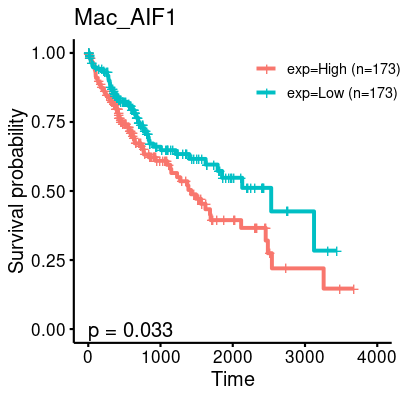

In [436]:
## Mac_AIF1 (TOP40)
## 加上days_to_follow
# df_2 <- df
fit <- survfit(Surv(time, vital_status)~exp, data=df_2) # 根据表达建模
surv_pvalue(fit)$pval.txt
options(repr.plot.width=4, repr.plot.height=4, res=200)
pre2 <- ggsurvplot(fit,pval=TRUE,
                 title = subset_name, title.size=title.size,
                legend.labs = c(paste0("exp=High (n=",fit$strata[1],")"),paste0("exp=Low (n=",fit$strata[2],")")),
                 legend.title = "", legend = c(0.8,0.9),
                 pval.coord=c(0,0), pval.size = pval.size)
pre2

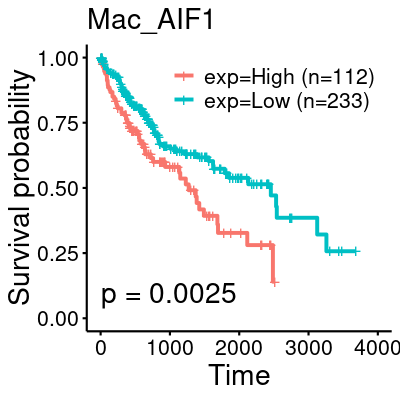

In [632]:
sur.cut <- surv_cutpoint(df_2, time = "time", event = "vital_status", variables = "score")
sur.cat <- surv_categorize(sur.cut)
fit <- survfit(Surv(time, vital_status)~score, data=sur.cat)
options(repr.plot.width=4, repr.plot.height=4, res=200)
subset_name <- "Mac_AIF1"
p2 <- ggsurvplot(fit,
            pval=TRUE,
            title = subset_name, 
            legend.labs = c(paste0("exp=High (n=",fit$strata[1],")"),paste0("exp=Low (n=",fit$strata[2],")")),
            legend.title = "", legend = c(0.6,0.9),
            pval.coord=c(0,0.1), pval.size = pval.size)
p2 <- ggpubr::ggpar(p2,font.title = list(size=title.size),title = subset_name,
                    font.legend = list(size=legend.size), font.tickslab = list(size=ticks.size),
                    font.x =list(size=axis.size) ,font.y =list(size=axis.size)) 
p2

[1] "p = 0.0013"

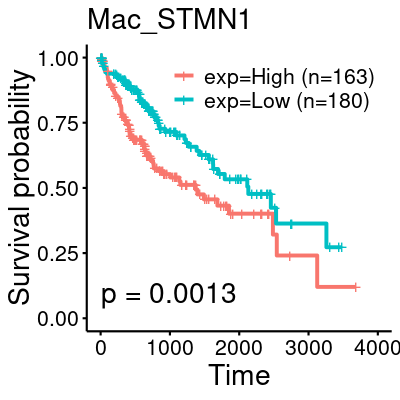

In [638]:
## Mac_STMN1
## 加上days_to_follow
# df_3 <- df
fit <- survfit(Surv(time, vital_status)~exp, data=df_3) # 根据表达建模
surv_pvalue(fit)$pval.txt
options(repr.plot.width=4, repr.plot.height=4, res=200)
subset_name <- "Mac_STMN1"
pre3 <- ggsurvplot(fit,
            pval=TRUE,
            title = subset_name, 
            legend.labs = c(paste0("exp=High (n=",fit$strata[1],")"),paste0("exp=Low (n=",fit$strata[2],")")),
            legend.title = "", legend = c(0.6,0.9),
            pval.coord=c(0,0.1), pval.size = pval.size)
pre3 <- ggpubr::ggpar(pre3,font.title = list(size=title.size),title = subset_name,
                    font.legend = list(size=legend.size), font.tickslab = list(size=ticks.size),
                    font.x =list(size=axis.size) ,font.y =list(size=axis.size)) 
pre3

[1] "p < 0.0001"

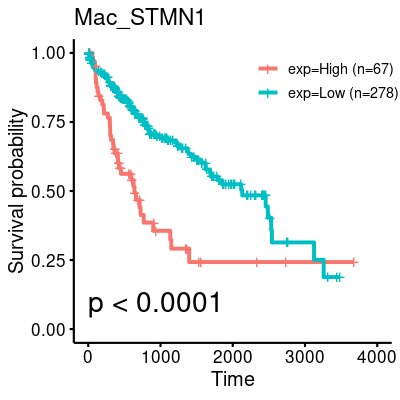

In [483]:
sur.cut <- surv_cutpoint(df_3, time = "time", event = "vital_status", variables = "score")
sur.cat <- surv_categorize(sur.cut)
fit <- survfit(Surv(time, vital_status)~score, data=sur.cat)
surv_pvalue(fit)$pval.txt
subset_name <- "Mac_STMN1"
options(repr.plot.width=4, repr.plot.height=4, res=200)
p3 <- ggsurvplot(fit,
            pval=TRUE,
            title = subset_name, title.size=title.size,
            legend.labs = c(paste0("exp=High (n=",fit$strata[1],")"),paste0("exp=Low (n=",fit$strata[2],")")),
            legend.title = "", legend = c(0.8,0.9),
            pval.coord=c(0,0.1), pval.size = pval.size)
p3

[1] "p = 0.043"

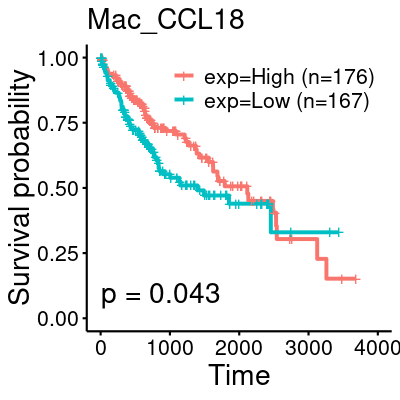

In [636]:
## Mac_CCL18（TOP30）(试了20，40，50，55，60都不行)
## 加上days_to_follow
# df_4 <- df
fit <- survfit(Surv(time, vital_status)~exp, data=df_4) # 根据表达建模
surv_pvalue(fit)$pval.txt
subset_name <- "Mac_CCL18"
options(repr.plot.width=4, repr.plot.height=4, res=200)
pre4 <- ggsurvplot(fit,
            pval=TRUE,
            title = subset_name, 
            legend.labs = c(paste0("exp=High (n=",fit$strata[1],")"),paste0("exp=Low (n=",fit$strata[2],")")),
            legend.title = "", legend = c(0.6,0.9),
            pval.coord=c(0,0.1), pval.size = pval.size)
pre4 <- ggpubr::ggpar(pre4, font.title = list(size=title.size),title = subset_name,
                    font.legend = list(size=legend.size), font.tickslab = list(size=ticks.size),
                    font.x =list(size=axis.size) ,font.y =list(size=axis.size)) 
pre4

[1] "p = 0.0017"

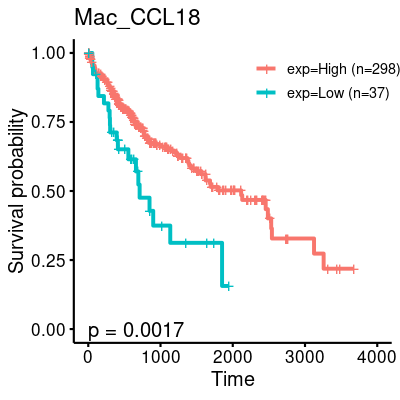

In [445]:
sur.cut <- surv_cutpoint(df_4, time = "time", event = "vital_status", variables = "score")
sur.cat <- surv_categorize(sur.cut)
fit <- survfit(Surv(time, vital_status)~score, data=sur.cat)
surv_pvalue(fit)$pval.txt
options(repr.plot.width=4, repr.plot.height=4, res=200)
p4 <- ggsurvplot(fit,
            pval=TRUE,
            title = subset_name, title.size=title.size,
            legend.labs = c(paste0("exp=High (n=",fit$strata[1],")"),paste0("exp=Low (n=",fit$strata[2],")")),
            legend.title = "", legend = c(0.8,0.9),
            pval.coord=c(0,0), pval.size = pval.size)
p4

[1] "p = 0.91"

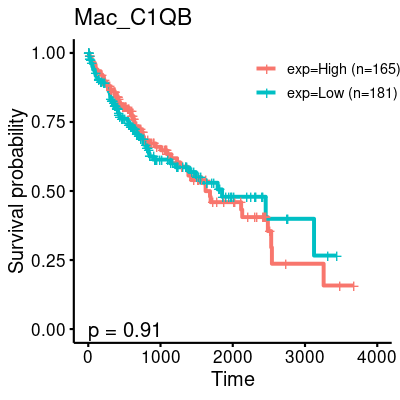

In [450]:
## Mac_C1QB(TOP30)
## 加上days_to_follow
# df_5 <- df
fit <- survfit(Surv(time, vital_status)~exp, data=df_5) # 根据表达建模
surv_pvalue(fit)$pval.txt
options(repr.plot.width=4, repr.plot.height=4, res=200)
pre5 <- ggsurvplot(fit,pval=TRUE,
                 title = subset_name, title.size=title.size,
                legend.labs = c(paste0("exp=High (n=",fit$strata[1],")"),paste0("exp=Low (n=",fit$strata[2],")")),
                 legend.title = "", legend = c(0.8,0.9),
                 pval.coord=c(0,0), pval.size = pval.size)
pre5

[1] "p = 0.18"

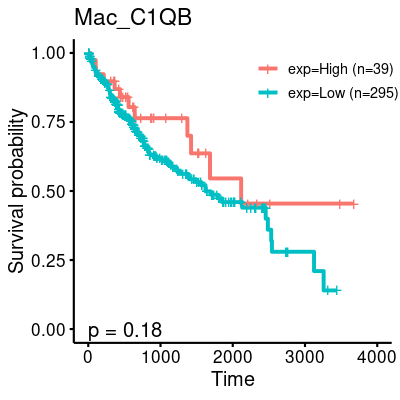

In [451]:
sur.cut <- surv_cutpoint(df_5, time = "time", event = "vital_status", variables = "score")
sur.cat <- surv_categorize(sur.cut)
fit <- survfit(Surv(time, vital_status)~score, data=sur.cat)
surv_pvalue(fit)$pval.txt
options(repr.plot.width=4, repr.plot.height=4, res=200)
p5 <- ggsurvplot(fit,
            pval=TRUE,
            title = subset_name, title.size=title.size,
            legend.labs = c(paste0("exp=High (n=",fit$strata[1],")"),paste0("exp=Low (n=",fit$strata[2],")")),
            legend.title = "", legend = c(0.8,0.9),
            pval.coord=c(0,0), pval.size = pval.size)
p5

[1] "p = 0.13"

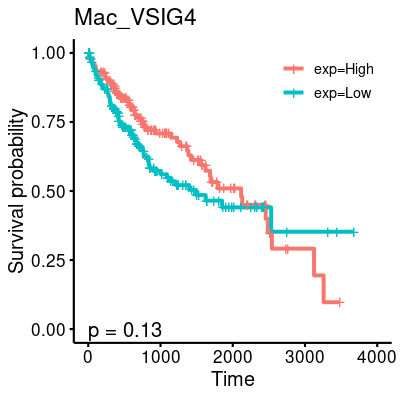

In [456]:
## Mac_VSIG4（TOP50）
## 加上days_to_follow
# df_6 <- df
fit <- survfit(Surv(time, vital_status)~exp, data=df_6) # 根据表达建模
surv_pvalue(fit)$pval.txt
options(repr.plot.width=4, repr.plot.height=4, res=200)
p6 <- ggsurvplot(fit,pval=TRUE,
                 title = subset_name, title.size=title.size,
#                  ggtheme=custom_theme(),
                 legend.title = "", legend = c(0.8,0.9),
                 pval.coord=c(0,0), pval.size = pval.size)
p6

        cutpoint statistic
score -0.2555796  2.634978


high  low 
 293   78 

[1] "p = 0.0032"

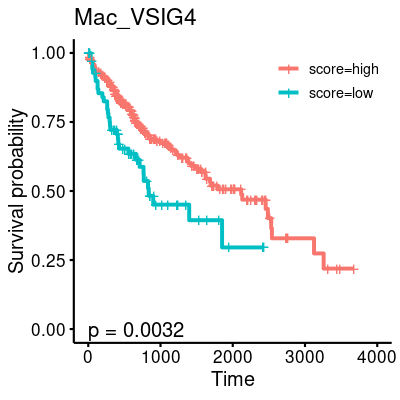

In [457]:
sur.cut <- surv_cutpoint(df_6, time = "time", event = "vital_status", variables = "score")
sur.cut
sur.cat <- surv_categorize(sur.cut)
table(sur.cat$score)
fit <- survfit(Surv(time, vital_status)~score, data=sur.cat)
surv_pvalue(fit)$pval.txt
options(repr.plot.width=4, repr.plot.height=4, res=200)
ggsurvplot(fit,pval=TRUE,
                 title = subset_name, title.size=title.size,
#                  ggtheme=custom_theme(),
                 legend.title = "", legend = c(0.8,0.9),
                 pval.coord=c(0,0), pval.size = pval.size)


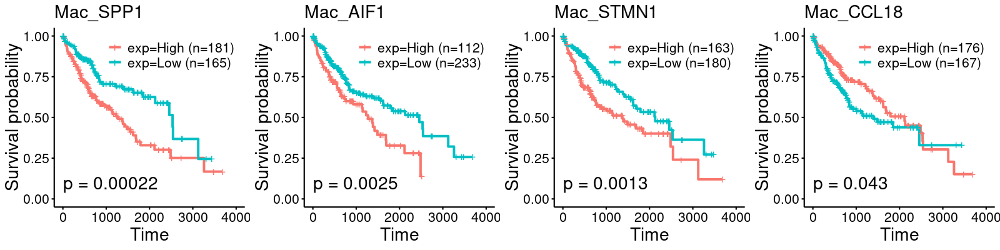

In [639]:
splots <- list()
splots[[1]] <- p1
splots[[2]] <- p2
splots[[3]] <- pre3
splots[[4]] <- pre4

options(repr.plot.width=16, repr.plot.height=4, res=200)
arrange_ggsurvplots(splots, print = TRUE, ncol = 4, nrow = 1) 

In [640]:
pdf(file = paste0(dir2,"Figure/Macro_survival.pdf"), height=4, width=16,onefile=FALSE)
arrange_ggsurvplots(splots, print = TRUE, ncol = 4, nrow = 1) 
dev.off()

png 
  2

### GSEA of DEG ★

In [83]:
library(clusterProfiler)
library(topGO)
library(Rgraphviz)
library(pathview)
library(org.Hs.eg.db)
library(enrichplot)



clusterProfiler v4.3.2.991  For help: https://yulab-smu.top/biomedical-knowledge-mining-book/

If you use clusterProfiler in published research, please cite:
T Wu, E Hu, S Xu, M Chen, P Guo, Z Dai, T Feng, L Zhou, W Tang, L Zhan, X Fu, S Liu, X Bo, and G Yu. clusterProfiler 4.0: A universal enrichment tool for interpreting omics data. The Innovation. 2021, 2(3):100141


Attaching package: ‘clusterProfiler’


The following object is masked from ‘package:purrr’:

    simplify


The following object is masked from ‘package:stats’:

    filter


Loading required package: BiocGenerics

Loading required package: parallel


Attaching package: ‘BiocGenerics’


The following objects are masked from ‘package:parallel’:

    clusterApply, clusterApplyLB, clusterCall, clusterEvalQ,
    clusterExport, clusterMap, parApply, parCapply, parLapply,
    parLapplyLB, parRapply, parSapply, parSapplyLB


The following objects are masked from ‘package:dplyr’:

    combine, intersect, setdiff, union


The 

In [638]:
## 运行时间比较长，在terminal上完成
# DefaultAssay(obj.mm) <- "RNA"
# Idents(obj.mm) <- "subtype"
# top.markers <- FindAllMarkers(obj.mm, min.pct=0.1, logfc.threshold=0.1,
#                               return.thresh=0.1, only.pos=FALSE) ## return.thresh=0.01, test.use="wilcox"
# top.markers$pct.diff <- top.markers$pct.1 -q top.markers$pct.2
# top.markers$name <- obj.mm@misc$geneName[top.markers$gene]
# saveRDS(top.markers, file="/public/workspace202011/pancancer/Zhangcl/liver_metastasis/macro_mono_DEG.rds")

Calculating cluster Mac_CCL3



In [95]:
# df <- read.csv("/public/workspace202011/pancancer/Zhangcl/liver_metastasis/JO_save/celltype_top50Marker.csv") # 这个只有9个marker 是老的了
# df <- readRDS("/mnt/public2/pancancer/metastasis/metastasis.markers.rds") # 这个只有默认的seurat_cluster的DEG，没有subtype的
all_dmarker <- readRDS("/public/workspace202011/pancancer/Zhangcl/liver_metastasis/DEG/macro_mono_DEG.rds")
# all_dmarker <- filter(all_dmarker, cluster %in% c("Mac_SPP1","Mac_STMN1","Mac_CCL3","Mac_MT1G","Mac_C1QB"))
all_dmarker <- filter(all_dmarker, cluster %in% c("Mac_SPP1","Mac_AIF1","Mac_STMN1","Mac_C1QB","Mac_CCL18","Mac_VSIG4"))
all_dmarker

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene,pct.diff,name
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>,<dbl>,<chr>
FBP1,0,2.866521,0.999,0.428,0,Mac_VSIG4,FBP1,0.571,NA
MCEMP1,0,2.456988,0.981,0.194,0,Mac_VSIG4,MCEMP1,0.787,NA
INHBA,0,2.440604,0.899,0.121,0,Mac_VSIG4,INHBA,0.778,NA
CHIT1,0,2.364113,0.599,0.037,0,Mac_VSIG4,CHIT1,0.562,NA
FABP4,0,2.137557,0.881,0.149,0,Mac_VSIG4,FABP4,0.732,NA
TGM2,0,2.050781,0.944,0.205,0,Mac_VSIG4,TGM2,0.739,NA
LTA4H,0,2.000912,0.992,0.407,0,Mac_VSIG4,LTA4H,0.585,NA
FN1,0,1.951277,0.927,0.331,0,Mac_VSIG4,FN1,0.596,NA
ALDH2,0,1.936671,0.986,0.479,0,Mac_VSIG4,ALDH2,0.507,NA


In [96]:
unique(all_dmarker$cluster)
length(unique(all_dmarker$cluster))

[1] Mac_VSIG4 Mac_SPP1  Mac_C1QB  Mac_CCL18 Mac_AIF1  Mac_STMN1
17 Levels: Mac_CCL3 Mac_VSIG4 Mac_SPP1 Mac_C1QB Mac_CCL18 Mac_C1QA ... Mono_HSPA6

[1] 6

In [87]:
## 进行HALLMARK的通路富集分析
geneset = read.gmt("/public/workspace202011/pancancer/Zhangcl/pathway_ref/h.all.v2023.2.Hs.symbols.gmt")
dim(geneset)
geneset$term = str_remove(geneset$term,"HALLMARK_")
head(geneset, n = 1)

[1] 7322    2

,term,gene
,<chr>,<chr>
1,ADIPOGENESIS,ABCA1


In [97]:
## 进行GO的通路富集分析
# for(i in unique(all_dmarker$cluster)){
for(i in c("Mac_AIF1")){
    
    # 不转换该tissue的DEG的ID，直接进行log2FC排序
    df <- all_dmarker[all_dmarker$cluster == i,] %>% filter(p_val_adj < 0.05)
    genelist <- df$avg_log2FC
    names(genelist) <- df$gene
    genelist <- sort(genelist, decreasing= TRUE)
    
    # 富集分析
    enrich.results <- enrichGO(gene = names(genelist), 
                               OrgDb = org.Hs.eg.db, 
                               keyType = "SYMBOL", ont = "BP", 
                               pvalueCutoff = 0.5, qvalueCutoff = 0.5)
    saveRDS(enrich.results, file = paste0("/public/workspace202011/pancancer/Zhangcl/liver_metastasis/DEG/MacMono_DEGs_GO_",i,".rds"))  
}

In [98]:
## 进行GSEA的通路富集分析
# for(i in unique(all_dmarker$cluster)){    
for(i in c("Mac_AIF1")){
    
    # 不转换该tissue的DEG的ID，直接进行log2FC排序
    df <- all_dmarker[all_dmarker$cluster == i,]
    genelist <- df$avg_log2FC
    names(genelist) <- df$gene
    genelist <- sort(genelist, decreasing= TRUE)
    
    # 富集分析
    enrich.results <- GSEA(genelist, 
                           TERM2GENE = geneset, 
                           eps = 0, #For some pathways, in reality P-values are less than 1e-10.(default) 
                           minGSSize = 2, maxGSSize = 1000, 
                           pvalueCutoff = 0.99, pAdjustMethod = "BH", by = "fgsea")
    saveRDS(enrich.results, file = paste0("/public/workspace202011/pancancer/Zhangcl/liver_metastasis/DEG/MacMono_DEGs_GSEA_",i,".rds"))  
}

preparing geneSet collections...

GSEA analysis...

Warning message in preparePathwaysAndStats(pathways, stats, minSize, maxSize, gseaParam, :
“All values in the stats vector are greater than zero and scoreType is "std", maybe you should switch to scoreType = "pos".”
leading edge analysis...

done...



In [176]:
## 构建可视化数据框(GSEA)
all_enrich.df <- data.frame()
term_1 <- list()
term_2 <- list()
for(i in unique(all_dmarker$cluster)){

    enrich.results <- readRDS(file = paste0("/public/workspace202011/pancancer/Zhangcl/liver_metastasis/DEG/MacMono_DEGs_GSEA_",i,".rds"))
    enrich.df <- enrich.results@result
    
    # Filter
    pvalue_min <-  min(enrich.df$pvalue)
    padj_min <-  min(enrich.df$p.adjust)
    if(pvalue_min<0.05){
        enrich.df <- enrich.df %>% filter(pvalue < 0.1 & padj_min <0.5) %>% dplyr::select(c(Description,setSize,enrichmentScore,NES,pvalue,p.adjust,qvalues,rank,core_enrichment))
        term_1 <- append(x = term_1, values = enrich.df$Description)
    }else if(pvalue_min > 0.05 & padj_min > 0.05){
        enrich.df <- enrich.df %>% dplyr::select(c(Description,setSize,enrichmentScore,NES,pvalue,p.adjust,qvalues,rank,core_enrichment))
        term_2 <- append(x = term_2, values = enrich.df$Description)
    }  

    ## gather together
    enrich.df$cluster <- i
    all_enrich.df <- rbind(all_enrich.df, enrich.df)  
}   
     
# all_enrich.df$cluster <- factor(all_enrich.df$cluster, levels = c("Liver","Pancreas","Intestine","Lung","Eye","Mammary","Stomach"))
res_gsea <- all_enrich.df
all_enrich.df

,Description,setSize,enrichmentScore,NES,pvalue,p.adjust,qvalues,rank,core_enrichment,cluster
,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>
ADIPOGENESIS,ADIPOGENESIS,54,0.6215253,1.744242,8.822694e-06,4.234893e-04,2.600373e-04,243,FABP4/ALDH2/PPARG/MGST3/RETN/TKT/DECR1/LPL/VEGFB/REEP5/CAT/GPX4/TALDO1/POR/RMDN3/SQOR/CD151/ECH1/CHCHD10/APLP2/STOM,Mac_VSIG4
COMPLEMENT,COMPLEMENT,34,0.6735508,1.833377,3.359655e-05,8.063173e-04,4.951071e-04,208,LTA4H/FN1/LGALS3/CA2/CEBPB/FDX1/S100A13/OLR1/SERPINA1/CTSC/TIMP2/CALM1/APOC1/SERPING1/ANXA5/CTSD/C1QA/GNAI2,Mac_VSIG4
CHOLESTEROL_HOMEOSTASIS,CHOLESTEROL_HOMEOSTASIS,29,0.6753039,1.810282,9.504788e-05,1.520766e-03,9.338038e-04,274,CD9/LGALS3/PPARG/CXCL16/FABP5/S100A11/LPL/FDFT1/ETHE1/ANXA5/ECH1/GUSB/ACTG1/LDLR/SCD,Mac_VSIG4
COAGULATION,COAGULATION,25,0.6881798,1.811312,1.619460e-04,1.943352e-03,1.193286e-03,392,LTA4H/FN1/CD9/GSN/S100A13/OLR1/SERPINA1/ANXA1/APOC1/SERPING1/ISCU/C1QA/SPARC/PECAM1/LRP1/RAC1/GNB2/LAMP2,Mac_VSIG4
EPITHELIAL_MESENCHYMAL_TRANSITION,EPITHELIAL_MESENCHYMAL_TRANSITION,24,0.6662998,1.747653,8.305033e-04,6.644027e-03,4.079665e-03,341,INHBA/TGM2/FN1/VIM/CAPG/PCOLCE2/IGFBP2/FLNA/SPARC/CD44/JUN/LRP1/DST,Mac_VSIG4
XENOBIOTIC_METABOLISM,XENOBIOTIC_METABOLISM,34,0.6244843,1.699820,7.048788e-04,6.644027e-03,4.079665e-03,140,FBP1/ALDH2/CYP27A1/CES1/CA2/GSTO1/ALAS1/CAT/COMT/POR,Mac_VSIG4
IL2_STAT5_SIGNALING,IL2_STAT5_SIGNALING,33,0.6226889,1.691806,9.712899e-04,6.660274e-03,4.089642e-03,326,TGM2/CA2/CD81/GSTO1/GLIPR2/CAPG/GPX4/CSF1/CTSZ/TTC39B/RNH1/CD44/RRAGD/ANXA4/PLIN2,Mac_VSIG4
ANGIOGENESIS,ANGIOGENESIS,4,0.9113772,1.709626,1.208234e-03,7.249403e-03,4.451388e-03,152,LPL/OLR1/LRPAP1/S100A4,Mac_VSIG4
P53_PATHWAY,P53_PATHWAY,37,0.5843355,1.593514,2.324005e-03,1.239469e-02,7.610775e-03,374,CD81/PHLDA3/LDHB/S100A4/SLC3A2/BAX/CTSD/ISCU/TXNIP/S100A10/STOM/NUPR1/UPP1/CEBPA/JUN/HBEGF/RPS27L/GM2A,Mac_VSIG4


In [177]:
res_gsea[res_gsea$Description == "HEME_METABOLISM",]

,Description,setSize,enrichmentScore,NES,pvalue,p.adjust,qvalues,rank,core_enrichment,cluster
,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>
HEME_METABOLISM,HEME_METABOLISM,28,0.5445957,1.449739,0.02724521,0.06939016,0.04260799,419,CA2/ACP5/MGST3/AQP3/TFRC/CAT/BSG/HAGH/GYPC/SIDT2/LAMP2/HTATIP2/BLVRA,Mac_VSIG4
HEME_METABOLISM1,HEME_METABOLISM,25,0.4571270,1.374072,0.08829569,0.22306279,0.18099393,143,CTSB/UCP2/BMP2K/MPP1/ACP5/BLVRB/LAMP2,Mac_C1QB
HEME_METABOLISM2,HEME_METABOLISM,20,0.5993945,1.547128,0.02574665,0.14814815,0.11782543,127,ACP5/LAMP2/MGST3/BSG/UCP2/CTSB/BLVRB,Mac_CCL18


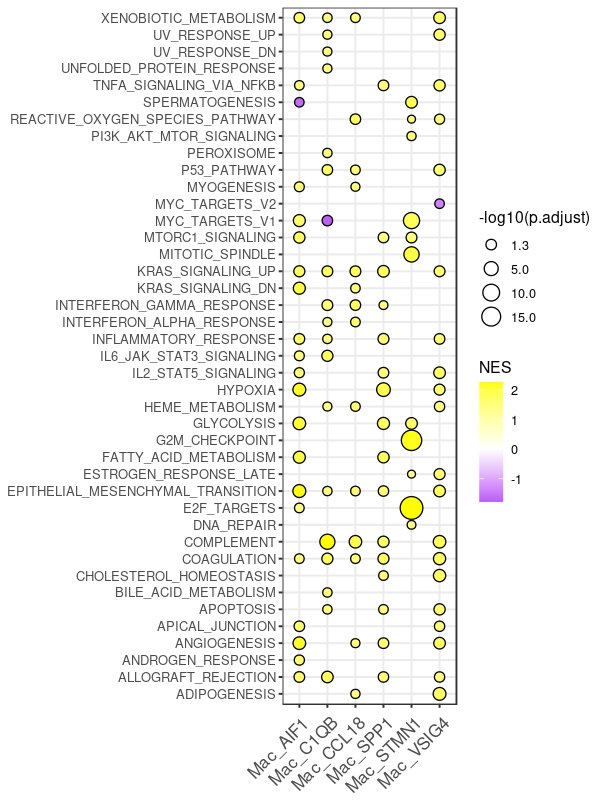

In [173]:
## 进行可视化画点图，颜色是NES值，大小是-log10(padj)
## Visualize
options(repr.plot.width=6, repr.plot.height=8,res=100)
p <- ggplot(all_enrich.df, aes(x = cluster, y = Description)) +
        geom_point(aes(fill=NES, size = -log10(p.adjust)), shape=21)+
        scale_size_continuous(range = c(2,7), breaks = c(1.3,5,10,15))+
        scale_fill_gradient2(low = "purple", mid = "white", high = "yellow")+ 
#这里的颜色改一下，然后下面开始做其中有意思通路的具体细节图，然后参考打分把细胞富集UMAP做出来，至于要不要热图，看情况
        labs(x=NULL,y=NULL)+
        theme_bw()+
        theme(axis.text.x = element_text(angle=45, size = 12, hjust = 0.95,vjust = 0.9),
             axis.text.y = element_text(size = 9))
p

In [201]:
## 可以保留的条目:
res_gsea <- res_gsea[res_gsea$Description %in% c(
# Mac_C1QB
# "PEROXISOME", # 过氧化物酶体,缺氧
"HYPOXIA",
# "P53_PATHWAY", # 抗肿瘤通路
# Mac_SPP1,Mac_AIF1
"EPITHELIAL_MESENCHYMAL_TRANSITION",
# "TNFA_SIGNALING_VIA_NFKB", # 活化巨噬细胞产生,炎症反应
# Mac_STMN1
"MYC_TARGETS_V1", # 都和增长有关
"MITOTIC_SPINDLE",
"G2M_CHECKPOINT",
"E2F_TARGETS",
# Mac_VSIG4,Mac_CCL18
"HEME_METABOLISM", # 高血红素分解代谢率被证实在塑造有利于免疫抑制、血管生成和上皮间质转化的促转移性肿瘤微环境中起关键作用
"ANGIOGENESIS" # 血管生成
),]
res_gsea

,Description,setSize,enrichmentScore,NES,pvalue,p.adjust,qvalues,rank,core_enrichment,cluster
,<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>
EPITHELIAL_MESENCHYMAL_TRANSITION,EPITHELIAL_MESENCHYMAL_TRANSITION,24,0.6662998,1.747653,8.305033e-04,6.644027e-03,4.079665e-03,341,INHBA/TGM2/FN1/VIM/CAPG/PCOLCE2/IGFBP2/FLNA/SPARC/CD44/JUN/LRP1/DST,Mac_VSIG4
ANGIOGENESIS,ANGIOGENESIS,4,0.9113772,1.709626,1.208234e-03,7.249403e-03,4.451388e-03,152,LPL/OLR1/LRPAP1/S100A4,Mac_VSIG4
HYPOXIA,HYPOXIA,26,0.6030628,1.595623,6.811386e-03,2.335332e-02,1.433976e-02,326,FBP1/TGM2/GLRX/ANXA2/CITED2/S100A4/GAA/HSPA5/JUN/RRAGD/PLIN2,Mac_VSIG4
HEME_METABOLISM,HEME_METABOLISM,28,0.5445957,1.449739,2.724521e-02,6.939016e-02,4.260799e-02,419,CA2/ACP5/MGST3/AQP3/TFRC/CAT/BSG/HAGH/GYPC/SIDT2/LAMP2/HTATIP2/BLVRA,Mac_VSIG4
HYPOXIA1,HYPOXIA,47,0.6671493,1.928109,6.768862e-07,3.181365e-05,2.280038e-05,162,MIF/PLIN2/LDHA/ALDOA/GAPDH/SDC2/ERO1A/ADM/TPI1/ENO1/ANGPTL4/HK2/PGK1/SLC2A1/NDRG1/SLC2A3/ANXA2/P4HA1/PLAUR/BTG1/FBP1/SDC4/BNIP3L/SLC2A5/ENO2/FAM162A/IL6/SERPINE1/GPI,Mac_SPP1
ANGIOGENESIS1,ANGIOGENESIS,7,0.7559268,1.623646,1.048491e-02,4.629807e-02,3.318115e-02,30,SPP1/TIMP1,Mac_SPP1
EPITHELIAL_MESENCHYMAL_TRANSITION1,EPITHELIAL_MESENCHYMAL_TRANSITION,37,0.5415545,1.537237,1.670525e-02,6.039591e-02,4.328486e-02,165,SPP1/CXCL8/LGALS1/TIMP1/CXCL1/EMP3/VIM/FN1/CAPG/PLAUR/CD44/SDC4/ENO2/IL6/SERPINE1/TPM4,Mac_SPP1
MYC_TARGETS_V1,MYC_TARGETS_V1,18,-0.3632237,-1.778104,8.265158e-03,5.374872e-02,4.361190e-02,586,PSMB3/NME1/PRDX3/G3BP1/SSB/PRDX4/UBE2L3/PSMD3/PSMD14/PSMB2/PSMD1/STARD7/KPNB1/HDAC2/CDK4/GLO1/COX5A,Mac_C1QB
EPITHELIAL_MESENCHYMAL_TRANSITION2,EPITHELIAL_MESENCHYMAL_TRANSITION,28,0.4766904,1.462389,4.979675e-02,1.842541e-01,1.495044e-01,179,FUCA1/SPP1/CD59/PMP22/DAB2/MMP14/CAPG/TGFBI/IL32/PPIB,Mac_C1QB


In [175]:
res_gsea[res_gsea$Discription == "HEME_METABOLISM",]

Description,setSize,enrichmentScore,NES,pvalue,p.adjust,qvalues,rank,core_enrichment,cluster
<chr>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>


In [213]:
## 构建可视化数据框(GO)
all_enrich.df <- data.frame()
term_1 <- list()
term_2 <- list()
for(i in unique(all_dmarker$cluster)){

    enrich.results <- readRDS(file = paste0("/public/workspace202011/pancancer/Zhangcl/liver_metastasis/DEG/MacMono_DEGs_GO_",i,".rds"))
    enrich.df <- enrich.results@result
    
    # Filter
    pvalue_min <-  min(enrich.df$pvalue)
    padj_min <-  min(enrich.df$p.adjust)
    if(pvalue_min<0.05){
        enrich.df <- enrich.df %>% filter(pvalue < 0.1 & padj_min <0.5) %>% dplyr::select(c(Description,pvalue,p.adjust,qvalue,geneID,Count))
        term_1 <- append(x = term_1, values = enrich.df$Description)
    }else if(pvalue_min > 0.05 & padj_min > 0.05){
        enrich.df <- enrich.df %>% dplyr::select(c(Description,pvalue,p.adjust,qvalue,geneID,Count))
        term_2 <- append(x = term_2, values = enrich.df$Description)
    }  

    ## gather together
    enrich.df$cluster <- i
    all_enrich.df <- rbind(all_enrich.df, enrich.df)  
}   
     
# all_enrich.df$cluster <- factor(all_enrich.df$cluster, levels = c("Liver","Pancreas","Intestine","Lung","Eye","Mammary","Stomach"))
res_go <- all_enrich.df
all_enrich.df

,Description,pvalue,p.adjust,qvalue,geneID,Count,cluster
,<chr>,<dbl>,<dbl>,<dbl>,<chr>,<int>,<chr>
GO:0043312,neutrophil degranulation,2.190123e-38,1.259759e-34,1.048954e-34,MCEMP1/CHIT1/LTA4H/LGALS3/GSN/BRI3/SLC11A1/RETN/CSTB/FABP5/ALOX5/S100A11/ANXA2/HEXB/GRN/OLR1/FTH1/MME/SERPINA1/CAT/PTPN6/CTSC/PYCARD/OSCAR/CTSZ/LAMTOR1/TIMP2/TBC1D10C/AGPAT2/CTSD/CD63/TMC6/GAA/TMEM63A/GUSB/STOM/CYBA/VAT1/DYNLL1/PECAM1/MGST1/TMBIM1/CD44/FTL/CYB5R3/HMOX2/EEF1A1/TCIRG1/RAC1/GM2A/PRAM1/LAMP2/DIAPH1/STXBP2/PDXK/CYBB/IMPDH1/CHI3L1/ENPP4/CTSH/GLB1/FOLR3/GCA/SIRPA/TMEM30A/RAB14/PTAFR/CLEC12A/PSMD7/ADGRE3/FCER1G/HK3/NCKAP1L/SLC44A2/HVCN1/FGR/CCT8/PSMA5/LAMTOR2/ADGRE5/ABR/GMFG/ARL8A/DPP7/NIT2/GSTP1/TMEM179B/QSOX1/TSPAN14/PSMD3/PAFAH1B2/ITGAL/PRDX6/ATP6V0A1/PRKCD/ITGB2/PGM1/ACAA1/DYNLT1/LAMP1/CAMP/SERPINB6/MVP/KCMF1/ERP44/UNC13D/CD33/VAMP8/GALNS/MOSPD2/PSMC2/ATP6V1D/LAIR1/FUCA2/AGA/RAP1B/PYGL/DOK3/NCSTN/ILF2/RAB5C/SPTAN1/SIRPB1/CAP1/BIN2/COMMD3/DEGS1/COMMD9/ARSA/CD58/ASAH1/IQGAP2/ACTR10/ROCK1,134,Mac_VSIG4
GO:0002283,neutrophil activation involved in immune response,4.532515e-38,1.303551e-34,1.085418e-34,MCEMP1/CHIT1/LTA4H/LGALS3/GSN/BRI3/SLC11A1/RETN/CSTB/FABP5/ALOX5/S100A11/ANXA2/HEXB/GRN/OLR1/FTH1/MME/SERPINA1/CAT/PTPN6/CTSC/PYCARD/OSCAR/CTSZ/LAMTOR1/TIMP2/TBC1D10C/AGPAT2/CTSD/CD63/TMC6/GAA/TMEM63A/GUSB/STOM/CYBA/VAT1/DYNLL1/PECAM1/MGST1/TMBIM1/CD44/FTL/CYB5R3/HMOX2/EEF1A1/TCIRG1/RAC1/GM2A/PRAM1/LAMP2/DIAPH1/STXBP2/PDXK/CYBB/IMPDH1/CHI3L1/ENPP4/CTSH/GLB1/FOLR3/GCA/SIRPA/TMEM30A/RAB14/PTAFR/CLEC12A/PSMD7/ADGRE3/FCER1G/HK3/NCKAP1L/SLC44A2/HVCN1/FGR/CCT8/PSMA5/LAMTOR2/ADGRE5/ABR/GMFG/ARL8A/DPP7/NIT2/GSTP1/TMEM179B/QSOX1/TSPAN14/PSMD3/PAFAH1B2/ITGAL/PRDX6/ATP6V0A1/PRKCD/ITGB2/PGM1/ACAA1/DYNLT1/LAMP1/CAMP/SERPINB6/MVP/KCMF1/ERP44/UNC13D/CD33/VAMP8/GALNS/MOSPD2/PSMC2/ATP6V1D/LAIR1/FUCA2/AGA/RAP1B/PYGL/DOK3/NCSTN/ILF2/RAB5C/SPTAN1/SIRPB1/CAP1/BIN2/COMMD3/DEGS1/COMMD9/ARSA/CD58/ASAH1/IQGAP2/ACTR10/ROCK1,134,Mac_VSIG4
GO:0044242,cellular lipid catabolic process,2.172534e-15,4.165471e-12,3.468431e-12,FABP4/ABHD5/PNPLA6/PLBD1/FABP5/DECR1/HEXB/LPL/HPGD/APOC1/ECH1/LDLR/ADTRP/ABHD2/LRP1/ECHDC1/ACAA2/GM2A/HEXA/ACAT2/PLA2G15/ACER3/GPCPD1/ECI1/PNPLA2/PCK2/FABP3/AKR1C3/PHYH/HADHB/ACADVL/ALDH3A2/GDE1/HSD17B4/LPIN2/IRS2/ECHDC2/PRDX6/PRKCD/IVD/HADH/PIK3CG/ACAA1/ACOX1/CPT2/ACACB/PPARD/AKT1/PNPLA3/ACAT1/SRD5A3/PNPLA4/SCP2/ILVBL/MLYCD/SESN2/PCCA/ASAH1/INPP5F,59,Mac_VSIG4
GO:0070125,mitochondrial translational elongation,5.835419e-13,8.391333e-10,6.987147e-10,MRPS15/MRPL14/MRPL34/TUFM/MRPS23/MRPL41/MRPL40/MRPL51/CHCHD1/MRPS18B/MRPL4/MRPL11/MRPS16/MRPL17/MRPS12/MRPS22/MRPL57/MRPS7/MRPL22/MRPL32/MRPS26/MRPL43/MRPL13/MRPL27/GADD45GIP1/MRPS30/MRPL35/AURKAIP1/MRPS18C/MRPL16/MRPS36,31,Mac_VSIG4
GO:0016042,lipid catabolic process,2.912371e-12,3.350391e-09,2.789744e-09,FABP4/CYP27A1/CES1/ABHD5/PNPLA6/PLBD1/FABP5/DECR1/HEXB/LPL/HPGD/NCEH1/APOC1/ECH1/HCAR2/LDLR/ADTRP/ABHD2/LRP1/ECHDC1/ACAA2/GM2A/HEXA/ACAT2/DDHD1/PLA2G15/ACER3/GPCPD1/ECI1/PNPLA2/PCK2/FABP3/AKR1C3/PDE3B/PHYH/HADHB/ACADVL/ALDH3A2/GDE1/HSD17B4/LPIN2/IRS2/PAFAH1B2/ECHDC2/PRDX6/PRKCD/IVD/HADH/PIK3CG/ACAA1/ACOX1/CPT2/ACACB/PPARD/AKT1/PNPLA3/ACAT1/PAFAH2/SRD5A3/PNPLA4/SCP2/ILVBL/MLYCD/SESN2/PCCA/HSD17B14/ASAH1/INPP5F,68,Mac_VSIG4
GO:0002474,antigen processing and presentation of peptide antigen via MHC class I,3.631765e-12,3.481652e-09,2.899040e-09,NCF2/PSMA7/PSMD8/CYBA/BCAP31/ERAP2/ACE/CYBB/MR1/NCF4/PSMB5/FCGR1A/PSMD7/FCER1G/HLA-A/PSMA5/PSMB8/PSMD3/PSME4/HLA-F/PSMB3/PSMA3/PSMC4/PSMB6/VAMP8/PSMF1/PSMC2/CALR/TAPBPL/MFSD6/PSMB2/TAP2,32,Mac_VSIG4
GO:0032543,mitochondrial translation,4.388895e-12,3.606417e-09,3.002928e-09,MRPS15/MRPL14/MRPL34/TUFM/MRPS23/MRPL41/MRPL40/MRPL51/CHCHD1/MRPS18B/YARS2/MRPL4/MRPL11/MRPS16/MRPL17/MRPS12/MRPS22/MRPL57/MRPS7/MALSU1/MRPL22/MRPL32/MRPS26/MRPL43/CDK5RAP1/MRPL13/C1QBP/MRPL27/GADD45GIP1/MRPS30/MRPL35/AURKAIP1/MRPS18C/RMND1/TRMT10C/MRPL16/MRPS36/RCC1L,38,Mac_VSIG4
GO:0070126,mitochondrial translational termination,5.076723e-12,3.650164e-09,3.039354e-09,MRPS15/MRPL14/MRPL34/MRPS23/MRPL41/MRPL

In [104]:
write.csv(all_enrich.df, file = "/public/workspace202011/pancancer/Zhangcl/liver_metastasis/DEG/MacMono_DEGs_GO_raw_4.csv")

In [219]:
## 可以保留这些通路
res_go <- res_go[res_go$Description %in% c(
"mitochondrial translation", # 线粒体翻译能调节巨噬细胞功能，
"protein targeting to ER", # 蛋白质合成
"translational initiation",

# Mac_SPP1
"oxidative phosphorylation",
"response to hypoxia",
"aging",
"regulation of ERK1 and ERK2 cascade",
"regulation of angiogenesis",
"epithelium migration",
"epithelial cell proliferation",
# Mac_STMN1
 "Wnt signaling pathway, planar cell polarity pathway",
"non-canonical Wnt signaling pathway",
"Fc receptor signaling pathway",
# Mac_C1QB
"leukocyte cell-cell adhesion",
"regulation of leukocyte proliferation",
"negative regulation of immune system process",
"response to oxidative stress",
# "receptor signaling pathway via STAT",

"neutrophil degranulation",
"antigen processing and presentation",
"response to interferon-gamma",
# "response to endoplasmic reticulum stress",
"negative regulation of immune response",
"pH reduction",

# Mac_CCL18
"lipid catabolic process",
"fatty acid metabolic process",
# "platelet degranulation",
"fatty acid oxidation",
"heme metabolic process"
# "cell redox homeostasis"

    
# # Mac_MT1G
#     "detoxification of copper ion",
# "response to zinc ion",
# "response to toxic substance"
),]
res_go

,Description,pvalue,p.adjust,qvalue,geneID,Count,cluster
,<chr>,<dbl>,<dbl>,<dbl>,<chr>,<int>,<chr>
GO:0043312,neutrophil degranulation,2.190123e-38,1.259759e-34,1.048954e-34,MCEMP1/CHIT1/LTA4H/LGALS3/GSN/BRI3/SLC11A1/RETN/CSTB/FABP5/ALOX5/S100A11/ANXA2/HEXB/GRN/OLR1/FTH1/MME/SERPINA1/CAT/PTPN6/CTSC/PYCARD/OSCAR/CTSZ/LAMTOR1/TIMP2/TBC1D10C/AGPAT2/CTSD/CD63/TMC6/GAA/TMEM63A/GUSB/STOM/CYBA/VAT1/DYNLL1/PECAM1/MGST1/TMBIM1/CD44/FTL/CYB5R3/HMOX2/EEF1A1/TCIRG1/RAC1/GM2A/PRAM1/LAMP2/DIAPH1/STXBP2/PDXK/CYBB/IMPDH1/CHI3L1/ENPP4/CTSH/GLB1/FOLR3/GCA/SIRPA/TMEM30A/RAB14/PTAFR/CLEC12A/PSMD7/ADGRE3/FCER1G/HK3/NCKAP1L/SLC44A2/HVCN1/FGR/CCT8/PSMA5/LAMTOR2/ADGRE5/ABR/GMFG/ARL8A/DPP7/NIT2/GSTP1/TMEM179B/QSOX1/TSPAN14/PSMD3/PAFAH1B2/ITGAL/PRDX6/ATP6V0A1/PRKCD/ITGB2/PGM1/ACAA1/DYNLT1/LAMP1/CAMP/SERPINB6/MVP/KCMF1/ERP44/UNC13D/CD33/VAMP8/GALNS/MOSPD2/PSMC2/ATP6V1D/LAIR1/FUCA2/AGA/RAP1B/PYGL/DOK3/NCSTN/ILF2/RAB5C/SPTAN1/SIRPB1/CAP1/BIN2/COMMD3/DEGS1/COMMD9/ARSA/CD58/ASAH1/IQGAP2/ACTR10/ROCK1,134,Mac_VSIG4
GO:0016042,lipid catabolic process,2.912371e-12,3.350391e-09,2.789744e-09,FABP4/CYP27A1/CES1/ABHD5/PNPLA6/PLBD1/FABP5/DECR1/HEXB/LPL/HPGD/NCEH1/APOC1/ECH1/HCAR2/LDLR/ADTRP/ABHD2/LRP1/ECHDC1/ACAA2/GM2A/HEXA/ACAT2/DDHD1/PLA2G15/ACER3/GPCPD1/ECI1/PNPLA2/PCK2/FABP3/AKR1C3/PDE3B/PHYH/HADHB/ACADVL/ALDH3A2/GDE1/HSD17B4/LPIN2/IRS2/PAFAH1B2/ECHDC2/PRDX6/PRKCD/IVD/HADH/PIK3CG/ACAA1/ACOX1/CPT2/ACACB/PPARD/AKT1/PNPLA3/ACAT1/PAFAH2/SRD5A3/PNPLA4/SCP2/ILVBL/MLYCD/SESN2/PCCA/HSD17B14/ASAH1/INPP5F,68,Mac_VSIG4
GO:0032543,mitochondrial translation,4.388895e-12,3.606417e-09,3.002928e-09,MRPS15/MRPL14/MRPL34/TUFM/MRPS23/MRPL41/MRPL40/MRPL51/CHCHD1/MRPS18B/YARS2/MRPL4/MRPL11/MRPS16/MRPL17/MRPS12/MRPS22/MRPL57/MRPS7/MALSU1/MRPL22/MRPL32/MRPS26/MRPL43/CDK5RAP1/MRPL13/C1QBP/MRPL27/GADD45GIP1/MRPS30/MRPL35/AURKAIP1/MRPS18C/RMND1/TRMT10C/MRPL16/MRPS36/RCC1L,38,Mac_VSIG4
GO:0019395,fatty acid oxidation,2.816392e-11,1.246145e-08,1.037618e-08,PPARG/DECR1/POR/ECH1/ECHDC1/ACAA2/ADH5/ACAT2/ECI1/FABP3/PHYH/HADHB/ADIPOR2/ACADVL/ALDH3A2/HSD17B4/IRS2/ECHDC2/IVD/HADH/ACAA1/ACOX1/CPT2/ACACB/PPARD/AKT1/ACAT1/SCP2/ILVBL/MLYCD/SESN2/CYGB,32,Mac_VSIG4
GO:0006631,fatty acid metabolic process,1.248263e-10,3.590005e-08,2.989262e-08,LTA4H/PPARG/CES1/ALOX5AP/ABHD5/FABP5/ALOX5/DECR1/LPL/HPGD/MSMO1/GPX4/POR/ANXA1/APOC1/ACOT7/ECH1/SLC27A3/ADTRP/ACOT4/SCD/ABHD2/ECHDC1/FADS1/ACAA2/ADH5/ACAT2/PLA2G15/NCOR1/ECI1/TECR/PCK2/NR1H2/FABP3/AKR1C3/PHYH/HADHB/CBR1/ADIPOR2/ALKBH7/ACADVL/ALDH3A2/GSTP1/HSD17B4/LPIN2/IRS2/ECHDC2/IVD/HACD3/HADH/ACAA1/ACOX1/NDUFAB1/CPT2/EIF6/ACACB/PPARD/AKT1/HPGDS/HACD1/PNPLA3/ACAT1/SCP2/ILVBL/MLYCD/SESN2/DEGS1/PCCA/HSD17B12/DLD/CYGB,71,Mac_VSIG4
GO:0019882,antigen processing and presentation,3.384736e-10,9.270954e-08,7.719574e-08,SLC11A1/NCF2/PSMA7/PYCARD/CTSD/PSMD8/CYBA/BCAP31/TREM2/DYNLL1/ERAP2/ACE/CYBB/MR1/CTSH/NCF4/CLTA/PSMB5/FCGR1A/PSMD7/FCER1G/OSBPL1A/HLA-A/PSMA5/DCTN6/PSMB8/PSMD3/PSME4/DCTN3/HLA-F/PSMB3/RAB4A/PSMA3/AP2M1/PSMC4/PSMB6/RAB34/VAMP8/PSMF1/PSMC2/HLA-DPA1/CALR/TAPBPL/MFSD6/RILP/PSMB2/AP2S1/TAP2/ACTR10,49,Mac_VSIG4
GO:0001666,response to hypoxia,1.303393e-09,2.883507e-07,2.400988e-07,RGCC/PDLIM1/AQP3/UBB/ATP1B1/ALAS1/VEGFB/PSMA7/CAT/CITED2/LMNA/PSMD8/CYBA/ADAM17/HMOX2/ACVRL1/CARD16/ACAA2/ANGPT2/SLC9A1/CYBB/STUB1/ELOB/PSMB5/TMBIM6/PSMD7/RYR1/PSMA5/FIS1/PSMB8/PLK3/FAM162A/PSMD3/NOP53/ANGPT4/PSME4/PINK1/EIF4EBP1/HILPDA/PSMB3/PSMA3/PSMC4/PSMB6/PHB2/PSMF1/PSMC2/PPARD/AKT1/TRPC6/LONP1/REST/MDM2/DNMT3A/ACTN4/SCFD1/ALKBH5/CUL2/PSMB2/ABAT/NOTCH1/HSF1/HIPK2/CYGB/PIN1,64,Mac_VSIG4
GO:0034341,response to interferon-gamma,7.326404e-07,5.402753e-05,4.498669e-05,PPARG/MRC1/GSN/EVL/SLC11A1/CXCL16/VIM/OAS1/ACTG1/OASL/CD44/CCL23/LGALS9/TRIM25/STXBP2/GBP3/CDC37/SIRPA/PTAFR/FCGR1A/NR1H2/IRF9/HLA-A/OAS2/KIF5B/CASP1/TRIM38/PRKCD/PARP14/PARP9/HLA-F/TRIM8/HLA-DPA1/IRF3/PIAS1/CD58/SP100/OAS3,38,Mac_VSIG4
GO:0045851,pH reduction,9.223403e-06,4.344442e-04,3.617453e-04,CA2/SLC11A1/GRN/ATP6V1F/ATP6AP1/ATP6V0D2/ATP6V0B/ATP6V0D1/TCIRG1/ATP6V1E1/ROGDI/ATP6V0A1/ATP6V1D/CLIC4/CLN5/CCDC115,16,Mac_

In [ ]:
## 通路汇总

In [220]:
res_gsea.rm <- dplyr::select(res_gsea, c(Description, p.adjust, cluster))
res_go.rm <- dplyr::select(res_go, c(Description, p.adjust, cluster))
res_all <- rbind(res_gsea.rm, res_go.rm)
res_all$p.adjust[res_all$p.adjust < 0.0000000001] <- 0.0000000001
res_all

,Description,p.adjust,cluster
,<chr>,<dbl>,<chr>
EPITHELIAL_MESENCHYMAL_TRANSITION,EPITHELIAL_MESENCHYMAL_TRANSITION,6.644027e-03,Mac_VSIG4
ANGIOGENESIS,ANGIOGENESIS,7.249403e-03,Mac_VSIG4
HYPOXIA,HYPOXIA,2.335332e-02,Mac_VSIG4
HEME_METABOLISM,HEME_METABOLISM,6.939016e-02,Mac_VSIG4
HYPOXIA1,HYPOXIA,3.181365e-05,Mac_SPP1
ANGIOGENESIS1,ANGIOGENESIS,4.629807e-02,Mac_SPP1
EPITHELIAL_MESENCHYMAL_TRANSITION1,EPITHELIAL_MESENCHYMAL_TRANSITION,6.039591e-02,Mac_SPP1
MYC_TARGETS_V1,MYC_TARGETS_V1,5.374872e-02,Mac_C1QB
EPITHELIAL_MESENCHYMAL_TRANSITION2,EPITHELIAL_MESENCHYMAL_TRANSITION,1.842541e-01,Mac_C1QB


In [221]:
res_all$Description <- factor(res_all$Description, levels =rev(c(
"neutrophil degranulation",

# Mac_SPP1
"oxidative phosphorylation",
"response to hypoxia",
"HYPOXIA",
"aging",
"regulation of ERK1 and ERK2 cascade",
"ANGIOGENESIS", # 血管生成
"regulation of angiogenesis",
"epithelium migration",
"epithelial cell proliferation",
"EPITHELIAL_MESENCHYMAL_TRANSITION",
# Mac_STMN1
"mitochondrial translation", # 线粒体翻译能调节巨噬细胞功能，
"E2F_TARGETS",
"MYC_TARGETS_V1", # 都和增长有关
 "Wnt signaling pathway, planar cell polarity pathway",
"MITOTIC_SPINDLE",
"G2M_CHEKPOINT",
"non-canonical Wnt signaling pathway",
"Fc receptor signaling pathway",
"protein targeting to ER", # 蛋白质合成
"translational initiation",
# Mac_C1QB

# "PEROXISOME", # 过氧化物酶体,缺氧
# "P53_PATHWAY", # 抗肿瘤通路
# "TNFA_SIGNALING_VIA_NFKB", # 活化巨噬细胞产生,炎症反应
"leukocyte cell-cell adhesion",
"regulation of leukocyte proliferation",
"negative regulation of immune system process",
"response to oxidative stress",
# "receptor signaling pathway via STAT",
"antigen processing and presentation",
"response to interferon-gamma",
# "response to endoplasmic reticulum stress",
"negative regulation of immune response",
"pH reduction",
    
# Mac_CCL18
"lipid catabolic process",
"fatty acid metabolic process",
# "platelet degranulation",
"fatty acid oxidation",
"heme metabolic process",
"HEME_METABOLISM" # 高血红素分解代谢率被证实在塑造有利于免疫抑制、血管生成和上皮间质转化的促转移性肿瘤微环境中起关键作用
# "cell redox homeostasis"

# # Mac_MT1G
#     "detoxification of copper ion",
# "response to zinc ion",
# "response to toxic substance"
)))
# res_all <- filter(res_all, cluster %in% c("Mac_SPP1","Mac_AIF1","Mac_STMN1","Mac_C1QB"))
# res_all$cluster <- factor(res_all$cluster, levels = c("Mac_SPP1","Mac_AIF1","Mac_STMN1","Mac_C1QB"))
res_all$cluster <- factor(res_all$cluster, levels = c("Mac_SPP1","Mac_AIF1","Mac_STMN1","Mac_CCL18","Mac_C1QB","Mac_VSIG4"))

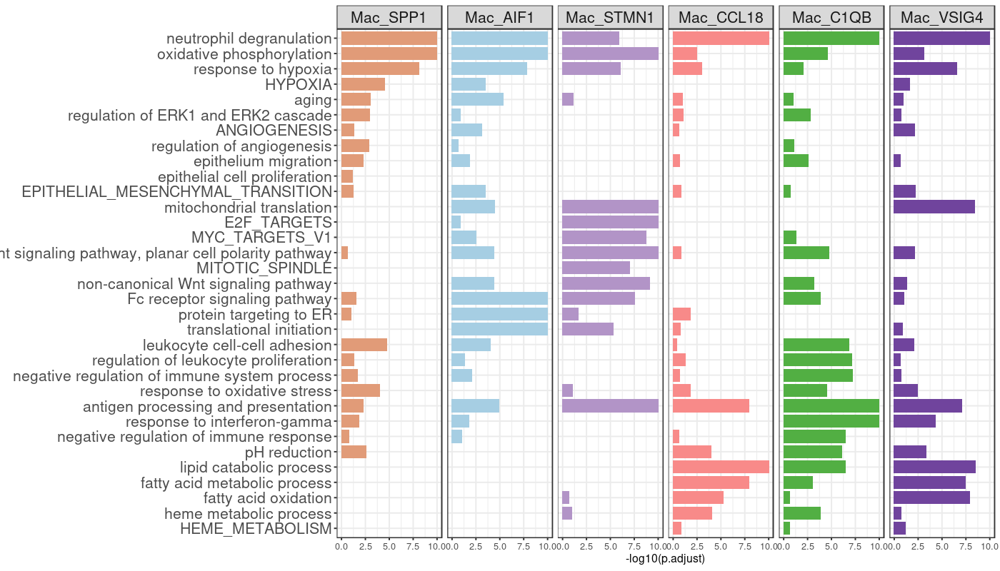

In [222]:
## 进行可视化画点图，颜色是NES值，大小是-log10(padj)
## Visualize
options(repr.plot.width=14, repr.plot.height=8)
p <- ggplot(res_all, aes(x=-log10(p.adjust), y=Description, fill=cluster))+
    geom_bar(stat = 'identity', position = 'dodge', 
           width = 0.8)+
    scale_fill_manual(values = color_mm_celltype)+theme_bw()+labs(y=NULL)+
    theme(axis.text.y = element_text(size = 15), strip.text = element_text(size = 15), legend.position = "none")+
    facet_grid(.~cluster, scales = "free")
p
# 再调整一下顺序,变好看一点.按照值的大小排序
# https://www.nature.com/articles/s41568-020-00312-2 

In [224]:
pdf(file = paste0(dir2,"Figure/Macro_GSEA.pdf"), width = 14, height = 8)
p
dev.off()

png 
  2

### R/o of subset ★

In [650]:
## old 
# df <- as.data.frame(obj.mm@meta.data) %>% 
#         filter(tissue_group %in% c("Liver_NN","Liver_PN","Liver_PT","Pancreas_HM","Eye_HM","Intestine_HM", "Stomach_HM", "Lung_HM", "Mammary_HM")) %>%
#         filter(primary_cluster %in% c("Macrophage","Monocyte")) %>%
#         dplyr::select(c(subtype, group))
# df$group <- str_replace(string = df$group, pattern = "PN", replacement = "NN")

# df <- df %>%
#   group_by(group, subtype) %>%
#   summarise(count = n(), .groups = "drop")
# df$subtype <- unfactor(df$subtype)
# df

group,subtype,count
<chr>,<chr>,<int>
HM,Mac_CCL3,2436
HM,Mac_VSIG4,652
HM,Mac_SPP1,1986
HM,Mac_C1QB,814
HM,Mac_CCL18,403
HM,Mac_C1QA,511
HM,Mac_C1QC,267
HM,Mac_GPR183,491
HM,Mac_BAG3,132


In [365]:
## new (CP) 
df <- as.data.frame(obj.mm@meta.data) %>% 
        filter(tissue_group %in% c("Liver_NN","Liver_PN","Liver_PT","Pancreas_HM","Eye_HM","Intestine_HM", "Stomach_HM", "Lung_HM", "Mammary_HM")) %>%
        filter(primary_cluster %in% c("Macrophage","Monocyte"))
mid <- match(df$sampleID, cluster.df$sampleID)
df$cluster <- cluster.df$cluster[mid]
df <- dplyr::select(df,c(cluster, subtype, sampleID))

df <- df %>%
  group_by(cluster, subtype) %>%
  summarise(count = n(), .groups = "drop")
df$subtype <- unfactor(df$subtype)
df

cluster,subtype,count
<fct>,<chr>,<int>
CP1,Mac_CCL3,1342
CP1,Mac_VSIG4,621
CP1,Mac_SPP1,2133
CP1,Mac_C1QB,641
CP1,Mac_CCL18,221
CP1,Mac_C1QA,187
CP1,Mac_C1QC,183
CP1,Mac_GPR183,212
CP1,Mac_BAG3,67


In [366]:
# contingency_table <- xtabs(count ~ subtype + group, data = df)
contingency_table <- xtabs(count ~ subtype + cluster, data = df)
chi_test <- chisq.test(contingency_table)

Warning message in chisq.test(contingency_table):
“Chi-squared approximation may be incorrect”


In [367]:
expected <- chi_test$expected
observed <- contingency_table
Ro_e <- observed / expected

# 查看Ro/e结果
print(Ro_e)

            cluster
subtype              CP1         CP2         CP3         CP4         CP5
  Mac_AIF1   1.884956979 0.438072732 0.334193262 0.117295618 0.109058958
  Mac_APOE   0.772494172 2.437481612 0.000000000 0.000000000 0.000000000
  Mac_BAG3   0.186325594 1.096866726 3.705285353 0.073305069 0.203525827
  Mac_C1QA   0.329809156 0.651108102 0.676999926 1.046019822 2.848660372
  Mac_C1QB   1.051065774 1.360735608 0.506271264 2.791442049 0.231634539
  Mac_C1QC   0.535028554 1.356092587 0.504203660 2.690883793 1.408204302
  Mac_CCL18  1.699658085 0.388271407 0.224619276 0.388554708 0.170163341
  Mac_CCL3   0.912755294 1.143866102 1.260928416 1.691232518 0.680663607
  Mac_GPR183 0.552443359 1.422473340 1.181484243 0.835718086 1.703085615
  Mac_MLANA  0.785813038 5.043065405 0.259330556 0.234051945 0.340025774
  Mac_MT1G   0.849642079 0.936876967 1.842381248 1.093716127 0.163265989
  Mac_SPP1   2.070012651 0.741043405 0.537184724 0.149222817 0.049551495
  Mac_STMN1  1.416239316 0.8602

In [368]:
mat <- as.data.frame.matrix(Ro_e) 
max(as.matrix(mat))
min(as.matrix(mat))

[1] 5.043065

[1] 0

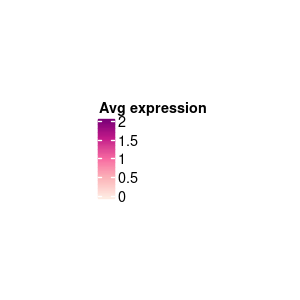

In [380]:
options(repr.plot.width=3, repr.plot.height=3, res=100)
col_fun <- circlize::colorRamp2(breaks = c(0,0.5,1,1.5,2), 
                       colors = c(brewer.pal(5,"RdPu")[1:5]))
lgd = Legend(col_fun = col_fun, title = "Avg expression")
draw(lgd)

In [384]:
pdf(file = paste0(dir2,"Figure/Macro_roe_lgd.pdf"), height=3, width=3)
draw(lgd)
dev.off()

png 
  2

In [392]:
cell_fun <- function(j, i, x, y, width, height, fill) {
  grid.text(
    round(as.matrix(mat)[i, j], 2), 
    x, y,
    gp = gpar(
      fontsize = 10
    ))
}

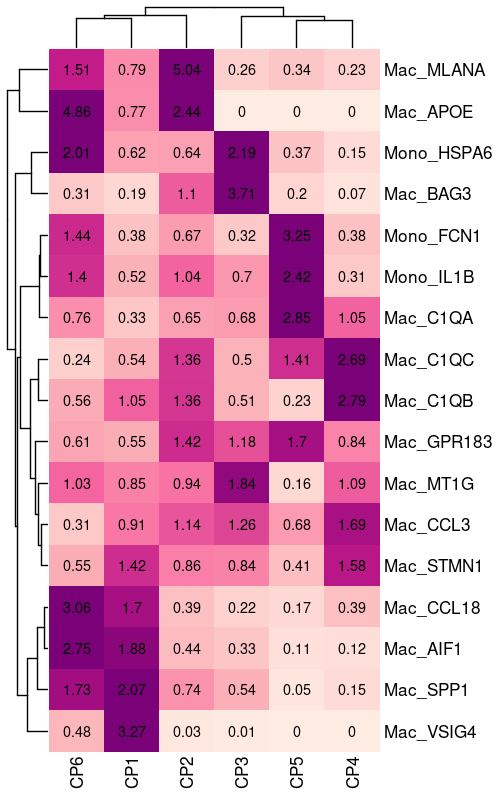

In [393]:
options(repr.plot.width=5, repr.plot.height=8, res=100)
p <- Heatmap(as.matrix(mat), col = col_fun, cell_fun=cell_fun,show_heatmap_legend = FALSE,
             row_names_gp = gpar(fonsize = 10),column_names_gp = gpar(fonsize = 10),
       name = "Ro/e")
p

In [394]:
pdf(file = paste0(dir2,"Figure/Macro_roe.pdf"), height=5.5, width=4.5)
p
dev.off()

png 
  2

### Frequency from PT to HM ★

In [265]:
library(ggthemes)

In [517]:
sample.need <- cluster.df[cluster.df$cluster %in% c("CP1","CP6"),]$sampleID
sample.need

[1] HCC10-PT   HCC08-PT   PDAC01-HM  UVM02-HM   PDAC06-HM  ICC03-PT_2
 [7] PDAC03-HM  UVM03-HM   UVM05-HM   CRC01-HM   PDAC02-HM  CRC03-HM  
[13] CRC02-HM   GC02-HM    LUAD01-HM  LUAD03-HM 
49 Levels: CRC01-HM CRC02-HM CRC03-HM GC01-HM GC02-HM HCC01-PT ... UVM05-HM

In [517]:
meta <- readRDS(paste0(dir1,"metadata.rds"))
dim(meta)

[1] 460337     25

In [518]:
## 算的是亚群占大类比
df <- as.data.frame(obj.mm@meta.data) %>% 
        filter(group %in% c("PT","HM")) %>%
        filter(tissue != "Liver") %>%
        dplyr::select(c(subtype, group, sampleID)) 
head(df,1)
subtype_counts <- df %>%
  group_by(group, subtype, sampleID) %>%
  summarise(count = n(), .groups = "drop")

subtype_proportion <- subtype_counts %>%
  group_by(group, sampleID) %>%
  mutate(total = sum(count), proportion = count / total * 100) %>%
  ungroup() %>% as.data.frame()
subtype_proportion$group <- factor(subtype_proportion$group, levels = c("PT","HM"))
colnames(subtype_proportion)[2] <- "celltype"
subtype_proportion

,subtype,group,sampleID
,<fct>,<chr>,<chr>
GSM3516662@@_121742672193460,Mac_CCL3,PT,LUAD04-PT


group,celltype,sampleID,count,total,proportion
<fct>,<fct>,<chr>,<int>,<int>,<dbl>
HM,Mac_CCL3,CRC01-HM,82,1006,8.15109344
HM,Mac_CCL3,CRC03-HM,9,577,1.55979203
HM,Mac_CCL3,LUAD03-HM,5,79,6.32911392
HM,Mac_CCL3,PDAC01-HM,111,1968,5.64024390
HM,Mac_CCL3,PDAC02-HM,71,708,10.02824859
HM,Mac_CCL3,PDAC03-HM,858,1862,46.07948443
HM,Mac_CCL3,PDAC04-HM,1,9,11.11111111
HM,Mac_CCL3,PDAC06-HM,17,88,19.31818182
HM,Mac_CCL3,PDAC07-HM,8,94,8.51063830


In [519]:
my_theme <- theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = 15),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 0, hjust = 0.85, vjust = 0.95, size = 15),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = 15),
            legend.position="none") 
my_stat <- stat_compare_means(label = "p.format",label.x = 1.5, size = 3.5, method = "t.test")
# 三种非参皆可用：wilcox.test, permutation, bootstrap

In [520]:
remove_outliers <- function(x, na.rm = TRUE, ...) {
  qnt <- quantile(x, probs = c(.25, .75), na.rm = na.rm, ...)
  val <- 1.5 * IQR(x, na.rm = na.rm)
  y <- x
  y[x < (qnt[1] - val)] <- NA
  y[x > (qnt[2] + val)] <- NA
  y
}

In [521]:
subset.name <- "Mac_C1QB"
df.target <- subtype_proportion[subtype_proportion$celltype == subset.name,]
proportion_PT <- df.target$proportion[df.target$group == "PT"]
proportion_HM <- df.target$proportion[df.target$group == "HM"]
wilcox.result <- wilcox.test(proportion_HM, proportion_PT, alternative = "two.sided")
wilcox.result

df.target.rm <- df.target %>% group_by(group) %>% mutate(proportion = remove_outliers(proportion)) %>% ungroup()
proportion_PT <- df.target.rm$proportion[df.target.rm$group == "PT"]
proportion_HM <- df.target.rm$proportion[df.target.rm$group == "HM"]
wilcox.result <- wilcox.test(proportion_HM, proportion_PT, alternative = "two.sided")
wilcox.result


	Wilcoxon rank sum exact test

data:  proportion_HM and proportion_PT
W = 346, p-value = 0.9235
alternative hypothesis: true location shift is not equal to 0



	Wilcoxon rank sum exact test

data:  proportion_HM and proportion_PT
W = 283, p-value = 0.4958
alternative hypothesis: true location shift is not equal to 0



	Shapiro-Wilk normality test

data:  proportion_PT
W = 0.90351, p-value = 0.007617



	Shapiro-Wilk normality test

data:  proportion_HM
W = 0.94325, p-value = 0.276


Warning message:
“Removed 2 rows containing non-finite outside the scale range (`stat_boxplot()`).”
Warning message:
“Removed 2 rows containing non-finite outside the scale range (`stat_compare_means()`).”
Warning message:
“Removed 2 rows containing missing values or values outside the scale range (`geom_point()`).”


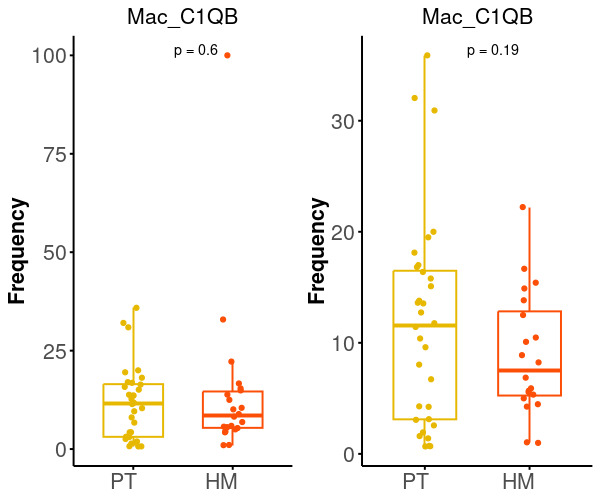

In [ ]:
options(repr.plot.width=6, repr.plot.height=5)
subset.name <- "Mac_C1QB"
df.target <- subtype_proportion[subtype_proportion$celltype == subset.name,]
df.target.rm <- df.target %>% group_by(group) %>% mutate(proportion = remove_outliers(proportion)) %>% ungroup()
proportion_PT <- df.target$proportion[df.target$group == "PT"]
proportion_HM <- df.target$proportion[df.target$group == "HM"]
wilcox.result <- wilcox.test(proportion_HM, proportion_PT, alternative = "two.sided")
proportion_PT <- df.target.rm$proportion[df.target.rm$group == "PT"]
proportion_HM <- df.target.rm$proportion[df.target.rm$group == "HM"]
wilcox.result.rm <- wilcox.test(proportion_HM, proportion_PT, alternative = "two.sided")
shapiro.test(proportion_PT)
shapiro.test(proportion_HM)

p1.pre <- ggplot(df.target, aes(x = group, y = proportion)) +
        geom_boxplot(aes(x = group, color= group, fill=group),alpha=0, 
                     position=position_dodge(preserve = "single"),width=0.6, outlier.color="white")+
        geom_jitter(aes(color=group,fill=group),
                    position=position_jitterdodge(dodge.width=0.65),
                    shape = 21,size=1)+
        scale_color_manual(values=c("NN"="#00afbb","PT"="#e7b800","HM"="#fc4e07"))+  
        scale_fill_manual(values=c("NN"="#00afbb","PT"="#e7b800","HM"="#fc4e07"))+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset.name)+ my_theme+
#         annotate("text", x = 1, y = max(df.target$proportion, na.rm=TRUE), label = paste0("p = ",round(wilcox.result$p.value, 3)))
        my_stat
p1 <- ggplot(df.target.rm, aes(x = group, y = proportion)) +
        geom_boxplot(aes(x = group, color= group, fill=group),alpha=0, 
                     position=position_dodge(preserve = "single"),width=0.6, outlier.color="white")+
        geom_jitter(aes(color=group,fill=group),
                    position=position_jitterdodge(dodge.width=0.65),
                    shape = 21,size=1)+
        scale_color_manual(values=c("NN"="#00afbb","PT"="#e7b800","HM"="#fc4e07"))+  
        scale_fill_manual(values=c("NN"="#00afbb","PT"="#e7b800","HM"="#fc4e07"))+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset.name)+ my_theme+
#         annotate("text", x = 1, y = max(df.target.rm$proportion, na.rm=TRUE), label = paste0("p = ",round(wilcox.result.rm$p.value, 3)))
        my_stat
cowplot::plot_grid(p1.pre,p1,ncol = 2)

In [523]:
subset.name <- "Mac_AIF1"
df.target <- subtype_proportion[subtype_proportion$celltype == subset.name,]
df.target.rm <- df.target %>% group_by(group) %>% mutate(proportion = remove_outliers(proportion)) %>% ungroup()
proportion_PT <- df.target$proportion[df.target$group == "PT"]
proportion_HM <- df.target$proportion[df.target$group == "HM"]
# wilcox.result <- wilcox.test(proportion_HM, proportion_PT, alternative = "two.sided")
# proportion_PT <- df.target.rm$proportion[df.target.rm$group == "PT"]
# proportion_HM <- df.target.rm$proportion[df.target.rm$group == "HM"]
# wilcox.result.rm <- wilcox.test(proportion_HM, proportion_PT, alternative = "two.sided")
shapiro.test(proportion_PT)
shapiro.test(proportion_HM)

p2.pre <- ggplot(df.target, aes(x = group, y = proportion)) +
        geom_boxplot(aes(x = group, color= group, fill=group),alpha=0, 
                     position=position_dodge(preserve = "single"),width=0.6, outlier.color="white")+
        geom_jitter(aes(color=group,fill=group),
                    position=position_jitterdodge(dodge.width=0.65),
                    shape = 21,size=1)+
        scale_color_manual(values=c("NN"="#00afbb","PT"="#e7b800","HM"="#fc4e07"))+  
        scale_fill_manual(values=c("NN"="#00afbb","PT"="#e7b800","HM"="#fc4e07"))+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset.name)+ my_theme+
#         annotate("text", x = 1, y = max(df.target$proportion, na.rm=TRUE), label = paste0("p = ",round(wilcox.result$p.value, 3)))
        my_stat
p2 <- ggplot(df.target.rm, aes(x = group, y = proportion)) +
        geom_boxplot(aes(x = group, color= group, fill=group),alpha=0, 
                     position=position_dodge(preserve = "single"),width=0.6, outlier.color="white")+
        geom_jitter(aes(color=group,fill=group),
                    position=position_jitterdodge(dodge.width=0.65),
                    shape = 21,size=1)+
        scale_color_manual(values=c("NN"="#00afbb","PT"="#e7b800","HM"="#fc4e07"))+  
        scale_fill_manual(values=c("NN"="#00afbb","PT"="#e7b800","HM"="#fc4e07"))+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset.name)+ my_theme+
#         annotate("text", x = 1, y = max(df.target.rm$proportion, na.rm=TRUE), label = paste0("p = ",round(wilcox.result.rm$p.value, 3)))
        my_stat

subset.name <- "Mac_STMN1"
df.target <- subtype_proportion[subtype_proportion$celltype == subset.name,]
df.target.rm <- df.target %>% group_by(group) %>% mutate(proportion = remove_outliers(proportion)) %>% ungroup()
proportion_PT <- df.target$proportion[df.target$group == "PT"]
proportion_HM <- df.target$proportion[df.target$group == "HM"]
# wilcox.result <- wilcox.test(proportion_HM, proportion_PT, alternative = "two.sided")
# proportion_PT <- df.target.rm$proportion[df.target.rm$group == "PT"]
# proportion_HM <- df.target.rm$proportion[df.target.rm$group == "HM"]
# wilcox.result.rm <- wilcox.test(proportion_HM, proportion_PT, alternative = "two.sided")
shapiro.test(proportion_PT)
shapiro.test(proportion_HM)

p3.pre <- ggplot(df.target, aes(x = group, y = proportion)) +
        geom_boxplot(aes(x = group, color= group, fill=group),alpha=0, 
                     position=position_dodge(preserve = "single"),width=0.6, outlier.color="white")+
        geom_jitter(aes(color=group,fill=group),
                    position=position_jitterdodge(dodge.width=0.65),
                    shape = 21,size=1)+
        scale_color_manual(values=c("NN"="#00afbb","PT"="#e7b800","HM"="#fc4e07"))+  
        scale_fill_manual(values=c("NN"="#00afbb","PT"="#e7b800","HM"="#fc4e07"))+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset.name)+ my_theme+
#         annotate("text", x = 1, y = max(df.target$proportion, na.rm=TRUE), label = paste0("p = ",round(wilcox.result$p.value, 3)))
        my_stat
p3 <- ggplot(df.target.rm, aes(x = group, y = proportion)) +
        geom_boxplot(aes(x = group, color= group, fill=group),alpha=0, 
                     position=position_dodge(preserve = "single"),width=0.6, outlier.color="white")+
        geom_jitter(aes(color=group,fill=group),
                    position=position_jitterdodge(dodge.width=0.65),
                    shape = 21,size=1)+
        scale_color_manual(values=c("NN"="#00afbb","PT"="#e7b800","HM"="#fc4e07"))+  
        scale_fill_manual(values=c("NN"="#00afbb","PT"="#e7b800","HM"="#fc4e07"))+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset.name)+ my_theme+
#         annotate("text", x = 1, y = max(df.target.rm$proportion, na.rm=TRUE), label = paste0("p = ",round(wilcox.result.rm$p.value, 3)))
        my_stat

subset.name <- "Mac_CCL18"
df.target <- subtype_proportion[subtype_proportion$celltype == subset.name,]
df.target.rm <- df.target %>% group_by(group) %>% mutate(proportion = remove_outliers(proportion)) %>% ungroup()
proportion_PT <- df.target$proportion[df.target$group == "PT"]
proportion_HM <- df.target$proportion[df.target$group == "HM"]
# wilcox.result <- wilcox.test(proportion_HM, proportion_PT, alternative = "two.sided")
# proportion_PT <- df.target.rm$proportion[df.target.rm$group == "PT"]
# proportion_HM <- df.target.rm$proportion[df.target.rm$group == "HM"]
# wilcox.result.rm <- wilcox.test(proportion_HM, proportion_PT, alternative = "two.sided")
shapiro.test(proportion_PT)
shapiro.test(proportion_HM)

p4.pre <- ggplot(df.target, aes(x = group, y = proportion)) +
        geom_boxplot(aes(x = group, color= group, fill=group),alpha=0, 
                     position=position_dodge(preserve = "single"),width=0.6, outlier.color="white")+
        geom_jitter(aes(color=group,fill=group),
                    position=position_jitterdodge(dodge.width=0.65),
                    shape = 21,size=1)+
        scale_color_manual(values=c("NN"="#00afbb","PT"="#e7b800","HM"="#fc4e07"))+  
        scale_fill_manual(values=c("NN"="#00afbb","PT"="#e7b800","HM"="#fc4e07"))+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset.name)+ my_theme+
#         annotate("text", x = 1, y = max(df.target$proportion, na.rm=TRUE), label = paste0("p = ",round(wilcox.result$p.value, 3)))
        my_stat
p4 <- ggplot(df.target.rm, aes(x = group, y = proportion)) +
        geom_boxplot(aes(x = group, color= group, fill=group),alpha=0, 
                     position=position_dodge(preserve = "single"),width=0.6, outlier.color="white")+
        geom_jitter(aes(color=group,fill=group),
                    position=position_jitterdodge(dodge.width=0.65),
                    shape = 21,size=1)+
        scale_color_manual(values=c("NN"="#00afbb","PT"="#e7b800","HM"="#fc4e07"))+  
        scale_fill_manual(values=c("NN"="#00afbb","PT"="#e7b800","HM"="#fc4e07"))+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset.name)+ my_theme+
#         annotate("text", x = 1, y = max(df.target.rm$proportion, na.rm=TRUE), label = paste0("p = ",round(wilcox.result.rm$p.value, 3)))
        my_stat

subset.name <- "Mac_SPP1"
df.target <- subtype_proportion[subtype_proportion$celltype == subset.name,]
df.target.rm <- df.target %>% group_by(group) %>% mutate(proportion = remove_outliers(proportion)) %>% ungroup()
proportion_PT <- df.target$proportion[df.target$group == "PT"]
proportion_HM <- df.target$proportion[df.target$group == "HM"]
# wilcox.result <- wilcox.test(proportion_HM, proportion_PT, alternative = "two.sided")
# proportion_PT <- df.target.rm$proportion[df.target.rm$group == "PT"]
# proportion_HM <- df.target.rm$proportion[df.target.rm$group == "HM"]
# wilcox.result.rm <- wilcox.test(proportion_HM, proportion_PT, alternative = "two.sided")
shapiro.test(proportion_PT)
shapiro.test(proportion_HM)

p5.pre <- ggplot(df.target, aes(x = group, y = proportion)) +
        geom_boxplot(aes(x = group, color= group, fill=group),alpha=0, 
                     position=position_dodge(preserve = "single"),width=0.6, outlier.color="white")+
        geom_jitter(aes(color=group,fill=group),
                    position=position_jitterdodge(dodge.width=0.65),
                    shape = 21,size=1)+
        scale_color_manual(values=c("NN"="#00afbb","PT"="#e7b800","HM"="#fc4e07"))+  
        scale_fill_manual(values=c("NN"="#00afbb","PT"="#e7b800","HM"="#fc4e07"))+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset.name)+ my_theme+
#         annotate("text", x = 1, y = max(df.target$proportion, na.rm=TRUE), label = paste0("p = ",round(wilcox.result$p.value, 3)))
        my_stat
p5 <- ggplot(df.target.rm, aes(x = group, y = proportion)) +
        geom_boxplot(aes(x = group, color= group, fill=group),alpha=0, 
                     position=position_dodge(preserve = "single"),width=0.6, outlier.color="white")+
        geom_jitter(aes(color=group,fill=group),
                    position=position_jitterdodge(dodge.width=0.65),
                    shape = 21,size=1)+
        scale_color_manual(values=c("NN"="#00afbb","PT"="#e7b800","HM"="#fc4e07"))+  
        scale_fill_manual(values=c("NN"="#00afbb","PT"="#e7b800","HM"="#fc4e07"))+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset.name)+ my_theme+
#         annotate("text", x = 1, y = max(df.target.rm$proportion, na.rm=TRUE), label = paste0("p = ",round(wilcox.result.rm$p.value, 3)))
        my_stat

subset.name <- "Mac_VSIG4"
df.target <- subtype_proportion[subtype_proportion$celltype == subset.name,]
df.target.rm <- df.target %>% group_by(group) %>% mutate(proportion = remove_outliers(proportion)) %>% ungroup()
proportion_PT <- df.target$proportion[df.target$group == "PT"]
proportion_HM <- df.target$proportion[df.target$group == "HM"]
# wilcox.result <- wilcox.test(proportion_HM, proportion_PT, alternative = "two.sided")
# proportion_PT <- df.target.rm$proportion[df.target.rm$group == "PT"]
# proportion_HM <- df.target.rm$proportion[df.target.rm$group == "HM"]
# wilcox.result.rm <- wilcox.test(proportion_HM, proportion_PT, alternative = "two.sided")
shapiro.test(proportion_PT)
shapiro.test(proportion_HM)

p6.pre <- ggplot(df.target, aes(x = group, y = proportion)) +
        geom_boxplot(aes(x = group, color= group, fill=group),alpha=0, 
                     position=position_dodge(preserve = "single"),width=0.6, outlier.color="white")+
        geom_jitter(aes(color=group,fill=group),
                    position=position_jitterdodge(dodge.width=0.65),
                    shape = 21,size=1)+
        scale_color_manual(values=c("NN"="#00afbb","PT"="#e7b800","HM"="#fc4e07"))+  
        scale_fill_manual(values=c("NN"="#00afbb","PT"="#e7b800","HM"="#fc4e07"))+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset.name)+ my_theme+
#         annotate("text", x = 1, y = max(df.target$proportion, na.rm=TRUE), label = paste0("p = ",round(wilcox.result$p.value, 3)))
        my_stat
p6 <- ggplot(df.target.rm, aes(x = group, y = proportion)) +
        geom_boxplot(aes(x = group, color= group, fill=group),alpha=0, 
                     position=position_dodge(preserve = "single"),width=0.6, outlier.color="white")+
        geom_jitter(aes(color=group,fill=group),
                    position=position_jitterdodge(dodge.width=0.65),
                    shape = 21,size=1)+
        scale_color_manual(values=c("NN"="#00afbb","PT"="#e7b800","HM"="#fc4e07"))+  
        scale_fill_manual(values=c("NN"="#00afbb","PT"="#e7b800","HM"="#fc4e07"))+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset.name)+ my_theme+
#         annotate("text", x = 1, y = max(df.target.rm$proportion, na.rm=TRUE), label = paste0("p = ",round(wilcox.result.rm$p.value, 3)))
        my_stat


	Shapiro-Wilk normality test

data:  proportion_PT
W = 0.68775, p-value = 9.748e-06



	Shapiro-Wilk normality test

data:  proportion_HM
W = 0.8876, p-value = 0.1097



	Shapiro-Wilk normality test

data:  proportion_PT
W = 0.79431, p-value = 0.0001093



	Shapiro-Wilk normality test

data:  proportion_HM
W = 0.81186, p-value = 0.002964



	Shapiro-Wilk normality test

data:  proportion_PT
W = 0.6964, p-value = 7.255e-05



	Shapiro-Wilk normality test

data:  proportion_HM
W = 0.68128, p-value = 0.0001057



	Shapiro-Wilk normality test

data:  proportion_PT
W = 0.86966, p-value = 0.001369



	Shapiro-Wilk normality test

data:  proportion_HM
W = 0.8776, p-value = 0.01602



	Shapiro-Wilk normality test

data:  proportion_PT
W = 0.63703, p-value = 8.848e-05



	Shapiro-Wilk normality test

data:  proportion_HM
W = 0.44358, p-value = 7.981e-07


In [526]:
pdf(file = paste0(dir2,"Figure/Macro_proportion_boxplot.pdf"), height=5, width=8)
cowplot::plot_grid(p1, p2,p3,p4,p5,p6,ncol=3)
dev.off()

Warning message:
“Removed 2 rows containing non-finite outside the scale range (`stat_boxplot()`).”
Warning message:
“Removed 2 rows containing non-finite outside the scale range (`stat_compare_means()`).”
Warning message:
“Removed 2 rows containing missing values or values outside the scale range (`geom_point()`).”
Warning message:
“Removed 2 rows containing non-finite outside the scale range (`stat_boxplot()`).”
Warning message:
“Removed 2 rows containing non-finite outside the scale range (`stat_compare_means()`).”
Warning message:
“Removed 2 rows containing missing values or values outside the scale range (`geom_point()`).”
Warning message:
“Removed 3 rows containing non-finite outside the scale range (`stat_boxplot()`).”
Warning message:
“Removed 3 rows containing non-finite outside the scale range (`stat_compare_means()`).”
Warning message:
“Removed 3 rows containing missing values or values outside the scale range (`geom_point()`).”
Warning message:
“Removed 3 rows containing no

png 
  2

In [ ]:
## 根据Ro/e热图，瞄准在CP1中特别富集的，有Mac_C1QB, Mac_CCL3, Mac_STMN1, Mac_CCL18, Mac_SPP1, Mac_VSIG4, 其中有三个还同样在CP6中高浸润。
## 根据箱线图，相对于原发肿瘤，Mac_STMN1, Mac_CCL18, Mac_SPP1在转移性肝癌中浸润增加。

In [396]:
# samstat <- sample_info$patient %>% table
# sampaired <- names(samstat[samstat>1])
# sampaired

[1] "CRC01"   "CRC02"   "CRC03"   "GC01"    "GC02"    "GC07"    "HCC03"  
 [8] "HCC05"   "HCC06"   "HCC07"   "HCC08"   "HCC09"   "HCC10"   "ICC01"  
[15] "ICC02"   "ICC03"   "PDAC01"  "PDAC02"  "PDAC03"  "PNET01"  "SINET01"
[22] "UVM04"   "UVM05"

### Frequency in Liver-NN/Tissue-HM

In [ ]:
## 区别看不同tissue的变化

In [898]:
df <- as.data.frame(obj.mm@meta.data) %>% 
        filter(tissue_group %in% c("Liver_NN","Liver_PN","Liver_PT","Pancreas_HM","Eye_HM","Intestine_HM", "Stomach_HM", "Lung_HM", "Mammary_HM")) %>%
        dplyr::select(c(subtype, tissue_group, sampleID))
df$tissue_group <- str_replace(string = df$tissue_group, pattern = "PN", replacement = "NN")
df

,subtype,tissue_group,sampleID
,<fct>,<chr>,<chr>
GSM4116579@@_18P_AAACCTGGTCTGCGGT,Mac_C1QC,Liver_NN,ICC01-PN
GSM4116579@@_18P_AAACCTGGTTGTCGCG,Mono_IL1B,Liver_NN,ICC01-PN
GSM4116579@@_18P_AAACGGGGTCTTCAAG,Mono_IL1B,Liver_NN,ICC01-PN
GSM4116579@@_18P_AAACGGGGTTGGTAAA,Mac_C1QC,Liver_NN,ICC01-PN
GSM4116579@@_18P_AAAGATGAGTGGTAGC,Mac_GPR183,Liver_NN,ICC01-PN
GSM4116579@@_18P_AAAGATGGTAAGGGCT,Mac_GPR183,Liver_NN,ICC01-PN
GSM4116579@@_18P_AAAGCAAAGTGTTTGC,Mono_FCN1,Liver_NN,ICC01-PN
GSM4116579@@_18P_AAAGCAAGTCAACTGT,Mono_FCN1,Liver_NN,ICC01-PN
GSM4116579@@_18P_AAAGTAGTCCCTCTTT,Mac_STMN1,Liver_NN,ICC01-PN


In [899]:
colnames(df) <- c("subtype","tissue","patient")
head(df, n=1)

,subtype,tissue,patient
,<fct>,<chr>,<chr>
GSM4116579@@_18P_AAACCTGGTCTGCGGT,Mac_C1QC,Liver_NN,ICC01-PN


In [900]:
subtype_counts <- df %>%
  group_by(tissue, subtype, patient) %>%
  summarise(count = n(), .groups = "drop")

subtype_proportion <- subtype_counts %>%
  group_by(tissue, patient) %>%
  mutate(total = sum(count), proportion = count / total * 100) %>%
  ungroup()
subtype_proportion

tissue,subtype,patient,count,total,proportion
<chr>,<fct>,<chr>,<int>,<int>,<dbl>
Eye_HM,Mac_CCL3,UVM01-HM,153,506,30.2371542
Eye_HM,Mac_CCL3,UVM02-HM,90,576,15.6250000
Eye_HM,Mac_CCL3,UVM03-HM,16,360,4.4444444
Eye_HM,Mac_VSIG4,UVM02-HM,1,576,0.1736111
Eye_HM,Mac_VSIG4,UVM03-HM,1,360,0.2777778
Eye_HM,Mac_SPP1,UVM01-HM,6,506,1.1857708
Eye_HM,Mac_SPP1,UVM02-HM,50,576,8.6805556
Eye_HM,Mac_SPP1,UVM04-HM,1,47,2.1276596
Eye_HM,Mac_SPP1,UVM05-HM,1,42,2.3809524


In [901]:
group_color <- c("Eye_HM"="#1a476f", "Intestine_HM"="#90353b","Lung_HM"="#dc8f9e","Mammary_HM"="#f7d3c2","Pancreas_HM"="#e0994c","Stomach_HM"="#a11e61",
          "Liver_PT"="#b4999a","Liver_NN"="#5a4d4d")

In [1041]:
## 在HM中富集的亚群
df_1 <- subtype_proportion[subtype_proportion$subtype == "Mac_APOE",]
p10 <- ggplot(df_1, aes(x = reorder(tissue, proportion, FUN = median), y = proportion)) +
        geom_boxplot(aes(x = tissue, color= tissue, fill=tissue), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        geom_jitter(aes(color=tissue,fill=tissue),
                    position=position_jitterdodge(dodge.width=0.65),shape = 21,size=2)+
        scale_color_manual(values=group_color)+  
        scale_fill_manual(values=group_color)+  
        labs(x=NULL, y ="Frequency") + ggtitle("Mac_APOE")+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = 20),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 15),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = 20),
            scale_y_continuous(limits = c(0,5), breaks = seq(0,5,1)),
            legend.position="none") 

df_1 <- subtype_proportion[subtype_proportion$subtype == "Mac_VSIG4",]
p9 <- ggplot(df_1, aes(x = reorder(tissue, proportion, FUN = median), y = proportion)) +
        geom_boxplot(aes(x = tissue, color= tissue, fill=tissue), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        geom_jitter(aes(color=tissue,fill=tissue),
                    position=position_jitterdodge(dodge.width=0.65),shape = 21,size=2)+
        scale_color_manual(values=group_color)+  
        scale_fill_manual(values=group_color)+  
        labs(x=NULL, y ="Frequency") + ggtitle("Mac_VSIG4")+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = 20),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 15),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = 20),
            legend.position="none") 

df_1 <- subtype_proportion[subtype_proportion$subtype == "Mac_CCL18",]
p8 <- ggplot(df_1, aes(x = reorder(tissue, proportion, FUN = median), y = proportion)) +
        geom_boxplot(aes(x = tissue, color= tissue, fill=tissue), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        geom_jitter(aes(color=tissue,fill=tissue),
                    position=position_jitterdodge(dodge.width=0.65),shape = 21,size=2)+
        scale_color_manual(values=group_color)+  
        scale_fill_manual(values=group_color)+  
        labs(x=NULL, y ="Frequency") + ggtitle("Mac_CCL18")+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = 20),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 15),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = 20),
            legend.position="none") 

df_1 <- subtype_proportion[subtype_proportion$subtype == "Mac_MLANA",]
p7 <- ggplot(df_1, aes(x = reorder(tissue, proportion, FUN = median), y = proportion)) +
        geom_boxplot(aes(x = tissue, color= tissue, fill=tissue), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        geom_jitter(aes(color=tissue,fill=tissue),
                    position=position_jitterdodge(dodge.width=0.65),shape = 21,size=2)+
        scale_color_manual(values=group_color)+  
        scale_fill_manual(values=group_color)+  
        labs(x=NULL, y ="Frequency") + ggtitle("Mac_MLANA")+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = 20),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 15),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = 20),
            legend.position="none") 

df_1 <- subtype_proportion[subtype_proportion$subtype == "Mac_AIF1",]
p6 <- ggplot(df_1, aes(x = reorder(tissue, proportion, FUN = median), y = proportion)) +
        geom_boxplot(aes(x = tissue, color= tissue, fill=tissue), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        geom_jitter(aes(color=tissue,fill=tissue),
                    position=position_jitterdodge(dodge.width=0.65),shape = 21,size=2)+
        scale_color_manual(values=group_color)+  
        scale_fill_manual(values=group_color)+  
        labs(x=NULL, y ="Frequency") + ggtitle("Mac_AIF1")+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = 20),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 15),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = 20),
            legend.position="none") 

df_1 <- subtype_proportion[subtype_proportion$subtype == "Mac_SPP1",]
p5 <- ggplot(df_1, aes(x = reorder(tissue, proportion, FUN = median), y = proportion)) +
        geom_boxplot(aes(x = tissue, color= tissue, fill=tissue), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        geom_jitter(aes(color=tissue,fill=tissue),
                    position=position_jitterdodge(dodge.width=0.65),shape = 21,size=2)+
        scale_color_manual(values=group_color)+  
        scale_fill_manual(values=group_color)+  
        labs(x=NULL, y ="Frequency") + ggtitle("Mac_SPP1")+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = 20),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 15),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = 20),
            legend.position="none") 
df_1 <- subtype_proportion[subtype_proportion$subtype == "Mac_STMN1",]
p4 <- ggplot(df_1, aes(x = reorder(tissue, proportion, FUN = median), y = proportion)) +
        geom_boxplot(aes(x = tissue, color= tissue, fill=tissue), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        geom_jitter(aes(color=tissue,fill=tissue),
                    position=position_jitterdodge(dodge.width=0.65),shape = 21,size=2)+
        scale_color_manual(values=group_color)+  
        scale_fill_manual(values=group_color)+  
        labs(x=NULL, y ="Frequency") + ggtitle("Mac_STMN1")+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = 20),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 15),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = 20),
            legend.position="none") 

df_1 <- subtype_proportion[subtype_proportion$subtype == "Mac_C1QB",]
p2 <- ggplot(df_1, aes(x = reorder(tissue, proportion, FUN = median), y = proportion)) +
        geom_boxplot(aes(x = tissue, color= tissue, fill=tissue), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        geom_jitter(aes(color=tissue,fill=tissue),
                    position=position_jitterdodge(dodge.width=0.65),shape = 21,size=2)+
        scale_color_manual(values=group_color)+  
        scale_fill_manual(values=group_color)+  
        labs(x=NULL, y ="Frequency") + ggtitle("Mac_C1QB")+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = 20),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 15),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = 20),
            legend.position="none") 
df_1 <- subtype_proportion[subtype_proportion$subtype == "Mono_HSPA6",]
p1 <- ggplot(df_1, aes(x = reorder(tissue, proportion, FUN = median), y = proportion)) +
        geom_boxplot(aes(x = tissue, color= tissue, fill=tissue), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        geom_jitter(aes(color=tissue,fill=tissue),
                    position=position_jitterdodge(dodge.width=0.65),shape = 21,size=2)+
        scale_color_manual(values=group_color)+  
        scale_fill_manual(values=group_color)+  
        labs(x=NULL, y ="Frequency") + ggtitle("Mono_HSPA6")+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = 20),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 15),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = 20),
            legend.position="none") 

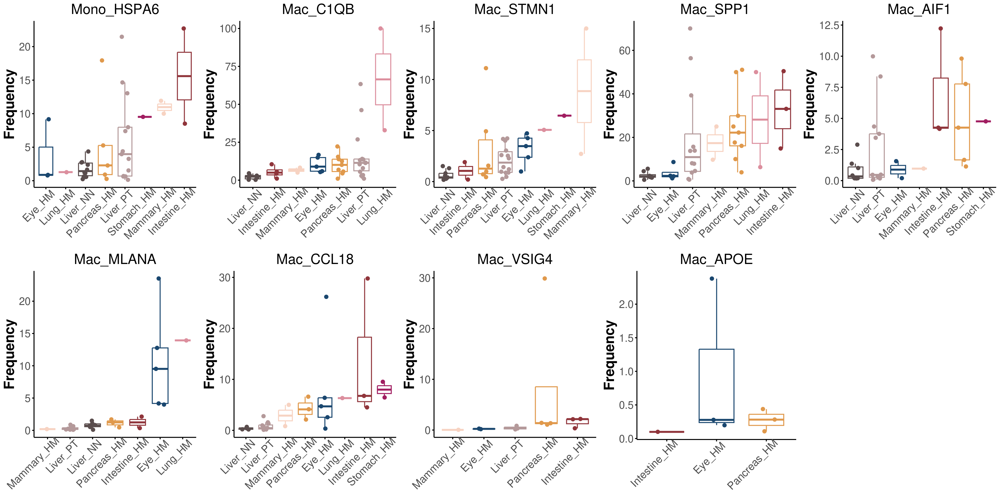

In [1044]:
options(repr.plot.width = 20, repr.plot.height =10, repr.plot.res = 200)
cowplot::plot_grid(p1, p2, p4, p5, p6, p7, p8, p9, p10, ncol=5)

In [938]:
## 在NN中富集但不在HM中富集的亚群

df_1 <- subtype_proportion[subtype_proportion$subtype == "Mono_IL1B",]
p3 <- ggplot(df_1, aes(x = reorder(tissue, proportion, FUN = median), y = proportion)) +
        geom_boxplot(aes(x = tissue, color= tissue, fill=tissue), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        geom_jitter(aes(color=tissue,fill=tissue),
                    position=position_jitterdodge(dodge.width=0.65),shape = 21,size=2)+
        scale_color_manual(values=group_color)+  
        scale_fill_manual(values=group_color)+  
        labs(x=NULL, y ="Frequency") + ggtitle("Mono_IL1B")+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = 20),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 15),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = 20),
            legend.position="none") 

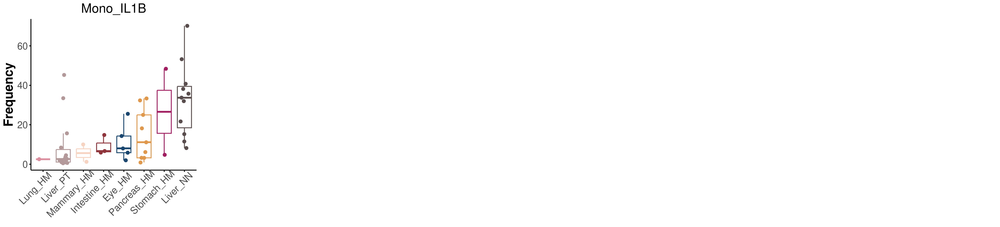

In [1043]:
options(repr.plot.width = 22, repr.plot.height =5, repr.plot.res = 200)
cowplot::plot_grid(p3, ncol=5)

In [1052]:
## NN，PT，HM中均富集的亚群
df_1 <- subtype_proportion[subtype_proportion$subtype == "Mac_CCL3",]
p1 <- ggplot(df_1, aes(x = reorder(tissue, proportion, FUN = median), y = proportion)) +
        geom_boxplot(aes(x = tissue, color= tissue, fill=tissue), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        geom_jitter(aes(color=tissue,fill=tissue),
                    position=position_jitterdodge(dodge.width=0.65),shape = 21,size=2)+
        scale_color_manual(values=group_color)+  
        scale_fill_manual(values=group_color)+  
        labs(x=NULL, y ="Frequency") + ggtitle("Mac_CCL3")+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = 20),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 15),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = 20),
            legend.position="none") 
df_1 <- subtype_proportion[subtype_proportion$subtype == "Mono_FCN1",]
p2 <- ggplot(df_1, aes(x = reorder(tissue, proportion, FUN = median), y = proportion)) +
        geom_boxplot(aes(x = tissue, color= tissue, fill=tissue), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        geom_jitter(aes(color=tissue,fill=tissue),
                    position=position_jitterdodge(dodge.width=0.65),shape = 21,size=2)+
        scale_color_manual(values=group_color)+  
        scale_fill_manual(values=group_color)+  
        labs(x=NULL, y ="Frequency") + ggtitle("Mono_FCN1")+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = 20),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 15),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = 20),
            scale_y_continuous(limits = c(0,5), breaks = seq(0,5,1)),
            legend.position="none") 
df_1 <- subtype_proportion[subtype_proportion$subtype == "Mac_C1QA",]
p3 <- ggplot(df_1, aes(x = reorder(tissue, proportion, FUN = median), y = proportion)) +
        geom_boxplot(aes(x = tissue, color= tissue, fill=tissue), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        geom_jitter(aes(color=tissue,fill=tissue),
                    position=position_jitterdodge(dodge.width=0.65),shape = 21,size=2)+
        scale_color_manual(values=group_color)+  
        scale_fill_manual(values=group_color)+  
        labs(x=NULL, y ="Frequency") + ggtitle("Mac_C1QA")+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = 20),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 15),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = 20),
            legend.position="none") 
df_1 <- subtype_proportion[subtype_proportion$subtype == "Mac_C1QC",]
p4 <- ggplot(df_1, aes(x = reorder(tissue, proportion, FUN = median), y = proportion)) +
        geom_boxplot(aes(x = tissue, color= tissue, fill=tissue), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        geom_jitter(aes(color=tissue,fill=tissue),
                    position=position_jitterdodge(dodge.width=0.65),shape = 21,size=2)+
        scale_color_manual(values=group_color)+  
        scale_fill_manual(values=group_color)+  
        labs(x=NULL, y ="Frequency") + ggtitle("Mac_C1QC")+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = 20),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 15),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = 20),
            legend.position="none") 
df_1 <- subtype_proportion[subtype_proportion$subtype == "Mac_GPR183",]
p5 <- ggplot(df_1, aes(x = reorder(tissue, proportion, FUN = median), y = proportion)) +
        geom_boxplot(aes(x = tissue, color= tissue, fill=tissue), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        geom_jitter(aes(color=tissue,fill=tissue),
                    position=position_jitterdodge(dodge.width=0.65),shape = 21,size=2)+
        scale_color_manual(values=group_color)+  
        scale_fill_manual(values=group_color)+  
        labs(x=NULL, y ="Frequency") + ggtitle("Mac_GPR183")+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = 20),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 15),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = 20),
            legend.position="none") 
df_1 <- subtype_proportion[subtype_proportion$subtype == "Mac_BAG3",]
p6 <- ggplot(df_1, aes(x = reorder(tissue, proportion, FUN = median), y = proportion)) +
        geom_boxplot(aes(x = tissue, color= tissue, fill=tissue), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        geom_jitter(aes(color=tissue,fill=tissue),
                    position=position_jitterdodge(dodge.width=0.65),shape = 21,size=2)+
        scale_color_manual(values=group_color)+  
        scale_fill_manual(values=group_color)+  
        labs(x=NULL, y ="Frequency") + ggtitle("Mac_BAG3")+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = 20),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 15),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = 20),
            legend.position="none") 
df_1 <- subtype_proportion[subtype_proportion$subtype == "Mac_MT1G",]
p7 <- ggplot(df_1, aes(x = reorder(tissue, proportion, FUN = median), y = proportion)) +
        geom_boxplot(aes(x = tissue, color= tissue, fill=tissue), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        geom_jitter(aes(color=tissue,fill=tissue),
                    position=position_jitterdodge(dodge.width=0.65),shape = 21,size=2)+
        scale_color_manual(values=group_color)+  
        scale_fill_manual(values=group_color)+  
        labs(x=NULL, y ="Frequency") + ggtitle("Mac_MT1G")+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = 20),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 15),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = 20),
            legend.position="none") 

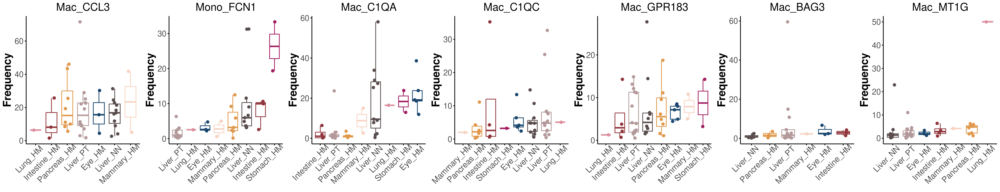

In [1060]:
options(repr.plot.width = 26, repr.plot.height =5, repr.plot.res = 200)
cowplot::plot_grid(p1,p2,p3,p4,p5,p6,p7, ncol=7)

## M1/M2 ★

In [19]:
library(tidyverse)
library(Matrix)
library(cowplot)


Attaching package: ‘Matrix’


The following objects are masked from ‘package:tidyr’:

    expand, pack, unpack




In [671]:
## 用在addulemole里
# M1_score <- list(c("IL23A","IL12B","TNF","CXCL9","CXCL10","CXCL11","CD86","IL1A","IL1B","IL6","CCL5","IRF5","IRF1","CD40",
#                       "IDO1","KYNU","CCR7"))# "IL23A","IL12B"共同组成IL12
# M2_score <- list(c("IL4R","CCL4","CCL13","CCL20","CCL17","CCL18","CCL22","CCL24","LYVE1","VEGFA","VEGFB","VEGFC","VEGFD","EGF",
#               "CTSA","CTSB","CTSC","CTSD","TGFB1","TGFB2","TGFB3","MMP14","MMP19","MMP9","CLEC7A","WNT7B","FASLG","TNFSF12","TNFSF8",
#               "CD276","VTCN1","MSR1","FN1","IRF4"))
# Ang_score <- list(c("CCND2", "CCNE1", "CD44", "CXCR4", "E2F3", "EDN1", "EZH2", "FGF18", "FGFR1", "FYN", "HEY1", "ITGAV", "JAG1", "JAG2", 
#                     "MMP9", "NOTCH1", "PDGFA", "PTK2", "SPP1", "STC1", "TNFAIP6", "TYMP", "VAV2", "VCAN", "VEGFA"))
# Pha_score  <- list(c("MRC1","CD163","MERTK","C1QB"))
## 用在Ucell里
M1_score <- c("IL23A","IL12B","TNF","CXCL9","CXCL10","CXCL11","CD86","IL1A","IL1B","IL6","CCL5","IRF5","IRF1","CD40",
                      "IDO1","KYNU","CCR7")# "IL23A","IL12B"共同组成IL12
M2_score <- c("IL4R","CCL4","CCL13","CCL20","CCL17","CCL18","CCL22","CCL24","LYVE1","VEGFA","VEGFB","VEGFC","VEGFD","EGF",
              "CTSA","CTSB","CTSC","CTSD","TGFB1","TGFB2","TGFB3","MMP14","MMP19","MMP9","CLEC7A","WNT7B","FASLG","TNFSF12","TNFSF8",
              "CD276","VTCN1","MSR1","FN1","IRF4")
Ang_score <- c("CCND2", "CCNE1", "CD44", "CXCR4", "E2F3", "EDN1", "EZH2", "FGF18", "FGFR1", "FYN", "HEY1", "ITGAV", "JAG1", "JAG2", 
                    "MMP9", "NOTCH1", "PDGFA", "PTK2", "SPP1", "STC1", "TNFAIP6", "TYMP", "VAV2", "VCAN", "VEGFA")
Pha_score <- c("MRC1","CD163","MERTK","C1QB")

### geneset score in 5 subsets ★

In [ ]:
### 计算这5个subset在所有样本中的M1/M2等四个基因集得分

In [20]:
library(UCell)

In [672]:
genesets <- list(M1 = M1_score, M2 = M2_score, Ang = Ang_score, Pha = Pha_score)

In [25]:
## 改变gene名
refGenes <- obj.mm@misc$geneName
DefaultAssay(obj.mm) <- "RNA"
if(!any(is.na(refGenes[rownames(obj.mm@assays$RNA@data)]))){
  rownames(obj.mm@assays$RNA@data) <- refGenes[rownames(obj.mm@assays$RNA@data)]
}
head(rownames(obj.mm@assays$RNA@data), n=1)

ENSG00000000003 
       "TSPAN6"

In [674]:
Idents(obj.mm) <- "subtype"
unique(Idents(obj.mm))

[1] Mac_CCL3   Mac_VSIG4  Mac_C1QB   Mac_SPP1   Mac_APOE   Mac_AIF1  
 [7] Mac_MT1G   Mono_IL1B  Mac_BAG3   Mac_GPR183 Mono_FCN1  Mono_HSPA6
[13] Mac_C1QA   Mac_CCL18  Mac_C1QC   Mac_STMN1  Mac_MLANA 
17 Levels: Mac_CCL3 Mac_VSIG4 Mac_SPP1 Mac_C1QB Mac_CCL18 Mac_C1QA ... Mono_HSPA6

In [265]:
obj.mm <- AddModuleScore_UCell(obj.mm, features = genesets, name = NULL, ncores = 4)

In [267]:
write.csv(obj.mm@meta.data, file = paste0("/public/workspace202011/pancancer/Zhangcl/liver_metastasis/DEG/Macrophage_function_score_Ucell.csv"))

In [502]:
res <- read.csv("/public/workspace202011/pancancer/Zhangcl/liver_metastasis/DEG/Macrophage_function_score_Ucell.csv")
res

X,orig.ident,nCount_RNA,nFeature_RNA,percent.mt,nGene,nUMI,nCount_SCT,nFeature_SCT,seurat_clusters,⋯,n,minor,group,patient,cluster,tissue_group,M1,M2,Ang,Pha
<chr>,<chr>,<dbl>,<int>,<dbl>,<int>,<dbl>,<int>,<int>,<int>,⋯,<int>,<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>
GSM3516662@@_121742672193460,GSM3516662,5417,1535,0,1535,5417,3876,1522,7,⋯,8112,c009,PT,LUAD04,NA,Lung_PT,0.09105882,0.19292157,0.15918667,0.3041667
GSM3516662@@_122282764036316,GSM3516662,5858,1566,0,1566,5858,3927,1534,7,⋯,8112,c009,PT,LUAD04,NA,Lung_PT,0.15070588,0.21580392,0.18664000,0.6395833
GSM3516662@@_122310443784563,GSM3516662,12873,2791,0,2791,12873,3559,1208,21,⋯,7418,c003,PT,LUAD04,NA,Lung_PT,0.11913725,0.18712745,0.12821333,0.6782500
GSM3516662@@_122428805802731,GSM3516662,957,556,0,556,957,2829,621,7,⋯,8112,c009,PT,LUAD04,NA,Lung_PT,0.09596078,0.15727451,0.14418667,0.3861667
GSM3516662@@_122436455460197,GSM3516662,12837,2399,0,2399,12837,3425,968,7,⋯,8112,c009,PT,LUAD04,NA,Lung_PT,0.07237255,0.21115686,0.07501333,0.6076667
GSM3516662@@_126706311347611,GSM3516662,2924,1141,0,1141,2924,3234,1140,5,⋯,4914,c008,PT,LUAD04,NA,Lung_PT,0.11356863,0.25600980,0.08661333,0.4473333
GSM3516662@@_126776270772573,GSM3516662,2290,1022,0,1022,2290,3056,1026,7,⋯,8112,c009,PT,LUAD04,NA,Lung_PT,0.15174510,0.24830392,0.15082667,0.3805000
GSM3516662@@_129457519286563,GSM3516662,2277,998,0,998,2277,3075,1004,7,⋯,8112,c009,PT,LUAD04,NA,Lung_PT,0.12515686,0.22913725,0.18389333,0.3535833
GSM3516662@@_131175256898932,GSM3516662,5712,1627,0,1627,5712,3913,1608,7,⋯,8112,c009,PT,LUAD04,NA,Lung_PT,0.14717647,0.18482353,0.13102667,0.5377500


In [ ]:
## 用boxplot来展示四个基因集得分

In [561]:
get_legend2 <- function(plot, legend = NULL) {
  if (is.ggplot(plot)) {
    gt <- ggplotGrob(plot)
  } else {
    if (is.grob(plot)) {
      gt <- plot
    } else {
      stop("Plot object is neither a ggplot nor a grob.")
    }
  }
  pattern <- "guide-box"
  if (!is.null(legend)) {
    pattern <- paste0(pattern, "-", legend)
  }
  indices <- grep(pattern, gt$layout$name)
  not_empty <- !vapply(
    gt$grobs[indices], 
    inherits, what = "zeroGrob", 
    FUN.VALUE = logical(1)
  )
  indices <- indices[not_empty]
  if (length(indices) > 0) {
    return(gt$grobs[[indices[1]]])
  }
  return(NULL)
}

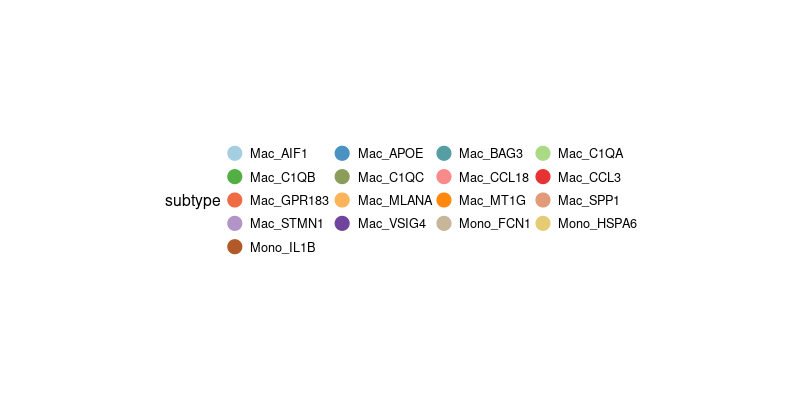

In [572]:
p <- ggplot(res, aes(x = reorder(subtype, M1, FUN = median), y=M1, fill = subtype)) +
            geom_point(aes(x = reorder(subtype, M1, FUN = median), y=M1,fill=subtype,color=subtype),size=4) +
#             scale_fill_manual(values = color_mm_celltype) +
            scale_color_manual(values = color_mm_celltype) +
            theme_bw()+
            theme(
                    panel.background=element_rect(fill='transparent'), ##去掉底层阴影
                    axis.title.x=element_blank(),                        ##删除x轴文本        
                    legend.position = "top", 
                    legend.direction = "horizontal", legend.key.size = unit(10, "pt"),
#                     scale_y_continuous(limits = c(0,0.5), breaks = seq(0,0.5,0.25))
                 )+ggtitle("M1")+labs(x=NULL,y=NULL) +
            guides(color=guide_legend(ncol=4, byrow=TRUE))
options(repr.plot.width = 8, repr.plot.height =4, repr.plot.res = 100)
lgd <- get_legend2(p)
grid.newpage()
grid.draw(lgd)

In [573]:
pdf(file = paste0(dir2,"Figure/Macro_function_score_boxplot_lgd.pdf"), height=4, width=6)
grid.draw(lgd)
dev.off()

png 
  2

In [701]:
sample.list <- c("Liver_NN","Liver_PN","Liver_PT","Pancreas_HM","Eye_HM","Intestine_HM", "Stomach_HM", "Lung_HM", "Mammary_HM")

In [504]:
title.size <- 30

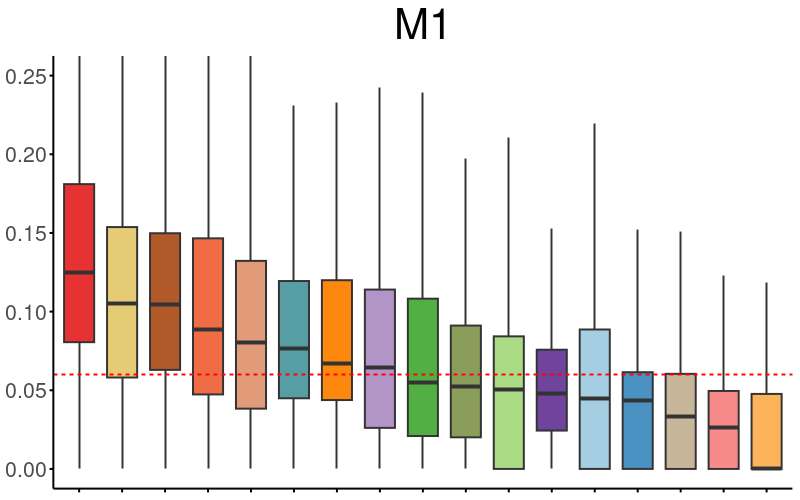

In [574]:
df <- res %>% 
#         filter(tissue_group %in% sample.list) %>% 
        dplyr::select(c(subtype, M1))
p1 <- ggplot(df, aes(x = reorder(subtype, -M1, FUN=median), y=M1, fill = subtype)) +
            scale_fill_manual(values = color_mm_celltype) +
            geom_boxplot(aes(fill=subtype), alpha=1, 
                         position=position_dodge(preserve = "single"), width=0.7, outlier.color="white") +
            theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
                    axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
                    axis.title=element_text(face="bold",size = 20),      ##设置坐标轴文本字体
                    axis.title.x=element_blank(),                        ##删除x轴文本               
                    axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
                    axis.text.x = element_blank(),
#                     axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 12),     ##设置坐标轴标签字体
                    axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
                    plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
#                     scale_y_continuous(limits = c(0,0.5), breaks = seq(0,0.5,0.25)), ## 不知道为什么没用
                    legend.position="none")+ggtitle("M1")+labs(x=NULL,y=NULL) +
            geom_hline(yintercept = 0.06, color="red", linetype='dashed')+
            coord_cartesian(ylim=c(0,0.25))
#                     + ylim(0,0.5)  ## 不要用这个,会把超过这个范围的值直接去掉
options(repr.plot.width = 8, repr.plot.height =5, repr.plot.res = 100)
p1

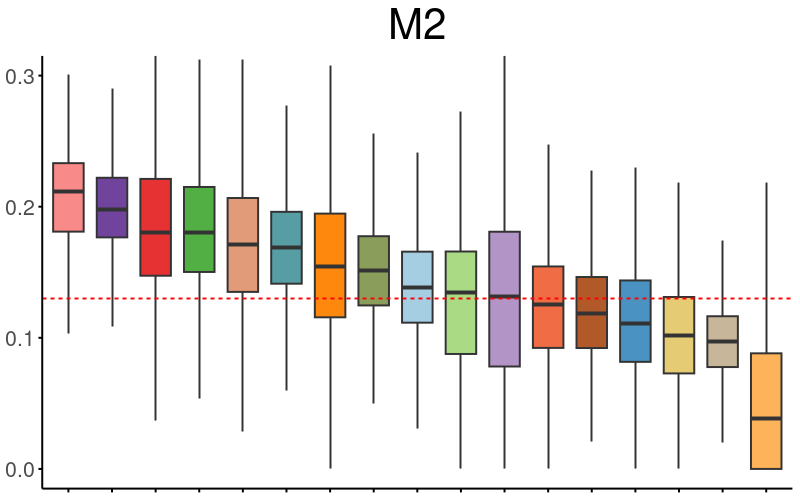

In [575]:
df <- res %>% 
#         filter(tissue_group %in% sample.list) %>% 
        dplyr::select(c(subtype, M2))
p2 <- ggplot(df, aes(x = reorder(subtype, -M2, FUN=median), y=M2, fill = subtype)) +
            scale_fill_manual(values = color_mm_celltype) +
            geom_boxplot(aes(fill=subtype), alpha=1, 
                         position=position_dodge(preserve = "single"), width=0.7, outlier.color="white") +
            theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
                    axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
                    axis.title=element_text(face="bold",size = 20),      ##设置坐标轴文本字体
                    axis.title.x=element_blank(),                        ##删除x轴文本               
                    axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
                    axis.text.x = element_blank(),
#                     axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 12),     ##设置坐标轴标签字体
                    axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
                    plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
#                     scale_y_continuous(limits = c(0,0.5), breaks = seq(0,0.5,0.25)), ## 不知道为什么没用
                    legend.position="none")+ggtitle("M2")+labs(x=NULL,y=NULL) +
            geom_hline(yintercept = 0.13, color="red", linetype='dashed')+
            coord_cartesian(ylim=c(0,0.3))
#                     + ylim(0,0.5)  ## 不要用这个,会把超过这个范围的值直接去掉
options(repr.plot.width = 8, repr.plot.height =5, repr.plot.res = 100)
p2

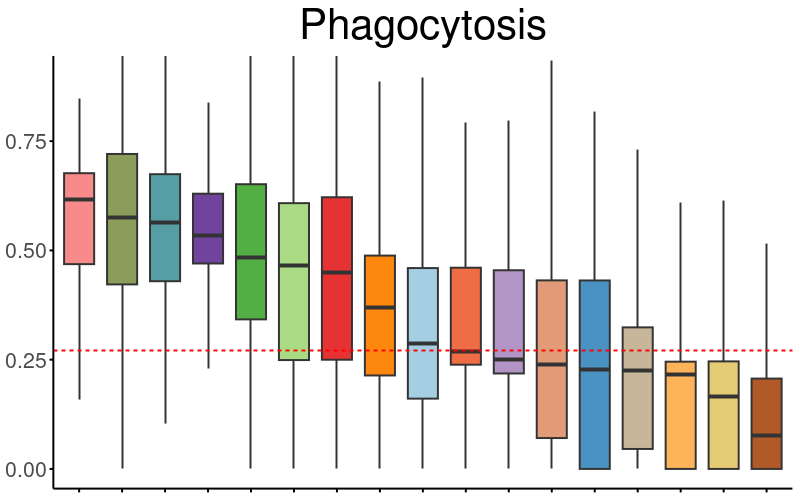

In [576]:
df <- res %>% 
#         filter(tissue_group %in% sample.list) %>% 
        dplyr::select(c(subtype, Pha))
p3 <- ggplot(df, aes(x = reorder(subtype, -Pha, FUN=median), y=Pha, fill = subtype)) +
            scale_fill_manual(values = color_mm_celltype) +
            geom_boxplot(aes(fill=subtype), alpha=1, 
                         position=position_dodge(preserve = "single"), width=0.7, outlier.color="white") +
            theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
                    axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
                    axis.title=element_text(face="bold",size = 20),      ##设置坐标轴文本字体
                    axis.title.x=element_blank(),                        ##删除x轴文本               
                    axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
                    axis.text.x = element_blank(),
#                     axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 12),     ##设置坐标轴标签字体
                    axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
                    plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
#                     scale_y_continuous(limits = c(0,0.5), breaks = seq(0,0.5,0.25)), ## 不知道为什么没用
                    legend.position="none")+ggtitle("Phagocytosis")+labs(x=NULL,y=NULL) +
            geom_hline(yintercept = 0.27, color="red", linetype='dashed')+
            coord_cartesian(ylim=c(0,0.9))
#                     + ylim(0,0.5)  ## 不要用这个,会把超过这个范围的值直接去掉
options(repr.plot.width = 8, repr.plot.height =5, repr.plot.res = 100)
p3

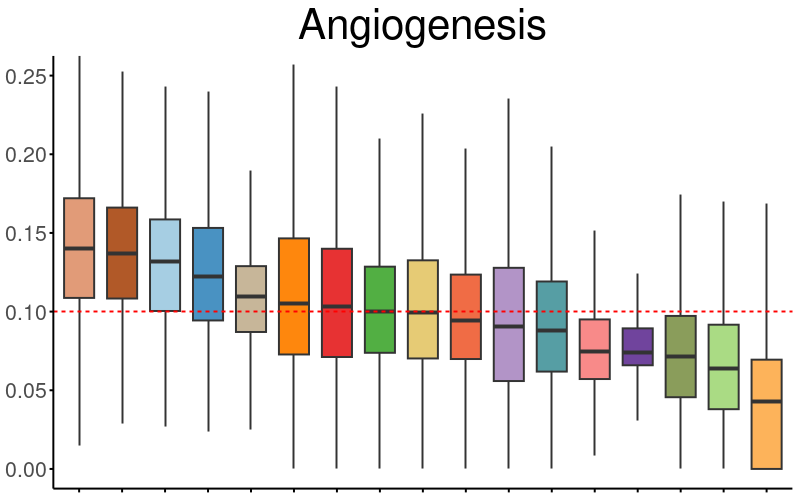

In [577]:
df <- res %>% 
#         filter(tissue_group %in% sample.list) %>% 
        dplyr::select(c(subtype, Ang))
p4 <- ggplot(df, aes(x = reorder(subtype, -Ang, FUN=median), y=Ang, fill = subtype)) +
            scale_fill_manual(values = color_mm_celltype) +
            geom_boxplot(aes(fill=subtype), alpha=1, 
                         position=position_dodge(preserve = "single"), width=0.7, outlier.color="white") +
            theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
                    axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
                    axis.title=element_text(face="bold",size = 20),      ##设置坐标轴文本字体
                    axis.title.x=element_blank(),                        ##删除x轴文本               
                    axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
                    axis.text.x = element_blank(),
#                     axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 12),     ##设置坐标轴标签字体
                    axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
                    plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
#                     scale_y_continuous(limits = c(0,0.5), breaks = seq(0,0.5,0.25)), ## 不知道为什么没用
                    legend.position="none")+ggtitle("Angiogenesis")+labs(x=NULL,y=NULL) +
            geom_hline(yintercept = 0.1, color="red", linetype='dashed')+
            coord_cartesian(ylim=c(0,0.25))
#                     + ylim(0,0.5)  ## 不要用这个,会把超过这个范围的值直接去掉
options(repr.plot.width = 8, repr.plot.height =5, repr.plot.res = 100)
p4

### gene in 5 subets ★

In [21]:
M1_score <- c("IL23A","IL12B","TNF","CXCL9","CXCL10","CXCL11","IL1A","IL1B","IL6","CCL5","IRF5","IRF1",
                      "KYNU","CCR7")# "IL23A","IL12B"共同组成IL12, IDO1删了
M2_score <- c("IL4R","CCL4","CCL13","CCL20","CCL17","CCL18","CCL22","CCL24","LYVE1","VEGFB","VEGFC","VEGFD","EGF",
              "CTSA","CTSB","CTSC","CTSD","TGFB1","TGFB2","TGFB3","MMP14","MMP19","CLEC7A","WNT7B","FASLG","TNFSF12","TNFSF8",
              "CD276","VTCN1","MSR1","FN1","IRF4") # 由于重复,把这里的"MMP9"和"VEGFA删了
Ang_score <- c("CCND2", "CCNE1", "CD44", "CXCR4", "E2F3", "EDN1", "EZH2", "FGF18", "FGFR1", "FYN", "HEY1", "ITGAV", "JAG1", "JAG2", 
                    "MMP9", "NOTCH1", "PDGFA", "PTK2", "SPP1", "STC1", "TNFAIP6", "TYMP", "VAV2", "VCAN", "VEGFA")
Pha_score <- c("MRC1","CD163","MERTK","C1QB")
Icp_score <- c("LAIR1","SIRPA","HAVCR2","NECTIN2","PVR","CD274","ADORA2A","IDO1","BTLA",
               "CD80","CD86","CD40","TNFRSF9","ICOSLG","CD70",
               "TNFRSF14","TNFRSF18","PDCD1LG2","LGALS9","LAG3")

In [22]:
# unique(Idents(obj.mm))
# obj.mm@meta.data$subtype_cluster <- paste0(obj.mm@meta.data$subtype,"|",obj.mm@meta.data$cluster)
# Idents(obj.mm) <- "subtype_cluster"
Idents(obj.mm) <- "subtype"
head(unique(Idents(obj.mm)))

[1] Mac_CCL3  Mac_VSIG4 Mac_C1QB  Mac_SPP1  Mac_APOE  Mac_AIF1 
17 Levels: Mac_CCL3 Mac_VSIG4 Mac_SPP1 Mac_C1QB Mac_CCL18 Mac_C1QA ... Mono_HSPA6

In [37]:
df.target$subtype <- factor(df.target$subtype, levels = rev(c(
"Mono_IL1B","Mono_HSPA6","Mono_FCN1",'Mac_CCL3',
'Mac_VSIG4',"Mac_CCL18",'Mac_C1QB',"Mac_SPP1",'Mac_AIF1',"Mac_STMN1",
'Mac_C1QA','Mac_C1QC','Mac_GPR183',
'Mac_MT1G',
'Mac_BAG3','Mac_APOE','Mac_MLANA'
)))
df.target$type <- factor(df.target$type, levels = c("M1","M2","Phagocytosis","Angiogenesis","Immune Checkpoint"))

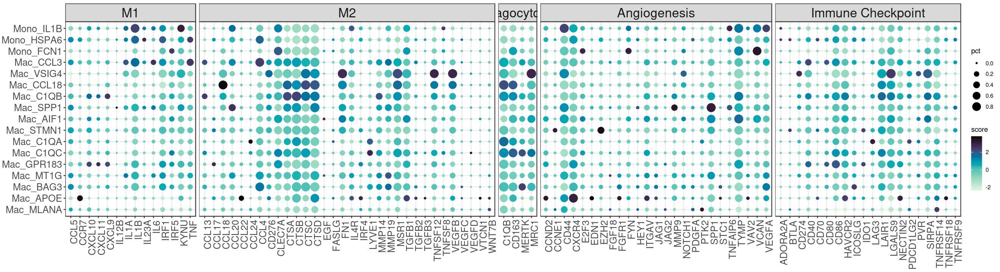

In [40]:
## Visualize
options(repr.plot.width=22, repr.plot.height=6)
p <- ggplot(df.target, aes(x = gene, y = subtype)) +
        geom_point(aes(color=score, size = pct))+
        scale_size_continuous(range = c(0.5,6), breaks = c(0.0,0.2,0.4,0.6,0.8))+
        scale_color_gradientn(colours = rev(sequential_hcl("Mako", n=10)), values = c(0,0.4,0.6,0.8,1))+
        labs(x=NULL,y=NULL)+ facet_grid(.~type, scales = "free", space = "free")+
#         ggtitle("TNFA_SIGNALING_VIA_NFKB signatue")+
        theme_bw()+
        theme(axis.text.x = element_text(angle=90, size = 15, hjust = 0.95,vjust = 0.9),
              axis.text.y = element_text(size = 15),
              strip.text = element_text(size=20),
              plot.title = element_text(hjust = 0.5, vjust = 1, size = 20))
p

In [154]:
library(ggridges)

Picking joint bandwidth of 1.2



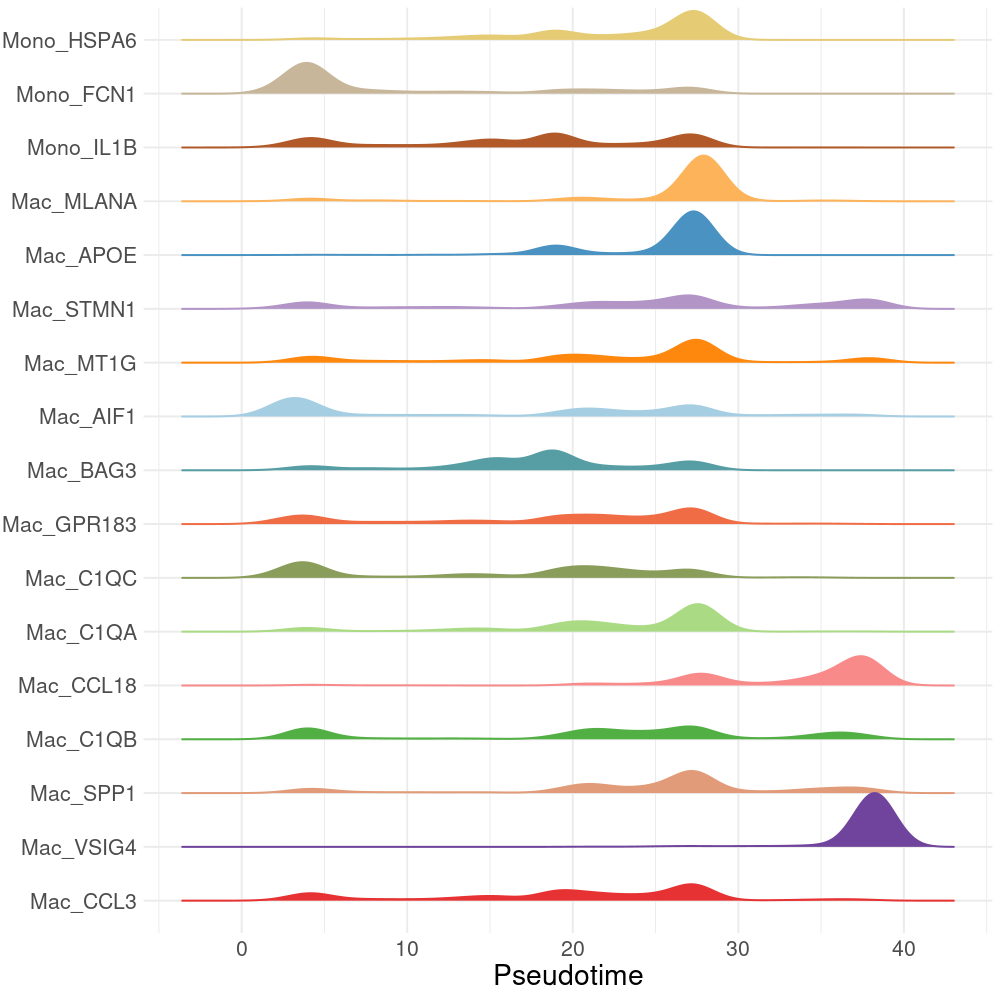

In [159]:
df <- pData(cds)
df <- pData(cds)
df$subype <- factor(df$subtype, levels = c())
p1 <- ggplot(df, aes(x=Pseudotime, colour = subtype, fill = subtype))+ 
    geom_density_ridges(aes(x=Pseudotime, y=subtype,colour = subtype),scale=1) +
    scale_color_manual(values = color_mm_celltype) + scale_fill_manual(values = color_mm_celltype) +
    theme_minimal()+labs(x="Pseudotime",y=NULL)+
    theme(axis.text = element_text(size=15), axis.title = element_text(size=20),legend.position="None")
options(repr.plot.width = 10, repr.plot.height =10, repr.plot.res = 100)
p1

#### trajactory plot

In [233]:
Cellratio <- prop.table(table(df.gg$State, df.gg$subtype), margin = 2) %>% as.data.frame()
colnames(Cellratio) <- c("State","Subtype","Freq")
Cellratio

State,Subtype,Freq
<fct>,<fct>,<dbl>
1,Acinar_PNLIP,NaN
2,Acinar_PNLIP,NaN
3,Acinar_PNLIP,NaN
4,Acinar_PNLIP,NaN
5,Acinar_PNLIP,NaN
1,Acinar_CLPS,NaN
2,Acinar_CLPS,NaN
3,Acinar_CLPS,NaN
4,Acinar_CLPS,NaN


In [284]:
my_theme <- theme(
      panel.background = element_blank(),
      panel.border = element_blank(),
      panel.grid = element_blank(),
      legend.position = "none",
#       axis.ticks.length = unit(0.8, "lines"),
      axis.ticks = element_blank(),
      axis.line = element_blank(),
       axis.text = element_blank(), 
#       axis.title = element_text(size=20),
        axis.title = element_blank()
)

Warning message:
“Removed 104 rows containing non-finite outside the scale range (`stat_pie()`).”
Warning message:
“Removed 104 rows containing non-finite outside the scale range (`stat_pie()`).”
Warning message:
“Removed 104 rows containing non-finite outside the scale range (`stat_pie()`).”


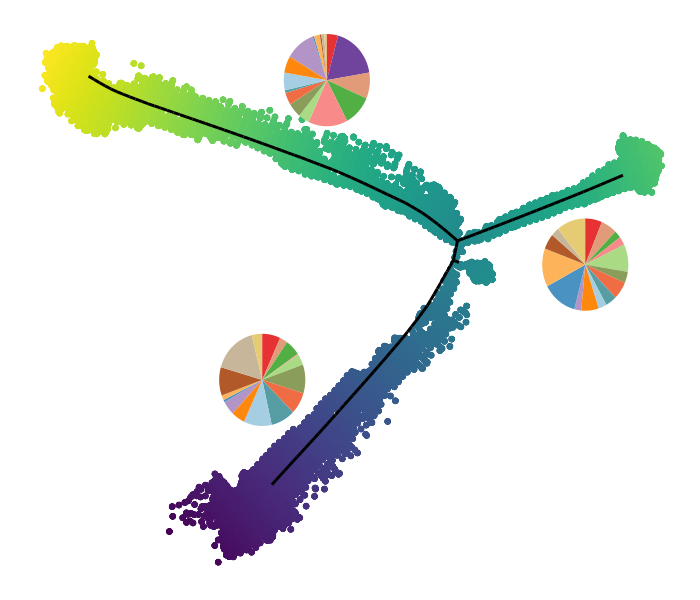

In [285]:
options(repr.plot.width = 7, repr.plot.height =6, repr.plot.res = 100)
p1 <- ggplot() + 
    theme_bw()+
    geom_point_rast(data = df.gg, aes(x = Component_1, y = Component_2, color =Pseudotime)) + 
    scale_color_viridis() +
    scale_fill_manual(values = color_mm_celltype)+
#     theme_dr(arrow = grid::arrow(length = unit(0, "inches")))+
    my_theme +
geom_segment(aes_string(x="source_prin_graph_dim_1",y="source_prin_graph_dim_2",
                        xend="target_prin_graph_dim_1",yend="target_prin_graph_dim_2"), 
             size=0.75, linetype="solid", na.rm=TRUE, data=edge_df) + 
geom_arc_bar(data=subset(Cellratio,State=='1'),stat = "pie", color = "transparent",aes(x0=-5,y0=-6.5,r0=0,r=2, amount=Freq, fill=Subtype)) + 
geom_arc_bar(data=subset(Cellratio,State=='4'),stat = "pie",color = "transparent",aes(x0=10,y0=-1.5,r0=0,r=2, amount=Freq, fill=Subtype)) +
geom_arc_bar(data=subset(Cellratio,State=='5'),stat = "pie",color = "transparent",aes(x0=-2,y0=6.5,r0=0,r=2, amount=Freq, fill=Subtype))  
p1

In [300]:
pdf(file = paste0(dir2,"Figure/Macro_pseudotime_trajectory_pie.pdf"), width = 6, height = 6)
p1
dev.off()

Warning message:
“Removed 104 rows containing non-finite outside the scale range (`stat_pie()`).”
Warning message:
“Removed 104 rows containing non-finite outside the scale range (`stat_pie()`).”
Warning message:
“Removed 104 rows containing non-finite outside the scale range (`stat_pie()`).”


png 
  2

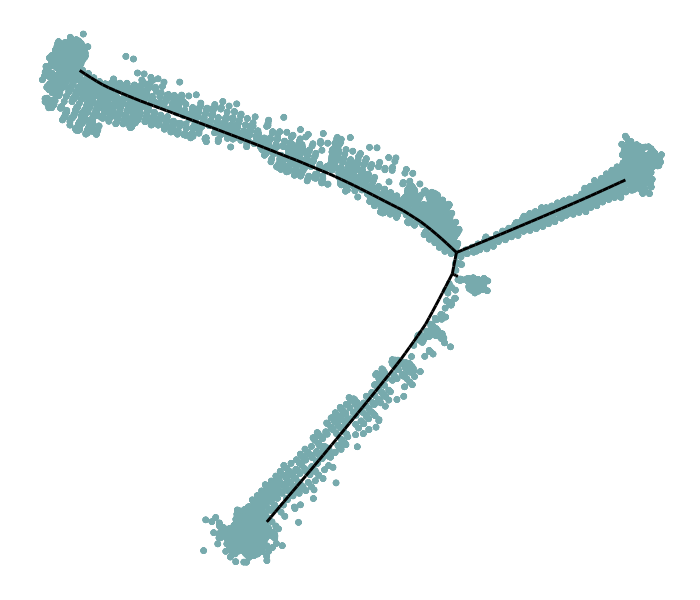

In [287]:
options(repr.plot.width = 7, repr.plot.height =6, repr.plot.res = 100)
df.target <- filter(df.gg, cluster %in% c("CP1"))
p2 <- ggplot(df.target) + 
    theme_bw()+
    geom_point_rast(data = df.target, aes(x = Component_1, y = Component_2, color =cluster)) + 
#     scale_color_viridis() +
    scale_color_manual(values = c(color_cluster))+my_theme+
geom_segment(aes_string(x="source_prin_graph_dim_1",y="source_prin_graph_dim_2",
                        xend="target_prin_graph_dim_1",yend="target_prin_graph_dim_2"), 
             size=0.75, linetype="solid", na.rm=TRUE, data=edge_df) 
p2

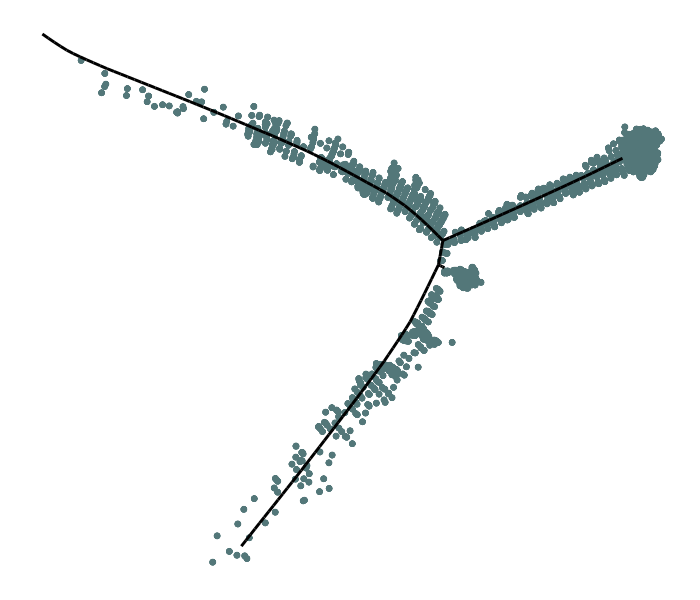

In [296]:
options(repr.plot.width = 7, repr.plot.height =6, repr.plot.res = 100)
df.target <- filter(df.gg, cluster == "CP2")
p3 <- ggplot(df.target) + 
    theme_bw()+
    geom_point_rast(data = df.target, aes(x = Component_1, y = Component_2, color =cluster)) + 
#     scale_color_viridis() +
    scale_color_manual(values = color_cluster)+my_theme+
geom_segment(aes_string(x="source_prin_graph_dim_1",y="source_prin_graph_dim_2",
                        xend="target_prin_graph_dim_1",yend="target_prin_graph_dim_2"), 
             size=0.75, linetype="solid", na.rm=TRUE, data=edge_df) 
p3

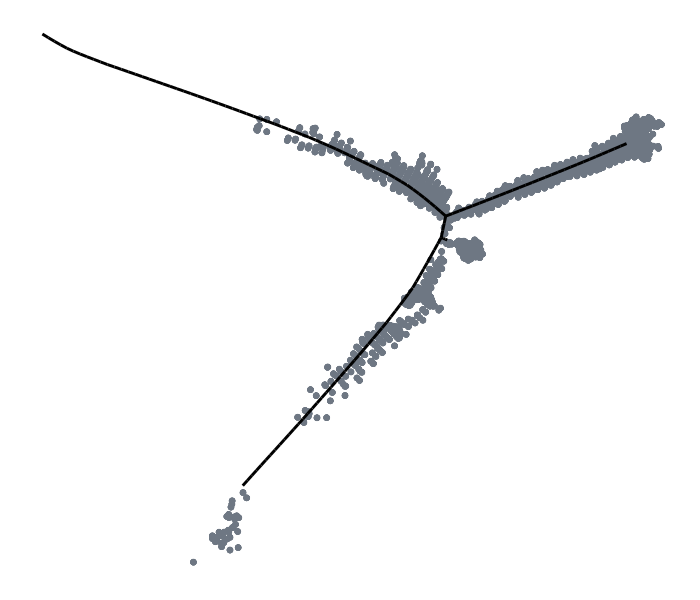

In [297]:
options(repr.plot.width = 7, repr.plot.height =6, repr.plot.res = 100)
df.target <- filter(df.gg, cluster == "CP5")
p4 <- ggplot(df.target) + 
    theme_bw()+
    geom_point_rast(data = df.target, aes(x = Component_1, y = Component_2, color =cluster)) + 
#     scale_color_viridis() +
    scale_color_manual(values = color_cluster)+my_theme+
geom_segment(aes_string(x="source_prin_graph_dim_1",y="source_prin_graph_dim_2",
                        xend="target_prin_graph_dim_1",yend="target_prin_graph_dim_2"), 
             size=0.75, linetype="solid", na.rm=TRUE, data=edge_df) 
p4

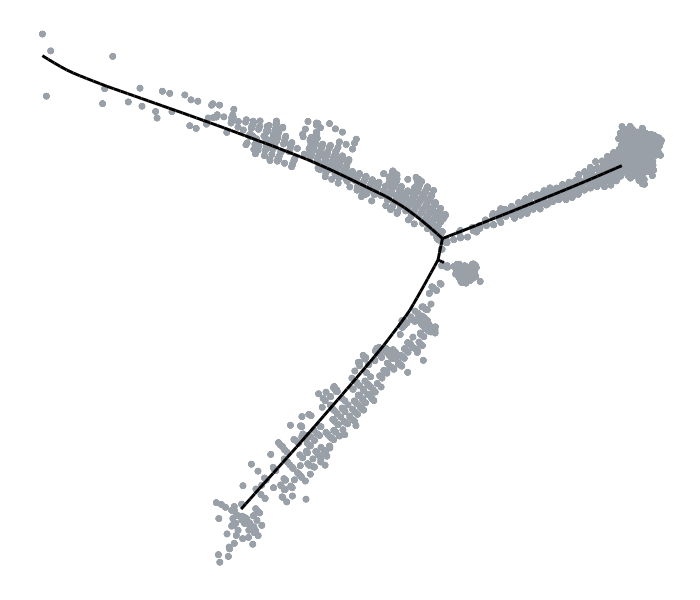

In [298]:
options(repr.plot.width = 7, repr.plot.height =6, repr.plot.res = 100)
df.target <- filter(df.gg, cluster == "CP6")
p5 <- ggplot(df.target) + 
    theme_bw()+
    geom_point_rast(data = df.target, aes(x = Component_1, y = Component_2, color =cluster)) + 
#     scale_color_viridis() +
    scale_color_manual(values = color_cluster)+my_theme+
geom_segment(aes_string(x="source_prin_graph_dim_1",y="source_prin_graph_dim_2",
                        xend="target_prin_graph_dim_1",yend="target_prin_graph_dim_2"), 
             size=0.75, linetype="solid", na.rm=TRUE, data=edge_df) 
p5

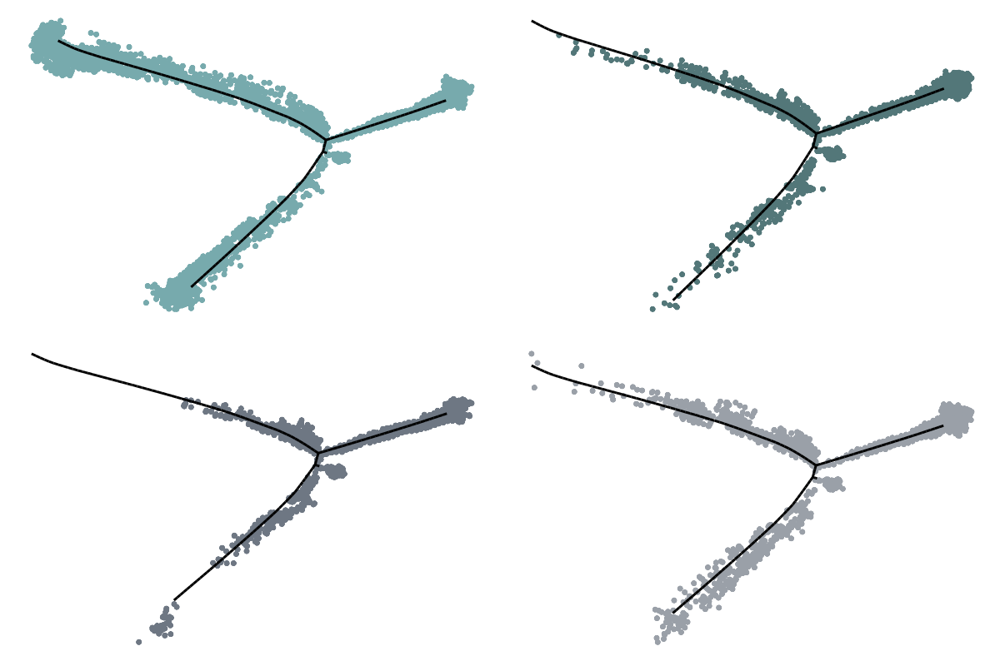

In [299]:
options(repr.plot.width = 12, repr.plot.height =8, repr.plot.res = 100)
cowplot::plot_grid(p2,p3,p4,p5,ncol = 2)

In [303]:
pdf(file = paste0(dir2,"Figure/Macro_pseudotime_trajectory_CP.pdf"), width = 12, height = 12)
cowplot::plot_grid(p2,p3,p4,p5,ncol = 2)
dev.off()

png 
  2

Warning message in get_plot_component(plot, "guide-box"):
“Multiple components found; returning the first one. To return all, use `return_all = TRUE`.”


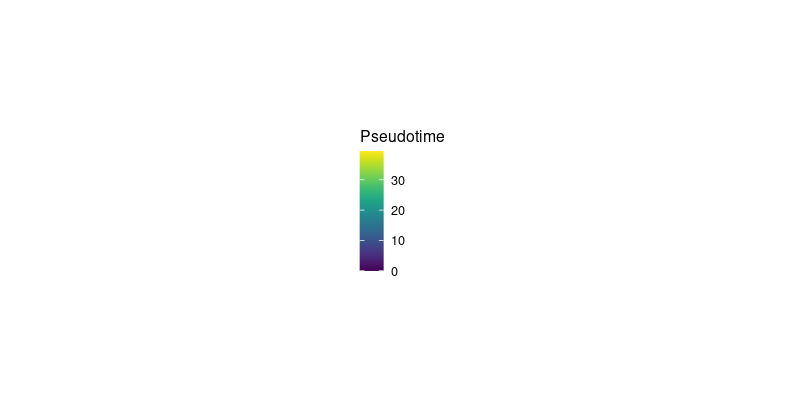

In [304]:
options(repr.plot.width = 8, repr.plot.height =4, repr.plot.res = 100)
p <- ggplot() + 
    theme_bw()+
    geom_point_rast(data = df.gg, aes(x = Component_1, y = Component_2, color =Pseudotime)) + 
    scale_color_viridis()
lgd <- cowplot::get_legend(p)
grid.newpage()
grid.draw(lgd)

In [306]:
pdf(file = paste0(dir2,"Figure/Macro_pseudotime_trajectory_lgd.pdf"), width = 2, height = 2)
grid.draw(lgd)
dev.off()

png 
  2

#### Pseudotime-related genes

In [1304]:
cds.fil <- cds[fData(cds)$use_for_ordering == TRUE,] ## 只用排序基因来做回归分析，找它们是否跟拟时间有显著关系。不提取的话会用所有基因
cds.fil

CellDataSet (storageMode: environment)
assayData: 6986 features, 54788 samples 
  element names: exprs 
protocolData: none
phenoData
  sampleNames: GSM3516662@@_121742672193460
    GSM3516662@@_122282764036316 ...
    Liver_10X_TSP6@@_TTTGGAGCAGTAACCT_TSP6_Liver_NA_10X_1_2 (54788
    total)
  varLabels: orig.ident nCount_RNA ... State (35 total)
  varMetadata: labelDescription
featureData
  featureNames: ENSG00000000419 ENSG00000000938 ... ENSG00000283633
    (6986 total)
  fvarLabels: gene_short_name num_cells_expressed use_for_ordering
  fvarMetadata: labelDescription
experimentData: use 'experimentData(object)'
Annotation:  

In [1306]:
## 在terminal上跑
# saveRDS(cds.fil, file = "/public/workspace202011/pancancer/Zhangcl/liver_metastasis/pseudotime_cds_fil.rds")
# Time_diff <- differentialGeneTest(cds.fil, cores = 1, fullModelFormulaStr = "~sm.ns(Pseudotime)")
# saveRDS(Time_diff, file = "/public/workspace202011/pancancer/Zhangcl/liver_metastasis/pseudotime_deg_timediff.rds")

In [139]:
cds.fil <- readRDS("/public/workspace202011/pancancer/Zhangcl/liver_metastasis/pseudotime/pseudotime_cds_fil.rds")

In [4]:
Time_diff <- readRDS("/public/workspace202011/pancancer/Zhangcl/liver_metastasis/pseudotime_deg_timediff.rds")
Time_diff

,status,family,pval,qval,gene_short_name,num_cells_expressed,use_for_ordering
,<chr>,<chr>,<dbl>,<dbl>,<chr>,<int>,<lgl>
ENSG00000000419,OK,negbinomial.size,2.145078e-26,3.424478e-26,DPM1,13909,TRUE
ENSG00000000938,OK,negbinomial.size,4.562175e-113,1.453985e-112,FGR,24230,TRUE
ENSG00000000971,OK,negbinomial.size,1.393610e-47,2.733996e-47,CFH,3740,TRUE
ENSG00000001036,OK,negbinomial.size,2.346821e-02,2.543712e-02,FUCA2,19970,TRUE
ENSG00000001084,OK,negbinomial.size,1.881255e-223,1.199129e-222,GCLC,9750,TRUE
ENSG00000001497,OK,negbinomial.size,3.538127e-36,6.235458e-36,LAS1L,5325,TRUE
ENSG00000001561,OK,negbinomial.size,7.193737e-08,8.840008e-08,ENPP4,10449,TRUE
ENSG00000002330,OK,negbinomial.size,8.001348e-03,8.786139e-03,BAD,11499,TRUE
ENSG00000002549,OK,negbinomial.size,2.728515e-02,2.951139e-02,LAP3,31102,TRUE


In [182]:
table(Time_diff$pval<0.01 & Time_diff$qval<0.01)
table(Time_diff$num_cells_expressed<200)


FALSE  TRUE 
  618  6368 


FALSE  TRUE 
 6983     3 

In [515]:
## 构建可视化数据框
all_enrich.df <- data.frame()
for(i in unique(cluster.df$cluster)){

    enrich.results <- readRDS(file = paste0("/public/workspace202011/pancancer/Zhangcl/liver_metastasis/pseudotime/pseudotime_hallmark_cluster",i,".rds"))
    enrich.df <- enrich.results@result %>% filter(p.adjust <0.01 & Count>10)
    enrich.df$cluster <- paste0("Cluster ",i)
    all_enrich.df <- rbind(all_enrich.df, enrich.df)  
}
all_enrich.df$cluster <- factor(all_enrich.df$cluster, levels = c("Cluster 2","Cluster 3","Cluster 1","Cluster 4"))
all_enrich.df

,ID,Description,GeneRatio,BgRatio,pvalue,p.adjust,qvalue,geneID,Count,cluster
,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<chr>,<int>,<fct>
OXIDATIVE_PHOSPHORYLATION,OXIDATIVE_PHOSPHORYLATION,OXIDATIVE_PHOSPHORYLATION,67/391,200/4384,8.765748e-24,4.207559e-22,3.598570e-22,HADHB/ECI1/UQCRFS1/PHB2/ACADVL/ATP1B1/PHYH/POR/SURF1/ATP6V1E1/MRPL34/PDHA1/ATP6AP1/CYB5R3/ATP6V0B/ATP6V1D/NDUFC2/ACAA2/MGST3/VDAC1/NDUFAB1/SUCLG1/SDHD/ATP5F1B/ATP5PD/MRPS12/SLC25A11/COX7A2L/ATP6V1F/UQCRH/MDH2/NDUFB8/NDUFB7/COX5A/NDUFA4/NDUFB2/ATP5F1C/SDHB/COX5B/ATP5PF/NDUFS8/NDUFB3/ATP6V0E1/NDUFB6/NDUFA8/MRPS15/ATP5MC3/CYB5A/ECH1/MDH1/MRPL11/BAX/LDHB/NDUFS3/GPX4/VDAC2/DECR1/ISCU/ALAS1/ACAT1/FDX1/MPC1/NDUFA9/HSD17B10/UQCRC2/NDUFB5/SLC25A5,67,Cluster 4
ADIPOGENESIS,ADIPOGENESIS,ADIPOGENESIS,41/391,200/4384,1.856329e-07,4.455189e-06,3.810359e-06,LPL/TALDO1/ESYT1/SCP2/STOM/TKT/CAT/APLP2/DHCR7/PHYH/SQOR/VEGFB/PPARG/POR/ALDH2/PEX14/ITIH5/ACAA2/MGST3/RETN/REEP5/NDUFAB1/SUCLG1/DHRS7/MDH2/NDUFB7/GHITM/APOE/SDHB/SSPN/ECH1/NDUFS3/CHCHD10/GPX4/PGM1/DECR1/FABP4/CD151/RMDN3/PLIN2/HADH,41,Cluster 4
CHOLESTEROL_HOMEOSTASIS,CHOLESTEROL_HOMEOSTASIS,CHOLESTEROL_HOMEOSTASIS,19/391,74/4384,1.571385e-05,2.514216e-04,2.150316e-04,LPL/ACTG1/DHCR7/FDFT1/PPARG/ANXA5/S100A11/GUSB/FDPS/LGALS3/ECH1/ETHE1/CD9/CXCL16/SCD/ACAT2/EBP/PCYT2/FABP5,19,Cluster 4
REACTIVE_OXYGEN_SPECIES_PATHWAY,REACTIVE_OXYGEN_SPECIES_PATHWAY,REACTIVE_OXYGEN_SPECIES_PATHWAY,14/391,49/4384,5.884119e-05,7.060943e-04,6.038964e-04,CAT/GLRX2/PDLIM1/MSRA/MGST1/GLRX/PRDX6/LAMTOR5/PRDX4/PRDX1/HMOX2/TXN/GPX4/FTL,14,Cluster 4
FATTY_ACID_METABOLISM,FATTY_ACID_METABOLISM,FATTY_ACID_METABOLISM,29/391,158/4384,1.096081e-04,1.052238e-03,8.999403e-04,HADHB/ECI1/S100A10/ACADVL/GLUL/HPGD/GPD1/ALDH1A1/AOC3/PDHA1/ACAA2/YWHAH/SUCLG1/SDHD/APEX1/PRDX6/MDH2/UROD/ECH1/ERP29/MDH1/DECR1/CA2/ACAT2/BLVRA/HADH/HSD17B10/PCBD1/CBR1,29,Cluster 4
TNFA_SIGNALING_VIA_NFKB,TNFA_SIGNALING_VIA_NFKB,TNFA_SIGNALING_VIA_NFKB,56/397,200/4384,1.441257e-15,7.062161e-14,5.006473e-14,CCL20/SPHK1/TNFAIP6/CXCL1/SQSTM1/SGK1/IER3/GADD45B/CXCL2/IL1B/NINJ1/CCND1/TRAF1/BIRC3/NR4A3/ICAM1/ID2/IRF1/DUSP1/NR4A2/SOD2/NR4A1/ZFP36/GADD45A/PLAU/G0S2/SAT1/TAP1/DNAJB4/NFKBIE/SIK1/PHLDA1/MAFF/ZC3H12A/TGIF1/CXCL3/PHLDA2/TNF/GEM/CCL2/CCL5/DUSP2/CCL4/PPP1R15A/CD69/CCRL2/PLAUR/CD83/ATF3/NFKBIA/HES1/BCL2A1/IFIT2/JUN/EIF1/TSC22D1,56,Cluster 1
INTERFERON_GAMMA_RESPONSE,INTERFERON_GAMMA_RESPONSE,INTERFERON_GAMMA_RESPONSE,45/397,200/4384,3.369912e-09,8.256284e-08,5.853005e-08,IFI44L/MTHFD2/TNFAIP6/IFITM3/SLAMF7/VAMP5/CFH/ICAM1/IRF1/SOD2/RSAD2/TAP1/ISG20/GZMA/VCAM1/GBP4/EPSTI1/PSMB10/CCL2/CCL5/CD86/HLA-DRB1/HLA-B/HLA-DQA1/IL18BP/CD69/SOCS1/STAT1/NFKBIA/MT2A/CD38/CD74/PSMB9/PSME1/IFIT2/ISG15/HLA-DMA/HLA-A/IFI27/BST2/UBE2L6/IFI35/PSME2/B2M/CD40,45,Cluster 1
ALLOGRAFT_REJECTION,ALLOGRAFT_REJECTION,ALLOGRAFT_REJECTION,39/397,200/4384,2.146462e-06,3.505889e-05,2.485378e-05,FCGR2B/UBE2N/TIMP1/RPS3A/IL1B/MAP4K1/ICAM1/RPL9/TAP1/THY1/CD3D/GZMA/CFP/CD2/LTB/PSMB10/TNF/CCL2/TPD52/CCL5/CCL4/RPL39/CD86/HLA-DQA1/SOCS1/STAT1/CD74/RPS19/HLA-DMA/HLA-A/HLA-DMB/HLA-DRA/NME1/NPM1/B2M/CDKN2A/CD40/MMP9/CCL22,39,Cluster 1
APOPTOSIS,APOPTOSIS,APOPTOSIS,30/397,161/4384,8.277621e-05,1.014009e-03,7.188460e-04,TNFRSF12A/ENO2/SQSTM1/TIMP1/IER3/GADD45B/IL1B/IFITM3/CCND1/PMAIP1/BIRC3/IRF1/SOD2/GADD45A/SAT1/TAP1/ISG20/BGN/FEZ1/CD2/TNF/CD69/ATF3/CD38/HSPB1/DNAJA1/JUN/GPX3/SOD1/KRT18,30,Cluster 1


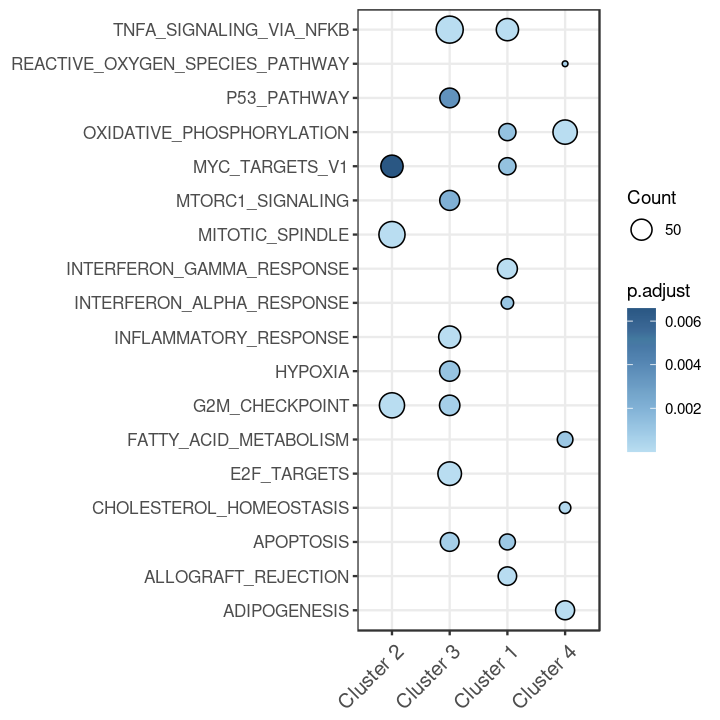

In [520]:
## 可视化
## 进行可视化画点图，颜色是NES值，大小是-log10(padj)
## Visualize
options(repr.plot.width=6, repr.plot.height=6)
p <- ggplot(all_enrich.df, aes(x = cluster, y = Description)) +
        geom_point(aes(fill=p.adjust, size = Count), shape=21)+
        scale_size_continuous(range = c(1,7), breaks = c(10,50,100,150))+
        scale_fill_gradient_tableau()+
        labs(x=NULL,y=NULL)+
        theme_bw()+
        theme(axis.text.x = element_text(angle=45, size = 12, hjust = 0.95,vjust = 0.9),
             axis.text.y = element_text(size = 10))
p
# https://www.sciencedirect.com/science/article/pii/S0005272810007024?via%3Dihub#s0045 癌症氧化磷酸化相关

In [ ]:
## 这一步得知要筛选出与Oxidative Phosphorylation（氧化磷酸化通路）和FATTY ACID METABOLISM （脂肪酸代谢）相关的基因。

#### Pseudotime-related gene enrichment(GO)

In [64]:
## 做GO富集分析
for(i in unique(cluster.df$cluster)){
    enrich.df <- filter(cluster.df, cluster==i)
    genes <- rownames(enrich.df)
#     genes <- mapIds(x = org.Hs.eg.db, keys = rownames(enrich.df), keytype = "ENSEMBL", column = "SYMBOL") # 如果需要转换ID
    enrich.results <- enrichGO(gene = genes, OrgDb = org.Hs.eg.db, keyType = "SYMBOL", ont = "BP", pvalueCutoff = 0.05, qvalueCutoff = 0.05)
    saveRDS(enrich.results, file = paste0("/public/workspace202011/pancancer/Zhangcl/liver_metastasis/pseudotime/pseudotime_cluster",i,".rds"))
}

'select()' returned 1:many mapping between keys and columns

'select()' returned 1:many mapping between keys and columns

'select()' returned 1:many mapping between keys and columns

'select()' returned 1:many mapping between keys and columns



In [522]:
## 构建可视化数据框
all_enrich.df <- data.frame()
for(i in unique(cluster.df$cluster)){

    enrich.results <- readRDS(file = paste0("/public/workspace202011/pancancer/Zhangcl/liver_metastasis/pseudotime/pseudotime_cluster",i,".rds"))
    enrich.df <- enrich.results@result %>% filter(p.adjust <0.01 & Count>10)
    enrich.df$cluster <- paste0("Cluster ",i)
    all_enrich.df <- rbind(all_enrich.df, enrich.df)  
}
all_enrich.df$cluster <- factor(all_enrich.df$cluster, levels = c("Cluster 2","Cluster 3","Cluster 1","Cluster 4"))
all_enrich.df

,ID,Description,GeneRatio,BgRatio,pvalue,p.adjust,qvalue,geneID,Count,cluster
,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<chr>,<int>,<fct>
GO:0043312,GO:0043312,neutrophil degranulation,86/869,487/18866,1.308491e-27,5.053321e-24,4.352143e-24,ENPP4/LAMP2/PSMB1/MGST1/ALOX5/SLC11A1/ERP44/GRN/TIMP2/HEXB/CYBA/CTSA/PGM1/GSTP1/FTL/DYNLL1/CYB5R3/ATP6V1D/CTSZ/PSMD7/HMOX2/PYCARD/CTSH/ASAH1/RETN/PSMD3/VAT1/CTSC/LTA4H/PTPN6/NIT2/LAMTOR2/PRDX6/CTSD/VAMP8/CAT/HVCN1/PRDX4/SERPINB6/SLC44A2/LGALS3/CHI3L1/CHIT1/CD63/TMBIM1/RAC1/TMC6/PSMA5/DYNLT1/STOM/GSN/LAMTOR1/NDUFC2/CCT8/EEF1A1/FCER1G/PDXK/CSTB/PSMC2/S100A11/CAMP/FABP5/BRI3/FTH1/AGPAT2/GUSB/GLB1/OSCAR/GAA/OLR1/TBC1D10C/DPP7/FUCA1/ANXA2/MCEMP1/STING1/TMEM179B/LAMP1/TMEM63A/GM2A/CD47/SERPINA1/CFD/FOLR3/ADGRE3/MME,86,Cluster 4
GO:0002283,GO:0002283,neutrophil activation involved in immune response,86/869,490/18866,2.055449e-27,5.053321e-24,4.352143e-24,ENPP4/LAMP2/PSMB1/MGST1/ALOX5/SLC11A1/ERP44/GRN/TIMP2/HEXB/CYBA/CTSA/PGM1/GSTP1/FTL/DYNLL1/CYB5R3/ATP6V1D/CTSZ/PSMD7/HMOX2/PYCARD/CTSH/ASAH1/RETN/PSMD3/VAT1/CTSC/LTA4H/PTPN6/NIT2/LAMTOR2/PRDX6/CTSD/VAMP8/CAT/HVCN1/PRDX4/SERPINB6/SLC44A2/LGALS3/CHI3L1/CHIT1/CD63/TMBIM1/RAC1/TMC6/PSMA5/DYNLT1/STOM/GSN/LAMTOR1/NDUFC2/CCT8/EEF1A1/FCER1G/PDXK/CSTB/PSMC2/S100A11/CAMP/FABP5/BRI3/FTH1/AGPAT2/GUSB/GLB1/OSCAR/GAA/OLR1/TBC1D10C/DPP7/FUCA1/ANXA2/MCEMP1/STING1/TMEM179B/LAMP1/TMEM63A/GM2A/CD47/SERPINA1/CFD/FOLR3/ADGRE3/MME,86,Cluster 4
GO:0022900,GO:0022900,electron transport chain,52/869,184/18866,5.482457e-27,8.985746e-24,7.738920e-24,NDUFAB1/GLRX2/CYBA/AKR7A2/AKR1B1/NDUFB2/NDUFB7/DHDH/NDUFS8/ALDH2/COX7A2L/PARK7/NCF2/SDHB/AKR1A1/NDUFB3/NDUFA8/POR/COX5B/ISCU/NDUFB5/FDX1/NDUFA9/UQCRC2/NDUFB10/NDUFB9/SURF1/NDUFC2/DHRS3/NDUFB6/NDUFB8/CYB5A/GPD1/COA6/NDUFS5/UQCRFS1/GLRX/UQCRH/COX5A/NDUFA12/NDUFA4/ADH5/SDHD/NDUFS3/ND1/ND2/COX1/COX2/COX3/ND4/ND5/CYTB,52,Cluster 4
GO:0006119,GO:0006119,oxidative phosphorylation,45/869,149/18866,7.580857e-25,9.318769e-22,8.025734e-22,NDUFAB1/NDUFB2/NDUFB7/ANTKMT/NDUFS8/COX7A2L/PARK7/NDUFB3/NDUFA8/COX5B/ISCU/NDUFB5/NDUFA9/UQCRC2/NDUFB10/NDUFB9/SURF1/NDUFC2/NDUFB6/NDUFB8/COA6/NDUFS5/UQCRFS1/UQCRH/NUPR1/COX5A/NDUFA12/NDUFA4/SDHD/NDUFS3/CHCHD10/ATP5MC3/ATP5F1C/ATP5F1B/ATP5PD/ATP5PF/ND1/ND2/COX1/COX2/ATP6/COX3/ND4/ND5/CYTB,45,Cluster 4
GO:0042773,GO:0042773,ATP synthesis coupled electron transport,35/869,98/18866,2.439697e-22,2.399198e-19,2.066295e-19,NDUFAB1/NDUFB2/NDUFB7/NDUFS8/COX7A2L/PARK7/NDUFB3/NDUFA8/COX5B/ISCU/NDUFB5/NDUFA9/UQCRC2/NDUFB10/NDUFB9/NDUFC2/NDUFB6/NDUFB8/COA6/NDUFS5/UQCRFS1/UQCRH/COX5A/NDUFA12/NDUFA4/SDHD/NDUFS3/ND1/ND2/COX1/COX2/COX3/ND4/ND5/CYTB,35,Cluster 4
GO:0022904,GO:0022904,respiratory electron transport chain,37/869,116/18866,1.417734e-21,1.161833e-18,1.000621e-18,NDUFAB1/NDUFB2/NDUFB7/NDUFS8/COX7A2L/PARK7/SDHB/NDUFB3/NDUFA8/COX5B/ISCU/NDUFB5/NDUFA9/UQCRC2/NDUFB10/NDUFB9/NDUFC2/NDUFB6/NDUFB8/GPD1/COA6/NDUFS5/UQCRFS1/UQCRH/COX5A/NDUFA12/NDUFA4/SDHD/NDUFS3/ND1/ND2/COX1/COX2/COX3/ND4/ND5/CYTB,37,Cluster 4
GO:0042775,GO:0042775,mitochondrial ATP synthesis coupled electron transport,34/869,97/18866,1.963670e-21,1.379338e-18,1.187946e-18,NDUFAB1/NDUFB2/NDUFB7/NDUFS8/COX7A2L/PARK7/NDUFB3/NDUFA8/COX5B/ISCU/NDUFB5/NDUFA9/UQCRC2/NDUFB10/NDUFB9/NDUFC2/NDUFB6/NDUFB8/NDUFS5/UQCRFS1/UQCRH/COX5A/NDUFA12/NDUFA4/SDHD/NDUFS3/ND1/ND2/COX1/COX2/COX3/ND4/ND5/CYTB,34,Cluster 4
GO:0045333,GO:0045333,cellular respiration,46/869,187/18866,2.912474e-21,1.790079e-18,1.541695e-18,NDUFAB1/MDH1/NDUFB2/NDUFB7/NDUFS8/COX7A2L/PARK7/SDHB/NDUFB3/NDUFA8/CAT/ACO1/PDHA1/BLOC1S1/COX5B/ISCU/NDUFB5/NDUFA9/UQCRC2/NDUFB10/MDH2/NDUFB9/SURF1/SLC25A25/NDUFC2/SUCLG1/NDUFB6/NDUFB8/GPD1/COA6/NDUFS5/UQCRFS1/UQCRH/COX5A/NDUFA12/NDUFA4/SDHD/NDUFS3/ND1/ND2/COX1/COX2/COX3/ND4/ND5/CYTB,46,Cluster 4
GO:0015980,GO:0015980,energy derivation by oxidation of organic compounds,52/869,278/18866,3.378698e-18,1.845896e-15,1.589766e-15,NDUFAB1/MDH1/ACADVL/PGM1/GNAS/NDUFB2/NDUFB7/NDUFS8/POMC/COX7A2L/PARK7/SDHB/NDUFB3/NDUFA8/CAT/ACO1/PDHA1/BLOC1S1/COX5B/ISCU/NDUFB5/NDUFA9/UQC

In [467]:
write.csv(all_enrich.df, file = "/public/workspace202011/pancancer/Zhangcl/liver_metastasis/pseudotime/pseudotime_cluster_enrichment.csv")

In [537]:
## 需要关注的通路
path.need <- c(
    ## 发育早期Cluster2富集的通路
    "neutrophil activation involved in immune response",
    "neutrophil degranulation",
    "type I interferon production",
    "proteasome-mediated ubiquitin-dependent protein catabolic process",
    "myeloid cell differentiation",
    "toll-like receptor signaling pathway",
    "dephosphorylation",
    "myeloid cell homeostasis",
    "signal transduction by p53 class mediator",
    "regulation of glycolytic process",
    "T cell activation",
    "lymphocyte differentiation",
    "protein K48-linked ubiquitination",
    "activation of innate immune response",
    "interleukin-6 production",
    "lymphocyte proliferation",
    "phagocytosis",
    "immune response-activating cell surface receptor signaling pathway",
    "JNK cascade",
    "cellular response to interleukin-12",
    
    ## 发育晚期Cluster4富集的通路
    # 氧化磷酸化、脂肪酸氧化
    "electron transport chain",
    "oxidative phosphorylation",
    "mitochondrial ATP synthesis coupled electron transport",
    "energy derivation by oxidation of organic compounds",
    "fatty acid metabolic process",
    "cellular lipid catabolic process",
    "cellular response to decreased oxygen levels",
    # 与之关联的
    "response to nutrient levels",

    # 组织蛋白水解酶
    "regulation of cellular protein catabolic process",
    "proteasomal protein catabolic process"
)
tmp <- all_enrich.df[all_enrich.df$Description %in% path.need,]
tmp$Description <- factor(tmp$Description, levels = path.need)

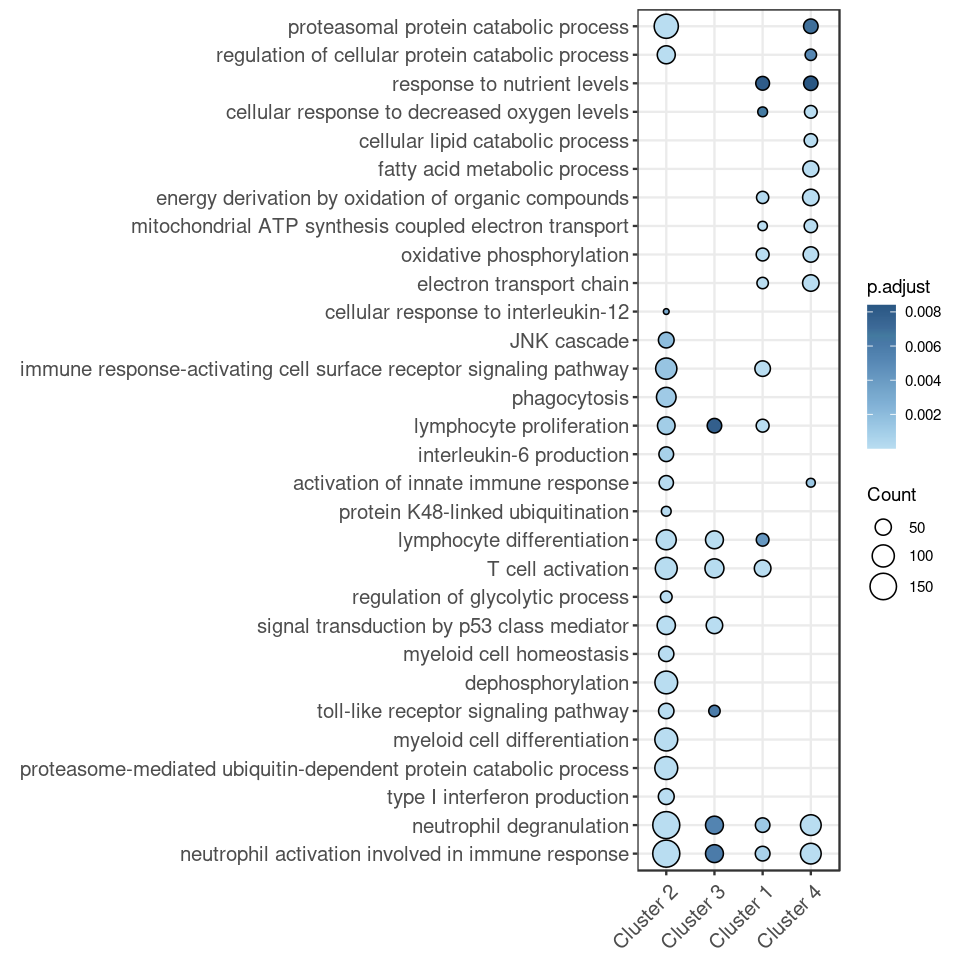

In [538]:
## 可视化
## 进行可视化画点图，颜色是NES值，大小是-log10(padj)
## Visualize
options(repr.plot.width=8, repr.plot.height=8)
p <- ggplot(tmp, aes(x = cluster, y = Description)) +
        geom_point(aes(fill=p.adjust, size = Count), shape=21)+
        scale_size_continuous(range = c(1,7), breaks = c(10,50,100,150))+
        scale_fill_gradient_tableau()+
        labs(x=NULL,y=NULL)+
        theme_bw()+
        theme(axis.text.x = element_text(angle=45, size = 12, hjust = 0.95,vjust = 0.9),
             axis.text.y = element_text(size = 12))
p

#### Branch-relared gene enrichment

In [638]:
cluster.df <- row.anno
dim(cluster.df)
head(cluster.df, n=3)

[1] 6222    1

,cluster
,<fct>
EIF1B,4
IER5,4
PTGER4,4


In [ ]:
## 做富集分析
for(i in unique(cluster.df$cluster)){
    enrich.df <- filter(cluster.df, cluster==i)
    genes <- rownames(enrich.df)
#     genes <- mapIds(x = org.Hs.eg.db, keys = rownames(enrich.df), keytype = "ENSEMBL", column = "SYMBOL") # 如果需要转换ID
    enrich.results <- enrichGO(gene = genes, OrgDb = org.Hs.eg.db, keyType = "SYMBOL", ont = "BP", pvalueCutoff = 0.05, qvalueCutoff = 0.05)
    saveRDS(enrich.results, file = paste0("/public/workspace202011/pancancer/Zhangcl/liver_metastasis/pseudotime/pseudotime_branch_cluster",i,".rds"))
}

In [639]:
## 构建可视化数据框
all_enrich.df <- data.frame()
for(i in unique(cluster.df$cluster)){

    enrich.results <- readRDS(file = paste0("/public/workspace202011/pancancer/Zhangcl/liver_metastasis/pseudotime/pseudotime_branch_hallmark_cluster",i,".rds"))
    enrich.df <- enrich.results@result %>% filter(p.adjust <0.01 & Count>10)
    enrich.df$cluster <- paste0("Cluster ",i)
    all_enrich.df <- rbind(all_enrich.df, enrich.df)  
}
all_enrich.df$cluster <- factor(all_enrich.df$cluster, levels = c("Cluster 2","Cluster 4","Cluster 1","Cluster 3"))
all_enrich.df

,ID,Description,GeneRatio,BgRatio,pvalue,p.adjust,qvalue,geneID,Count,cluster
,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<chr>,<int>,<fct>
TNFA_SIGNALING_VIA_NFKB,TNFA_SIGNALING_VIA_NFKB,TNFA_SIGNALING_VIA_NFKB,73/334,200/4384,1.844388e-33,9.221942e-32,7.377553e-32,IER5/PTGER4/ATP2B1/TIPARP/KDM6B/KYNU/PTX3/LITAF/PHLDA1/MAFF/BHLHE40/DUSP5/NR4A3/NFE2L2/CDKN1A/TNFAIP3/PNRC1/EHD1/NFKB1/NAMPT/FOSL2/PDE4B/ICOSLG/B4GALT1/KLF6/REL/PFKFB3/DUSP4/GCH1/SNN/NFKB2/FOSB/MAP2K3/PMEPA1/TRIB1/VEGFA/CFLAR/SOCS3/PTGS2/BCL3/ZBTB10/EGR3/BTG2/RNF19B/PLEK/LAMB3/SERPINE1/AREG/TANK/MCL1/CCNL1/TNFAIP2/MAP3K8/B4GALT5/MXD1/SMAD3/BIRC2/RELA/SLC2A3/IL6/IL6ST/KLF10/PTPRE/ETS2/NFAT5/PER1/NFIL3/EGR1/IER2/TNFAIP8/ABCA1/FOS/TNIP1,73,Cluster 4
INFLAMMATORY_RESPONSE,INFLAMMATORY_RESPONSE,INFLAMMATORY_RESPONSE,45/334,200/4384,9.316429e-12,2.329107e-10,1.863286e-10,PTGER4/ATP2B1/FFAR2/ICAM4/IRAK2/CDKN1A/NLRP3/NFKB1/NAMPT/PDE4B/ICOSLG/KLF6/GCH1/LCP2/GPR132/BTG2/SCN1B/SERPINE1/CSF3R/CD55/MXD1/RNF144B/EREG/IL10RA/SELL/RELA/IL6/HIF1A/STAB1/PTPRE/KIF1B/ADGRE1/TNFRSF1B/NOD2/IL1R1/C5AR1/LYN/IL4R/GNA15/SCARF1/ABCA1/CD48/PTGER2/IL10/PTGIR,45,Cluster 4
APOPTOSIS,APOPTOSIS,APOPTOSIS,29/334,161/4384,8.036471e-06,1.339412e-04,1.071530e-04,CDKN1A/CASP9/GCH1/SATB1/CFLAR/EGR3/PDCD4/BTG2/CCND2/SLC20A1/NEDD9/MCL1/CYLD/EREG/BCL2L11/CDKN1B/RELA/ETF1/IL6/ANKH/RARA/CTNNB1/BNIP3L/GNA15/HMGB2/CDC25B/PAK1/HGF/RHOT2,29,Cluster 4
HYPOXIA,HYPOXIA,HYPOXIA,32/334,200/4384,3.429752e-05,4.287191e-04,3.429752e-04,TIPARP/MAFF/BHLHE40/CDKN1A/TNFAIP3/PNRC1/JMJD6/FOSL2/EXT1/KLF6/PFKFB3/PDGFB/VEGFA/CDKN1C/SERPINE1/CCNG2/WSB1/FOXO3/KLF7/CDKN1B/SLC2A3/IL6/PRKCA/BCL2/VHL/NFIL3/BNIP3L/DDIT4/SIAH2/FOS/NDRG1/AMPD3,32,Cluster 4
IL2_STAT5_SIGNALING,IL2_STAT5_SIGNALING,IL2_STAT5_SIGNALING,31/334,199/4384,7.740157e-05,7.740157e-04,6.192126e-04,PHLDA1/MAFF/BHLHE40/PLSCR1/NFKBIZ/KLF6/SNX9/IRF4/CDKN1C/NCS1/CCND2/GABARAPL1/MAP3K8/MXD1/IL10RA/SELL/ITGAV/SLC2A3/BCL2/TNFRSF1B/WLS/PNP/IL4R/NFIL3/FGL2/PRNP/CDC42SE2/CD48/PTGER2/IL10/NDRG1,31,Cluster 4
TGF_BETA_SIGNALING,TGF_BETA_SIGNALING,TGF_BETA_SIGNALING,12/334,54/4384,5.769554e-04,4.807962e-03,3.846370e-03,PMEPA1/CDKN1C/SERPINE1/SLC20A1/SMAD3/KLF10/SKIL/CTNNB1/THBS1/ARID4B/UBE2D3/ID1,12,Cluster 4
INTERFERON_GAMMA_RESPONSE,INTERFERON_GAMMA_RESPONSE,INTERFERON_GAMMA_RESPONSE,28/334,200/4384,1.035555e-03,6.472217e-03,5.177774e-03,CDKN1A/TNFAIP3/PLSCR1/NFKB1/NAMPT/PDE4B/GCH1/LCP2/SOCS3/IRF4/PTGS2/TNFAIP2/PTPN1/IL10RA/IL6/MX2/HIF1A/LATS2/P2RY14/PELI1/XAF1/PNP/ZNFX1/IL4R/STAT3/FGL2/IFNAR2/IFITM2,28,Cluster 4
P53_PATHWAY,P53_PATHWAY,P53_PATHWAY,28/334,200/4384,1.035555e-03,6.472217e-03,5.177774e-03,IER5/SLC19A2/CDKN1A/TSPYL2/BTG2/RNF19B/RALGDS/WWP1/BAIAP2/RHBDF2/CCND2/MXD1/VDR/CYFIP2/DNTTIP2/FOXO3/CDKN2AIP/ZFP36L1/PTPRE/MKNK2/TOB1/HEXIM1/DDIT4/FOS/RB1/NDRG1/ABCC5/DEF6,28,Cluster 4
MITOTIC_SPINDLE,MITOTIC_SPINDLE,MITOTIC_SPINDLE,77/879,199/4384,4.084623e-10,2.042312e-08,1.762837e-08,KPTN/DST/ARL8A/KIF5B/SUN2/FLNA/CENPF/BUB1/FARP1/RACGAP1/KIF22/CDC42/RALBP1/CCDC88A/TRIO/ACTN4/SMC3/KIF11/YWHAE/MYO1E/PALLD/TUBGCP2/ARHGDIA/SSH2/FGD4/DOCK2/CDC27/KATNA1/ARF6/NOTCH2/PREX1/PXN/RAB3GAP1/ATG4B/RICTOR/VCL/SMC1A/ARFGEF1/ARHGEF3/MAP1S/STAU1/RFC1/INCENP/NCK2/ARHGAP27/TUBGCP3/CDK5RAP2/LRPPRC/CD2AP/BRCA2/ARHGAP5/KLC1/NF1/RABGAP1/CNTRL/WASF2/HOOK3/PCM1/CLIP1/NUMA1/MYH9/ROCK1/MYO9B/DYNC1H1/ABR/SPTAN1/MID1IP1/SOS1/FBXO5/FLNB/SMC4/KIF20B/LMNB1/MARCKS/SPTBN1/KNTC1/ABI1,77,Cluster 2


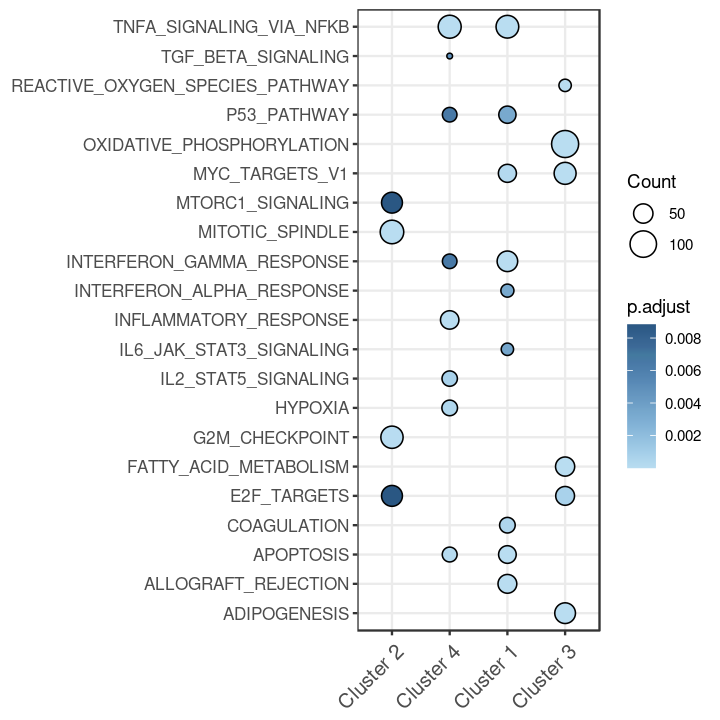

In [640]:
## 可视化
## 进行可视化画点图，颜色是NES值，大小是-log10(padj)
## Visualize
options(repr.plot.width=6, repr.plot.height=6)
p <- ggplot(all_enrich.df, aes(x = cluster, y = Description)) +
        geom_point(aes(fill=p.adjust, size = Count), shape=21)+
        scale_size_continuous(range = c(1,7), breaks = c(10,50,100,150))+
        scale_fill_gradient_tableau()+
        labs(x=NULL,y=NULL)+
        theme_bw()+
        theme(axis.text.x = element_text(angle=45, size = 12, hjust = 0.95,vjust = 0.9),
             axis.text.y = element_text(size = 10))
p
# https://www.sciencedirect.com/science/article/pii/S0005272810007024?via%3Dihub#s0045 癌症氧化磷酸化相关
## 所以主要是在Cluster 3里呈现出缺氧状态？

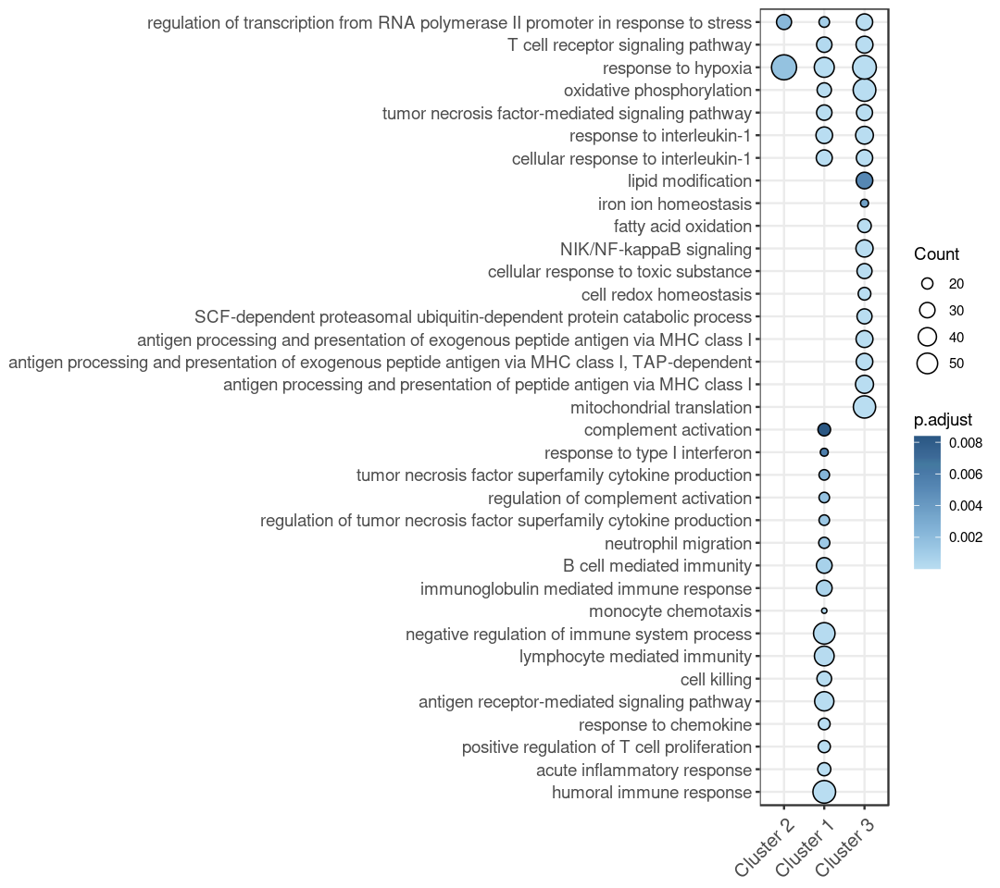

In [677]:
## 可视化
## 进行可视化画点图，颜色是NES值，大小是-log10(padj)
## Visualize
tmp$Description <- factor(tmp$Description, levels = path.need)
options(repr.plot.width=9, repr.plot.height=8)
p <- ggplot(tmp, aes(x = cluster, y = Description)) +
        geom_point(aes(fill=p.adjust, size = Count), shape=21)+
        scale_size_continuous(range = c(1,7), breaks = c(10,20,30,40,50))+
        scale_fill_gradient_tableau()+
        labs(x=NULL,y=NULL)+
        theme_bw()+
        theme(axis.text.x = element_text(angle=45, size = 12, hjust = 0.95,vjust = 0.9),
             axis.text.y = element_text(size = 11))
p
## 把这里的区分一下

#### Branch-related gene pathway heatmap

# T cell

In [531]:
# obj <- readRDS("/mnt/public2/pancancer/metastasis/analysis/metastasis.final.rds")
# obj.t <- subset(obj, primary_cluster %in% c("NK","CD4T","CD8T"))
# obj.t <- RunUMAP(obj.t, dims = 1:20)
# saveRDS(obj.t, file = "/public/workspace202011/pancancer/Zhangcl/liver_metastasis/metastasis.nkt_all.rds")

An object of class Seurat 
64751 features across 460337 samples within 3 assays 
Active assay: RNA (33538 features, 0 variable features)
 2 other assays present: SCT, integrated
 2 dimensional reductions calculated: pca, umap

In [266]:
obj.t <- readRDS("/public/workspace202011/pancancer/Zhangcl/liver_metastasis/metastasis.nkt_all.rds")
obj.t

An object of class Seurat 
64751 features across 177779 samples within 3 assays 
Active assay: RNA (33538 features, 0 variable features)
 2 other assays present: SCT, integrated
 2 dimensional reductions calculated: pca, umap

In [267]:
cluster.df <- read.csv(file = "/public/workspace202011/pancancer/Zhangcl/liver_metastasis/CP_cluster.csv")
cluster.df

X,sampleID,cluster
<int>,<chr>,<chr>
1,HCC10-PT,CP1
2,HCC08-PT,CP1
3,PDAC01-HM,CP1
4,UVM02-HM,CP1
5,PDAC06-HM,CP1
6,ICC03-PT_2,CP1
7,PDAC03-HM,CP1
8,HCC09-PT,CP2
9,ICC02-PT,CP2


In [268]:
mid <- match(obj.t@meta.data$sampleID, cluster.df$sampleID)
obj.t@meta.data$cluster <- cluster.df$cluster[mid]
unique(obj.t$cluster)

obj.t$tissue_group <- paste0(obj.t$tissue, "_",obj.t$group)
unique(obj.t$tissue_group)

[1] NA    "CP5" "CP2" "CP1" "CP6" "CP3" "CP4"

[1] "Lung_PT"      "Liver_PN"     "Liver_PT"     "Eye_HM"       "Eye_PT"      
 [6] "Intestine_HM" "Intestine_PT" "Pancreas_HM"  "Pancreas_PT"  "Stomach_PT"  
[11] "Stomach_HM"   "Mammary_HM"   "Mammary_PT"   "Lung_HM"      "Pancreas_PN" 
[16] "Eye_NN"       "Intestine_NN" "Lung_NN"      "Mammary_NN"   "Pancreas_NN" 
[21] "Liver_NN"

In [879]:
table(obj.t@meta.data$sampleID)


   CRC01-HM    CRC01-PT    CRC02-HM    CRC02-PT    CRC03-HM    CRC03-PT 
       9575        7297        2119        6680        6599        2029 
   Eye01-NN    Eye02-NN    Eye03-NN     GC01-HM     GC01-PT     GC02-HM 
        175           2         135        1136         630        8757 
    GC02-PT     GC03-PT     GC04-PT     GC05-PT     GC06-PT   GC07-PT_1 
       1475        2161        3533        2132        1710        3339 
  GC07-PT_2    HCC01-PT    HCC02-PT    HCC03-PN    HCC03-PT    HCC04-PT 
       2024        1022         157         361          46         138 
   HCC05-PN    HCC05-PT    HCC06-PN    HCC06-PT    HCC07-PN    HCC07-PT 
       3145         311        2740        1613        2455          90 
   HCC08-PN    HCC08-PT    HCC09-PN    HCC09-PT    HCC10-PN    HCC10-PT 
       3935        1258         969         587        2292         737 
   ICC01-PN    ICC01-PT    ICC02-PN    ICC02-PT  ICC03-PT_1  ICC03-PT_2 
       7426          37        2147         266   

## CD4T (fig 7)

In [192]:
obj.t <- readRDS("/public/workspace202011/pancancer/Zhangcl/liver_metastasis/metastasis.nkt_all.rds")
obj.cd4 <- subset(obj.t, primary_cluster == "CD4T")
obj.cd4

An object of class Seurat 
64751 features across 86537 samples within 3 assays 
Active assay: RNA (33538 features, 0 variable features)
 2 other assays present: SCT, integrated
 2 dimensional reductions calculated: pca, umap

In [193]:
obj.cd4$tissue_group <- paste0(obj.cd4$tissue, "_",obj.cd4$group)
unique(obj.cd4$tissue_group)

[1] "Lung_PT"      "Liver_PN"     "Liver_PT"     "Eye_HM"       "Eye_PT"      
 [6] "Intestine_HM" "Intestine_PT" "Pancreas_HM"  "Pancreas_PT"  "Stomach_PT"  
[11] "Stomach_HM"   "Mammary_HM"   "Mammary_PT"   "Lung_HM"      "Pancreas_PN" 
[16] "Eye_NN"       "Intestine_NN" "Lung_NN"      "Mammary_NN"   "Pancreas_NN" 
[21] "Liver_NN"

In [194]:
mid <- match(obj.cd4@meta.data$sampleID, cluster.df$sampleID)
obj.cd4@meta.data$cluster <- cluster.df$cluster[mid]
obj.cd4@meta.data$cluster[is.na(obj.cd4@meta.data$cluster)==TRUE] <- "others"
unique(obj.cd4$cluster)

[1] "others" "CP5"    "CP2"    "CP1"    "CP6"    "CP3"    "CP4"

In [195]:
obj.cd4 <- RunUMAP(obj.cd4, dims = 1:20)

Warning message:
“The default method for RunUMAP has changed from calling Python UMAP via reticulate to the R-native UWOT using the cosine metric
To use Python UMAP via reticulate, set umap.method to 'umap-learn' and metric to 'correlation'
This message will be shown once per session”
10:09:41 UMAP embedding parameters a = 0.9922 b = 1.112

10:09:41 Read 86537 rows and found 20 numeric columns

10:09:41 Using Annoy for neighbor search, n_neighbors = 30

10:09:41 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

10:09:54 Writing NN index file to temp file /tmp/RtmpzlYEsw/file3432e2967241b

10:09:54 Searching Annoy index using 1 thread, search_k = 3000

10:10:36 Annoy recall = 100%

10:10:37 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors

In [ ]:
saveRDS(obj.cd4, file = "/public/workspace202011/pancancer/Zhangcl/liver_metastasis/metastasis.cd4_all.rds")

In [806]:
## 改变gene名
refGenes <- obj.cd4@misc$geneName
DefaultAssay(obj.cd4) <- "RNA"
if(!any(is.na(refGenes[rownames(obj.cd4@assays$RNA@data)]))){
  rownames(obj.cd4@assays$RNA@data) <- refGenes[rownames(obj.cd4@assays$RNA@data)]
}
head(rownames(obj.cd4@assays$RNA@data), n=1)

ENSG00000000003 
       "TSPAN6"

In [1314]:
color_cd4t_celltype <- c('CD4T_CXCR4'="#fd6f30",'CD4T_MT1X'="#f9d23c",
                         'CD4Tn_CCR7'="#5fbb68",'Th1_GADD45B'="#91dcea",'Th1_IFITM1'="#00a2b3",'Th17_AREG'="#90728f",'Th17_CD2'="#b9a0b4",
                           'Treg_BATF'="#bcbd22",'Treg_TNFRSF4'="#a08400",
                         'CD4Tm_CXCL13'="#FF9D9A",'CD4Tm_LTB'="#D37295",'CD4Tm_IL7R'="#FABFD2")

### UMAP

[1] "CD4T_CXCR4"   "CD4Tn_CCR7"   "CD4T_MT1X"    "Th17_AREG"    "Treg_TNFRSF4"
 [6] "Th17_CD2"     "CD4Tm_LTB"    "CD4Tm_IL7R"   "Treg_BATF"    "CD4Tm_CXCL13"
[11] "Th1_GADD45B"  "Th1_IFITM1"

[1] 12

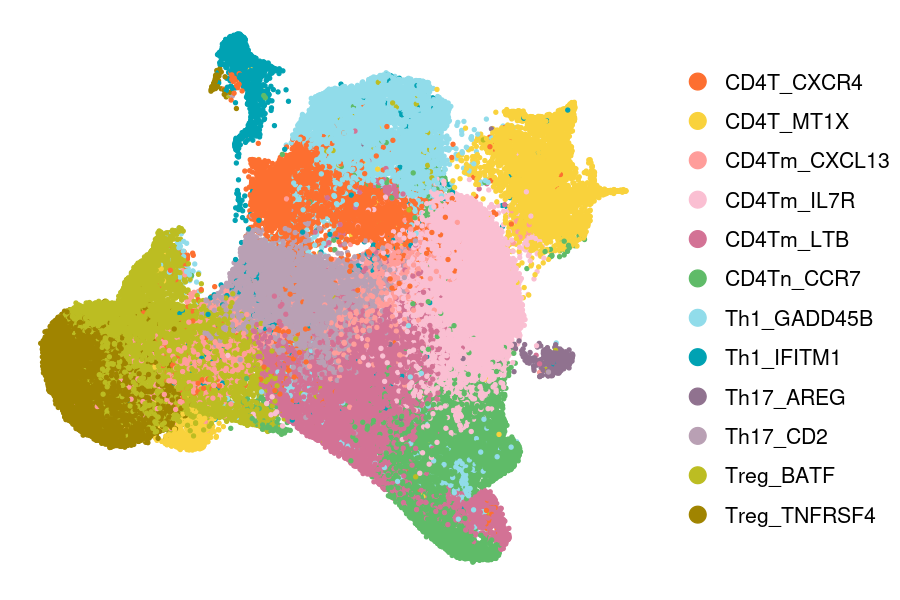

In [1329]:
umap <- obj.cd4@reductions$umap@cell.embeddings %>%
  as.data.frame() %>%
  cbind(cell_type = obj.cd4@meta.data$subtype)
umap$cell_type <- as.character(umap$cell_type)
unique(umap$cell_type)
length(unique(umap$cell_type))

options(repr.plot.width = 9, repr.plot.height =6, repr.plot.res = 100)
p <- ggplot(data = umap, aes(x = UMAP_1, y = UMAP_2, color = cell_type)) +
  geom_point(size = 0.7, alpha = 1) +
  scale_color_manual(values = color_cd4t_celltype) +
  theme(panel.grid.major = element_blank(), # remove background color……
        panel.grid.minor = element_blank(),
        panel.border = element_blank(),
        axis.title = element_blank(),
        axis.text = element_blank(),
        axis.ticks = element_blank(),
        panel.background = element_rect(fill = "white"),
        plot.background = element_rect(fill = "white")) +
  theme(legend.title = element_blank(),
        legend.key = element_rect(fill = "white"), # remove legend background color
        legend.text = element_text(size = 15),
        legend.key.size = unit(1,"cm")) + 
  guides(color = guide_legend(override.aes = list(size = 5)))  # adjust size of plot in legend box
p

In [1330]:
pdf(file = "/public/workspace202011/pancancer/Zhangcl/liver_metastasis/Figure/CD4T_umap.pdf", width = 8, height = 5)
p
dev.off()
# 这个还是直接复制粘贴把，占内存太大

png 
  2

[1] "others" "CP5"    "CP2"    "CP1"    "CP6"    "CP3"    "CP4"

[1] 7

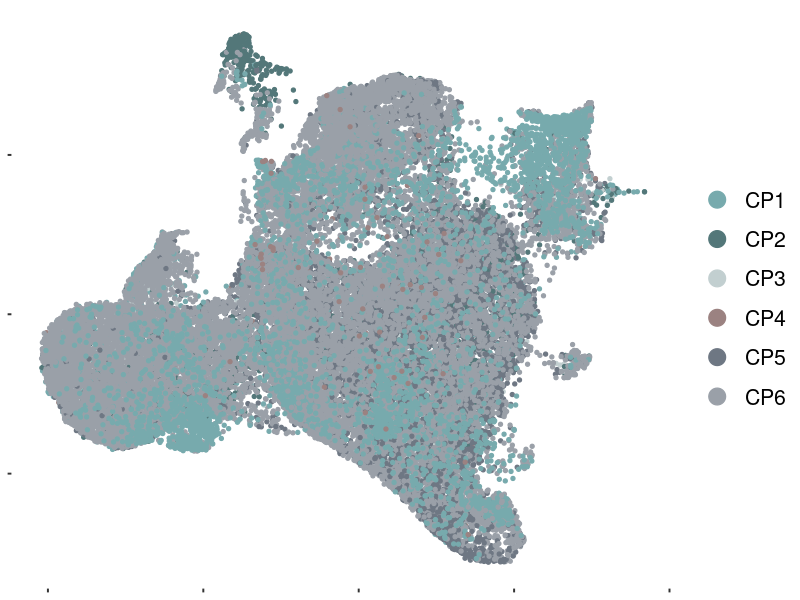

In [1247]:
umap <- obj.cd4@reductions$umap@cell.embeddings %>%
  as.data.frame() %>%
  cbind(cell_type = obj.cd4@meta.data$cluster)
umap$cell_type <- as.character(umap$cell_type)
unique(umap$cell_type)
length(unique(umap$cell_type))
umap <- umap[umap$cell_type != "others",]

options(repr.plot.width = 8, repr.plot.height =6, repr.plot.res = 100)
p <- ggplot(data = umap, aes(x = UMAP_1, y = UMAP_2, color = cell_type)) +
  geom_point(size = 0.7, alpha = 1) +
  scale_color_manual(values = color_cluster) +
  theme(panel.grid.major = element_blank(), # remove background color……
        panel.grid.minor = element_blank(),
        panel.border = element_blank(),
        axis.title = element_blank(),
        axis.text = element_blank(),
        panel.background = element_rect(fill = "white"),
        plot.background = element_rect(fill = "white")) +
  theme(legend.title = element_blank(),
        legend.key = element_rect(fill = "white"), # remove legend background color
        legend.text = element_text(size = 15),
        legend.key.size = unit(1,"cm")) + 
  guides(color = guide_legend(override.aes = list(size = 5)))  # adjust size of plot in legend box
p

### marker

In [804]:
obj.cd4

An object of class Seurat 
64751 features across 86537 samples within 3 assays 
Active assay: RNA (33538 features, 0 variable features)
 2 other assays present: SCT, integrated
 2 dimensional reductions calculated: pca, umap

In [ ]:
gene.need <- c("NKG7","NCR1","KLRD1",
                "NCAM1",
                "CD3D","CD3E",
                "CD8A","CD8B",
                "CD4", # CD4T
                "CCR7","SELL","CD5","HLA-B", # CD4 naive T
                "CD44","IFNG","S100A4","GPR183", # CD4 memory T
                "CD4","FASLG","IFNG","CD44","FAS", # CD4 effectoe T (CD44 hi)
                "IL2","IFNG", # TH1
               "IL4","IL5","IL13", # TH2
               "IL17A","IL22", # TH17
#                "IL9", # TH9
               "IL22", # TH22
               "CXCR5","ICOS","PDCD1","IL21","BCL6", # TFH
                "FOXP3","IL2RA" # TREG
                             )

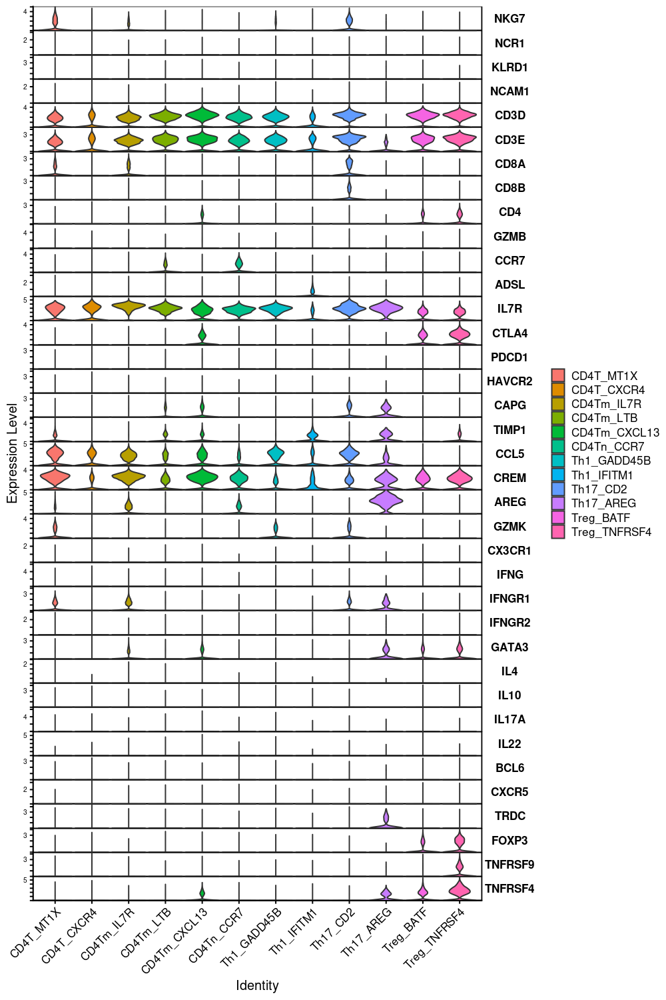

In [813]:
options(repr.plot.width = 10, repr.plot.height =15, repr.plot.res = 100)
p <- VlnPlot(obj.cd4, stack=TRUE, group.by = 'subtype', fill.by='ident', sort = FALSE, flip = TRUE,
        pt.size=0, features=gene.need)
p

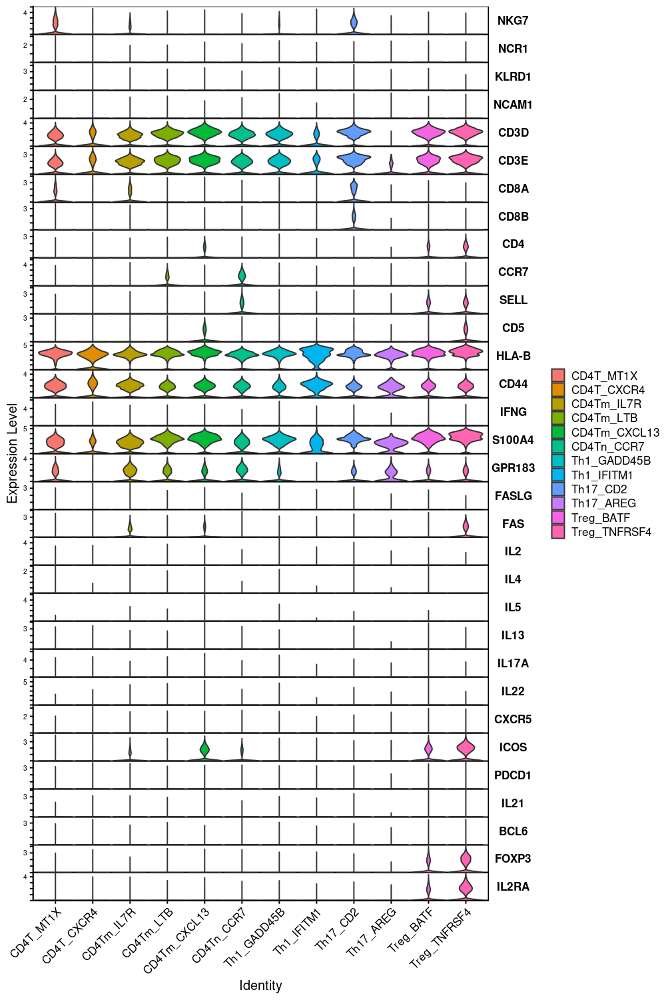

In [816]:
options(repr.plot.width = 10, repr.plot.height =15, repr.plot.res = 100)
p <- VlnPlot(obj.cd4, stack=TRUE, group.by = 'subtype', fill.by='ident', sort = FALSE, flip = TRUE,
        pt.size=0, features=gene.need)
p

### proportion

In [1248]:
df <- obj.cd4@meta.data[obj.cd4@meta.data$cluster %in% c("CP3","CP6","CP1","CP2","CP4","CP5"),]
df$subtype <- as.character(df$subtype)
df <- as.data.frame(prop.table(table(df$subtype, df$cluster), margin = 2))
df

Var1,Var2,Freq
<fct>,<fct>,<dbl>
CD4T_CXCR4,CP1,0.075187970
CD4T_MT1X,CP1,0.233266092
CD4Tm_CXCL13,CP1,0.060150376
CD4Tm_IL7R,CP1,0.048413717
CD4Tm_LTB,CP1,0.152393178
CD4Tn_CCR7,CP1,0.075187970
Th1_GADD45B,CP1,0.066568861
Th1_IFITM1,CP1,0.006418485
Th17_AREG,CP1,0.001467082


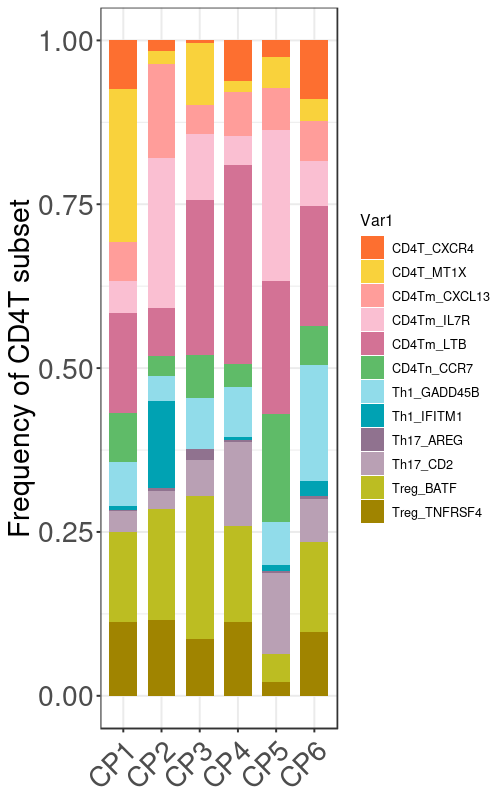

In [1250]:
## 先看一下细胞在各CP的分布
options(repr.plot.width = 5, repr.plot.height =8, repr.plot.res = 100)
ggplot(df) +
    geom_bar(aes(x = Var2, y = Freq, fill = Var1), stat = "identity", width = 0.7, size = 0.5) +
    scale_fill_manual(values = color_cd4t_celltype) +
#     theme_classic()+
    theme_bw()+ labs(x=NULL,y="Frequency of CD4T subset")+
    theme(axis.text.x = element_text(angle=45, size = 20, hjust = 0.95,vjust = 0.9), 
          axis.text.y = element_text(size = 20),
          axis.title.y = element_text(size =20)
         )

,Var1,Var2,Freq
,<fct>,<fct>,<dbl>
1,CD4T_CXCR4,HM,0.08489924


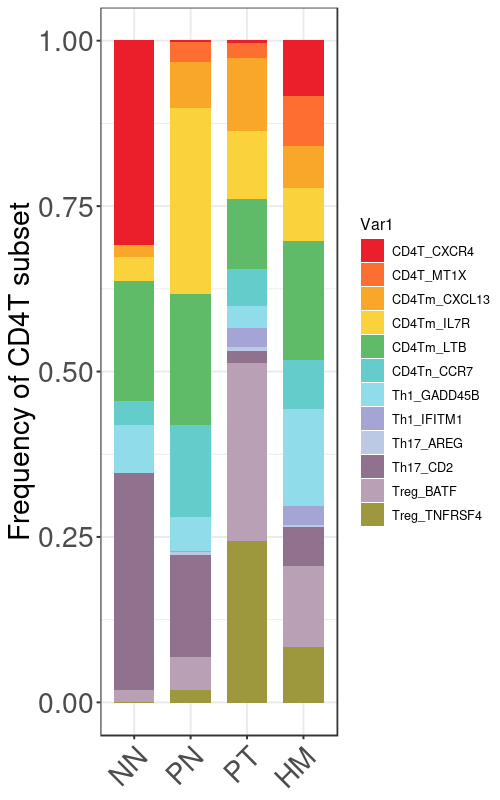

In [1168]:
df <- obj.cd4@meta.data[obj.cd4@meta.data$cluster %in% c("CP3","CP6","CP1","CP2","CP4","CP5"),]
df$subtype <- as.character(df$subtype)
df <- as.data.frame(prop.table(table(df$subtype, df$group), margin = 2))
head(df, n=1)
df$Var2 <- factor(df$Var2, levels = c("NN","PN","PT","HM"))
## 先看一下细胞在各CP的分布
options(repr.plot.width = 5, repr.plot.height =8, repr.plot.res = 100)
ggplot(df) +
    geom_bar(aes(x = Var2, y = Freq, fill = Var1), stat = "identity", width = 0.7, size = 0.5) +
    scale_fill_manual(values = mycols) +
#     theme_classic()+
    theme_bw()+ labs(x=NULL,y="Frequency of CD4T subset")+
    theme(axis.text.x = element_text(angle=45, size = 20, hjust = 0.95,vjust = 0.9), 
          axis.text.y = element_text(size = 20),
          axis.title.y = element_text(size =20)
         )

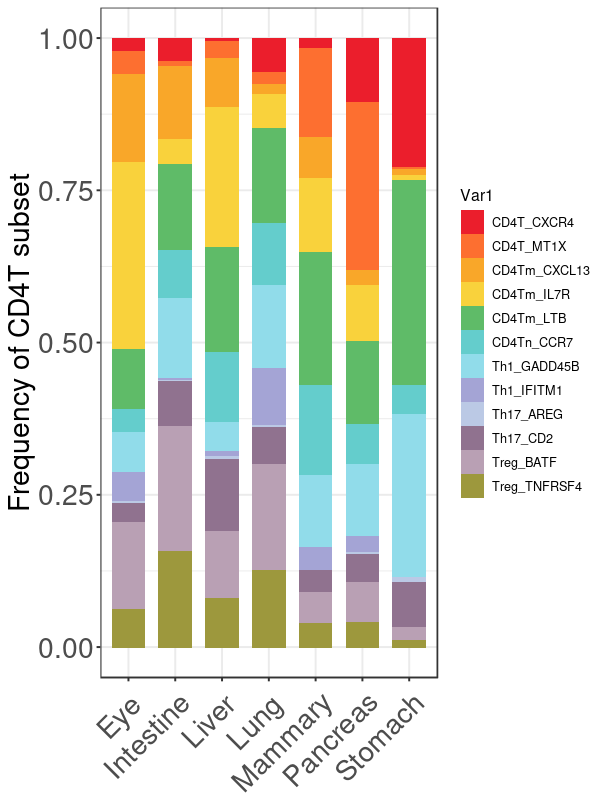

In [1164]:
df <- obj.cd4@meta.data[obj.cd4@meta.data$cluster %in% c("CP3","CP6","CP1","CP2","CP4","CP5"),]
df$subtype <- as.character(df$subtype)
df <- as.data.frame(prop.table(table(df$subtype, df$tissue), margin = 2))
## 先看一下细胞在各CP的分布
options(repr.plot.width = 6, repr.plot.height =8, repr.plot.res = 100)
ggplot(df) +
    geom_bar(aes(x = Var2, y = Freq, fill = Var1), stat = "identity", width = 0.7, size = 0.5) +
    scale_fill_manual(values = mycols) +
#     theme_classic()+
    theme_bw()+ labs(x=NULL,y="Frequency of CD4T subset")+
    theme(axis.text.x = element_text(angle=45, size = 20, hjust = 0.95,vjust = 0.9), 
          axis.text.y = element_text(size = 20),
          axis.title.y = element_text(size =20)
         )

### Ro/e

In [1209]:
df <- as.data.frame(obj.cd4@meta.data) %>% 
        filter(tissue_group %in% c("Liver_NN","Liver_PN","Liver_PT","Pancreas_HM","Eye_HM","Intestine_HM", "Stomach_HM", "Lung_HM", "Mammary_HM")) %>%
        filter(primary_cluster %in% c("CD4T"))
mid <- match(df$sampleID, cluster.df$sampleID)
df$cluster <- cluster.df$cluster[mid]
df <- dplyr::select(df,c(cluster, subtype, sampleID))

In [1210]:
df <- df %>%
  group_by(cluster, subtype) %>%
  summarise(count = n(), .groups = "drop")
df$subtype <- as.character(df$subtype)
df

cluster,subtype,count
<chr>,<chr>,<int>
CP1,CD4T_MT1X,1272
CP1,CD4T_CXCR4,410
CP1,CD4Tm_IL7R,264
CP1,CD4Tm_LTB,831
CP1,CD4Tm_CXCL13,328
CP1,CD4Tn_CCR7,410
CP1,Th1_GADD45B,363
CP1,Th1_IFITM1,35
CP1,Th17_CD2,176


In [1211]:
# contingency_table <- xtabs(count ~ subtype + group, data = df)
contingency_table <- xtabs(count ~ subtype + cluster, data = df)
chi_test <- chisq.test(contingency_table)
expected <- chi_test$expected
observed <- contingency_table
Ro_e <- observed / expected
# 查看Ro/e结果
print(Ro_e)

Warning message in chisq.test(contingency_table):
“Chi-squared approximation may be incorrect”


              cluster
subtype               CP1        CP2        CP3        CP4        CP5
  CD4T_CXCR4   1.11337515 0.25978754 0.07330638 0.92871781 0.37611263
  CD4T_MT1X    3.57547675 0.29392525 1.44173213 0.26703639 0.74391257
  CD4Tm_CXCL13 0.89849774 2.13306149 0.66553329 0.98889537 0.93871639
  CD4Tm_IL7R   0.42943150 2.03022897 0.90017710 0.40177872 2.04986087
  CD4Tm_LTB    0.85803737 0.42038620 1.32398454 1.70678191 1.14676303
  CD4Tn_CCR7   0.90548797 0.35868555 0.80485330 0.41961638 1.96886947
  Th1_GADD45B  0.53054393 0.29915395 0.61154800 0.61092937 0.53221044
  Th1_IFITM1   0.26741076 5.52441618 0.00000000 0.14516584 0.36764038
  Th17_AREG    0.40493630 1.46397029 4.78243302 0.96172371 0.82284375
  Th17_CD2     0.44856328 0.38557791 0.75681174 1.79170445 1.71361094
  Treg_BATF    1.15321372 1.41625373 1.82635561 1.22701940 0.35394228
  Treg_TNFRSF4 1.34569476 1.39320567 1.04904982 1.35013600 0.25269266
              cluster
subtype               CP6
  CD4T_CXCR4   1.331

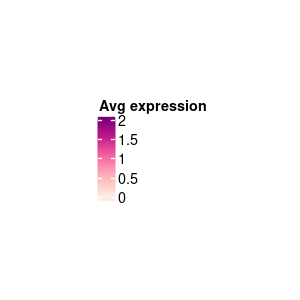

In [1212]:
options(repr.plot.width=3, repr.plot.height=3, res=100)
col_fun <- circlize::colorRamp2(breaks = c(0,0.5,1,1.5,2), 
                       colors = c(brewer.pal(5,"RdPu")[1:5]))
lgd = Legend(col_fun = col_fun, title = "Avg expression")
draw(lgd)

cell_fun <- function(j, i, x, y, width, height, fill) {
  grid.text(
    round(as.matrix(mat)[i, j], 2), 
    x, y,
    gp = gpar(
      fontsize = 10
    ))
}

In [1213]:
# row_order <- match(c(
# 'NK_NKG7','NK_CD7','NK_GNLY','NK_KLRF1','MAIT_KLRB1',
# 'CD4T_MT1X','CD4T_CXCR4','CD4Tn_CCR7','CD8Trm_ZNF683_GZMB',
# 'CD8T_GZMA','CD8T_XCL2','CD8Tex_CCL5','CD4Tm_IL7R','Th1_IFITM1','Treg_BATF','Treg_TNFRSF4','CD4Tm_CXCL13',
# 'CD8T_STMN1','Th17_AREG','CD8Tem_GZMB','CD8T_HSPA1B',
# 'CD4Tm_LTB','Th17_CD2',
# 'CD8T_IFNG','CD8Tem_GZMK','CD8Tem_KLRD1','CD8Tem_GZMA',
# 'Th1_GADD45B'    
# ), rownames(Ro_e))
mat <- as.data.frame.matrix(Ro_e) 
# mat <- mat[row_order,]
max(as.matrix(mat))
min(as.matrix(mat))
head(mat)

[1] 5.524416

[1] 0

,CP1,CP2,CP3,CP4,CP5,CP6
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
CD4T_CXCR4,1.1133752,0.2597875,0.07330638,0.9287178,0.3761126,1.3318961
CD4T_MT1X,3.5754768,0.2939252,1.44173213,0.2670364,0.7439126,0.5070275
CD4Tm_CXCL13,0.8984977,2.1330615,0.66553329,0.9888954,0.9387164,0.9235586
CD4Tm_IL7R,0.4294315,2.0302290,0.90017710,0.4017787,2.0498609,0.6105513
CD4Tm_LTB,0.8580374,0.4203862,1.32398454,1.7067819,1.1467630,1.0306594
CD4Tn_CCR7,0.9054880,0.3586855,0.80485330,0.4196164,1.9688695,0.7182325


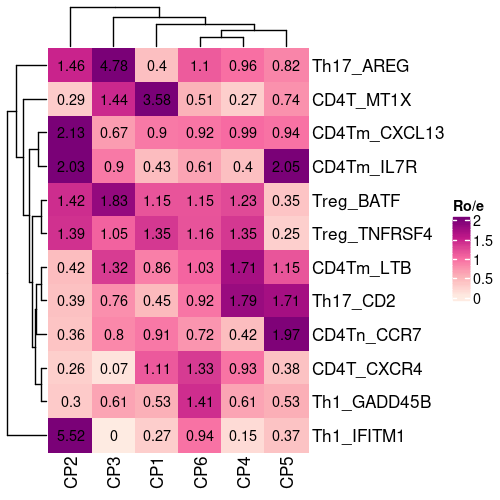

In [1214]:
options(repr.plot.width=5, repr.plot.height=5, res=100)
p <- Heatmap(as.matrix(mat), col = col_fun, cell_fun=cell_fun, 
         row_names_gp = grid::gpar(fontsize = 12), column_names_gp = gpar(fontsize=12),
#         cluster_rows = FALSE, cluster_columns = FALSE,
       name = "Ro/e")
p

In [1215]:
pdf(file = "/public/workspace202011/pancancer/Zhangcl/liver_metastasis/Figure/CD4T_roe.pdf", width = 5, height = 5)
p
dev.off()

png 
  2

### Frequency in CP

In [1025]:
## 算CD4T亚群在所有细胞中占比
df <- meta %>% dplyr::select(c(sampleID,subtype))
colnames(df) <- c("sampleID","celltype")
subtype_counts <- df %>%
  group_by(sampleID, celltype) %>%
  summarise(count = n(), .groups = "drop")
subtype_proportion <- subtype_counts %>%
  group_by(sampleID) %>%
  mutate(total = sum(count), proportion = count / total * 100) %>%
  ungroup() %>% as.data.frame() 
mid <- match(subtype_proportion$celltype, celltype_ref$subtype)
subtype_proportion$primary_cluster <- celltype_ref$primary_cluster[mid]
subtype_proportion <- filter(subtype_proportion, primary_cluster %in% c("CD4T"))
mid <- match(x = subtype_proportion$sampleID, table = cluster.df$sampleID)
subtype_proportion$cluster <- cluster.df$cluster[mid]
subtype_proportion <- subtype_proportion[is.na(subtype_proportion$cluster) == FALSE,]
subtype_proportion$cluster <- factor(subtype_proportion$cluster, levels = c("CP1","CP2","CP3","CP4","CP5","CP6"))
subtype_proportion

,sampleID,celltype,count,total,proportion,primary_cluster,cluster
,<chr>,<fct>,<int>,<int>,<dbl>,<fct>,<fct>
1,CRC01-HM,CD4T_MT1X,39,12189,0.31996062,CD4T,CP6
2,CRC01-HM,CD4T_CXCR4,106,12189,0.86963656,CD4T,CP6
3,CRC01-HM,CD4Tm_IL7R,330,12189,2.70735909,CD4T,CP6
4,CRC01-HM,CD4Tm_LTB,1111,12189,9.11477562,CD4T,CP6
5,CRC01-HM,CD4Tm_CXCL13,984,12189,8.07285257,CD4T,CP6
6,CRC01-HM,CD4Tn_CCR7,644,12189,5.28345229,CD4T,CP6
7,CRC01-HM,Th1_GADD45B,27,12189,0.22151120,CD4T,CP6
8,CRC01-HM,Th1_IFITM1,19,12189,0.15587825,CD4T,CP6
9,CRC01-HM,Th17_CD2,536,12189,4.39740750,CD4T,CP6


In [1026]:
unique(subtype_proportion$celltype)

[1] CD4T_MT1X    CD4T_CXCR4   CD4Tm_IL7R   CD4Tm_LTB    CD4Tm_CXCL13
 [6] CD4Tn_CCR7   Th1_GADD45B  Th1_IFITM1   Th17_CD2     Th17_AREG   
[11] Treg_BATF    Treg_TNFRSF4
121 Levels: Acinar_PNLIP Acinar_CLPS Acinar_PRSS1 B_CD79A B_CD74 ... Plasma_MZB1

In [1027]:
label.x <- 1.5
label.size <- 5
title.size <- 25
comparisons <- list(c("CP5","CP6"))

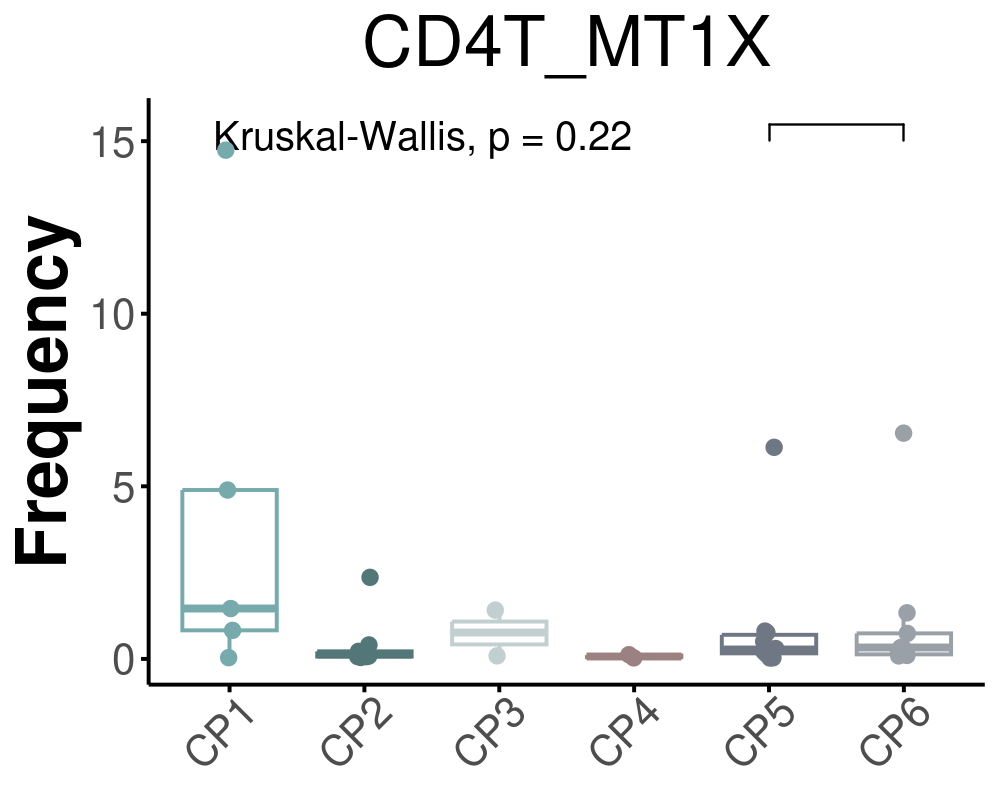

In [1028]:
subset_name <- "CD4T_MT1X"
df.target <- subtype_proportion[subtype_proportion$celltype == subset_name,]
# p1 <- ggplot(df.target, aes(x = reorder(cluster, -proportion, FUN = median), y = proportion)) +
p1 <- ggplot(df.target, aes(x = cluster, y = proportion)) +
        geom_boxplot(aes(x = cluster, color= cluster, fill=cluster), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        stat_compare_means(label.x = label.x, size = label.size)+
        stat_compare_means(comparisons = comparisons, label="p.signif",hide.ns = TRUE)+
        geom_jitter(aes(color=cluster,fill=cluster),
                    position=position_jitterdodge(dodge.width=0.65),shape = 21,size=2)+
        scale_color_manual(values=color_cluster)+  
        scale_fill_manual(values=color_cluster)+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset_name)+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = title.size),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 15),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
            scale_y_continuous(limits = c(0,5), breaks = seq(0,5,1)),
            legend.position="none") 
options(repr.plot.width = 5, repr.plot.height =4, repr.plot.res = 200)
p1

In [1029]:
subset_name <- "CD4T_CXCR4"
df.target <- subtype_proportion[subtype_proportion$celltype == subset_name,]
# p1 <- ggplot(df.target, aes(x = reorder(cluster, -proportion, FUN = median), y = proportion)) +
p2 <- ggplot(df.target, aes(x = cluster, y = proportion)) +
        geom_boxplot(aes(x = cluster, color= cluster, fill=cluster), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        stat_compare_means(label.x = label.x, size = label.size)+
        stat_compare_means(comparisons = comparisons, label="p.signif",hide.ns = TRUE)+
        geom_jitter(aes(color=cluster,fill=cluster),
                    position=position_jitterdodge(dodge.width=0.65),shape = 21,size=2)+
        scale_color_manual(values=color_cluster)+  
        scale_fill_manual(values=color_cluster)+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset_name)+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = title.size),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 15),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
            scale_y_continuous(limits = c(0,5), breaks = seq(0,5,1)),
            legend.position="none")

subset_name <- "CD4Tm_IL7R"
df.target <- subtype_proportion[subtype_proportion$celltype == subset_name,]
# p1 <- ggplot(df.target, aes(x = reorder(cluster, -proportion, FUN = median), y = proportion)) +
p3 <- ggplot(df.target, aes(x = cluster, y = proportion)) +
        geom_boxplot(aes(x = cluster, color= cluster, fill=cluster), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        stat_compare_means(label.x = label.x, size = label.size)+
        stat_compare_means(comparisons = comparisons, label="p.signif",hide.ns = TRUE)+
        geom_jitter(aes(color=cluster,fill=cluster),
                    position=position_jitterdodge(dodge.width=0.65),shape = 21,size=2)+
        scale_color_manual(values=color_cluster)+  
        scale_fill_manual(values=color_cluster)+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset_name)+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = title.size),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 15),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
            scale_y_continuous(limits = c(0,5), breaks = seq(0,5,1)),
            legend.position="none")

subset_name <- "CD4Tm_LTB"
df.target <- subtype_proportion[subtype_proportion$celltype == subset_name,]
# p1 <- ggplot(df.target, aes(x = reorder(cluster, -proportion, FUN = median), y = proportion)) +
p4 <- ggplot(df.target, aes(x = cluster, y = proportion)) +
        geom_boxplot(aes(x = cluster, color= cluster, fill=cluster), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        stat_compare_means(label.x = label.x, size = label.size)+
        stat_compare_means(comparisons = comparisons, label="p.signif",hide.ns = TRUE)+
        geom_jitter(aes(color=cluster,fill=cluster),
                    position=position_jitterdodge(dodge.width=0.65),shape = 21,size=2)+
        scale_color_manual(values=color_cluster)+  
        scale_fill_manual(values=color_cluster)+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset_name)+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = title.size),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 15),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
            scale_y_continuous(limits = c(0,5), breaks = seq(0,5,1)),
            legend.position="none")

subset_name <- "CD4Tm_CXCL13"
df.target <- subtype_proportion[subtype_proportion$celltype == subset_name,]
# p1 <- ggplot(df.target, aes(x = reorder(cluster, -proportion, FUN = median), y = proportion)) +
p5 <- ggplot(df.target, aes(x = cluster, y = proportion)) +
        geom_boxplot(aes(x = cluster, color= cluster, fill=cluster), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        stat_compare_means(label.x = label.x, size = label.size)+
        stat_compare_means(comparisons = comparisons, label="p.signif",hide.ns = TRUE)+
        geom_jitter(aes(color=cluster,fill=cluster),
                    position=position_jitterdodge(dodge.width=0.65),shape = 21,size=2)+
        scale_color_manual(values=color_cluster)+  
        scale_fill_manual(values=color_cluster)+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset_name)+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = title.size),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 15),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
            scale_y_continuous(limits = c(0,5), breaks = seq(0,5,1)),
            legend.position="none")

subset_name <- "CD4Tn_CCR7"
df.target <- subtype_proportion[subtype_proportion$celltype == subset_name,]
# p1 <- ggplot(df.target, aes(x = reorder(cluster, -proportion, FUN = median), y = proportion)) +
p6 <- ggplot(df.target, aes(x = cluster, y = proportion)) +
        geom_boxplot(aes(x = cluster, color= cluster, fill=cluster), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        stat_compare_means(label.x = label.x, size = label.size)+
        stat_compare_means(comparisons = comparisons, label="p.signif",hide.ns = TRUE)+
        geom_jitter(aes(color=cluster,fill=cluster),
                    position=position_jitterdodge(dodge.width=0.65),shape = 21,size=2)+
        scale_color_manual(values=color_cluster)+  
        scale_fill_manual(values=color_cluster)+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset_name)+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = title.size),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 15),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
            scale_y_continuous(limits = c(0,5), breaks = seq(0,5,1)),
            legend.position="none")

subset_name <- "Th1_GADD45B"
df.target <- subtype_proportion[subtype_proportion$celltype == subset_name,]
# p1 <- ggplot(df.target, aes(x = reorder(cluster, -proportion, FUN = median), y = proportion)) +
p7 <- ggplot(df.target, aes(x = cluster, y = proportion)) +
        geom_boxplot(aes(x = cluster, color= cluster, fill=cluster), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        stat_compare_means(label.x = label.x, size = label.size)+
        stat_compare_means(comparisons = comparisons, label="p.signif",hide.ns = TRUE)+
        geom_jitter(aes(color=cluster,fill=cluster),
                    position=position_jitterdodge(dodge.width=0.65),shape = 21,size=2)+
        scale_color_manual(values=color_cluster)+  
        scale_fill_manual(values=color_cluster)+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset_name)+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = title.size),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 15),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
            scale_y_continuous(limits = c(0,5), breaks = seq(0,5,1)),
            legend.position="none")

subset_name <- "Th1_IFITM1"
df.target <- subtype_proportion[subtype_proportion$celltype == subset_name,]
# p1 <- ggplot(df.target, aes(x = reorder(cluster, -proportion, FUN = median), y = proportion)) +
p8 <- ggplot(df.target, aes(x = cluster, y = proportion)) +
        geom_boxplot(aes(x = cluster, color= cluster, fill=cluster), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        stat_compare_means(label.x = label.x, size = label.size)+
        stat_compare_means(comparisons = comparisons, label="p.signif",hide.ns = TRUE)+
        geom_jitter(aes(color=cluster,fill=cluster),
                    position=position_jitterdodge(dodge.width=0.65),shape = 21,size=2)+
        scale_color_manual(values=color_cluster)+  
        scale_fill_manual(values=color_cluster)+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset_name)+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = title.size),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 15),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
            scale_y_continuous(limits = c(0,5), breaks = seq(0,5,1)),
            legend.position="none")

subset_name <- "Th17_CD2"
df.target <- subtype_proportion[subtype_proportion$celltype == subset_name,]
# p1 <- ggplot(df.target, aes(x = reorder(cluster, -proportion, FUN = median), y = proportion)) +
p9 <- ggplot(df.target, aes(x = cluster, y = proportion)) +
        geom_boxplot(aes(x = cluster, color= cluster, fill=cluster), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        stat_compare_means(label.x = label.x, size = label.size)+
        stat_compare_means(comparisons = comparisons, label="p.signif",hide.ns = TRUE)+
        geom_jitter(aes(color=cluster,fill=cluster),
                    position=position_jitterdodge(dodge.width=0.65),shape = 21,size=2)+
        scale_color_manual(values=color_cluster)+  
        scale_fill_manual(values=color_cluster)+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset_name)+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = title.size),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 15),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
            scale_y_continuous(limits = c(0,5), breaks = seq(0,5,1)),
            legend.position="none")

subset_name <- "Th17_AREG"
df.target <- subtype_proportion[subtype_proportion$celltype == subset_name,]
# p1 <- ggplot(df.target, aes(x = reorder(cluster, -proportion, FUN = median), y = proportion)) +
p10 <- ggplot(df.target, aes(x = cluster, y = proportion)) +
        geom_boxplot(aes(x = cluster, color= cluster, fill=cluster), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        stat_compare_means(label.x = label.x, size = label.size)+
        stat_compare_means(comparisons = comparisons, label="p.signif",hide.ns = TRUE)+
        geom_jitter(aes(color=cluster,fill=cluster),
                    position=position_jitterdodge(dodge.width=0.65),shape = 21,size=2)+
        scale_color_manual(values=color_cluster)+  
        scale_fill_manual(values=color_cluster)+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset_name)+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = title.size),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 15),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
            scale_y_continuous(limits = c(0,5), breaks = seq(0,5,1)),
            legend.position="none")

subset_name <- "Treg_BATF"
df.target <- subtype_proportion[subtype_proportion$celltype == subset_name,]
# p1 <- ggplot(df.target, aes(x = reorder(cluster, -proportion, FUN = median), y = proportion)) +
p11 <- ggplot(df.target, aes(x = cluster, y = proportion)) +
        geom_boxplot(aes(x = cluster, color= cluster, fill=cluster), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        stat_compare_means(label.x = label.x, size = label.size)+
        stat_compare_means(comparisons = comparisons, label="p.signif",hide.ns = TRUE)+
        geom_jitter(aes(color=cluster,fill=cluster),
                    position=position_jitterdodge(dodge.width=0.65),shape = 21,size=2)+
        scale_color_manual(values=color_cluster)+  
        scale_fill_manual(values=color_cluster)+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset_name)+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = title.size),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 15),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
            scale_y_continuous(limits = c(0,5), breaks = seq(0,5,1)),
            legend.position="none")

subset_name <- "Treg_TNFRSF4"
df.target <- subtype_proportion[subtype_proportion$celltype == subset_name,]
# p1 <- ggplot(df.target, aes(x = reorder(cluster, -proportion, FUN = median), y = proportion)) +
p12 <- ggplot(df.target, aes(x = cluster, y = proportion)) +
        geom_boxplot(aes(x = cluster, color= cluster, fill=cluster), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        stat_compare_means(label.x = label.x, size = label.size)+
        stat_compare_means(comparisons = comparisons, label="p.signif",hide.ns = TRUE)+
        geom_jitter(aes(color=cluster,fill=cluster),
                    position=position_jitterdodge(dodge.width=0.65),shape = 21,size=2)+
        scale_color_manual(values=color_cluster)+  
        scale_fill_manual(values=color_cluster)+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset_name)+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = title.size),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 15),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
            scale_y_continuous(limits = c(0,5), breaks = seq(0,5,1)),
            legend.position="none")

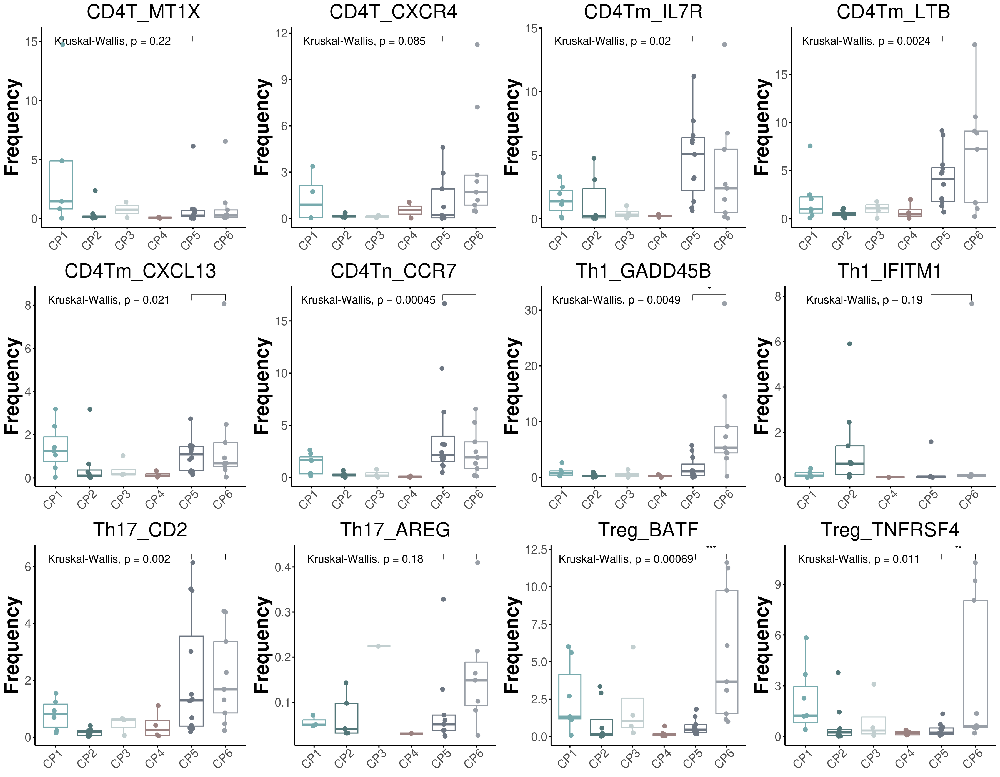

In [1196]:
## 用RO/E不太准，把所有箱线图做一遍来看看
options(repr.plot.width = 18, repr.plot.height =14, repr.plot.res = 200)
cowplot::plot_grid(p1,p2,p3,p4,
                   p5,p6,p7,p8,
                   p9,p10,p11,p12,ncol=4)

In [ ]:
pdf(file = "/public/workspace202011/pancancer/Zhangcl/liver_metastasis/Figure/CD4T_umap.pdf", width = 8, height = 5)
p
dev.off()

### Frequency in CP(color by tissue)

In [1142]:
## 算CD4T亚群在所有细胞中占比
df <- meta %>% dplyr::select(c(sampleID,subtype))
colnames(df) <- c("sampleID","celltype")
subtype_counts <- df %>%
  group_by(sampleID, celltype) %>%
  summarise(count = n(), .groups = "drop")
subtype_proportion <- subtype_counts %>%
  group_by(sampleID) %>%
  mutate(total = sum(count), proportion = count / total * 100) %>%
  ungroup() %>% as.data.frame() 
mid <- match(subtype_proportion$celltype, celltype_ref$subtype)
subtype_proportion$primary_cluster <- celltype_ref$primary_cluster[mid]
subtype_proportion <- filter(subtype_proportion, primary_cluster %in% c("CD4T"))
mid <- match(x = subtype_proportion$sampleID, table = cluster.df$sampleID)
subtype_proportion$cluster <- cluster.df$cluster[mid]
subtype_proportion <- subtype_proportion[is.na(subtype_proportion$cluster) == FALSE,]
subtype_proportion$cluster <- factor(subtype_proportion$cluster, levels = c("CP1","CP2","CP3","CP4","CP5","CP6"))
mid <- match(x = subtype_proportion$sampleID, table = sample_info$SampleID)
subtype_proportion$tissue <- sample_info$Tissue[mid]
subtype_proportion

,sampleID,celltype,count,total,proportion,primary_cluster,cluster,tissue
,<chr>,<fct>,<int>,<int>,<dbl>,<fct>,<fct>,<chr>
1,CRC01-HM,CD4T_MT1X,39,12189,0.31996062,CD4T,CP6,Intestine
2,CRC01-HM,CD4T_CXCR4,106,12189,0.86963656,CD4T,CP6,Intestine
3,CRC01-HM,CD4Tm_IL7R,330,12189,2.70735909,CD4T,CP6,Intestine
4,CRC01-HM,CD4Tm_LTB,1111,12189,9.11477562,CD4T,CP6,Intestine
5,CRC01-HM,CD4Tm_CXCL13,984,12189,8.07285257,CD4T,CP6,Intestine
6,CRC01-HM,CD4Tn_CCR7,644,12189,5.28345229,CD4T,CP6,Intestine
7,CRC01-HM,Th1_GADD45B,27,12189,0.22151120,CD4T,CP6,Intestine
8,CRC01-HM,Th1_IFITM1,19,12189,0.15587825,CD4T,CP6,Intestine
9,CRC01-HM,Th17_CD2,536,12189,4.39740750,CD4T,CP6,Intestine


In [1143]:
label.x <- 1.5
label.size <- 5
title.size <- 20
axis.x.size <- 20
comparisons <- list(c("CP5","CP6"))

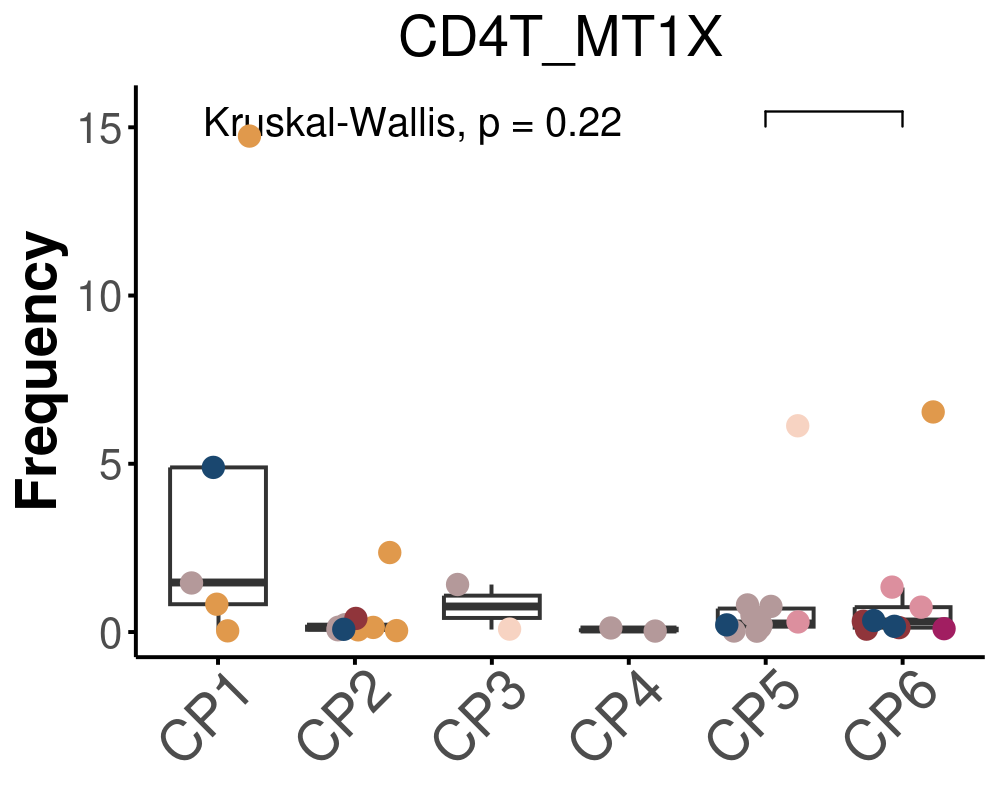

In [1051]:
subset_name <- "CD4T_MT1X"
df.target <- subtype_proportion[subtype_proportion$celltype == subset_name,]
p1 <- ggplot(df.target, aes(x = cluster, y = proportion)) +
        geom_boxplot(aes(x = cluster), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        stat_compare_means(label.x = label.x, size = label.size)+
        stat_compare_means(comparisons = comparisons, label="p.signif",hide.ns = TRUE)+
        geom_jitter(aes(color=tissue,fill=tissue),
                    position=position_jitterdodge(dodge.width=0.5),shape = 21,size=point.size)+
        scale_color_manual(values=color_tissue)+  
        scale_fill_manual(values=color_tissue)+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset_name)+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = title.size),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = axis.x.size),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
            scale_y_continuous(limits = c(0,5), breaks = seq(0,5,1)),
            legend.position="none") 
options(repr.plot.width = 5, repr.plot.height =4, repr.plot.res = 200)
p1

In [1052]:
subset_name <- "CD4T_CXCR4"
df.target <- subtype_proportion[subtype_proportion$celltype == subset_name,]
p2 <- ggplot(df.target, aes(x = cluster, y = proportion)) +
        geom_boxplot(aes(x = cluster), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        stat_compare_means(label.x = label.x, size = label.size)+
        stat_compare_means(comparisons = comparisons, label="p.signif",hide.ns = TRUE)+
        geom_jitter(aes(color=tissue,fill=tissue),
                    position=position_jitterdodge(dodge.width=0.5),shape = 21,size=point.size)+
        scale_color_manual(values=color_tissue)+  
        scale_fill_manual(values=color_tissue)+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset_name)+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = title.size),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = axis.x.size),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
            scale_y_continuous(limits = c(0,5), breaks = seq(0,5,1)),
            legend.position="none") 

subset_name <- "CD4Tm_IL7R"
df.target <- subtype_proportion[subtype_proportion$celltype == subset_name,]
p3 <- ggplot(df.target, aes(x = cluster, y = proportion)) +
        geom_boxplot(aes(x = cluster), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        stat_compare_means(label.x = label.x, size = label.size)+
        stat_compare_means(comparisons = comparisons, label="p.signif",hide.ns = TRUE)+
        geom_jitter(aes(color=tissue,fill=tissue),
                    position=position_jitterdodge(dodge.width=0.5),shape = 21,size=point.size)+
        scale_color_manual(values=color_tissue)+  
        scale_fill_manual(values=color_tissue)+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset_name)+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = title.size),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = axis.x.size),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
            scale_y_continuous(limits = c(0,5), breaks = seq(0,5,1)),
            legend.position="none") 

subset_name <- "CD4Tm_LTB"
df.target <- subtype_proportion[subtype_proportion$celltype == subset_name,]
p4 <- ggplot(df.target, aes(x = cluster, y = proportion)) +
        geom_boxplot(aes(x = cluster), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        stat_compare_means(label.x = label.x, size = label.size)+
        stat_compare_means(comparisons = comparisons, label="p.signif",hide.ns = TRUE)+
        geom_jitter(aes(color=tissue,fill=tissue),
                    position=position_jitterdodge(dodge.width=0.5),shape = 21,size=point.size)+
        scale_color_manual(values=color_tissue)+  
        scale_fill_manual(values=color_tissue)+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset_name)+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = title.size),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = axis.x.size),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
            scale_y_continuous(limits = c(0,5), breaks = seq(0,5,1)),
            legend.position="none") 

subset_name <- "CD4Tm_CXCL13"
df.target <- subtype_proportion[subtype_proportion$celltype == subset_name,]
p5 <- ggplot(df.target, aes(x = cluster, y = proportion)) +
        geom_boxplot(aes(x = cluster), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        stat_compare_means(label.x = label.x, size = label.size)+
        stat_compare_means(comparisons = comparisons, label="p.signif",hide.ns = TRUE)+
        geom_jitter(aes(color=tissue,fill=tissue),
                    position=position_jitterdodge(dodge.width=0.5),shape = 21,size=point.size)+
        scale_color_manual(values=color_tissue)+  
        scale_fill_manual(values=color_tissue)+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset_name)+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = title.size),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = axis.x.size),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
            scale_y_continuous(limits = c(0,5), breaks = seq(0,5,1)),
            legend.position="none") 

subset_name <- "CD4Tn_CCR7"
df.target <- subtype_proportion[subtype_proportion$celltype == subset_name,]
p6 <- ggplot(df.target, aes(x = cluster, y = proportion)) +
        geom_boxplot(aes(x = cluster), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        stat_compare_means(label.x = label.x, size = label.size)+
        stat_compare_means(comparisons = comparisons, label="p.signif",hide.ns = TRUE)+
        geom_jitter(aes(color=tissue,fill=tissue),
                    position=position_jitterdodge(dodge.width=0.5),shape = 21,size=point.size)+
        scale_color_manual(values=color_tissue)+  
        scale_fill_manual(values=color_tissue)+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset_name)+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = title.size),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = axis.x.size),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
            scale_y_continuous(limits = c(0,5), breaks = seq(0,5,1)),
            legend.position="none") 

subset_name <- "Th1_GADD45B"
df.target <- subtype_proportion[subtype_proportion$celltype == subset_name,]
p7 <- ggplot(df.target, aes(x = cluster, y = proportion)) +
        geom_boxplot(aes(x = cluster), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        stat_compare_means(label.x = label.x, size = label.size)+
        stat_compare_means(comparisons = comparisons, label="p.signif",hide.ns = TRUE)+
        geom_jitter(aes(color=tissue,fill=tissue),
                    position=position_jitterdodge(dodge.width=0.5),shape = 21,size=point.size)+
        scale_color_manual(values=color_tissue)+  
        scale_fill_manual(values=color_tissue)+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset_name)+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = title.size),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = axis.x.size),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
            scale_y_continuous(limits = c(0,5), breaks = seq(0,5,1)),
            legend.position="none") 

subset_name <- "Th1_IFITM1"
df.target <- subtype_proportion[subtype_proportion$celltype == subset_name,]
p8 <- ggplot(df.target, aes(x = cluster, y = proportion)) +
        geom_boxplot(aes(x = cluster), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        stat_compare_means(label.x = label.x, size = label.size)+
        stat_compare_means(comparisons = comparisons, label="p.signif",hide.ns = TRUE)+
        geom_jitter(aes(color=tissue,fill=tissue),
                    position=position_jitterdodge(dodge.width=0.5),shape = 21,size=point.size)+
        scale_color_manual(values=color_tissue)+  
        scale_fill_manual(values=color_tissue)+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset_name)+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = title.size),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = axis.x.size),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
            scale_y_continuous(limits = c(0,5), breaks = seq(0,5,1)),
            legend.position="none") 

subset_name <- "Th17_CD2"
df.target <- subtype_proportion[subtype_proportion$celltype == subset_name,]
p9 <- ggplot(df.target, aes(x = cluster, y = proportion)) +
        geom_boxplot(aes(x = cluster), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        stat_compare_means(label.x = label.x, size = label.size)+
        stat_compare_means(comparisons = comparisons, label="p.signif",hide.ns = TRUE)+
        geom_jitter(aes(color=tissue,fill=tissue),
                    position=position_jitterdodge(dodge.width=0.5),shape = 21,size=point.size)+
        scale_color_manual(values=color_tissue)+  
        scale_fill_manual(values=color_tissue)+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset_name)+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = title.size),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = axis.x.size),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
            scale_y_continuous(limits = c(0,5), breaks = seq(0,5,1)),
            legend.position="none") 

subset_name <- "Th17_AREG"
df.target <- subtype_proportion[subtype_proportion$celltype == subset_name,]
p10 <- ggplot(df.target, aes(x = cluster, y = proportion)) +
        geom_boxplot(aes(x = cluster), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        stat_compare_means(label.x = label.x, size = label.size)+
        stat_compare_means(comparisons = comparisons, label="p.signif",hide.ns = TRUE)+
        geom_jitter(aes(color=tissue,fill=tissue),
                    position=position_jitterdodge(dodge.width=0.5),shape = 21,size=point.size)+
        scale_color_manual(values=color_tissue)+  
        scale_fill_manual(values=color_tissue)+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset_name)+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = title.size),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = axis.x.size),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
            scale_y_continuous(limits = c(0,5), breaks = seq(0,5,1)),
            legend.position="none") 

subset_name <- "Treg_BATF"
df.target <- subtype_proportion[subtype_proportion$celltype == subset_name,]
p11 <- ggplot(df.target, aes(x = cluster, y = proportion)) +
        geom_boxplot(aes(x = cluster), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        stat_compare_means(label.x = label.x, size = label.size)+
        stat_compare_means(comparisons = comparisons, label="p.signif",hide.ns = TRUE)+
        geom_jitter(aes(color=tissue,fill=tissue),
                    position=position_jitterdodge(dodge.width=0.5),shape = 21,size=point.size)+
        scale_color_manual(values=color_tissue)+  
        scale_fill_manual(values=color_tissue)+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset_name)+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = title.size),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = axis.x.size),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
            scale_y_continuous(limits = c(0,5), breaks = seq(0,5,1)),
            legend.position="none") 

subset_name <- "Treg_TNFRSF4"
df.target <- subtype_proportion[subtype_proportion$celltype == subset_name,]
p12 <- ggplot(df.target, aes(x = cluster, y = proportion)) +
        geom_boxplot(aes(x = cluster), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        stat_compare_means(label.x = label.x, size = label.size)+
        stat_compare_means(comparisons = comparisons, label="p.signif",hide.ns = TRUE)+
        geom_jitter(aes(color=tissue,fill=tissue),
                    position=position_jitterdodge(dodge.width=0.5),shape = 21,size=point.size)+
        scale_color_manual(values=color_tissue)+  
        scale_fill_manual(values=color_tissue)+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset_name)+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = title.size),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = axis.x.size),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
            scale_y_continuous(limits = c(0,5), breaks = seq(0,5,1)),
            legend.position="none") 

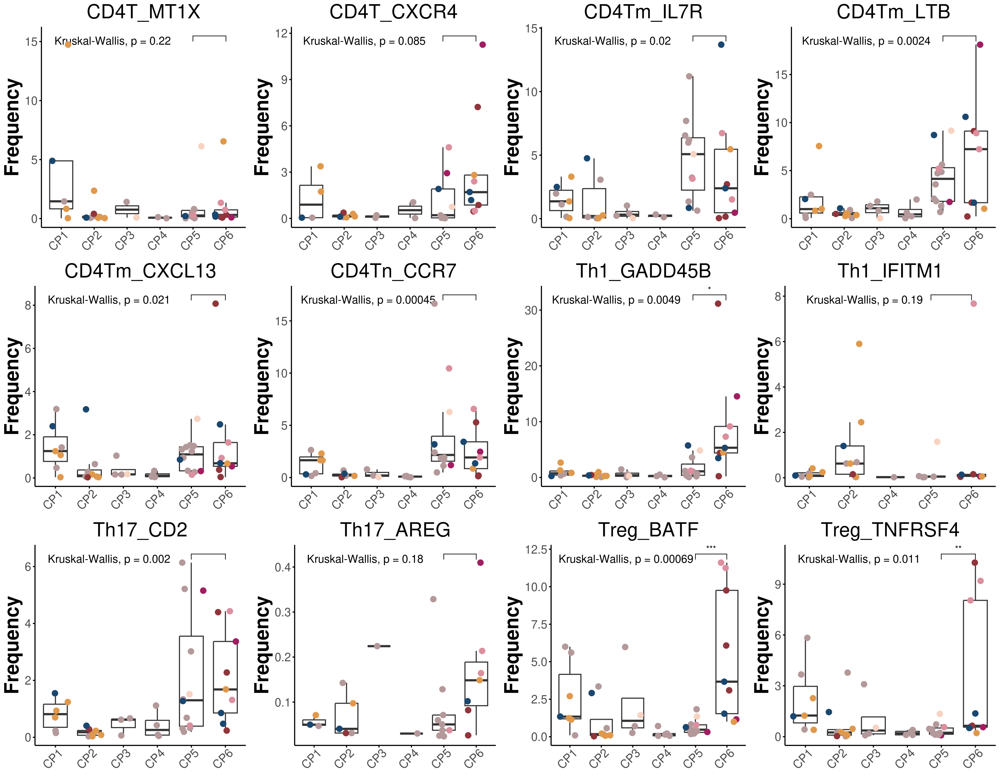

In [946]:
## 用RO/E不太准，把所有箱线图做一遍来看看
options(repr.plot.width = 18, repr.plot.height =14, repr.plot.res = 200)
cowplot::plot_grid(p1,p2,p3,p4,
                   p5,p6,p7,p8,
                   p9,p10,p11,p12,ncol=4)

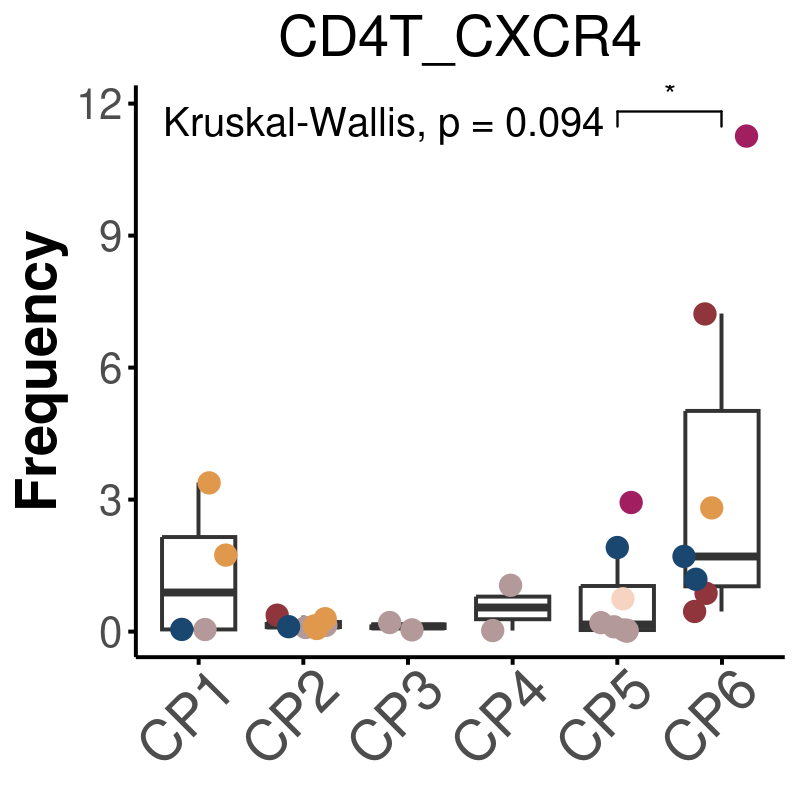

In [ ]:
subset_name <- "CD4T_CXCR4"
df.target <- subtype_proportion[subtype_proportion$celltype == subset_name,]
df.target <- df.target[df.target$tissue %in% c("Liver","Pancreas","Intestine","Mammary","Stomach","Eye"),]
p2 <- ggplot(df.target, aes(x = cluster, y = proportion)) +
        geom_boxplot(aes(x = cluster), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        stat_compare_means(label.x = label.x, size = label.size)+
        stat_compare_means(comparisons = comparisons, label="p.signif",hide.ns = TRUE)+
        geom_jitter(aes(color=tissue,fill=tissue),
                    position=position_jitterdodge(dodge.width=0.5),shape = 21,size=point.size)+
        scale_color_manual(values=color_tissue)+  
        scale_fill_manual(values=color_tissue)+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset_name)+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = title.size),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = axis.x.size),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
            scale_y_continuous(limits = c(0,5), breaks = seq(0,5,1)),
            legend.position="none") 
options(repr.plot.width = 4, repr.plot.height =4, repr.plot.res = 200)
p2

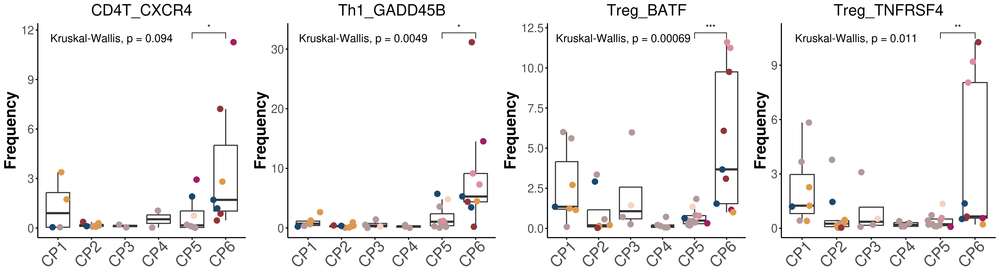

In [1054]:
## 用RO/E不太准，把所有箱线图做一遍来看看
options(repr.plot.width = 18, repr.plot.height =5, repr.plot.res = 200)
cowplot::plot_grid(p2,p7,p11,p12,ncol=4)

`geom_smooth()` using formula = 'y ~ x'
`geom_smooth()` using formula = 'y ~ x'
`geom_smooth()` using formula = 'y ~ x'
`geom_smooth()` using formula = 'y ~ x'


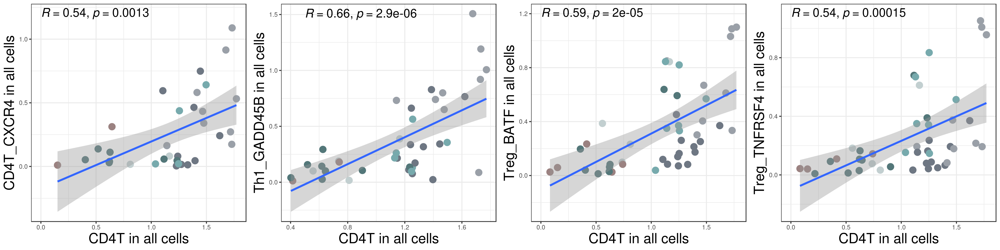

In [1072]:
options(repr.plot.width = 20, repr.plot.height =5, repr.plot.res = 200)
cowplot::plot_grid(p1,p2,p3,p4,ncol=4)

In [1073]:
pdf(file = "/public/workspace202011/pancancer/Zhangcl/liver_metastasis/Figure/CD4T_proportion_relevance.pdf", width = 16, height = 4)
cowplot::plot_grid(p1,p2,p3,p4,ncol=4)
dev.off()

`geom_smooth()` using formula = 'y ~ x'
`geom_smooth()` using formula = 'y ~ x'
`geom_smooth()` using formula = 'y ~ x'
`geom_smooth()` using formula = 'y ~ x'


png 
  2

Warning message in get_plot_component(plot, "guide-box"):
“Multiple components found; returning the first one. To return all, use `return_all = TRUE`.”


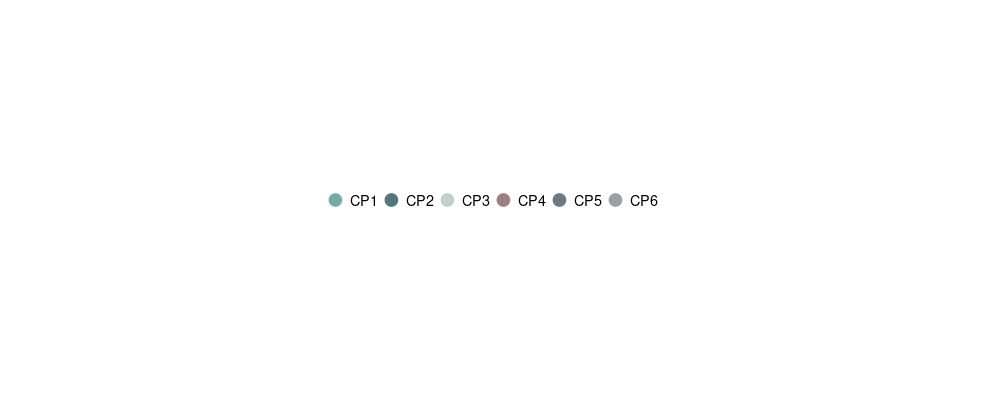

In [1161]:
p <- ggplot(df.target, aes(x=primary, y=subtype)) +
     geom_point(aes(color=cluster),size = 3.5) +
     scale_color_manual(values=color_cluster)+  
            theme(panel.background=element_rect(fill='transparent'), ##去掉底层阴影
                  legend.title = element_blank(),
                  legend.position = "right", 
                  legend.direction = "horizontal", 
                  legend.text = element_text(size=10),
                  legend.key.size = unit(5, "pt")) +
            guides(color=guide_legend(ncol=7, byrow=TRUE))

options(repr.plot.width = 10, repr.plot.height =4, repr.plot.res = 100)
lgd <- cowplot::get_legend(p)
grid.newpage()
grid.draw(lgd)

### function

Picking joint bandwidth of 0.838



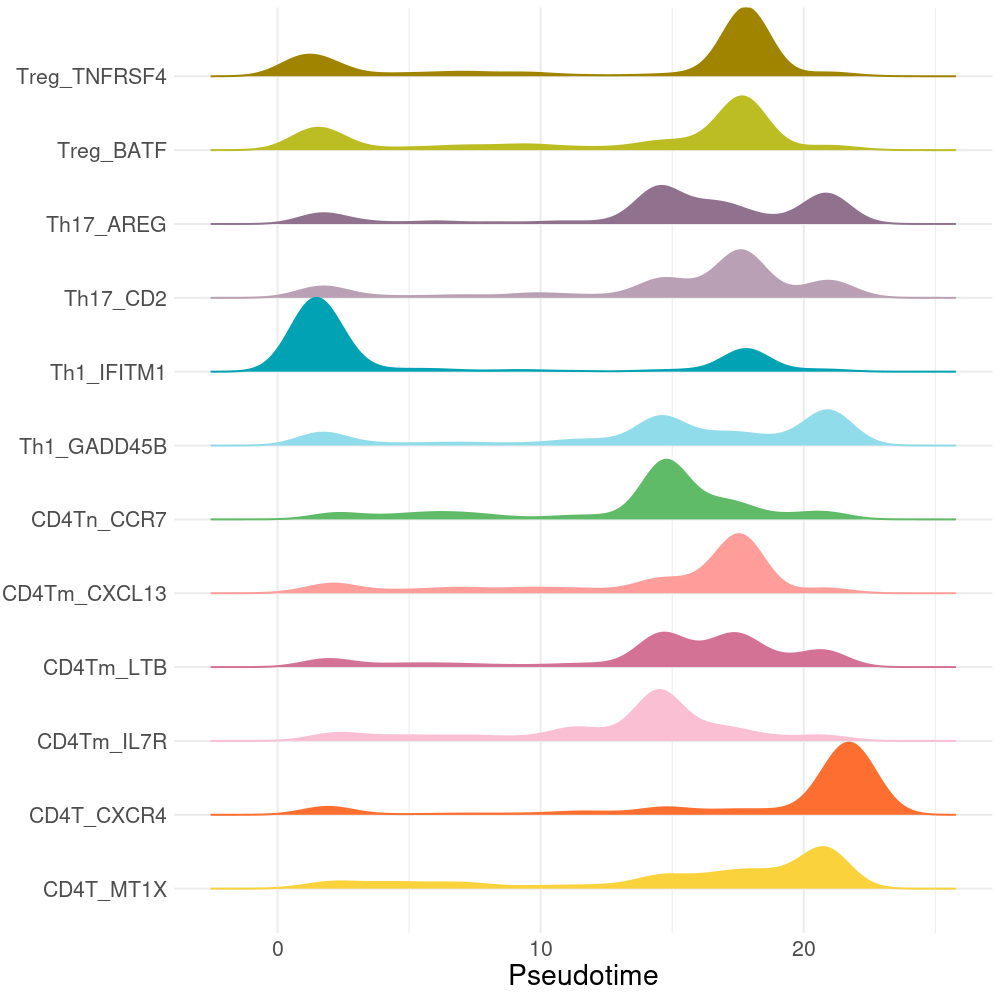

In [1361]:
df <- pData(cds)
p1 <- ggplot(df, aes(x=Pseudotime, colour = subtype, fill = subtype))+ 
    geom_density_ridges(aes(x=Pseudotime, y=subtype,colour = subtype),scale=1) +
    scale_color_manual(values = color_cd4t_celltype) + scale_fill_manual(values = color_cd4t_celltype) +
    theme_minimal()+labs(x="Pseudotime",y=NULL)+
    theme(axis.text = element_text(size=15), axis.title = element_text(size=20),legend.position="None")
options(repr.plot.width = 10, repr.plot.height =10, repr.plot.res = 100)
p1

In [1363]:
pdf(file = "/public/workspace202011/pancancer/Zhangcl/liver_metastasis/Figure/CD4T_pseudotime.pdf", width = 6, height =6)
p1
dev.off()

Picking joint bandwidth of 0.838



png 
  2

# NK (fig6)

In [698]:
obj.nk <- subset(obj.t, primary_cluster == "NK")
obj.nk

An object of class Seurat 
64751 features across 16246 samples within 3 assays 
Active assay: RNA (33538 features, 0 variable features)
 2 other assays present: SCT, integrated
 2 dimensional reductions calculated: pca, umap

In [883]:
obj.nk$tissue_group <- paste0(obj.nk$tissue, "_",obj.nk$group)
unique(obj.nk$tissue_group)

[1] "Lung_PT"      "Liver_PN"     "Liver_PT"     "Eye_HM"       "Eye_PT"      
 [6] "Intestine_HM" "Intestine_PT" "Pancreas_HM"  "Pancreas_PT"  "Stomach_PT"  
[11] "Stomach_HM"   "Mammary_HM"   "Mammary_PT"   "Lung_HM"      "Pancreas_PN" 
[16] "Eye_NN"       "Intestine_NN" "Lung_NN"      "Mammary_NN"   "Pancreas_NN" 
[21] "Liver_NN"

In [700]:
mid <- match(obj.nk@meta.data$sampleID, cluster.df$sampleID)
obj.nk@meta.data$cluster <- cluster.df$cluster[mid]
obj.nk@meta.data$cluster[is.na(obj.nk@meta.data$cluster)==TRUE] <- "others"
unique(obj.nk$cluster)

[1] "others" "CP5"    "CP2"    "CP1"    "CP6"    "CP3"    "CP4"

In [701]:
obj.nk <- RunUMAP(obj.nk, dims = 1:20)

16:35:53 UMAP embedding parameters a = 0.9922 b = 1.112

16:35:53 Read 16246 rows and found 20 numeric columns

16:35:53 Using Annoy for neighbor search, n_neighbors = 30

16:35:53 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

16:35:55 Writing NN index file to temp file /tmp/RtmpzlYEsw/file3432e51253e9b

16:35:55 Searching Annoy index using 1 thread, search_k = 3000

16:36:02 Annoy recall = 100%

16:36:03 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

16:36:05 Initializing from normalized Laplacian + noise (using irlba)

16:36:05 Commencing optimization for 200 epochs, with 751354 positive edges

16:36:29 Optimization finished



In [703]:
## 改变gene名
refGenes <- obj.nk@misc$geneName
DefaultAssay(obj.nk) <- "RNA"
if(!any(is.na(refGenes[rownames(obj.nk@assays$RNA@data)]))){
  rownames(obj.nk@assays$RNA@data) <- refGenes[rownames(obj.nk@assays$RNA@data)]
}
head(rownames(obj.nk@assays$RNA@data), n=1)

ENSG00000000003 
       "TSPAN6"

In [884]:
color_nk_celltype <- c('NK_GNLY'="#fe4365",'NK_KLRF1'="#fc9d9a",'NK_CD7'="#f9cdad",'NK_NKG7'="#c8c8a9")

### UMAP

[1] "NK_GNLY"  "NK_CD7"   "NK_NKG7"  "NK_KLRF1"

[1] 4

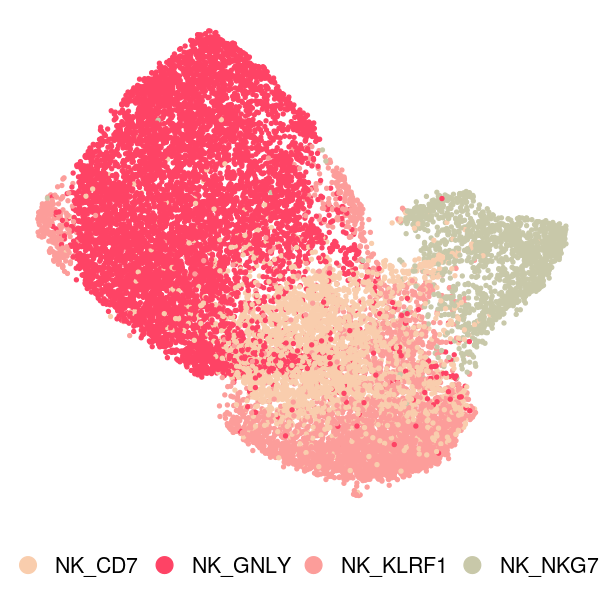

In [720]:
umap <- obj.nk@reductions$umap@cell.embeddings %>%
  as.data.frame() %>%
  cbind(cell_type = obj.nk@meta.data$subtype)
umap$cell_type <- as.character(umap$cell_type)
unique(umap$cell_type)
length(unique(umap$cell_type))

options(repr.plot.width = 6, repr.plot.height =6, repr.plot.res = 100)
p <- ggplot(data = umap, aes(x = UMAP_1, y = UMAP_2, color = cell_type)) +
  geom_point(size = 0.7, alpha = 1) +
  scale_color_manual(values = color_nk_celltype) +
  theme(panel.grid.major = element_blank(), # remove background color……
        panel.grid.minor = element_blank(),
        panel.border = element_blank(),
        axis.title = element_blank(),
        axis.text = element_blank(),
        axis.ticks = element_blank(),
        panel.background = element_rect(fill = "white"),
        plot.background = element_rect(fill = "white")) +
  theme(legend.title = element_blank(),
        legend.key = element_rect(fill = "white"), # remove legend background color
        legend.text = element_text(size = 15),
        legend.key.size = unit(1,"cm"), legend.position = "bottom") + 
  guides(color = guide_legend(override.aes = list(size = 5)))  # adjust size of plot in legend box
p

### proportion

In [722]:
df <- obj.nk@meta.data[obj.nk@meta.data$cluster %in% c("CP3","CP6","CP1","CP2","CP4","CP5"),]
df$subtype <- as.character(df$subtype)
df <- as.data.frame(prop.table(table(df$subtype, df$cluster), margin = 2))
df

Var1,Var2,Freq
<fct>,<fct>,<dbl>
NK_CD7,CP1,0.30785563
NK_GNLY,CP1,0.54989384
NK_KLRF1,CP1,0.10403397
NK_NKG7,CP1,0.03821656
NK_CD7,CP2,0.51875000
NK_GNLY,CP2,0.33125000
NK_KLRF1,CP2,0.10625000
NK_NKG7,CP2,0.04375000
NK_CD7,CP3,0.08333333


In [723]:
df$Var1 <- factor(df$Var1, levels = c("NK_GNLY","NK_KLRF1","NK_CD7","NK_NKG7"))
df$Var2 <- factor(df$Var2, levels = c("CP3","CP6","CP2","CP4","CP1","CP5"))

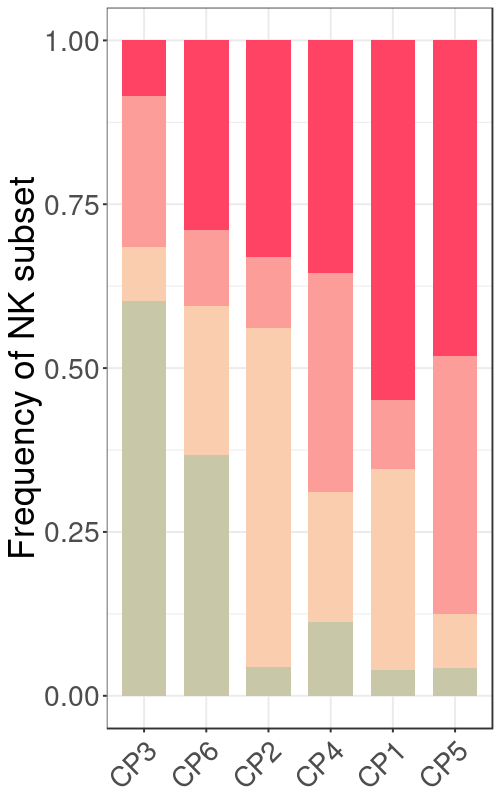

In [725]:
## 先看一下细胞在各CP的分布
options(repr.plot.width = 5, repr.plot.height =8, repr.plot.res = 100)
ggplot(df) +
    geom_bar(aes(x = Var2, y = Freq, fill = Var1), stat = "identity", width = 0.7, size = 0.5) +
    scale_fill_manual(values = color_nk_celltype) +
#     theme_classic()+
    theme_bw()+ labs(x=NULL,y="Frequency of NK subset")+
    theme(axis.text.x = element_text(angle=45, size = 20, hjust = 0.95,vjust = 0.9), 
          axis.text.y = element_text(size = 20),
          axis.title.y = element_text(size =25), legend.position = "none"
         )

### Frequency in CP

In [ ]:

df <- meta %>% dplyr::select(c(sampleID,subtype))
colnames(df) <- c("sampleID","celltype")
subtype_counts <- df %>%
  group_by(sampleID, celltype) %>%
  summarise(count = n(), .groups = "drop")
subtype_proportion <- subtype_counts %>%
  group_by(sampleID) %>%
  mutate(total = sum(count), proportion = count / total * 100) %>%
  ungroup() %>% as.data.frame() 
mid <- match(subtype_proportion$celltype, celltype_ref$subtype)
subtype_proportion$primary_cluster <- celltype_ref$primary_cluster[mid]
subtype_proportion <- filter(subtype_proportion, primary_cluster %in% c("NK"))
mid <- match(x = subtype_proportion$sampleID, table = cluster.df$sampleID)
subtype_proportion$cluster <- cluster.df$cluster[mid]
subtype_proportion <- subtype_proportion[is.na(subtype_proportion$cluster) == FALSE,]
subtype_proportion$cluster <- factor(subtype_proportion$cluster, levels = c("CP1","CP2","CP3","CP4","CP5","CP6"))
mid <- match(x = subtype_proportion$sampleID, table = sample_info$SampleID)
subtype_proportion$tissue <- sample_info$Tissue[mid]
subtype_proportion

,sampleID,celltype,count,total,proportion,primary_cluster,cluster,tissue
,<chr>,<fct>,<int>,<int>,<dbl>,<fct>,<fct>,<chr>
1,CRC01-HM,NK_GNLY,81,12189,0.66453360,NK,CP6,Intestine
2,CRC01-HM,NK_KLRF1,4,12189,0.03281647,NK,CP6,Intestine
3,CRC01-HM,NK_CD7,105,12189,0.86143244,NK,CP6,Intestine
4,CRC01-HM,NK_NKG7,2,12189,0.01640824,NK,CP6,Intestine
8,CRC02-HM,NK_GNLY,79,2327,3.39492909,NK,CP6,Intestine
9,CRC02-HM,NK_CD7,1,2327,0.04297379,NK,CP6,Intestine
10,CRC02-HM,NK_NKG7,13,2327,0.55865922,NK,CP6,Intestine
15,CRC03-HM,NK_GNLY,39,7649,0.50987057,NK,CP6,Intestine
16,CRC03-HM,NK_KLRF1,2,7649,0.02614721,NK,CP6,Intestine


In [894]:
unique(subtype_proportion$celltype)

[1] NK_GNLY  NK_KLRF1 NK_CD7   NK_NKG7 
121 Levels: Acinar_PNLIP Acinar_CLPS Acinar_PRSS1 B_CD79A B_CD74 ... Plasma_MZB1

In [907]:
label.x <- 1.5
label.size <- 5
title.size <- 25
axis.size <- 20
point.size <- 3
comparisons <- list(c("CP5","CP6"))

In [912]:
subset_name <- "NK_KLRF1"
df.target <- subtype_proportion[subtype_proportion$celltype == subset_name,]
p2 <- ggplot(df.target, aes(x = cluster, y = proportion)) +
        geom_boxplot(aes(x = cluster), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        stat_compare_means(label.x = label.x, size = label.size,label.y=15)+
        stat_compare_means(comparisons = comparisons, label="p.signif",hide.ns = TRUE)+
        geom_jitter(aes(color=tissue,fill=tissue),
                    position=position_jitterdodge(dodge.width=0.5),shape = 21,size=point.size)+
        scale_color_manual(values=color_tissue)+  
        scale_fill_manual(values=color_tissue)+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset_name)+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = title.size),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = axis.size),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = axis.size),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
            scale_y_continuous(limits = c(0,5), breaks = seq(0,5,1)),
            legend.position="none") 

subset_name <- "NK_CD7"
df.target <- subtype_proportion[subtype_proportion$celltype == subset_name,]
p3 <- ggplot(df.target, aes(x = cluster, y = proportion)) +
        geom_boxplot(aes(x = cluster), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        stat_compare_means(label.x = label.x, size = label.size,label.y=4.3)+
        stat_compare_means(comparisons = comparisons, label="p.signif",hide.ns = TRUE)+
        geom_jitter(aes(color=tissue,fill=tissue),
                    position=position_jitterdodge(dodge.width=0.5),shape = 21,size=point.size)+
        scale_color_manual(values=color_tissue)+  
        scale_fill_manual(values=color_tissue)+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset_name)+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = title.size),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = axis.size),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = axis.size),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
            scale_y_continuous(limits = c(0,5), breaks = seq(0,5,1)),
            legend.position="none") 

subset_name <- "NK_NKG7"
df.target <- subtype_proportion[subtype_proportion$celltype == subset_name,]
p4 <- ggplot(df.target, aes(x = cluster, y = proportion)) +
        geom_boxplot(aes(x = cluster), alpha=0, 
                     position=position_dodge(preserve = "single"), width=0.7, outlier.color="white")+
        stat_compare_means(label.x = label.x, size = label.size,label.y=7.5)+
        stat_compare_means(comparisons = comparisons, label="p.signif",hide.ns = TRUE)+
        geom_jitter(aes(color=tissue,fill=tissue),
                    position=position_jitterdodge(dodge.width=0.5),shape = 21,size=point.size)+
        scale_color_manual(values=color_tissue)+  
        scale_fill_manual(values=color_tissue)+  
        labs(x=NULL, y ="Frequency") + ggtitle(subset_name)+
        theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = title.size),      ##设置坐标轴文本字体
            axis.title.x=element_blank(),                        ##删除x轴文本               
            axis.text.y=element_text(size = axis.size),     ##设置坐标轴标签字体
            axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = axis.size),     ##设置坐标轴标签字体
            axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
            plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
            scale_y_continuous(limits = c(0,5), breaks = seq(0,5,1)),
            legend.position="none") 

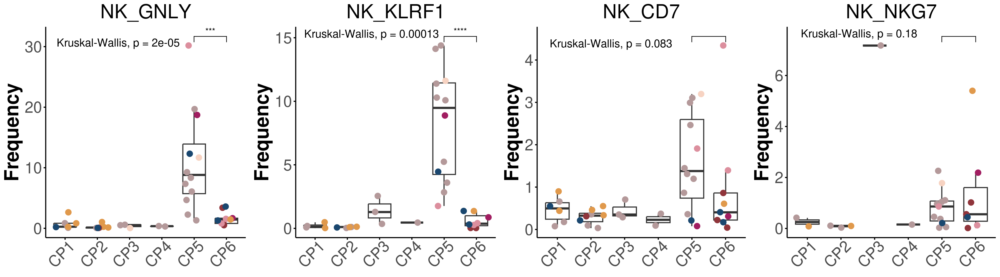

In [913]:
## 用RO/E不太准，把所有箱线图做一遍来看看
options(repr.plot.width = 18, repr.plot.height =5, repr.plot.res = 200)
cowplot::plot_grid(p1,p2,p3,p4,ncol=4)

In [ ]:
## 下面是按cluster着色

### survival analysis

In [751]:
## 获得相应亚群的DEG
all_dmarker <- readRDS("/public/workspace202011/pancancer/Zhangcl/liver_metastasis/DEG/nkt_all_DEG.rds")
logFC = 0.5
padj = 0.05
k1 <- (all_dmarker$p_val_adj < padj) & (all_dmarker$avg_log2FC < -logFC)
k2 <- (all_dmarker$p_val_adj < padj) & (all_dmarker$avg_log2FC > logFC)
all_dmarker$change <- ifelse(test = k1, yes = "down", no = ifelse(k2, yes = "up", no = "stable"))

In [752]:
# subset_name <- "NK_GNLY"
# subset_name <- "NK_KLRF1"
# subset_name <- "NK_CD7"
subset_name <-"NK_NKG7"
df.target <- filter(all_dmarker, cluster == subset_name)
up_data <- filter(df.target, change=="up") %>% distinct(gene, .keep_all = TRUE) %>% slice_max(avg_log2FC, n=20)
gene.need <- up_data$name
gene.need

[1] "HSPA6"    "HSPA1A"   "TYROBP"   "HSPH1"    "HSPD1"    "ZFAND2A" 
 [7] "HSPE1"    "XCL2"     "HSPA1B"   "XCL1"     "FCER1G"   "KLRF1"   
[13] "DNAJB1"   "CMC1"     "CCL3"     "HSP90AA1" "HSP90AB1" "JUND"    
[19] "AREG"     "CD160"

In [753]:
## 用GSVA来评估5个subset的topDEG高低
genesets <- list(gene.need)
names(genesets) <- "topDEG"
ES <- gsva(as.matrix(gexp), genesets)
ES <- data.frame(t(ES))

Warning message in .filterFeatures(expr, method):
“4133 genes with constant expression values throuhgout the samples.”
Warning message in .filterFeatures(expr, method):
“Since argument method!="ssgsea", genes with constant expression values are discarded.”


Estimating GSVA scores for 1 gene sets.
Estimating ECDFs with Gaussian kernels
  |======================================================================| 100%



In [754]:
mid <- match(clinical$submitter_id, colnames(gexp))
clinical$score <- ES$topDEG[mid]
df <- subset(clinical,select =c(submitter_id,vital_status,days_to_death,time,score))
df <- df[!is.na(df$score),]
df$exp <- ""
df[df$score >= mean(df$score),]$exp <- "High"
df[df$score <  mean(df$score),]$exp <- "Low"
df[df$vital_status=='Dead',]$vital_status <- 2
df[df$vital_status=='Alive',]$vital_status <- 1
df$vital_status <- as.numeric(df$vital_status)
df

Warning message in eval(expr, envir, enclos):
“NAs introduced by coercion”


,submitter_id,vital_status,days_to_death,time,score,exp
,<chr>,<dbl>,<int>,<int>,<dbl>,<chr>
1,TCGA-DD-A73C,1,NA,701,-0.543752841,Low
2,TCGA-5C-AAPD,1,NA,20,0.464781293,High
3,TCGA-ZS-A9CE,1,NA,1241,-0.799552386,Low
4,TCGA-HP-A5N0,2,752,752,-0.214607113,Low
5,TCGA-DD-AAVQ,1,NA,2728,0.612410436,High
7,TCGA-DD-AAVR,1,NA,2513,0.762349175,High
8,TCGA-G3-A6UC,1,NA,671,-0.560568419,Low
9,TCGA-BC-A10T,2,837,837,0.231601040,High
10,TCGA-4R-AA8I,2,262,262,0.006670528,High


In [755]:
title.size <- 12
pval.size <- 5
custom_theme <- function() {
  theme_survminer() %+replace%
    theme(
      plot.title=element_text(hjust=0.5)
    )
} # 如果你想要把标题放中间,就在画图函数里加上这个ggtheme=custom_theme()


[1] "p = 0.03"

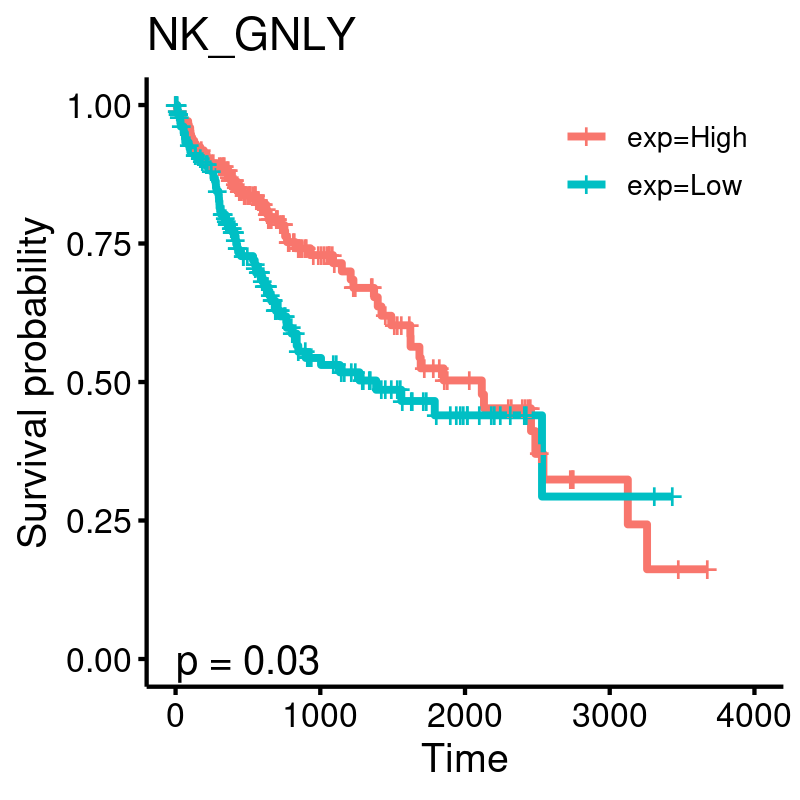

In [364]:
## NK_GNLY
## 加上days_to_follow
df_1 <- df
fit <- survfit(Surv(time, vital_status)~exp, data=df_1) # 根据表达建模
surv_pvalue(fit)$pval.txt
options(repr.plot.width=4, repr.plot.height=4, res=200)
p1 <- ggsurvplot(fit,pval=TRUE,
                 title = subset_name, title.size=title.size,
#                  ggtheme=custom_theme(),
                 legend.title = "", legend = c(0.8,0.9),
                 pval.coord=c(0,0), pval.size = pval.size)
p1

[1] "p = 0.025"

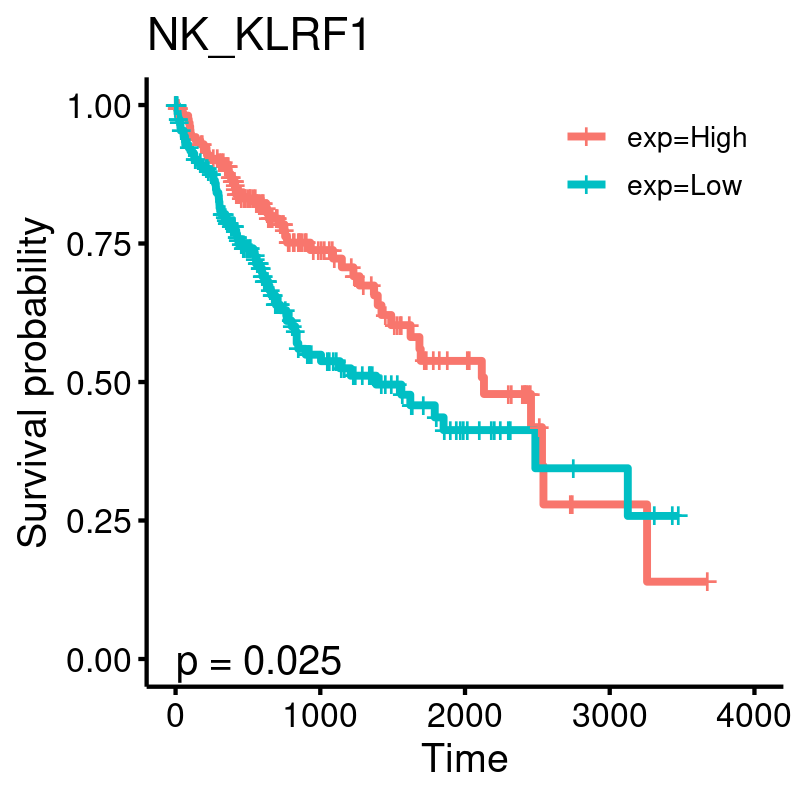

In [382]:
## NK_KLRF1(top 20 DEG)
## 加上days_to_follow
df_2 <- df
fit <- survfit(Surv(time, vital_status)~exp, data=df_2) # 根据表达建模
surv_pvalue(fit)$pval.txt
options(repr.plot.width=4, repr.plot.height=4, res=200)
p2 <- ggsurvplot(fit,pval=TRUE,
                 title = subset_name, title.size=title.size,
#                  ggtheme=custom_theme(),
                 legend.title = "", legend = c(0.8,0.9),
                 pval.coord=c(0,0), pval.size = pval.size)
p2

[1] "p = 0.12"

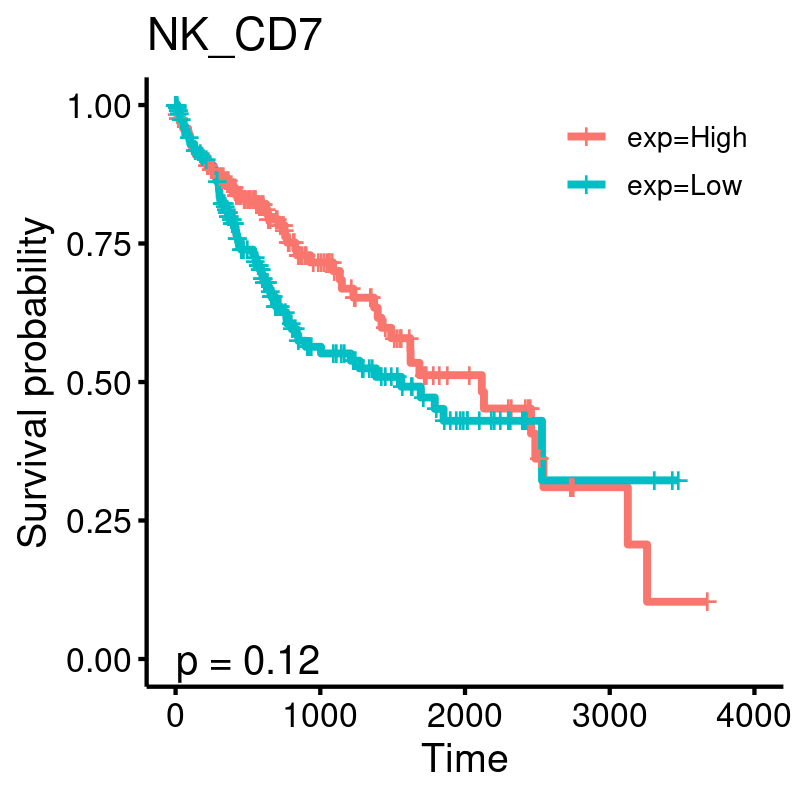

In [374]:
## NK_CD7
## 加上days_to_follow
df_3 <- df
fit <- survfit(Surv(time, vital_status)~exp, data=df_3) # 根据表达建模
surv_pvalue(fit)$pval.txt
options(repr.plot.width=4, repr.plot.height=4, res=200)
p3 <- ggsurvplot(fit,pval=TRUE,
                 title = subset_name, title.size=title.size,
#                  ggtheme=custom_theme(),
                 legend.title = "", legend = c(0.8,0.9),
                 pval.coord=c(0,0), pval.size = pval.size)
p3

[1] "p = 0.22"

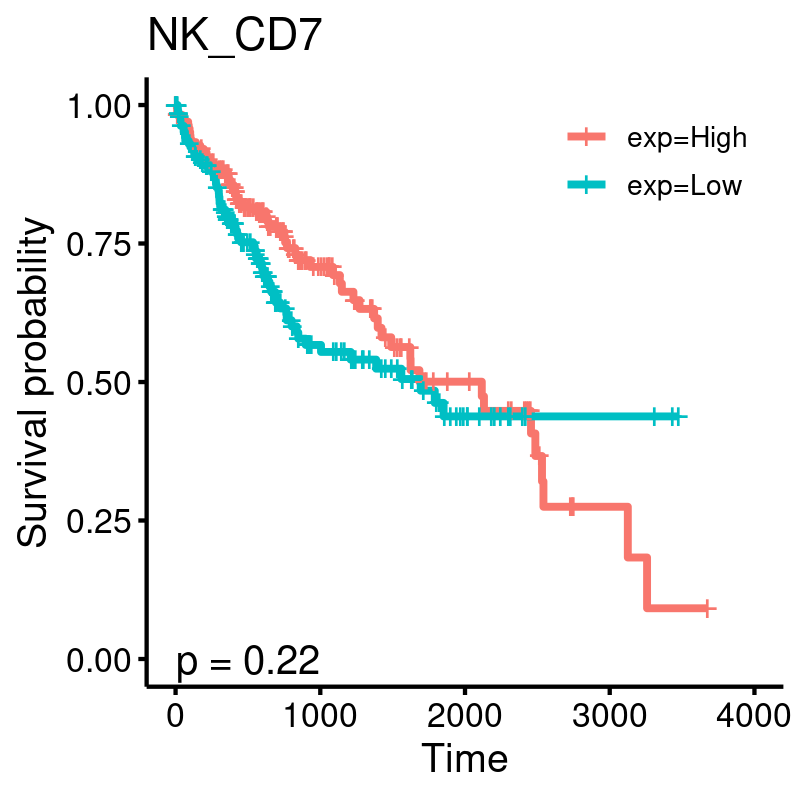

In [386]:
## NK_CD7(top 20 DEG)
## 加上days_to_follow
df_3 <- df
fit <- survfit(Surv(time, vital_status)~exp, data=df_3) # 根据表达建模
surv_pvalue(fit)$pval.txt
options(repr.plot.width=4, repr.plot.height=4, res=200)
p3 <- ggsurvplot(fit,pval=TRUE,
                 title = subset_name, title.size=title.size,
#                  ggtheme=custom_theme(),
                 legend.title = "", legend = c(0.8,0.9),
                 pval.coord=c(0,0), pval.size = pval.size)
p3

[1] "p = 0.13"

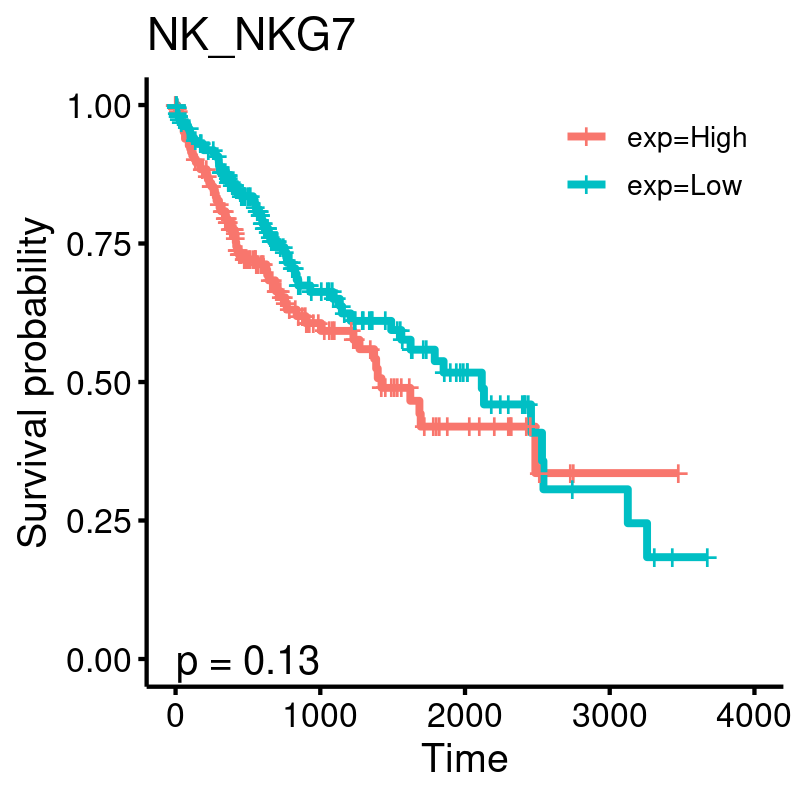

In [378]:
## NK_NKG7
## 加上days_to_follow
df_4 <- df
fit <- survfit(Surv(time, vital_status)~exp, data=df_4) # 根据表达建模
surv_pvalue(fit)$pval.txt
options(repr.plot.width=4, repr.plot.height=4, res=200)
p4 <- ggsurvplot(fit,pval=TRUE,
                 title = subset_name, title.size=title.size,
#                  ggtheme=custom_theme(),
                 legend.title = "", legend = c(0.8,0.9),
                 pval.coord=c(0,0), pval.size = pval.size)
p4

[1] "p = 0.056"

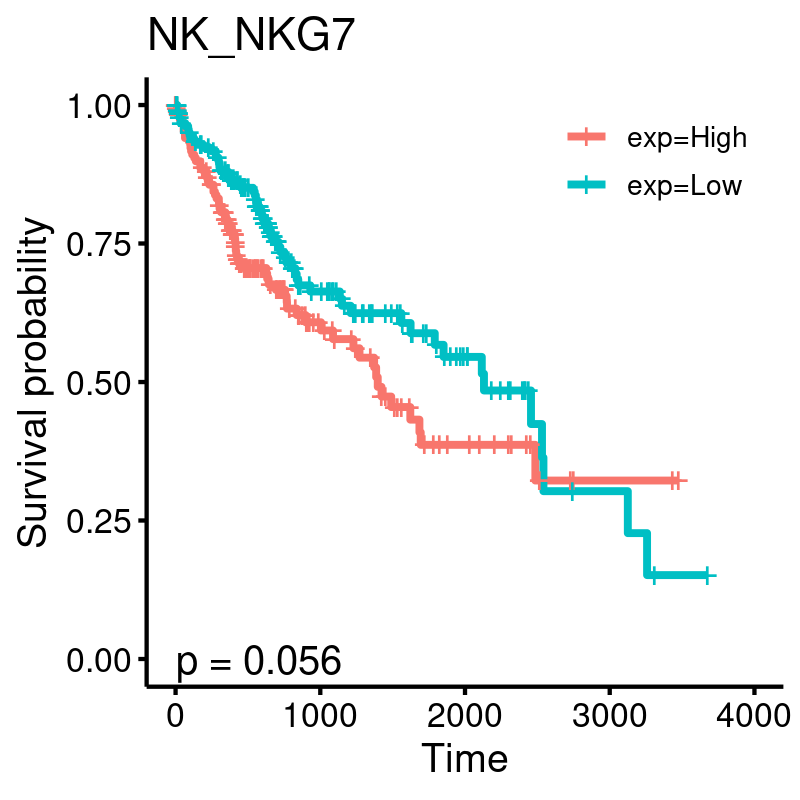

In [756]:
## NK_NKG7(top 20)
## 加上days_to_follow
df_4 <- df
fit <- survfit(Surv(time, vital_status)~exp, data=df_4) # 根据表达建模
surv_pvalue(fit)$pval.txt
options(repr.plot.width=4, repr.plot.height=4, res=200)
p4 <- ggsurvplot(fit,pval=TRUE,
                 title = subset_name, title.size=title.size,
#                  ggtheme=custom_theme(),
                 legend.title = "", legend = c(0.8,0.9),
                 pval.coord=c(0,0), pval.size = pval.size)
p4

### DEG

### function

Warning message in get_plot_component(plot, "guide-box"):
“Multiple components found; returning the first one. To return all, use `return_all = TRUE`.”


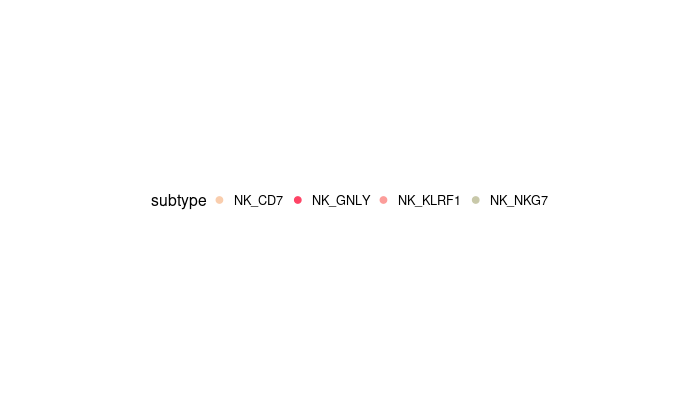

In [595]:
options(repr.plot.width = 7, repr.plot.height =4, repr.plot.res = 100)
lgd <- cowplot::get_legend(p)
grid.newpage()
grid.draw(lgd)

In [596]:
sample.list <- c("Liver_NN","Liver_PN","Liver_PT","Pancreas_HM","Eye_HM","Intestine_HM", "Stomach_HM", "Lung_HM", "Mammary_HM")

In [ ]:
## 以下为细胞毒性、趋化性、压力型

In [772]:
title.size <- 30

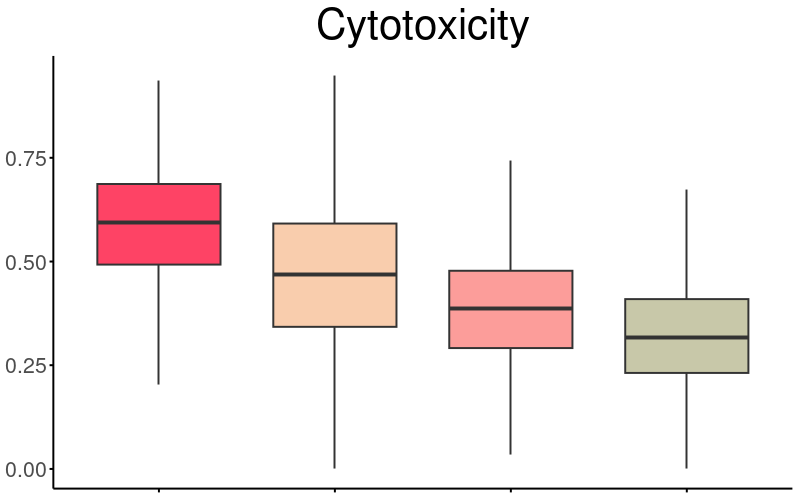

In [773]:
df <- res %>% 
#         filter(tissue_group %in% sample.list) %>% 
        dplyr::select(c(subtype, Cyt))
p1 <- ggplot(df, aes(x = reorder(subtype, -Cyt, FUN=median), y=Cyt, fill = subtype)) +
            scale_fill_manual(values = color_nk_celltype) +
            geom_boxplot(aes(fill=subtype), alpha=1, 
                         position=position_dodge(preserve = "single"), width=0.7, outlier.color="white") +
            theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
                    axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
                    axis.title=element_text(face="bold",size = 20),      ##设置坐标轴文本字体
                    axis.title.x=element_blank(),                        ##删除x轴文本               
                    axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
                    axis.text.x = element_blank(),
#                     axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 12),     ##设置坐标轴标签字体
                    axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
                    plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
                    scale_y_continuous(limits = c(0,0.5), breaks = seq(0,0.5,0.25)), ## 不知道为什么没用
                    legend.position="none")+ggtitle("Cytotoxicity")+labs(x=NULL,y=NULL) 
#             geom_hline(yintercept = 0.06, color="red", linetype='dashed')+
#             coord_cartesian(ylim=c(0,0.25))
#                     + ylim(0,0.5)  ## 不要用这个,会把超过这个范围的值直接去掉
options(repr.plot.width = 8, repr.plot.height =5, repr.plot.res = 100)
p1

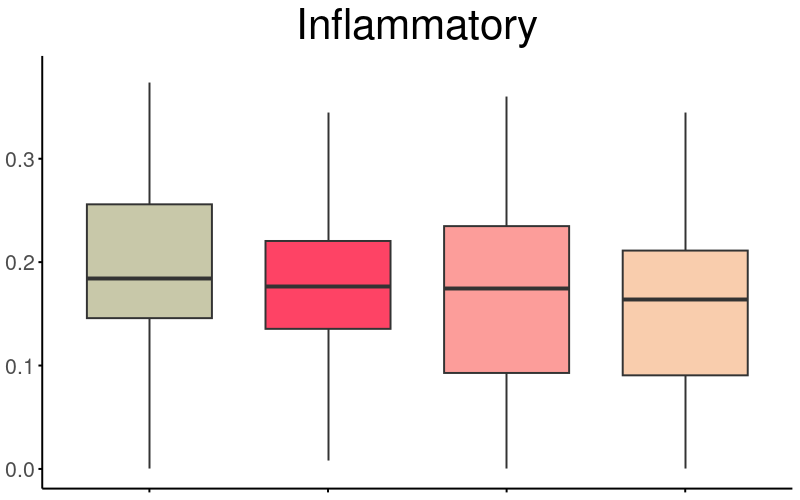

In [774]:
df <- res %>% 
#         filter(tissue_group %in% sample.list) %>% 
        dplyr::select(c(subtype, Infl))
p2 <- ggplot(df, aes(x = reorder(subtype, -Infl, FUN=median), y=Infl, fill = subtype)) +
            scale_fill_manual(values = color_nk_celltype) +
            geom_boxplot(aes(fill=subtype), alpha=1, 
                         position=position_dodge(preserve = "single"), width=0.7, outlier.color="white") +
            theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
                    axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
                    axis.title=element_text(face="bold",size = 20),      ##设置坐标轴文本字体
                    axis.title.x=element_blank(),                        ##删除x轴文本               
                    axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
                    axis.text.x = element_blank(),
#                     axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 12),     ##设置坐标轴标签字体
                    axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
                    plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
                    scale_y_continuous(limits = c(0,0.5), breaks = seq(0,0.5,0.25)), ## 不知道为什么没用
                    legend.position="none")+ggtitle("Inflammatory")+labs(x=NULL,y=NULL) 
#             geom_hline(yintercept = 0.06, color="red", linetype='dashed')+
#             coord_cartesian(ylim=c(0,0.25))
#                     + ylim(0,0.5)  ## 不要用这个,会把超过这个范围的值直接去掉
options(repr.plot.width = 8, repr.plot.height =5, repr.plot.res = 100)
p2

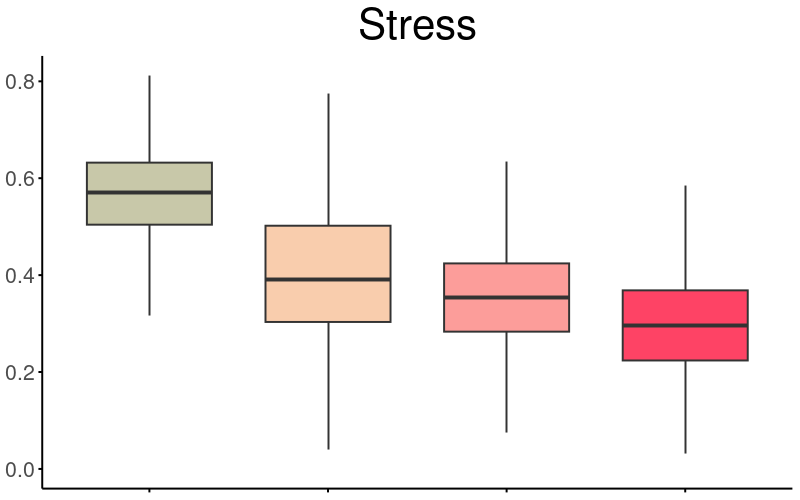

In [775]:
df <- res %>% 
#         filter(tissue_group %in% sample.list) %>% 
        dplyr::select(c(subtype, Str))
p3 <- ggplot(df, aes(x = reorder(subtype, -Str, FUN=median), y=Str, fill = subtype)) +
            scale_fill_manual(values = color_nk_celltype) +
            geom_boxplot(aes(fill=subtype), alpha=1, 
                         position=position_dodge(preserve = "single"), width=0.7, outlier.color="white") +
            theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
                    axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
                    axis.title=element_text(face="bold",size = 20),      ##设置坐标轴文本字体
                    axis.title.x=element_blank(),                        ##删除x轴文本               
                    axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
                    axis.text.x = element_blank(),
#                     axis.text.x=element_text(angle = 45, hjust = 0.85, vjust = 0.95, size = 12),     ##设置坐标轴标签字体
                    axis.ticks=element_line(color='black'),              ##设置坐标轴刻度线
                    plot.title = element_text(hjust = 0.5, vjust = 1, size = title.size),
                    scale_y_continuous(limits = c(0,0.5), breaks = seq(0,0.5,0.25)), ## 不知道为什么没用
                    legend.position="none")+ggtitle("Stress")+labs(x=NULL,y=NULL) 
#             geom_hline(yintercept = 0.06, color="red", linetype='dashed')+
#             coord_cartesian(ylim=c(0,0.25))
#                     + ylim(0,0.5)  ## 不要用这个,会把超过这个范围的值直接去掉
options(repr.plot.width = 8, repr.plot.height =5, repr.plot.res = 100)
p3

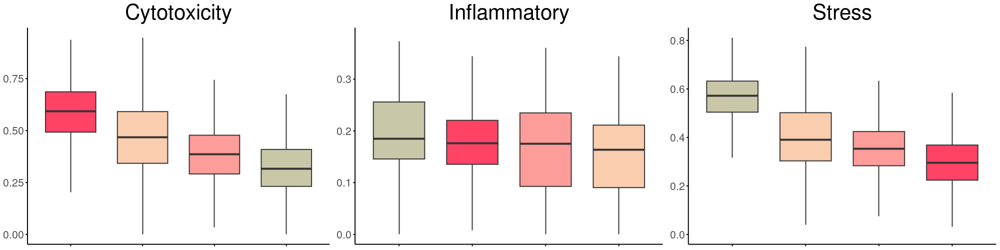

In [776]:
## 全样本
options(repr.plot.width = 20, repr.plot.height =5, repr.plot.res = 100)
cowplot::plot_grid(p1, p2, p3,ncol=3)
# options(repr.plot.width = 10, repr.plot.height =5, repr.plot.res = 100)
# cowplot::plot_grid(p1, p3,ncol=2)

#### dotplot

In [917]:
cyt_score <- c("GZMA","GZMB","GZMH", "GZMM", "GZMK", "GNLY", "PRF1","CTSW")
infl_score <- c("CCL2", "CCL3", "CCL4", "CCL5", "CXCL10", "CXCL9", "IL1B", "IL6", "IL7", "IL15", "IL18")
str_score <- c( "BAG3", "CALU", "DNAJB1", "DUSP1", "EGR1", "FOS", "FOSB", "HIF1A", "HSP90AA1", "HSP90AB1", "HSP90B1", "HSPA1A","HSPA1B",
                 "HSPA6", "HSPB1", "HSPH1", "IER2", "JUN", "JUNB", "NFKBIA", "NFKBIZ", "RGS2", "SLC2A3", "SOCS3", "UBC", 
                 "ZFAND2A", "ZFP36", "ZFP36L1")
sti_receptors <- c("KLRK1","CD244","CD226","ITGB2","TMIGD2","CD2","NCR3","NCR2","NCR1","KLRC2")
inh_receptors <- c("PDCD1","KLRC1","KIR2DL1","KIR2DL3","TIGIT")# "KIR2DL2"没有
sti_factor <- c("IL12RB1","IL12RB2","IL18R1","IL18RAP","IL18BP","IL21R","IL15RA","IL2RA","IL2RG")  
# IL18BP与IL18R1是拮抗的，组织IL18与其受体结合;IL15会与IL12共享IL2RA和IL2RG两个亚基，IL15RA能独立于其他亚基以高亲和力结合IL15
inh_factor <- c("TGFBR1","ACVR1","ADORA2A")

In [918]:
gene.need <- c(cyt_score, infl_score, str_score)
# gene.need <- c(sti_receptors, inh_receptors, sti_factor, inh_factor)
# gene.need <- c(cyt_score, str_score)
gene.need

[1] "GZMA"     "GZMB"     "GZMH"     "GZMM"     "GZMK"     "GNLY"    
 [7] "PRF1"     "CTSW"     "CCL2"     "CCL3"     "CCL4"     "CCL5"    
[13] "CXCL10"   "CXCL9"    "IL1B"     "IL6"      "IL7"      "IL15"    
[19] "IL18"     "BAG3"     "CALU"     "DNAJB1"   "DUSP1"    "EGR1"    
[25] "FOS"      "FOSB"     "HIF1A"    "HSP90AA1" "HSP90AB1" "HSP90B1" 
[31] "HSPA1A"   "HSPA1B"   "HSPA6"    "HSPB1"    "HSPH1"    "IER2"    
[37] "JUN"      "JUNB"     "NFKBIA"   "NFKBIZ"   "RGS2"     "SLC2A3"  
[43] "SOCS3"    "UBC"      "ZFAND2A"  "ZFP36"    "ZFP36L1"

In [735]:
Idents(obj.nk) <- "subtype"

In [736]:
mat <- t(AverageExpression(obj.nk, features = gene.need, assays = "RNA")$RNA)
mat <- as.data.frame(scale(mat))
mat$subtype <- rownames(mat)
df_long_expr <- pivot_longer(mat, cols = -subtype, names_to = "gene", values_to = "score")
df_long_expr$index <- paste0(df_long_expr$subtype, "|",df_long_expr$gene)
df_long_expr

subtype,gene,score,index
<chr>,<chr>,<dbl>,<chr>
NK_GNLY,GZMA,-0.1008698,NK_GNLY|GZMA
NK_GNLY,GZMB,1.1253613,NK_GNLY|GZMB
NK_GNLY,GZMH,1.4960019,NK_GNLY|GZMH
NK_GNLY,GZMM,0.1953255,NK_GNLY|GZMM
NK_GNLY,GZMK,-1.0321060,NK_GNLY|GZMK
NK_GNLY,GNLY,0.5421175,NK_GNLY|GNLY
NK_GNLY,PRF1,1.3832850,NK_GNLY|PRF1
NK_GNLY,CTSW,0.3917728,NK_GNLY|CTSW
NK_GNLY,CCL2,0.1110849,NK_GNLY|CCL2


In [737]:
all_freq <- data.frame()
data <- GetAssayData(object=obj.nk, assay ="RNA", slot = "data")[gene.need,] %>% as.matrix()
for (i in unique(obj.nk@meta.data$subtype)){
    a <- data[,names(obj.nk@active.ident[obj.nk@active.ident==as.character(i)])]
    b <- as.data.frame(apply(a,1,function(x){round(length(x[x!=0])/ncol(a),digit = 4)}))
    rownames(b) <- rownames(a)
    colnames(b) <- as.character(i)
    if(dim(all_freq)[1]<1){
        all_freq <- b
    }else{
        all_freq <- cbind(b, all_freq)
    }
}
all_freq$gene <- rownames(all_freq)
df_long_pct <- pivot_longer(all_freq, cols = !gene, names_to = "subtype", values_to = "pct")
df_long_pct$index <- paste0(df_long_pct$subtype, "|",df_long_pct$gene)
df_long_pct

gene,subtype,pct,index
<chr>,<chr>,<dbl>,<chr>
GZMA,NK_KLRF1,0.8942,NK_KLRF1|GZMA
GZMA,NK_NKG7,0.8171,NK_NKG7|GZMA
GZMA,NK_CD7,0.7241,NK_CD7|GZMA
GZMA,NK_GNLY,0.8240,NK_GNLY|GZMA
GZMB,NK_KLRF1,0.2754,NK_KLRF1|GZMB
GZMB,NK_NKG7,0.2310,NK_NKG7|GZMB
GZMB,NK_CD7,0.7350,NK_CD7|GZMB
GZMB,NK_GNLY,0.9115,NK_GNLY|GZMB
GZMH,NK_KLRF1,0.2037,NK_KLRF1|GZMH


In [738]:
unique(df_long_pct$gene)

[1] "GZMA"     "GZMB"     "GZMH"     "GZMM"     "GZMK"     "GNLY"    
 [7] "PRF1"     "CTSW"     "CCL2"     "CCL3"     "CCL4"     "CCL5"    
[13] "CXCL10"   "CXCL9"    "IL1B"     "IL6"      "IL7"      "IL15"    
[19] "IL18"     "BAG3"     "CALU"     "DNAJB1"   "DUSP1"    "EGR1"    
[25] "FOS"      "FOSB"     "HIF1A"    "HSP90AA1" "HSP90AB1" "HSP90B1" 
[31] "HSPA1A"   "HSPA1B"   "HSPA6"    "HSPB1"    "HSPH1"    "IER2"    
[37] "JUN"      "JUNB"     "NFKBIA"   "NFKBIZ"   "RGS2"     "SLC2A3"  
[43] "SOCS3"    "UBC"      "ZFAND2A"  "ZFP36"    "ZFP36L1"

In [739]:
df.target <- full_join(x = df_long_expr, y = df_long_pct, by = "index") %>% 
                dplyr::select(c(subtype.x, gene.x, score, pct))
colnames(df.target) <- c("subtype","gene","score","pct")
## 1
df.target$type <- ifelse(test = df.target$gene %in% cyt_score, yes = "Cytotoxicity", 
                         no = ifelse(df.target$gene %in% infl_score, yes = "Inflammatory", 
                                     no = "Stress"))
## 2
# df.target$type <- ifelse(test = df.target$gene %in% sti_receptors, yes = "Stimulatory NK receptors", 
#                          no = ifelse(df.target$gene %in% inh_receptors, yes = "Inhibitory NK receptors", 
#                                      no = ifelse(df.target$gene %in% sti_factor, yes = "Stimulatory cytokines", no = "Suppressive factors")))
# df.target$type <- factor(df.target$type, levels = c("Stimulatory NK receptors","Inhibitory NK receptors",
#                                                     "Stimulatory cytokines","Suppressive factors"))
df.target

subtype,gene,score,pct,type
<chr>,<chr>,<dbl>,<dbl>,<chr>
NK_GNLY,GZMA,-0.1008698,0.8240,Cytotoxicity
NK_GNLY,GZMB,1.1253613,0.9115,Cytotoxicity
NK_GNLY,GZMH,1.4960019,0.8273,Cytotoxicity
NK_GNLY,GZMM,0.1953255,0.5769,Cytotoxicity
NK_GNLY,GZMK,-1.0321060,0.1572,Cytotoxicity
NK_GNLY,GNLY,0.5421175,0.8221,Cytotoxicity
NK_GNLY,PRF1,1.3832850,0.8168,Cytotoxicity
NK_GNLY,CTSW,0.3917728,0.6762,Cytotoxicity
NK_GNLY,CCL2,0.1110849,0.0189,Inflammatory


In [482]:
max(df.target$score)
min(df.target$score)
max(df.target$pct)

[1] 1.497886

[1] -1.499221

[1] 0.994

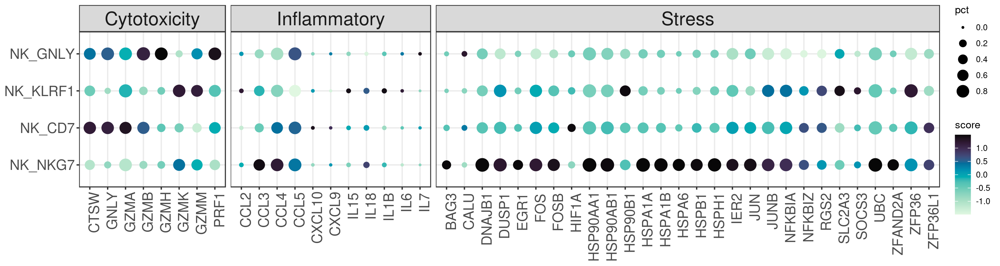

In [741]:
## Visualize
options(repr.plot.width=15, repr.plot.height=4)
df.target$subtype <- factor(df.target$subtype, levels = c("NK_NKG7","NK_CD7","NK_KLRF1","NK_GNLY"))
p <- ggplot(df.target, aes(x = gene, y = subtype)) +
        geom_point(aes(color=score, size = pct))+
        scale_size_continuous(range = c(0.5,6), breaks = c(0.0,0.2,0.4,0.6,0.8))+
        scale_color_gradientn(colours = rev(sequential_hcl("Mako", n=10)), values = c(0,0.4,0.6,0.8,1))+
        labs(x=NULL,y=NULL)+ facet_grid(.~type, scales = "free", space = "free")+
        theme_bw()+
        theme(axis.text.x = element_text(angle=90, size = 15, hjust = 0.95,vjust = 0.9),
              axis.text.y = element_text(size = 15),
              strip.text = element_text(size=20),
              plot.title = element_text(hjust = 0.5, vjust = 1, size = 20))
p

In [ ]:
## Visualize
options(repr.plot.width=10, repr.plot.height=4)
p <- ggplot(df.target, aes(x = gene, y = subtype)) +
        geom_point(aes(color=score, size = pct))+
        scale_size_continuous(range = c(0.5,6), breaks = c(0.0,0.2,0.4,0.6,0.8))+
        scale_color_gradientn(colours = rev(sequential_hcl("Mako", n=10)), values = c(0,0.4,0.6,0.8,1))+
        labs(x=NULL,y=NULL)+ facet_grid(.~type, scales = "free", space = "free")+
        theme_bw()+
        theme(axis.text.x = element_text(angle=90, size = 15, hjust = 0.95,vjust = 0.9),
              axis.text.y = element_text(size = 15),
              strip.text = element_text(size=20),
              plot.title = element_text(hjust = 0.5, vjust = 1, size = 20))
p


In [ ]:
## Visualize
df.target$subtype <- factor(df.target$subtype, levels = c("NK_NKG7","NK_CD7","NK_KLRF1","NK_GNLY"))
options(repr.plot.width=10, repr.plot.height=4)
p <- ggplot(df.target, aes(x = gene, y = subtype)) +
        geom_point(aes(color=score, size = pct))+
        scale_size_continuous(range = c(0.5,6), breaks = c(0.0,0.2,0.4,0.6,0.8))+
        scale_color_gradientn(colours = rev(sequential_hcl("Mako", n=10)), values = c(0,0.4,0.6,0.8,1))+
        labs(x=NULL,y=NULL)+ facet_grid(.~type, scales = "free", space = "free")+
        theme_bw()+
        theme(axis.text.x = element_text(angle=90, size = 15, hjust = 0.95,vjust = 0.9),legend.position = "bottom",
              axis.text.y = element_text(size = 15),
              strip.text = element_text(size=15),
              plot.title = element_text(hjust = 0.5, vjust = 1, size = 10))
p

#### recruitment in CPs

#### recruitment in subset

In [ ]:
stat.test <- df %>% group_by(cluster) %>% pairwise_wilcox_test(score ~ subtype) %>% add_xy_position(x = "cluster", dodge = 0.8)

##
options(repr.plot.width = 7, repr.plot.height =4, repr.plot.res = 100)
p1 <- ggplot(df, aes(x = cluster, y = score)) +
        labs(x=NULL, y =NULL) + ggtitle("CCL3 expresssion")+
        geom_violin(aes(color= subtype, fill=subtype), scale = "width", bounds = c(0,Inf),trim = FALSE)+
#         geom_boxplot(width = 0.2, outlier.size = 0)+
#         stat_compare_means(label.x = label.x, size = label.size,label.y=7)+
#         stat_compare_means(comparisons = comparisons, label="p.signif",hide.ns = TRUE)+
        stat_pvalue_manual(stat.test, hide.ns = FALSE)+
        theme_bw() +
        scale_fill_manual(values=c(color_nk_celltype,"others"="#566270"))+scale_color_manual(values=c(color_nk_celltype,"others"="grey"))+
         theme(panel.background=element_rect(fill='transparent'),   ##去掉底层阴影
            axis.line=element_line(colour="black",size=0.5),     ##设置坐标轴的线条
            axis.title=element_text(face="bold",size = 20),      ##设置坐标轴文本字体            
            axis.text.y=element_text(size = 15),     ##设置坐标轴标签字体
           axis.text.x = element_text(size=15, angle = 90),
            axis.ticks.y=element_line(color='black'),              ##设置坐标轴刻度线
               legend.position="bottom",
            plot.title = element_text(hjust = 0.5, vjust = 1, size = 20)
            )
p1